# Restricted Boltzmann Machine - MNIST

## Imports

In [21]:
!pip install --upgrade numpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 445.6 kB/s eta 0:00:0000:0100:01
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.18.0 requires numpy<2.1.0,>=1.26.0, but you have numpy 2.2.4 which is incompatible.


In [22]:
import sys, datetime
import os
# numpy
import numpy as np
from numpy import exp,sqrt,log,log10,sign,power,cosh,sinh,tanh,floor
rng = np.random.default_rng(12345)
np.set_printoptions(precision=4)

# matplotlib
import matplotlib as mpl
%matplotlib inline
from matplotlib.ticker import NullFormatter, MaxNLocator
mpl.rcParams.update({"font.size": 12})  #"text.usetex": True,})
from matplotlib.colors import ListedColormap
import matplotlib.pyplot as plt

# to load MNIST
from sklearn.datasets import fetch_openml

!mkdir FIG
!mkdir FIG/FRAME
#!mkdir WEIGHTS
!mkdir DATA
if not os.path.exists('GRAPHS'):
    os.makedirs('GRAPHS')


mkdir: cannot create directory ‘FIG’: File exists
mkdir: cannot create directory ‘FIG/FRAME’: File exists
mkdir: cannot create directory ‘DATA’: File exists


## Load data

In [23]:
#import dill
#import IPython.display

#from IPython.core.display import display, HTML

# Attempt to load the session:
#try:
#dill.load_session('/content/save_ll_1.7 - Copia.db')
#except AttributeError:
    #print("Error loading session. Consider using a compatible IPython version or manually editing the session file.")
    # If you choose to edit manually, carefully inspect and modify the problematic object reference.
    # Refer to dill documentation for guidance on inspecting saved objects: https://dill.readthedocs.io/en/latest/
    # Use with caution as manual editing can corrupt the session file.

X_original, Y_original = fetch_openml("mnist_784", version=1, return_X_y=True, as_frame=False)
print(X_original.shape)

(70000, 784)


## Parameters

In [37]:
################################
#    CHOICE OF PARAMETERS      #
################################
# number of MNIST digits to keep (e.g., Ndigit=3 keeps 0,1,2)
Ndigit=3
# number of hidden units
L = 3
# use (+1,-1) if SPINS, otherwise use bits (1,0)
SPINS=False
# use one-hot encoding in hidden space if POTTS (use only if SPINS=False)
POTTS=False

dname='DATA/'
################################

# x_min =0 if bits, x_min=-1 if SPINS
# level_gap is the difference in values between the max (1) and the min (x_min)
if SPINS:
    x_min=-1
    level_gap=2.
else:
    x_min=0
    level_gap=1.

if POTTS:
    str_simul="RBM_Potts"
    # in one-hot encoding, number of possible hidden states matches L
    Nz=L
else:
    str_simul="RBM"
    # number of possible hidden states: 2**L
    Nz=2**L

if POTTS and SPINS:
    print("\n\n>>>>>>>> WARNING:  POTTS and SPINS cannot coexist\n\n")

## Select data, and digitalize them two levels

('1', '4', '7')
dataset with 21994 points, each with 784 bits

first 10 MNIST data points


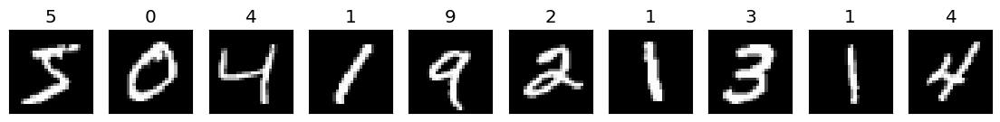

first 10 MNIST-3 data points


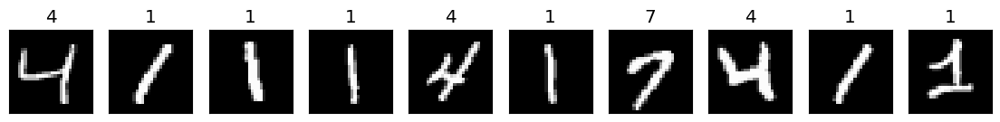

first 10 MNIST-3 data points, binarized


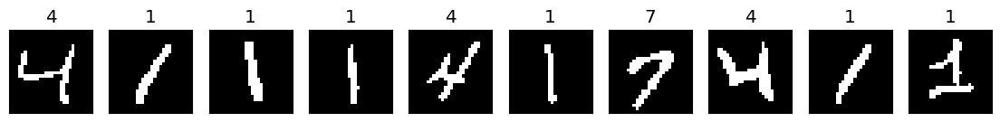

each of Nd=21994 data has D=784 bits


In [25]:
def show_MNIST(x, y=[], z=[], Nex=5, S=1.4, side=0, colors=[]):
    """Show digits"""
    if side==0: side = int(sqrt(x.shape[1]))
    if len(y)<1: y=np.full(Nex,"")
    colors=np.array(colors)
    fig, AX = plt.subplots(1,Nex,figsize=(S*Nex,S))

    for i, img in enumerate(x[:Nex].reshape(Nex, side, side)):
        if len(colors)==0: newcmp = "gray"
        else:
            col= colors[0] + (colors[1]-colors[0])*(i+1)/(Nex+1)
            newcmp = ListedColormap((col,(1,1,1,1)))
        ax=AX[i]
        ax.imshow(img, cmap=newcmp)
        ax.set_xticks([])
        ax.set_yticks([])
        if len(y)>0: ax.set_title(y[i])
        if len(z)>0: ax.set_title(''.join(map(str, z[i])),fontsize=9)
    plt.show()

def MNIST_bit(X,side=28,level=0.5):
    NX=len(X)
    #print(X.shape)
    print(f"dataset with {NX} points, each with {len(X[0])} bits\n")
    if side==14:
        X = np.reshape(X,(NX,28,28))
        # new value = average over 4 values in a 2x2 square
        Xr = 0.25*(X[:,0::2,0::2]+X[:,1::2,0::2]+X[:,0::2,1::2]+X[:,1::2,1::2])
        X  = Xr.reshape(NX,side**2)
    #print(X.shape)
    # binarize data and then convert it to 1/0 or 1/-1
    X = np.where(X/255 > level, 1, x_min)
    return X.astype("int")

list_10_digits = ('0','1','2','3','4','5','6','7','8','9')
list_digits = list_10_digits[1:8:Ndigit]
print(list_digits)
keep=np.isin(Y_original, list_digits)
X_keep,Y=X_original[keep],Y_original[keep]

data,label = MNIST_bit(X_keep),Y
data,label = data.astype("int"),label.astype("int")
print("first 10 MNIST data points")
show_MNIST(X_original, Y_original,Nex=10)
print(f"first 10 MNIST-{Ndigit} data points")
show_MNIST(X_keep, label,Nex=10)
print(f"first 10 MNIST-{Ndigit} data points, binarized")
show_MNIST(data, label,Nex=10)

# number of data points
Nd = len(data)
# number of visible units
D  = len(data[1])

print(f'each of Nd={Nd} data has D={D} bits')

## Plotting data stats

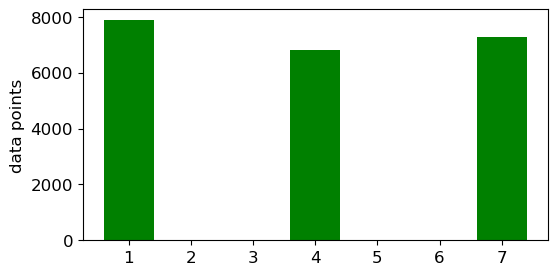

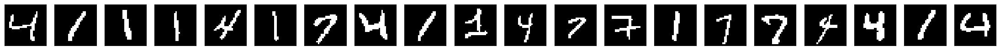

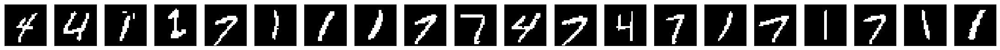

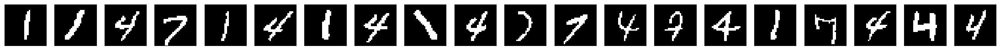

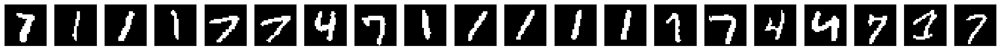

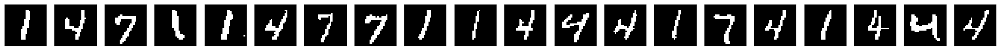

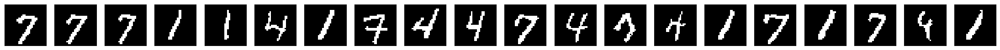

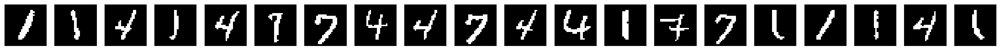

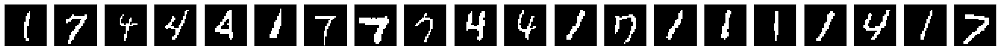

In [26]:
fig, (ax) = plt.subplots(1,1,figsize=(6,3))
ax.hist(np.sort(label),bins=[0.5,1.5,3.5,4.5,6.5,7.5],density=False,rwidth=0.8,color="g")
ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(1))
ax.set_ylabel("data points")
plt.show()
for i in range(8): show_MNIST(data[i*20:],Nex=20)

## Contrastive divergence (CD)


In [27]:
# eq(213) page 97, activation via sigmoid
# taking into account energy gap 2 for "spin" variables (-1,1)
def CD_step(v_in,wei,bias,details=False,POTTS=False):
    """
        Generates the state on the other layer:
        Field "H" ->  activation "a" -> probability "p" -> Spins/bits v_out

        Either (v_in=x, wei=w) or (v_in=z, wei=w.T)

        details = True --> returns also probability (p) and activation (a)

        POTTS means one-hot encoding (used only in hidden space)
    """
    # local "field"
    H = np.clip(np.dot(v_in, wei) + bias, a_min=-300, a_max=300)
    # "activation"
    a = exp(level_gap*H)
    n = np.shape(H)
    v_out = np.full(n, x_min, dtype=int) # initially, just a list on -1's or 0's
    if POTTS: # RBM with a single hidden unit = 1 (that is, "one-hot encoding" with L states)
        # p: state probability, normalized to 1 over all units=states
        p = a/np.sum(a)
        # F: cumulative probability
        F = np.cumsum(p)
        # pick a state "i" randomly with probability p[i]
        r = np.random.rand()
        i = 0
        while r>F[i]: i+=1
        v_out[i] = 1 # activate a single hidden unit
    else: # normal Ising RBM
        # p: local probability, normalized to 1 for each hidden unit
        p = a / (a + 1.)
        # at each position i, activate the 1's with local probability p[i]
        v_out[np.random.random_sample(n) < p] = 1

    if details: return v_out,p,a
    else: return v_out

## Plot weights

In [28]:
def plot_weights_bias(wE, bE, epoch, L,
                      side=0,cols=0,thr=0,s=1.5,
                      title=False, save=True,cmap="bwr"):
    '''
    Plot the weights of the RBM, one plot for each hidden unit.
    '''
    rows = int(np.ceil(L / cols))
    if rows==1: rows=2
    w=wE[epoch]
    b=bE[epoch]
    if side==0: side=int(sqrt(len(w)))
    if thr==0: thr=4
    plt.clf()
    fig, AX = plt.subplots(rows, cols+1, figsize=(s*(1+cols),s*rows))
    if title: fig.suptitle(f"epoch = {epoch}")
    k=1
    for i in range(rows):
        for j in range(cols):
            if rows==1: ax=AX[j+1]
            else: ax=AX[i,j+1]
            if k<=L:
                ax.imshow(w[:,k-1].reshape(side, side), cmap=cmap,vmin=-thr,vmax=thr)
                ax.set_xticks([])
                ax.set_yticks([])
                ax.set_title(f"hidden {k}")
            else: fig.delaxes(ax)
            k+=1
        if i>0:  fig.delaxes(AX[i,0])

    ax=AX[0,0];
    im=ax.imshow(b.reshape(side, side), cmap=cmap,vmin=-thr,vmax=thr)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title("bias")
    # colobar
    cbar_ax = fig.add_axes([0.14, 0.15, 0.024, 0.33])
    cbar = fig.colorbar(im, cax=cbar_ax)
    cbar.ax.tick_params(labelsize=12)

    S=0.3
    plt.subplots_adjust(hspace=S)

    if save: plt.savefig(f"./FIG/FRAME/RBM_{epoch}_w-a.png")

    plt.show()
    plt.close()


## Weights initialization

In [29]:
# initial bias of visible units, based on their average value in the dataset
# Hinton, "A Practical Guide to Training Restricted Boltzmann Machines"
def Hinton_bias_init(x):
    xmean=np.array(np.mean(x,axis=0))
    # remove values at extrema, to avoid divergences in the log's
    S = 1e-4
    x1,x2 = x_min+S,1-S
    xmean[xmean<x1] = x1
    xmean[xmean>x2] = x2
    return (1/level_gap)*np.clip(log(xmean-x_min) - log(1-xmean),-300,300)

# range of each initial weight
# Glorot and Bengio, "Understanding the difficulty of training deep feedforward neural networks"
sigma = sqrt(4. / float(L + D))

## Gradient descent method

In [30]:
# Gradient descent options
GRAD_list=["SGD","RMSprop"]
GRAD=GRAD_list[1]
if GRAD=="SGD":
    l_rate_ini,l_rate_fin=1.0,0.25
if GRAD=="RMSprop":
    beta,epsilon=0.9,1e-4
    l_rate_ini,l_rate_fin=0.05,0.05
    print("epsilon=",epsilon)
gamma = 0.001 ######### for regularization

print(f"D={D}\tsample size\nL={L}\tnr. z states")
print("Gradient descent type:",GRAD)
print(f"learning rate        = {l_rate_ini} --> {l_rate_fin}")
if gamma!=0: print(f"gamma={gamma}\tregularization")

epsilon= 0.0001
D=784	sample size
L=3	nr. z states
Gradient descent type: RMSprop
learning rate        = 0.05 --> 0.05
gamma=0.001	regularization


# RBM training


In [31]:
def make_weights_fname(label,dname="WEIGHTS"):
    fname=dname+"/"+label+"_"+str_simul+"_MNIST"+str(Ndigit)+"_L"+str(L)+"_Nt"+str(Nt)
    fname=fname+"_"+GRAD+"-"+"{:.2f}".format(l_rate_ini)+"-"+"{:.2f}".format(l_rate_fin)+"_Ep"+str(Nepoch)
    if gamma>0:  fname=fname+"_reg"+"{:.3g}".format(gamma)
    if POTTS: fname+="_POTTS"
    if SPINS: fname+="_SPINS"
    fname=fname
    return fname+".npy"

def save_epochs(qE,label):
    fname=make_weights_fname(label)
    #print(fname)
    np.save(fname,qE)


In [11]:
# random seed for reproducibility
np.random.seed(12345)

L_v = [3,4,5,6,8,10]
Nt_v= [2,4,6,8,10,15]
gamma_v= [0.0001,0.001,0.01,0.1,0.5]

In [ ]:
for L in L_v:
    if L == 3:
        for Nt in Nt_v:

            # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
            w = sigma * np.random.randn(D,L)
            #a = sigma * np.random.randn(D)
            # using Hinton initialization of visible biases
            a = Hinton_bias_init(data)
            # hidden biases initialized to zero
            b = np.zeros(L)
            #print("w=",w);print("a=",a);print("b=",b)

            # nr of epochs
            Nepoch=150
            # minibatches per epoch
            Nmini=20
            # minibatch size at initial epoch and final one
            N_ini,N_fin=10,500
            print(f"Nepoch={Nepoch}\nNmini={Nmini}")


            # recording history of weights ("E" means epoch)
            wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
            wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
            gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
            gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
            gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
            miniE = np.zeros(Nepoch+1)
            pzE=np.zeros((Nepoch+1,Nz))
            if GRAD=="RMSprop":
                gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)

            indices=np.arange(Nd).astype("int")
            plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)

            # for the plot with panels
            Ncols=min(8,max(2,L//2))

            if POTTS: print("Starting the training, POTTS=True")
            else: print("Starting the training")

            # Note: here an epoch does not analyze the whole dataset
            for epoch in range(1,1+Nepoch):
                # q maps epochs to interval [0,1]
                q = (epoch-1.)/(Nepoch-1.)
                # N, size of the mini batch
                # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
                N = int(N_ini + (N_fin-N_ini)*(q**2))
                #  l_rate interpolates between initial and final value
                l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q

                for mini in range(Nmini):
                    # initializitation for averages in minibatch
                    # visible variables "v" --> "x"
                    #  hidden variables "h" --> "z"
                    x_data, x_model = np.zeros(D),np.zeros(D)
                    z_data, z_model = np.zeros(L),np.zeros(L)
                    xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
                    pz = np.zeros(L)

                    # Minibatch of size N: points randomply picked (without repetition) from data
                    selected = np.random.choice(indices,N,replace=False)
                    if epoch==1 and mini<=3: print(selected)

                    for k in range(N):
                        ###################################
                        x0 = data[selected[k]]
                        # positive CD phase: generating z from x[k]
                        z = CD_step(x0,w,b,POTTS=POTTS)
                        x_data  += x0
                        z_data  += z
                        xz_data += np.outer(x0,z)
                        # fantasy
                        zf=np.copy(z)
                        # Contrastive divergence with Nt steps
                        for t in range(Nt):
                            # negative CD pzase: generating fantasy xf from fantasy zf
                            xf = CD_step(zf,w.T,a)
                            # positive CD phase: generating fantasy zf from fantasy xf
                            zf = CD_step(xf,w,b,POTTS=POTTS)
                        x_model += xf
                        z_model += zf
                        xz_model+= np.outer(xf,zf)
                        # recording probability of encoding in z-space, if POTTS
                        if POTTS: pz[zf]+=1
                        ###################################

                    # gradient of the likelihood: follow it along its positive direction
                    gw_d,gw_m = xz_data/N, xz_model/N
                    ga_d,ga_m = x_data/N, x_model/N
                    gb_d,gb_m = z_data/N, z_model/N
                    gw=np.copy(gw_d - gw_m)
                    ga=np.copy(ga_d - ga_m)
                    gb=np.copy(gb_d - gb_m)

                    # gradient ascent step
                    if GRAD=="RMSprop":
                        # RMSprop gradient ascent
                        gw2 = beta*gw2+(1-beta)*np.square(gw)
                        ga2 = beta*ga2+(1-beta)*np.square(ga)
                        gb2 = beta*gb2+(1-beta)*np.square(gb)
                        w += l_rate*gw/sqrt(epsilon+gw2)
                        a += l_rate*ga/sqrt(epsilon+ga2)
                        b += l_rate*gb/sqrt(epsilon+gb2)
                    else:
                        # defaulting to the vanilla stochastic gradient ascent (SGD)
                        w += l_rate*gw
                        a += l_rate*ga
                        b += l_rate*gb
                    # regularization (LASSO)
                    if gamma>0.:
                        w -= (gamma*l_rate)*sign(w)
                        a -= (gamma*l_rate)*sign(a)
                        b -= (gamma*l_rate)*sign(b)

                wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
                aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
                bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
                miniE[epoch]=N
                if POTTS: pzE[epoch] = pz/np.sum(pz)
                print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
                      " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)

                if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
                    plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

                str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
            save_epochs(wE,"w")
            save_epochs(bE,"b")
            save_epochs(aE,"a")

        print("END of learning phase")


    else:
        # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
        w = sigma * np.random.randn(D,L)
        #a = sigma * np.random.randn(D)
        # using Hinton initialization of visible biases
        a = Hinton_bias_init(data)
        # hidden biases initialized to zero
        b = np.zeros(L)
        #print("w=",w);print("a=",a);print("b=",b)

        # nr of epochs
        Nepoch=150
        # minibatches per epoch
        Nmini=20
        # minibatch size at initial epoch and final one
        N_ini,N_fin=10,500
        print(f"Nepoch={Nepoch}\nNmini={Nmini}")
        # number of CD steps
        Nt=2

        # recording history of weights ("E" means epoch)
        wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
        wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
        gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
        gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
        gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
        miniE = np.zeros(Nepoch+1)
        pzE=np.zeros((Nepoch+1,Nz))
        if GRAD=="RMSprop":
            gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)

        indices=np.arange(Nd).astype("int")
        plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)

        # for the plot with panels
        Ncols=min(8,max(2,L//2))

        if POTTS: print("Starting the training, POTTS=True")
        else: print("Starting the training")

        # Note: here an epoch does not analyze the whole dataset
        for epoch in range(1,1+Nepoch):
            # q maps epochs to interval [0,1]
            q = (epoch-1.)/(Nepoch-1.)
            # N, size of the mini batch
            # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
            N = int(N_ini + (N_fin-N_ini)*(q**2))
            #  l_rate interpolates between initial and final value
            l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q

            for mini in range(Nmini):
                # initializitation for averages in minibatch
                # visible variables "v" --> "x"
                #  hidden variables "h" --> "z"
                x_data, x_model = np.zeros(D),np.zeros(D)
                z_data, z_model = np.zeros(L),np.zeros(L)
                xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
                pz = np.zeros(L)

                # Minibatch of size N: points randomply picked (without repetition) from data
                selected = np.random.choice(indices,N,replace=False)
                if epoch==1 and mini<=3: print(selected)

                for k in range(N):
                    ###################################
                    x0 = data[selected[k]]
                    # positive CD phase: generating z from x[k]
                    z = CD_step(x0,w,b,POTTS=POTTS)
                    x_data  += x0
                    z_data  += z
                    xz_data += np.outer(x0,z)
                    # fantasy
                    zf=np.copy(z)
                    # Contrastive divergence with Nt steps
                    for t in range(Nt):
                        # negative CD pzase: generating fantasy xf from fantasy zf
                        xf = CD_step(zf,w.T,a)
                        # positive CD phase: generating fantasy zf from fantasy xf
                        zf = CD_step(xf,w,b,POTTS=POTTS)
                    x_model += xf
                    z_model += zf
                    xz_model+= np.outer(xf,zf)
                    # recording probability of encoding in z-space, if POTTS
                    if POTTS: pz[zf]+=1
                    ###################################

                # gradient of the likelihood: follow it along its positive direction
                gw_d,gw_m = xz_data/N, xz_model/N
                ga_d,ga_m = x_data/N, x_model/N
                gb_d,gb_m = z_data/N, z_model/N
                gw=np.copy(gw_d - gw_m)
                ga=np.copy(ga_d - ga_m)
                gb=np.copy(gb_d - gb_m)

                # gradient ascent step
                if GRAD=="RMSprop":
                    # RMSprop gradient ascent
                    gw2 = beta*gw2+(1-beta)*np.square(gw)
                    ga2 = beta*ga2+(1-beta)*np.square(ga)
                    gb2 = beta*gb2+(1-beta)*np.square(gb)
                    w += l_rate*gw/sqrt(epsilon+gw2)
                    a += l_rate*ga/sqrt(epsilon+ga2)
                    b += l_rate*gb/sqrt(epsilon+gb2)
                else:
                    # defaulting to the vanilla stochastic gradient ascent (SGD)
                    w += l_rate*gw
                    a += l_rate*ga
                    b += l_rate*gb
                # regularization (LASSO)
                if gamma>0.:
                    w -= (gamma*l_rate)*sign(w)
                    a -= (gamma*l_rate)*sign(a)
                    b -= (gamma*l_rate)*sign(b)

            wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
            aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
            bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
            miniE[epoch]=N
            if POTTS: pzE[epoch] = pz/np.sum(pz)
            print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
                  " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)

            if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
                plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

            str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")

        save_epochs(wE,"w")
        save_epochs(bE,"b")
        save_epochs(aE,"a")
        print("END of learning phase")


## Test generative power of the trained RBM

<Figure size 640x480 with 0 Axes>

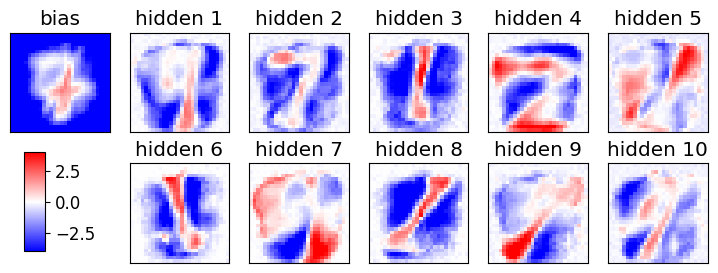

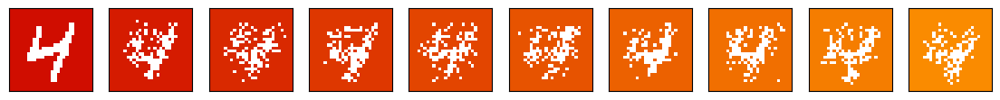

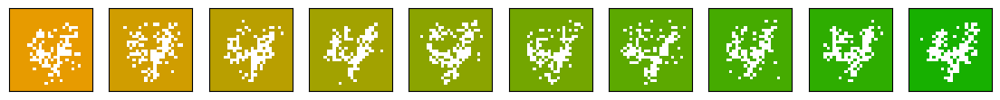

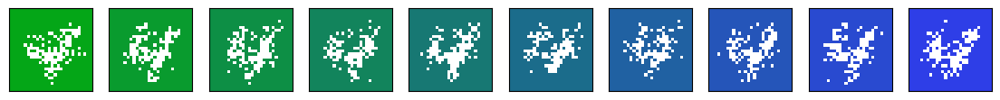

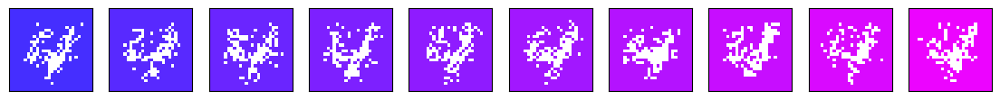

L: 10     amplification of weights: 1.0


In [ ]:
ee=-1
NN=200
traj_x,traj_z = np.zeros((NN+2,D)), np.zeros((NN+2,L))
xf=np.copy(data[np.random.randint(Nd)])
traj_x[0]=np.copy(xf)

# AF: multiply weights and biases by a number >1 to achieve a more deterministic behavior,
# equivalent to lower the temperature in a Boltzmann weight -> select lowest energies
# Note: here, this is done in the negative CD step only
AF=1.

for t in range(NN):
    t1=t+1
    # positive CD phase: generating fantasy zf from fantasy xf
    zf = CD_step(xf,1*wE[ee],1*bE[ee],POTTS=POTTS)
    traj_z[t] = np.copy(zf)
    # negative CD pzase: generating fantasy xf from fantasy zf
    xf = CD_step(zf,AF*wE[ee].T,AF*aE[ee])
    traj_x[t1] = np.copy(xf)


plot_weights_bias(wE, aE, Nepoch, L, cols=Ncols, save=False)

col0,col1,col2,col3,col4=(0.8,0,0,1),(1,0.6,0,1),(0,.7,0,1),(0.2,0.2,1,1),(1,0,1,1)
show_MNIST(traj_x[0:],Nex=10,colors=(col0,col1))
show_MNIST(traj_x[10:],Nex=10,colors=(col1,col2))
show_MNIST(traj_x[20:],Nex=10,colors=(col2,col3))
show_MNIST(traj_x[40:],Nex=10,colors=(col3,col4))
print("L:",L,"    amplification of weights:",AF)

## Plot of the gradient amplitude

NE= 150


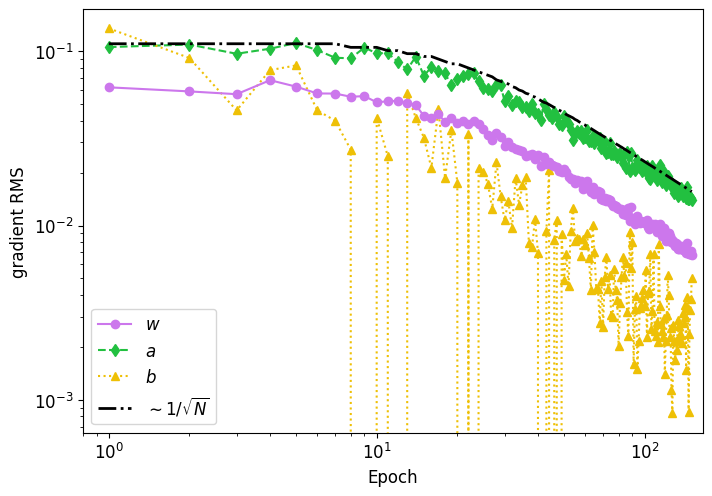

FIG/RBM_grad_MNIST3_E150_N10-500_RMSprop-0.05-0.05_CD-2_L10_reg0.001.png


In [ ]:
def make_fname(strin):
    fname="FIG/RBM_"+strin+"_MNIST"+str(Ndigit)+"_E"+str(NE)+"_N"+str(N_ini)+"-"+str(N_fin)
    fname=fname+"_"+GRAD+"-"+str(l_rate_ini)+"-"+str(l_rate_fin)+"_CD-"+str(Nt)+"_L"+str(L)
    if gamma>0:  fname=fname+"_reg"+str(gamma)
    return fname+".png"

NE = len(gwE)-1
print("NE=",NE)
mgw,mga,mgb,epo=np.zeros(NE),np.zeros(NE),np.zeros(NE),np.zeros(NE)
DE=1
if NE>30: DE=2
if NE>50: DE=5
if NE>100: DE=10
# compute RMS average of gradients during epochs
for ep in range(1,1+NE):
    epo[ep-1]=ep
    mgw[ep-1] = np.std(gwE[ep])
    mga[ep-1] = np.std(gaE[ep])
    mgb[ep-1] = np.std(gbE[ep])

#############################################################################
# creating grid for subplots
fig, ax = plt.subplots(1, 1, figsize=(8,5.5))
fig.subplots_adjust( left=None, bottom=None,  right=None, top=None, wspace=None, hspace=None)

ax.xaxis.set_major_locator(mpl.ticker.MultipleLocator(DE))
ax.plot(epo,mgw,"o-",c="#CC77EC",label="$w$",zorder=10)
ax.plot(epo,mga,"d--",c="#22C040",label="$a$",zorder=5)
ax.plot(epo,mgb,"^:",c="#EEC006",label="$b$",zorder=8)
ax.plot(epo,.35/sqrt(miniE[1:]),"k-.",label="$\sim 1 / \sqrt{N}$",zorder=20,lw=2)
ax.set_xlabel("Epoch")
ax.set_ylabel("gradient RMS")
ax.set_xlim(0.5,NE+0.5)
if 1==2: ax.set_ylim(0,)
else:
    ax.set_xlim(0.8,Nepoch*1.1)
    ax.set_xscale("log")
    ax.set_yscale("log")
ax.legend()

fname=make_fname("grad")
fig.savefig(fname,dpi=200,bbox_inches='tight',pad_inches=0.02, transparent=False)
plt.show()
print(fname)

## Log-likelihood calculation

In [53]:
import numpy as np
from tqdm import tqdm
import itertools as it
from scipy.optimize import curve_fit
from numba import jit

def compute_log_likelihood(w, a, b, data):

    D = w.shape[0]      #  visible units
    L = w.shape[1]    #  hidden units
    M = data.shape[0]      # data

    all_z = np.array(list(it.product((0, 1), repeat=L)), dtype=np.float64)  ### il dtype serve per numba
    log_likelihoods = []

    sample_size=int(M/4) #### take 1/4 of the data for each epoch
    idx = np.random.choice(M, sample_size, replace=False)
    data_sample = data[idx]
    log_likelihoods = []

    for m in tqdm(range(len(data_sample)), desc='Computing log-likelihood'):
        x = data_sample[m]
        log_likelihoods.append(compute_single_log_likelihood(w, a, b, x, all_z, D, L))


    return np.mean(log_likelihoods)

@jit(nopython=True)
def compute_single_log_likelihood(w, a, b, x, all_z, D, L):

    q_samples = []
    for i in range(min(100, D)):  # Sample a few visible units
        for z_idx in range(min(10, 2**L)):  # Sample a few hidden states
            z = all_z[z_idx]
            H_i = a[i] + np.dot(w[i], z)
            q_samples.append(1 + np.exp(H_i))
    q = np.mean(np.array(q_samples))


    first_term = compute_free_energy_term(w, a, b, x, all_z, q, D)
    second_term = -compute_partition_function(w, a, b, all_z, q, D)

    return first_term + second_term



# if SPINS:
#     x_min=-1
#     level_gap=2.
# else:
#     x_min=0
#     level_gap=1.


@jit(nopython=True)
def compute_partition_function(w, a, b, all_z, q, D):

    sum_term = 0

    for z in all_z:
        G_z=1.0
        for i in range(L):
            G_z *= np.exp(b[i] * z[i])

        product_term = 1.0
        for i in range(D):
            H_i = a[i] + np.dot(w[i], z)
            product_term *= (1 + np.exp(H_i)) / q

        sum_term += G_z * product_term

    return D * np.log(q) + np.log(sum_term)

@jit(nopython=True)
def compute_free_energy_term(w, a, b, x, all_z, q, D):
    """
    Compute the free energy term using log-space arithmetic for numerical stability.
    This implements the formula: e^(-E(x,z)) = ∏_μ e^(b_μ*z_μ) * ∏_i e^(H_i(z)*x_i)
    """
    # Use log-sum-exp trick for numerical stability
    log_terms = np.zeros(len(all_z))

    for z_idx in range(len(all_z)):
        z = all_z[z_idx]

        # Compute log G(z) = log(∏_μ e^(b_μ*z_μ)) = ∑_μ b_μ*z_μ
        log_G_z = np.sum(b * z)

        # Compute log product term for visible units
        log_product = 0.0
        for i in range(D):
            if x[i] == 1:  # Only consider where x = 1
                H_i = a[i] + np.dot(w[i], z)
                log_product += H_i
            #if x[i] == -1:  # Only consider where x = -1
            #    H_i = a[i] + np.dot(w[i], z)
            #    log_product += (-H_i)
            ### case x=0 we have 0 (log(e^(H_z*x)=0))

        # Total log term for this z
        log_terms[z_idx] = log_G_z + log_product

    # Log-sum-exp trick: log(∑_i e^x_i) = a + log(∑_i e^(x_i - a))
    # where a = max(x_i) to prevent overflow
    if len(log_terms) > 0:
        max_log_term = np.max(log_terms)
        # Avoid -inf if all terms are -inf
        if max_log_term == -np.inf:
            return -np.inf

        sum_exp = np.sum(np.exp(log_terms - max_log_term))
        return max_log_term + np.log(sum_exp)
    else:
        return -np.inf  # If no hidden states, return -inf

## Likelihood evolution during the whole training  

In [ ]:
# Log-likelihood evolution for different L and fixed CD steps = 2
log_like_L=[]
for L in L_v:
    Nt=2
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like=[]
    num_epo=[]
    Nepoch=150
    n=3  ### take 1/3 of the epoch
    for i in range(Nepoch):
        if i%n==0:
            print(f'Epoch n.{i}')
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            log_like.append(ll)
            num_epo.append(i)
            print('Log-likelihood=',ll)
    log_like_L.append(log_like)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2280.19it/s]


Log-likelihood= -167.46639562353087
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3031.66it/s]


Log-likelihood= -153.30224022268249
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2167.52it/s]


Log-likelihood= -149.29984189944383
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2140.84it/s]


Log-likelihood= -145.3430656562798
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2228.00it/s]


Log-likelihood= -150.69288269856673
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2207.40it/s]


Log-likelihood= -147.58903653630878
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2150.40it/s]


Log-likelihood= -140.05929497579703
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2251.94it/s]


Log-likelihood= -143.16418878267984
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.40it/s]


Log-likelihood= -141.55624860080403
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.57it/s]


Log-likelihood= -141.1333456533539
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2291.30it/s]


Log-likelihood= -141.77690018303306
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2282.77it/s]


Log-likelihood= -141.30056009011076
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2296.67it/s]


Log-likelihood= -137.69138747338388
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2315.90it/s]


Log-likelihood= -141.56208266171464
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3284.75it/s]


Log-likelihood= -137.1427448730522
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2332.22it/s]


Log-likelihood= -136.6715776585117
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2315.67it/s]


Log-likelihood= -135.60655794490071
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.72it/s]


Log-likelihood= -136.97555370675877
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2188.37it/s]


Log-likelihood= -136.72116198230265
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2232.07it/s]


Log-likelihood= -136.72376396073773
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2250.15it/s]


Log-likelihood= -137.59913726517547
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2214.07it/s]


Log-likelihood= -134.23329747002762
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2227.49it/s]


Log-likelihood= -136.91135119613836
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2308.85it/s]


Log-likelihood= -136.4325580927051
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2266.59it/s]


Log-likelihood= -137.56143278022006
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2274.37it/s]


Log-likelihood= -137.93122748254368
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2304.04it/s]


Log-likelihood= -134.52485713619993
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2256.80it/s]


Log-likelihood= -135.90228161247612
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3173.75it/s]


Log-likelihood= -136.1987229107427
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2242.66it/s]


Log-likelihood= -135.8655752782017
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2261.64it/s]


Log-likelihood= -136.20254188139637
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2271.02it/s]


Log-likelihood= -137.36244353253431
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2234.97it/s]


Log-likelihood= -136.2697933295724
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2209.58it/s]


Log-likelihood= -134.67619643569626
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2284.95it/s]


Log-likelihood= -136.39688289020455
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2247.28it/s]


Log-likelihood= -137.24671766643695
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2282.35it/s]


Log-likelihood= -137.6385311930961
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2300.91it/s]


Log-likelihood= -136.50771150303032
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2290.03it/s]


Log-likelihood= -134.9666097243515
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2267.83it/s]


Log-likelihood= -137.65680609790834
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2324.19it/s]


Log-likelihood= -137.83050152876964
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3381.49it/s]


Log-likelihood= -136.80611264490508
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.18it/s]


Log-likelihood= -135.14433081288252
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2207.03it/s]


Log-likelihood= -136.78365084933301
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2292.97it/s]


Log-likelihood= -136.033221252348
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2299.29it/s]


Log-likelihood= -137.88975363858924
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2305.90it/s]


Log-likelihood= -138.22442290638955
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2260.70it/s]


Log-likelihood= -134.07610994198214
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2280.65it/s]


Log-likelihood= -136.4088892031857
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2286.85it/s]


Log-likelihood= -135.02388182467786
a_all L=4, Nt=2
b_all L=4, Nt=2
w_all L=4, Nt=2
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.69it/s]


Log-likelihood= -167.26125039459475
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.18it/s]


Log-likelihood= -148.77345297407734
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1432.00it/s]


Log-likelihood= -147.61714540077304
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1189.97it/s]


Log-likelihood= -143.75963014000584
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.74it/s]


Log-likelihood= -145.5370454305124
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1200.22it/s]


Log-likelihood= -144.96919542433898
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1190.84it/s]


Log-likelihood= -141.04234989525747
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1189.70it/s]


Log-likelihood= -140.5357499277552
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1184.69it/s]


Log-likelihood= -139.92773109301754
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1412.31it/s]


Log-likelihood= -141.95504743208537
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1190.35it/s]


Log-likelihood= -139.5026635748997
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1174.03it/s]


Log-likelihood= -136.44388147599682
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1170.81it/s]


Log-likelihood= -138.83589854796577
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1184.39it/s]


Log-likelihood= -135.7087432673348
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1181.95it/s]


Log-likelihood= -134.73380955122218
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1131.83it/s]


Log-likelihood= -135.58305724904383
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1387.22it/s]


Log-likelihood= -135.03017099736775
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1150.97it/s]


Log-likelihood= -134.6562744112458
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 1077.46it/s]


Log-likelihood= -132.84599022684125
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 1060.63it/s]


Log-likelihood= -134.51691531235366
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1108.46it/s]


Log-likelihood= -133.39991380595978
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1118.54it/s]


Log-likelihood= -133.2852116218248
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1175.80it/s]


Log-likelihood= -133.12045972615263
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1379.67it/s]


Log-likelihood= -135.09635183992629
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1152.33it/s]


Log-likelihood= -129.49054341069063
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1125.83it/s]


Log-likelihood= -130.0545602880187
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1114.32it/s]


Log-likelihood= -127.66314905670576
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1122.44it/s]


Log-likelihood= -126.49595231999798
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.79it/s]


Log-likelihood= -126.06259645661025
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1369.52it/s]


Log-likelihood= -124.3657674628067
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.26it/s]


Log-likelihood= -126.86064155614153
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1185.44it/s]


Log-likelihood= -125.45877064842979
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1180.45it/s]


Log-likelihood= -128.0072845909842
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1182.41it/s]


Log-likelihood= -125.78873955730435
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1148.32it/s]


Log-likelihood= -126.91742723121247
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1160.25it/s]


Log-likelihood= -126.00329361906314
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1356.74it/s]


Log-likelihood= -126.64954811875906
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1151.46it/s]


Log-likelihood= -129.0202605155102
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1172.66it/s]


Log-likelihood= -126.58428108969552
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1165.97it/s]


Log-likelihood= -128.6863052766173
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1170.64it/s]


Log-likelihood= -126.13036819979084
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1124.60it/s]


Log-likelihood= -125.22974573596422
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1207.37it/s]


Log-likelihood= -125.37308332774235
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1441.02it/s]


Log-likelihood= -126.21824197434125
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.27it/s]


Log-likelihood= -126.10343220627901
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1181.40it/s]


Log-likelihood= -127.99399667538816
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1188.43it/s]


Log-likelihood= -128.41999321157178
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1164.82it/s]


Log-likelihood= -127.53934006948327
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1168.32it/s]


Log-likelihood= -128.02000937694777
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1166.47it/s]


Log-likelihood= -129.33495177433497
a_all L=5, Nt=2
b_all L=5, Nt=2
w_all L=5, Nt=2
Epoch n.0


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.59it/s]


Log-likelihood= -167.9604557873782
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 586.55it/s]


Log-likelihood= -143.5042434936922
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 574.88it/s]


Log-likelihood= -136.77885881200825
Epoch n.9


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 645.41it/s]


Log-likelihood= -132.49927277964917
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 590.51it/s]


Log-likelihood= -128.61238634453
Epoch n.15


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 565.80it/s]


Log-likelihood= -130.62356924898205
Epoch n.18


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 496.62it/s]


Log-likelihood= -131.19865517214126
Epoch n.21


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 541.49it/s]


Log-likelihood= -131.11616339519205
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 557.63it/s]


Log-likelihood= -128.49605809907396
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 569.94it/s]


Log-likelihood= -129.5130036082506
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 624.45it/s]


Log-likelihood= -128.43256711944255
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 596.41it/s]


Log-likelihood= -125.50002278744955
Epoch n.36


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 573.86it/s]


Log-likelihood= -128.910749525361
Epoch n.39


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 603.61it/s]


Log-likelihood= -126.53231120632095
Epoch n.42


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 577.28it/s]


Log-likelihood= -124.67885994690177
Epoch n.45


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 584.58it/s]


Log-likelihood= -125.02436451796235
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.68it/s]


Log-likelihood= -125.6665963522175
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 574.92it/s]


Log-likelihood= -123.47014892566231
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 571.20it/s]


Log-likelihood= -126.03663121646501
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 561.37it/s]


Log-likelihood= -127.10812293689811
Epoch n.60


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.88it/s]


Log-likelihood= -128.47155501728233
Epoch n.63


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 592.78it/s]


Log-likelihood= -126.95461203569256
Epoch n.66


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 571.65it/s]


Log-likelihood= -125.64471865575088
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.60it/s]


Log-likelihood= -126.66414488330328
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 589.28it/s]


Log-likelihood= -124.55211452247848
Epoch n.75


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 591.06it/s]


Log-likelihood= -126.32281053476883
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 595.79it/s]


Log-likelihood= -127.85108433738776
Epoch n.81


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 644.83it/s]


Log-likelihood= -124.87571501674472
Epoch n.84


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 598.83it/s]


Log-likelihood= -124.74612735076407
Epoch n.87


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 603.76it/s]


Log-likelihood= -126.15168095391516
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 658.52it/s]


Log-likelihood= -125.69035484521923
Epoch n.93


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 599.35it/s]


Log-likelihood= -126.14069030107638
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 602.24it/s]


Log-likelihood= -124.98345671464735
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 602.85it/s]


Log-likelihood= -125.70115001417682
Epoch n.102


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 645.11it/s]


Log-likelihood= -124.9216315247487
Epoch n.105


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 542.38it/s]


Log-likelihood= -125.38063556297514
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 559.03it/s]


Log-likelihood= -124.04439094010988
Epoch n.111


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 636.08it/s]


Log-likelihood= -123.85892306720173
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 570.04it/s]


Log-likelihood= -125.25141806112585
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 582.36it/s]


Log-likelihood= -127.23410167913582
Epoch n.120


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 635.96it/s]


Log-likelihood= -125.7484513479046
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 592.36it/s]


Log-likelihood= -125.42903242262395
Epoch n.126


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 591.35it/s]


Log-likelihood= -124.25994691569801
Epoch n.129


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 590.52it/s]


Log-likelihood= -126.7666258569637
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 651.90it/s]


Log-likelihood= -124.51464281149165
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 577.32it/s]


Log-likelihood= -126.07712993983777
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 569.21it/s]


Log-likelihood= -126.0503506054616
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 648.56it/s]


Log-likelihood= -124.46543897791452
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 562.36it/s]


Log-likelihood= -124.34722579993863
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 523.01it/s]


Log-likelihood= -124.68819871754732
a_all L=6, Nt=2
b_all L=6, Nt=2
w_all L=6, Nt=2
Epoch n.0


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 322.78it/s]


Log-likelihood= -167.82839428146056
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 303.20it/s]


Log-likelihood= -140.02720427633028
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 320.24it/s]


Log-likelihood= -139.66024198229758
Epoch n.9


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.12it/s]


Log-likelihood= -133.99796869952323
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.58it/s]


Log-likelihood= -134.85249625199745
Epoch n.15


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.19it/s]


Log-likelihood= -137.81450787649985
Epoch n.18


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 287.92it/s]


Log-likelihood= -134.4462238555384
Epoch n.21


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 288.60it/s]


Log-likelihood= -139.15994837219736
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 285.18it/s]


Log-likelihood= -138.55250615237324
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.61it/s]


Log-likelihood= -135.35959551490959
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 300.52it/s]


Log-likelihood= -134.93654412212754
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 286.25it/s]


Log-likelihood= -131.7890678374308
Epoch n.36


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 305.07it/s]


Log-likelihood= -134.26209234113696
Epoch n.39


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.58it/s]


Log-likelihood= -134.81862858782102
Epoch n.42


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 302.06it/s]


Log-likelihood= -132.4071999881581
Epoch n.45


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.68it/s]


Log-likelihood= -133.0928308193174
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.90it/s]


Log-likelihood= -136.71855341501146
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.46it/s]


Log-likelihood= -135.83997309166426
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.29it/s]


Log-likelihood= -135.58276440216045
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 306.78it/s]


Log-likelihood= -134.7011766685891
Epoch n.60


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.35it/s]


Log-likelihood= -132.37018226431397
Epoch n.63


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.38it/s]


Log-likelihood= -132.8623054511501
Epoch n.66


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.66it/s]


Log-likelihood= -133.73405974673514
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.48it/s]


Log-likelihood= -137.70880844162517
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.89it/s]


Log-likelihood= -133.76906177904385
Epoch n.75


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.28it/s]


Log-likelihood= -135.82329007814937
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.90it/s]


Log-likelihood= -140.06562351979912
Epoch n.81


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.91it/s]


Log-likelihood= -136.7601991257981
Epoch n.84


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 308.84it/s]


Log-likelihood= -141.72971189372228
Epoch n.87


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.68it/s]


Log-likelihood= -135.3718838464157
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.76it/s]


Log-likelihood= -133.20323607427235
Epoch n.93


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 310.32it/s]


Log-likelihood= -130.68581203146934
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.24it/s]


Log-likelihood= -136.00155483357682
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 311.95it/s]


Log-likelihood= -131.85581557846106
Epoch n.102


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 295.76it/s]


Log-likelihood= -129.7339999000464
Epoch n.105


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 304.72it/s]


Log-likelihood= -126.35954185361607
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 297.11it/s]


Log-likelihood= -128.4595016307388
Epoch n.111


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.95it/s]


Log-likelihood= -126.88807938696806
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 309.86it/s]


Log-likelihood= -125.6899529317442
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.28it/s]


Log-likelihood= -125.33446792789417
Epoch n.120


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.47it/s]


Log-likelihood= -126.5738726445217
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 296.63it/s]


Log-likelihood= -123.80593995360576
Epoch n.126


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 303.49it/s]


Log-likelihood= -123.88324928984012
Epoch n.129


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 300.28it/s]


Log-likelihood= -125.04275814144907
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 309.60it/s]


Log-likelihood= -127.71518491849886
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 307.98it/s]


Log-likelihood= -128.5612008303615
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 299.72it/s]


Log-likelihood= -125.00912256109461
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.75it/s]


Log-likelihood= -127.23541300316028
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 306.18it/s]


Log-likelihood= -125.47838408069725
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 320.70it/s]


Log-likelihood= -124.6727540876417
a_all L=8, Nt=2
b_all L=8, Nt=2
w_all L=8, Nt=2
Epoch n.0


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.98it/s]


Log-likelihood= -167.56168703669934
Epoch n.3


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.28it/s]


Log-likelihood= -142.83786419910177
Epoch n.6


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.15it/s]


Log-likelihood= -134.7137184134017
Epoch n.9


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:07<00:00, 81.02it/s]


Log-likelihood= -126.24903892914352
Epoch n.12


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.19it/s]


Log-likelihood= -128.88253273724231
Epoch n.15


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.60it/s]


Log-likelihood= -128.1742339970567
Epoch n.18


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.69it/s]


Log-likelihood= -128.95560229909577
Epoch n.21


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.86it/s]


Log-likelihood= -128.8181546339894
Epoch n.24


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.97it/s]


Log-likelihood= -128.4414534003503
Epoch n.27


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.28it/s]


Log-likelihood= -130.52554058391286
Epoch n.30


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.90it/s]


Log-likelihood= -128.2534474542727
Epoch n.33


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.48it/s]


Log-likelihood= -130.48209457945973
Epoch n.36


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.80it/s]


Log-likelihood= -125.76439216651129
Epoch n.39


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.29it/s]


Log-likelihood= -126.71267336416649
Epoch n.42


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.27it/s]


Log-likelihood= -128.1705110812231
Epoch n.45


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.83it/s]


Log-likelihood= -126.45442284978765
Epoch n.48


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.08it/s]


Log-likelihood= -128.3739525610633
Epoch n.51


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.37it/s]


Log-likelihood= -128.664186336212
Epoch n.54


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.18it/s]


Log-likelihood= -131.55238834556386
Epoch n.57


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -127.50814445454051
Epoch n.60


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.27it/s]


Log-likelihood= -129.170238548205
Epoch n.63


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.55it/s]


Log-likelihood= -131.6875389651791
Epoch n.66


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.14it/s]


Log-likelihood= -129.65844807103835
Epoch n.69


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.48it/s]


Log-likelihood= -125.78235323946345
Epoch n.72


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.91it/s]


Log-likelihood= -130.29459529188648
Epoch n.75


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.49it/s]


Log-likelihood= -131.34455808758614
Epoch n.78


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.65it/s]


Log-likelihood= -126.9536172816826
Epoch n.81


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.48it/s]


Log-likelihood= -129.07105531107402
Epoch n.84


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.25it/s]


Log-likelihood= -128.17530346076106
Epoch n.87


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.20it/s]


Log-likelihood= -126.02669720337981
Epoch n.90


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.79it/s]


Log-likelihood= -131.33470877085202
Epoch n.93


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.27it/s]


Log-likelihood= -128.11064690394153
Epoch n.96


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.20it/s]


Log-likelihood= -130.0169910334589
Epoch n.99


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -131.84500780429315
Epoch n.102


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.18it/s]


Log-likelihood= -128.82380969991922
Epoch n.105


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.09it/s]


Log-likelihood= -132.14912456756852
Epoch n.108


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.53it/s]


Log-likelihood= -133.26551384704422
Epoch n.111


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.36it/s]


Log-likelihood= -133.2026034645289
Epoch n.114


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.15it/s]


Log-likelihood= -133.92757163398437
Epoch n.117


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.35it/s]


Log-likelihood= -133.39419064156726
Epoch n.120


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.25it/s]


Log-likelihood= -136.0273791310948
Epoch n.123


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.58it/s]


Log-likelihood= -135.303745555103
Epoch n.126


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.13it/s]


Log-likelihood= -135.6643037995829
Epoch n.129


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.06it/s]


Log-likelihood= -135.8692238818429
Epoch n.132


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.54it/s]


Log-likelihood= -138.0868459747056
Epoch n.135


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.15it/s]


Log-likelihood= -140.62545217619865
Epoch n.138


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.29it/s]


Log-likelihood= -143.24514671460466
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 78.79it/s]


Log-likelihood= -138.7612876385819
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.47it/s]


Log-likelihood= -139.71833383593813
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.42it/s]


Log-likelihood= -143.29595281618663
a_all L=10, Nt=2
b_all L=10, Nt=2
w_all L=10, Nt=2
Epoch n.0


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.29it/s]


Log-likelihood= -168.02160816075647
Epoch n.3


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.54it/s]


Log-likelihood= -136.49303448120102
Epoch n.6


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:44<00:00, 19.33it/s]


Log-likelihood= -124.54118527537752
Epoch n.9


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.16it/s]


Log-likelihood= -123.2101202445941
Epoch n.12


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.14it/s]


Log-likelihood= -126.51225332670599
Epoch n.15


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -125.12327950438193
Epoch n.18


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.26it/s]


Log-likelihood= -124.40559293652244
Epoch n.21


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:45<00:00, 19.23it/s]


Log-likelihood= -127.38053124263723
Epoch n.24


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -125.1567271303564
Epoch n.27


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.16it/s]


Log-likelihood= -121.98535241443783
Epoch n.30


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.18it/s]


Log-likelihood= -123.60695775429551
Epoch n.33


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:48<00:00, 19.05it/s]


Log-likelihood= -129.92706931389054
Epoch n.36


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:48<00:00, 19.04it/s]


Log-likelihood= -130.94066255096385
Epoch n.39


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.10it/s]


Log-likelihood= -132.80274194612247
Epoch n.42


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:49<00:00, 18.97it/s]


Log-likelihood= -131.06788914719718
Epoch n.45


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.76it/s]


Log-likelihood= -130.34176869750894
Epoch n.48


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:55<00:00, 18.63it/s]


Log-likelihood= -126.19269970250967
Epoch n.51


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:50<00:00, 18.94it/s]


Log-likelihood= -128.69649993706233
Epoch n.54


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:52<00:00, 18.77it/s]


Log-likelihood= -130.84296852633315
Epoch n.57


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:47<00:00, 19.14it/s]


Log-likelihood= -124.85462726189246
Epoch n.60


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.72it/s]


Log-likelihood= -126.11755522589188
Epoch n.63


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:58<00:00, 18.44it/s]


Log-likelihood= -125.34316467014854
Epoch n.66


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:46<00:00, 19.19it/s]


Log-likelihood= -121.38894789975254
Epoch n.69


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:42<00:00, 19.47it/s]


Log-likelihood= -123.22057435781281
Epoch n.72


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -125.12626840611875
Epoch n.75


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.99it/s]


Log-likelihood= -125.49042897052719
Epoch n.78


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -123.69047746321647
Epoch n.81


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:36<00:00, 19.92it/s]


Log-likelihood= -124.52384664143102
Epoch n.84


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -123.84783020367134
Epoch n.87


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -121.14757321357567
Epoch n.90


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -121.07578731147076
Epoch n.93


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -118.55811729408404
Epoch n.96


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.03it/s]


Log-likelihood= -116.78297451371358
Epoch n.99


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -119.48616377020674
Epoch n.102


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.92it/s]


Log-likelihood= -114.13198262910228
Epoch n.105


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.05it/s]


Log-likelihood= -116.30035041097378
Epoch n.108


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.02it/s]


Log-likelihood= -116.30145241891645
Epoch n.111


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.00it/s]


Log-likelihood= -119.42028825152487
Epoch n.114


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.03it/s]


Log-likelihood= -116.14413511129851
Epoch n.117


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -118.27649553258439
Epoch n.120


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -116.78625212743452
Epoch n.123


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -116.23294539232789
Epoch n.126


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -120.18589175574884
Epoch n.129


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -119.71331765630502
Epoch n.132


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.98it/s]


Log-likelihood= -121.27313234672091
Epoch n.135


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -117.06862339922307
Epoch n.138


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:33<00:00, 20.08it/s]


Log-likelihood= -116.79509888869605
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.01it/s]


Log-likelihood= -118.99634972903671
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:36<00:00, 19.91it/s]


Log-likelihood= -114.57554406077575
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:35<00:00, 19.95it/s]

Log-likelihood= -119.01322526073503


In [ ]:
log_like_cd=[]

# Log-likelihood evolution for fixed L=3 and different CD steps

for L in L_v:
    if L==3:
        for Nt in Nt_v:
            a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
            b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
            w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

            log_like=[]
            num_epo=[]
            Nepoch=150
            n=3  ### take 1/3 of the epoch
            for i in range(Nepoch):
                if i%n==0:
                    print(f'Epoch n.{i}')
                    ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
                    log_like.append(ll)
                    num_epo.append(i)
                    print('Log-likelihood=',ll)
            log_like_cd.append(log_like)

a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.0


Computing log-likelihood:   0%|                                                                | 0/5498 [00:00<?, ?it/s]/tmp/ipykernel_681/779657587.py:41: NumbaPerformanceWarning: np.dot() is faster on contiguous arrays, called on (Array(float64, 1, 'C', False, aligned=True), Array(float64, 1, 'A', False, aligned=True))
  second_term = -compute_partition_function(w, a, b, all_z, q, D)
Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:07<00:00, 770.57it/s]


Log-likelihood= -167.0619582470125
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.37it/s]


Log-likelihood= -153.91380773196778
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 910.76it/s]


Log-likelihood= -150.79911203045867
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.20it/s]


Log-likelihood= -146.18286317167184
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1263.60it/s]


Log-likelihood= -150.7975139446413
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.64it/s]


Log-likelihood= -145.83368565576026
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1240.14it/s]


Log-likelihood= -141.8379678125805
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.99it/s]


Log-likelihood= -143.07079172851942
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.20it/s]


Log-likelihood= -140.99871912316317
Epoch n.27


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 949.04it/s]


Log-likelihood= -142.12682516332038
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.82it/s]


Log-likelihood= -142.22555042710545
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.07it/s]


Log-likelihood= -140.4195790171541
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.18it/s]


Log-likelihood= -136.61794028844332
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1203.60it/s]


Log-likelihood= -140.7232094456506
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.89it/s]


Log-likelihood= -137.02533088838942
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.04it/s]


Log-likelihood= -137.24895116667676
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 906.42it/s]


Log-likelihood= -135.54764095984305
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.00it/s]


Log-likelihood= -137.10179325629935
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1211.42it/s]


Log-likelihood= -136.4280190549347
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.77it/s]


Log-likelihood= -136.0602139530983
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1211.36it/s]


Log-likelihood= -136.78500666781412
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1191.30it/s]


Log-likelihood= -134.84579821080163
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1188.08it/s]


Log-likelihood= -137.9025134591677
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 907.00it/s]


Log-likelihood= -136.38151146505055
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1214.63it/s]


Log-likelihood= -135.99726567713552
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1283.27it/s]


Log-likelihood= -137.06047926507108
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1280.33it/s]


Log-likelihood= -135.30578629736476
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.05it/s]


Log-likelihood= -137.31241494184835
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.18it/s]


Log-likelihood= -136.47912744683077
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.31it/s]


Log-likelihood= -136.41121429688255
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 952.78it/s]


Log-likelihood= -136.17395894916874
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1277.62it/s]


Log-likelihood= -138.0128243180918
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.26it/s]


Log-likelihood= -136.45627614196752
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.80it/s]


Log-likelihood= -135.18712117774922
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1290.66it/s]


Log-likelihood= -135.66665644578342
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.38it/s]


Log-likelihood= -136.1487433065035
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.72it/s]


Log-likelihood= -137.32125230815697
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.89it/s]


Log-likelihood= -136.39701093756725
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 937.73it/s]


Log-likelihood= -136.0396811463683
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.36it/s]


Log-likelihood= -137.0263635392604
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.57it/s]


Log-likelihood= -137.27674244462864
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.63it/s]


Log-likelihood= -136.3430194145506
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.73it/s]


Log-likelihood= -134.91024641798245
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.12it/s]


Log-likelihood= -136.45110741263926
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.69it/s]


Log-likelihood= -135.25465109010926
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 970.00it/s]


Log-likelihood= -138.50978350410554
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1204.74it/s]


Log-likelihood= -137.53445534268457
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1315.34it/s]


Log-likelihood= -135.25248446687726
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1293.21it/s]


Log-likelihood= -134.7393113270953
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1349.08it/s]


Log-likelihood= -135.50172222870538
a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1283.75it/s]


Log-likelihood= -167.36940146232564
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.07it/s]


Log-likelihood= -151.43773272715717
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 896.82it/s]


Log-likelihood= -144.3845672898909
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1198.08it/s]


Log-likelihood= -143.56116545836343
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1269.06it/s]


Log-likelihood= -143.3527488061263
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1300.68it/s]


Log-likelihood= -144.96469604835798
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.40it/s]


Log-likelihood= -142.3012742833728
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.85it/s]


Log-likelihood= -144.398954662032
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.93it/s]


Log-likelihood= -141.7963459418535
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.79it/s]


Log-likelihood= -136.9520382794936
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 891.64it/s]


Log-likelihood= -135.63967127927643
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.67it/s]


Log-likelihood= -136.30290107990388
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1333.90it/s]


Log-likelihood= -133.89693107867691
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.42it/s]


Log-likelihood= -134.99542196672812
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.53it/s]


Log-likelihood= -133.84014328659825
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.52it/s]


Log-likelihood= -133.29639517749263
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.71it/s]


Log-likelihood= -136.0565559487416
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 898.17it/s]


Log-likelihood= -134.6582134468092
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.51it/s]


Log-likelihood= -135.177865176888
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.43it/s]


Log-likelihood= -132.00759638737156
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.68it/s]


Log-likelihood= -133.59414596591458
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1313.61it/s]


Log-likelihood= -131.81053497207705
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1284.74it/s]


Log-likelihood= -133.43774761751385
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.19it/s]


Log-likelihood= -131.84274459764572
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 867.37it/s]


Log-likelihood= -134.4900621721476
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.81it/s]


Log-likelihood= -132.17387960725944
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.63it/s]


Log-likelihood= -130.82083706899934
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.74it/s]


Log-likelihood= -132.4570817997721
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1270.64it/s]


Log-likelihood= -132.46815091715993
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.71it/s]


Log-likelihood= -131.7122546405801
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.46it/s]


Log-likelihood= -132.73711857846368
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.65it/s]


Log-likelihood= -136.3271404346707
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 839.53it/s]


Log-likelihood= -131.37788768183972
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1214.22it/s]


Log-likelihood= -131.6937956044197
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.28it/s]


Log-likelihood= -132.68132608309315
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1230.24it/s]


Log-likelihood= -133.2517339791439
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.40it/s]


Log-likelihood= -131.1810143942101
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.16it/s]


Log-likelihood= -132.44167619085445
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.44it/s]


Log-likelihood= -132.66020855132223
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 956.63it/s]


Log-likelihood= -132.3814993435518
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.37it/s]


Log-likelihood= -132.50923720927764
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.09it/s]


Log-likelihood= -131.42889961780284
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.71it/s]


Log-likelihood= -132.5620227199188
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.10it/s]


Log-likelihood= -132.43300186401777
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.91it/s]


Log-likelihood= -133.42060307796527
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.80it/s]


Log-likelihood= -132.09346580783387
Epoch n.138


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 901.65it/s]


Log-likelihood= -131.87058058883463
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.32it/s]


Log-likelihood= -134.57359530666105
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1274.77it/s]


Log-likelihood= -130.6430868309253
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.11it/s]


Log-likelihood= -131.71583986828782
a_all L=3, Nt=6
b_all L=3, Nt=6
w_all L=3, Nt=6
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.86it/s]


Log-likelihood= -166.7634028764675
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.69it/s]


Log-likelihood= -151.15352518686646
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1266.06it/s]


Log-likelihood= -146.27894989351333
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.21it/s]


Log-likelihood= -142.690763221806
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 897.87it/s]


Log-likelihood= -147.71445502255128
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1278.30it/s]


Log-likelihood= -141.4454504162074
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.10it/s]


Log-likelihood= -142.45002446620478
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.77it/s]


Log-likelihood= -144.102879912941
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.02it/s]


Log-likelihood= -141.17957245293158
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.81it/s]


Log-likelihood= -140.6371147404727
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.23it/s]


Log-likelihood= -140.62353996101098
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 917.21it/s]


Log-likelihood= -139.85141189192692
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.81it/s]


Log-likelihood= -139.5033773228586
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.90it/s]


Log-likelihood= -140.37725486133374
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.09it/s]


Log-likelihood= -137.50988469891493
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.98it/s]


Log-likelihood= -135.0570553043074
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.95it/s]


Log-likelihood= -136.99723130659953
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.13it/s]


Log-likelihood= -136.55809345366367
Epoch n.54


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 916.64it/s]


Log-likelihood= -136.42198081143192
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1240.09it/s]


Log-likelihood= -137.28494160963143
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1229.15it/s]


Log-likelihood= -140.75155583266866
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.45it/s]


Log-likelihood= -139.42824707760516
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.01it/s]


Log-likelihood= -137.13251909571457
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.73it/s]


Log-likelihood= -136.08375759162547
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.79it/s]


Log-likelihood= -136.37213302683818
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.42it/s]


Log-likelihood= -136.59410698361526
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 879.84it/s]


Log-likelihood= -136.00938083701752
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.33it/s]


Log-likelihood= -137.5678988128239
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1236.84it/s]


Log-likelihood= -136.10471054977847
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1256.47it/s]


Log-likelihood= -137.29371668635915
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.31it/s]


Log-likelihood= -137.8961458059041
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.05it/s]


Log-likelihood= -138.4513244625272
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.29it/s]


Log-likelihood= -135.87242493666943
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.95it/s]


Log-likelihood= -136.44733559063818
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.26it/s]


Log-likelihood= -137.00195069618383
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.31it/s]


Log-likelihood= -136.86439670673303
Epoch n.108


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 815.37it/s]


Log-likelihood= -134.7454175841513
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.92it/s]


Log-likelihood= -137.75032469458253
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.32it/s]


Log-likelihood= -137.78079650353163
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.60it/s]


Log-likelihood= -136.9083287967815
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.70it/s]


Log-likelihood= -139.2609880056879
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1264.45it/s]


Log-likelihood= -137.4908654551755
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.15it/s]


Log-likelihood= -137.67328807466222
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1264.60it/s]


Log-likelihood= -138.69091278034927
Epoch n.132


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 898.12it/s]


Log-likelihood= -136.66958834478174
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.51it/s]


Log-likelihood= -138.29734077361582
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1249.19it/s]


Log-likelihood= -138.16385850538117
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.26it/s]


Log-likelihood= -138.38227959002984
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.34it/s]


Log-likelihood= -137.01459933025427
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.15it/s]


Log-likelihood= -138.7525759228951
a_all L=3, Nt=8
b_all L=3, Nt=8
w_all L=3, Nt=8
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.13it/s]


Log-likelihood= -167.31564281850328
Epoch n.3


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 913.72it/s]


Log-likelihood= -150.35861217693633
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.55it/s]


Log-likelihood= -144.29489631159421
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.61it/s]


Log-likelihood= -142.13831512765285
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1241.30it/s]


Log-likelihood= -147.16972180838596
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.34it/s]


Log-likelihood= -141.0404683278056
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.99it/s]


Log-likelihood= -139.74240721315616
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1227.65it/s]


Log-likelihood= -142.73999370693215
Epoch n.24


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 916.81it/s]


Log-likelihood= -140.16049708519932
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.83it/s]


Log-likelihood= -143.15510121602594
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.91it/s]


Log-likelihood= -140.90457871997285
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.65it/s]


Log-likelihood= -139.22911230905567
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.38it/s]


Log-likelihood= -141.2804208852259
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.31it/s]


Log-likelihood= -138.64478475085116
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.33it/s]


Log-likelihood= -143.0623838945089
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1273.84it/s]


Log-likelihood= -137.07448907598345
Epoch n.48


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 926.71it/s]


Log-likelihood= -140.5984547727017
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.29it/s]


Log-likelihood= -140.9587831158454
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.93it/s]


Log-likelihood= -138.50455965817602
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1232.14it/s]


Log-likelihood= -136.50814773019974
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.97it/s]


Log-likelihood= -134.39514179476876
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.80it/s]


Log-likelihood= -132.50361026174025
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.07it/s]


Log-likelihood= -131.3766467997649
Epoch n.69


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 883.92it/s]


Log-likelihood= -132.33407555424958
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.80it/s]


Log-likelihood= -130.9411932820327
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.62it/s]


Log-likelihood= -131.71599215293935
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.58it/s]


Log-likelihood= -130.72131673472666
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.64it/s]


Log-likelihood= -131.5507384529515
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.57it/s]


Log-likelihood= -131.6547504762219
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.51it/s]


Log-likelihood= -132.20397535514192
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 852.84it/s]


Log-likelihood= -132.3993321016373
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.41it/s]


Log-likelihood= -133.73495199250806
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.18it/s]


Log-likelihood= -132.18985968909453
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.49it/s]


Log-likelihood= -131.22713267169217
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1236.38it/s]


Log-likelihood= -132.23505959142645
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.68it/s]


Log-likelihood= -132.81279748245015
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.40it/s]


Log-likelihood= -132.2461470620024
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.35it/s]


Log-likelihood= -132.4716930709083
Epoch n.114


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 910.99it/s]


Log-likelihood= -131.40155804987614
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.19it/s]


Log-likelihood= -132.09725856214712
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.10it/s]


Log-likelihood= -131.6298966380341
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.07it/s]


Log-likelihood= -132.1806173753379
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.37it/s]


Log-likelihood= -132.13322236118844
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1266.51it/s]


Log-likelihood= -132.06134592628803
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1273.08it/s]


Log-likelihood= -132.48208518200497
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 884.69it/s]


Log-likelihood= -132.0035838441319
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.09it/s]


Log-likelihood= -130.78705168973687
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.89it/s]


Log-likelihood= -131.87597167461564
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1237.15it/s]


Log-likelihood= -131.43193712314883
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.09it/s]


Log-likelihood= -130.04848288318848
a_all L=3, Nt=10
b_all L=3, Nt=10
w_all L=3, Nt=10
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.67it/s]


Log-likelihood= -167.47056590756083
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.55it/s]


Log-likelihood= -152.78426780693434
Epoch n.6


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:05<00:00, 938.12it/s]


Log-likelihood= -148.5082170896151
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.49it/s]


Log-likelihood= -149.18253967706548
Epoch n.12


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1213.26it/s]


Log-likelihood= -145.98741749321914
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.67it/s]


Log-likelihood= -139.4214199220991
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1243.58it/s]


Log-likelihood= -139.24265310905963
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.49it/s]


Log-likelihood= -138.7342858108394
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1245.03it/s]


Log-likelihood= -135.40335746895434
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.83it/s]


Log-likelihood= -139.47881685966775
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 891.35it/s]


Log-likelihood= -138.65822662770162
Epoch n.33


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1275.02it/s]


Log-likelihood= -135.30143410885884
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1235.58it/s]


Log-likelihood= -135.17698744360462
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.56it/s]


Log-likelihood= -139.56140381506125
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.57it/s]


Log-likelihood= -133.9219437081514
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.16it/s]


Log-likelihood= -135.93916219844047
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.36it/s]


Log-likelihood= -136.43983222328924
Epoch n.51


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 874.04it/s]


Log-likelihood= -136.8590577664586
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.21it/s]


Log-likelihood= -138.47885274867622
Epoch n.57


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.54it/s]


Log-likelihood= -137.53233337674422
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.27it/s]


Log-likelihood= -139.25807740849527
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.50it/s]


Log-likelihood= -138.09750044385825
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.94it/s]


Log-likelihood= -138.88606529130746
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1248.08it/s]


Log-likelihood= -138.20988583942773
Epoch n.72


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 888.36it/s]


Log-likelihood= -140.86382655618718
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.13it/s]


Log-likelihood= -136.72671812396788
Epoch n.78


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1212.05it/s]


Log-likelihood= -139.1053296960345
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1323.28it/s]


Log-likelihood= -138.0744965854004
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.30it/s]


Log-likelihood= -139.40683765388803
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.49it/s]


Log-likelihood= -138.48899084780825
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.78it/s]


Log-likelihood= -137.93185797478017
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1261.77it/s]


Log-likelihood= -138.01088857944683
Epoch n.96


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 867.62it/s]


Log-likelihood= -138.90194016356588
Epoch n.99


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1246.11it/s]


Log-likelihood= -139.34268786990438
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.97it/s]


Log-likelihood= -138.23128831900493
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.89it/s]


Log-likelihood= -138.65132015277578
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1321.52it/s]


Log-likelihood= -138.26414390146837
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.47it/s]


Log-likelihood= -139.74424879531273
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1260.26it/s]


Log-likelihood= -137.91656112923917
Epoch n.117


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 896.23it/s]


Log-likelihood= -138.5140110170626
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1221.94it/s]


Log-likelihood= -139.44086498166567
Epoch n.123


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1282.22it/s]


Log-likelihood= -139.77781710663538
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1329.14it/s]


Log-likelihood= -140.43495970528335
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1284.53it/s]


Log-likelihood= -139.17682656849638
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1258.04it/s]


Log-likelihood= -138.8048585606388
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.05it/s]


Log-likelihood= -140.13499742601536
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.99it/s]


Log-likelihood= -139.00813222817635
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 829.76it/s]


Log-likelihood= -138.00225444937234
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.58it/s]


Log-likelihood= -139.9386178315608
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.62it/s]


Log-likelihood= -137.73756883377519
a_all L=3, Nt=15
b_all L=3, Nt=15
w_all L=3, Nt=15
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.31it/s]


Log-likelihood= -167.56688305548167
Epoch n.3


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1326.03it/s]


Log-likelihood= -149.57459003697164
Epoch n.6


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1306.80it/s]


Log-likelihood= -148.92201576745612
Epoch n.9


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1272.40it/s]


Log-likelihood= -144.49699483912954
Epoch n.12


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 888.95it/s]


Log-likelihood= -142.65000422223918
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.77it/s]


Log-likelihood= -140.4280441424735
Epoch n.18


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1254.11it/s]


Log-likelihood= -141.7448350819875
Epoch n.21


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1250.48it/s]


Log-likelihood= -137.7395302170032
Epoch n.24


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1313.94it/s]


Log-likelihood= -139.69429142694176
Epoch n.27


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.21it/s]


Log-likelihood= -139.14603038264303
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1262.13it/s]


Log-likelihood= -137.47472515699013
Epoch n.33


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 864.12it/s]


Log-likelihood= -136.56899743627926
Epoch n.36


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.07it/s]


Log-likelihood= -135.74029496060325
Epoch n.39


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.21it/s]


Log-likelihood= -134.7535182435389
Epoch n.42


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1312.98it/s]


Log-likelihood= -134.72844823472388
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1297.33it/s]


Log-likelihood= -133.1559386275543
Epoch n.48


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1294.03it/s]


Log-likelihood= -130.79011379950413
Epoch n.51


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1242.33it/s]


Log-likelihood= -132.93062435337276
Epoch n.54


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.01it/s]


Log-likelihood= -132.32729123124594
Epoch n.57


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 842.44it/s]


Log-likelihood= -132.41780205522238
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.63it/s]


Log-likelihood= -132.41892985284332
Epoch n.63


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.70it/s]


Log-likelihood= -130.78128991619275
Epoch n.66


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.34it/s]


Log-likelihood= -134.29778060803926
Epoch n.69


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1271.72it/s]


Log-likelihood= -131.76417546286368
Epoch n.72


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1268.82it/s]


Log-likelihood= -134.36682334482597
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1252.78it/s]


Log-likelihood= -133.78541633013467
Epoch n.78


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 835.17it/s]


Log-likelihood= -132.22659407271274
Epoch n.81


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.03it/s]


Log-likelihood= -132.87452002843142
Epoch n.84


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1328.76it/s]


Log-likelihood= -133.4962397486291
Epoch n.87


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1285.67it/s]


Log-likelihood= -132.5756679147564
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1244.27it/s]


Log-likelihood= -133.15314231772024
Epoch n.93


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.68it/s]


Log-likelihood= -132.49289832972585
Epoch n.96


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1267.88it/s]


Log-likelihood= -132.94989403257628
Epoch n.99


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 879.64it/s]


Log-likelihood= -133.0811427254383
Epoch n.102


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.20it/s]


Log-likelihood= -133.8124582305792
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1247.08it/s]


Log-likelihood= -131.95613970263906
Epoch n.108


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1278.35it/s]


Log-likelihood= -132.75947195120915
Epoch n.111


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1297.47it/s]


Log-likelihood= -135.04058371731935
Epoch n.114


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1277.63it/s]


Log-likelihood= -133.29644008628742
Epoch n.117


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1251.68it/s]


Log-likelihood= -135.2445799408096
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.79it/s]


Log-likelihood= -132.32634395848908
Epoch n.123


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 862.72it/s]


Log-likelihood= -133.11409381249797
Epoch n.126


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1276.75it/s]


Log-likelihood= -132.77708319663932
Epoch n.129


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1291.86it/s]


Log-likelihood= -132.51737443109675
Epoch n.132


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.30it/s]


Log-likelihood= -134.48169441349756
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.64it/s]


Log-likelihood= -136.69788209698285
Epoch n.138


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1253.09it/s]


Log-likelihood= -134.37401879695435
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.45it/s]


Log-likelihood= -134.83789470261087
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:06<00:00, 829.85it/s]


Log-likelihood= -134.21187632877076
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.72it/s]

Log-likelihood= -133.59259213577883


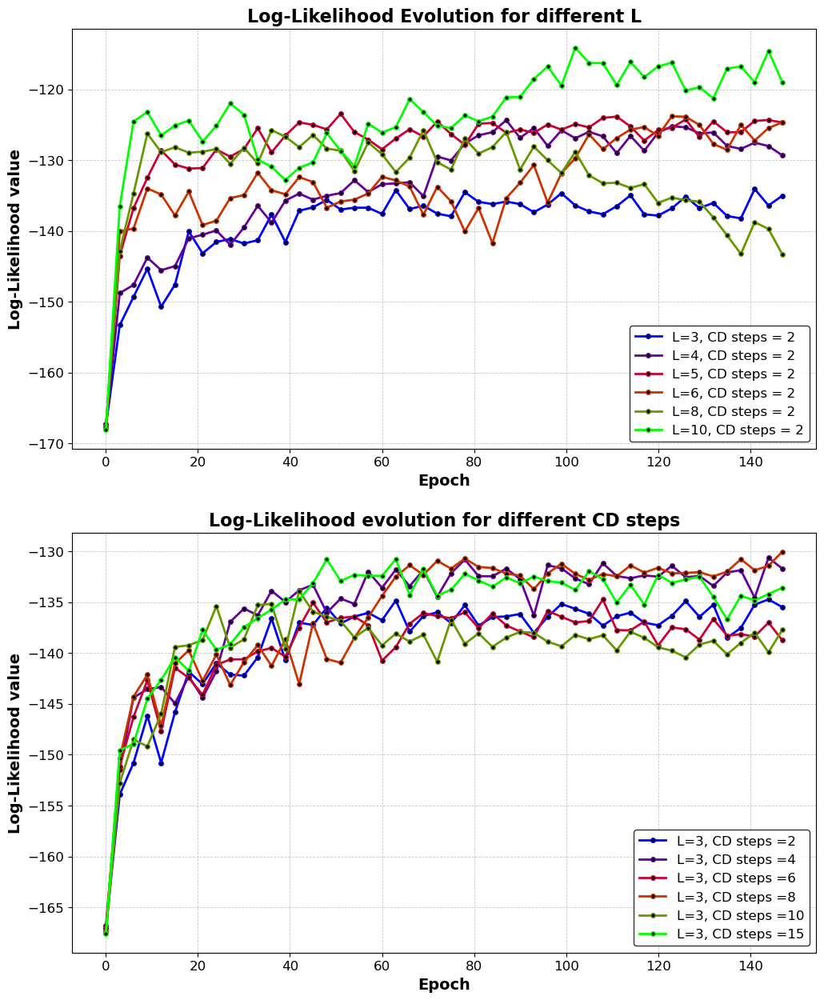

In [18]:
# drawing graphs
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))
log_like_L=  [[-167.46639562, -153.30224022, -149.2998419, -145.34306566, -150.6928827,  
  -147.58903654, -140.05929498, -143.16418878, -141.5562486, -141.13334565,  
  -141.77690018, -141.30056009, -137.69138747, -141.56208266, -137.14274487,  
  -136.67157766, -135.60655794, -136.97555371, -136.72116198, -136.72376396,  
  -137.59913727, -134.23329747, -136.9113512, -136.43255809, -137.56143278,  
  -137.93122748, -134.52485714, -135.90228161, -136.19872291, -135.86557528,  
  -136.20254188, -137.36244353, -136.26979333, -134.67619644, -136.39688289,  
  -137.24671767, -137.63853119, -136.5077115, -134.96660972, -137.6568061,  
  -137.83050153, -136.80611264, -135.14433081, -136.78365085, -136.03322125,  
  -137.88975364, -138.22442291, -134.07610994, -136.4088892, -135.02388182],  

 [-167.26125039, -148.77345297, -147.6171454, -143.75963014, -145.53704543,  
  -144.96919542, -141.0423499, -140.53574993, -139.92773109, -141.95504743,  
  -139.50266357, -136.44388148, -138.83589855, -135.70874327, -134.73380955,  
  -135.58305725, -135.030171, -134.65627441, -132.84599023, -134.51691531,  
  -133.39991381, -133.28521162, -133.12045973, -135.09635184, -129.49054341,  
  -130.05456029, -127.66314906, -126.49595232, -126.06259646, -124.36576746,  
  -126.86064156, -125.45877065, -128.00728459, -125.78873956, -126.91742723,  
  -126.00329362, -126.64954812, -129.02026052, -126.58428109, -128.68630528,  
  -126.1303682, -125.22974574, -125.37308333, -126.21824197, -126.10343221,  
  -127.99399668, -128.41999321, -127.53934007, -128.02000938, -129.33495177],  

 [-167.96045579, -143.50424349, -136.77885881, -132.49927278, -128.61238634,  
  -130.62356925, -131.19865517, -131.1161634, -128.4960581, -129.51300361,  
  -128.43256712, -125.50002279, -128.91074953, -126.53231121, -124.67885995,  
  -125.02436452, -125.66659635, -123.47014893, -126.03663122, -127.10812294,  
  -128.47155502, -126.95461204, -125.64471866, -126.66414488, -124.55211452,  
  -126.32281053, -127.85108434, -124.87571502, -124.74612735, -126.15168095,  
  -125.69035485, -126.1406903, -124.98345671, -125.70115001, -124.92163152,  
  -125.38063556, -124.04439094, -123.85892307, -125.25141806, -127.23410168,  
  -125.74845135, -125.42903242, -124.25994692, -126.76662586, -124.51464281,  
  -126.07712994, -126.05035061, -124.46543898, -124.3472258, -124.68819872],  

 [-167.82839428, -140.02720428, -139.66024198, -133.9979687, -134.85249625,  
  -137.81450788, -134.44622386, -139.15994837, -138.55250615, -135.35959551,  
  -134.93654412, -131.78906784, -134.26209234, -134.81862859, -132.40719999,  
  -133.09283082, -136.71855342, -135.83997309, -135.5827644, -134.70117667,  
  -132.37018226, -132.86230545, -133.73405975, -137.70880844, -133.76906178,  
  -135.82329008, -140.06562352, -136.76019913, -141.72971189, -135.37188385,  
  -133.20323607, -130.68581203, -136.00155483, -131.85581558, -129.7339999,  
  -126.35954185, -128.45950163, -126.88807939, -125.68995293, -125.33446793,  
  -126.57387264, -123.80593995, -123.88324929, -125.04275814, -127.71518492,  
  -128.56120083, -125.00912256, -127.235413, -125.47838408, -124.67275409],  

 [-167.56168704, -142.8378642, -134.71371841, -126.24903893, -128.88253274,  
  -128.174234, -128.9556023, -128.81815463, -128.4414534, -130.52554058,  
  -128.25344745, -130.48209458, -125.76439217, -126.71267336, -128.17051108,  
  -126.45442285, -128.37395256, -128.66418634, -131.55238835, -127.50814445,  
  -129.17023855, -131.68753897, -129.65844807, -125.78235324, -130.29459529,  
  -131.34455809, -126.95361728, -129.07105531, -128.17530346, -126.0266972,  
  -131.33470877, -128.1106469, -130.01699103, -131.8450078, -128.8238097,  
  -132.14912457, -133.26551385, -133.20260346, -133.92757163, -133.39419064,  
  -136.02737913, -135.30374556, -135.6643038, -135.86922388, -138.08684597,  
  -140.62545218, -143.24514671, -138.76128764, -139.71833384, -143.29595282],  

 [-168.02160816, -136.49303448, -124.54118528, -123.21012024, -126.51225333,  
  -125.1232795, -124.40559294, -127.38053124, -125.15672713, -121.98535241,  
  -123.60695775, -129.92706931, -130.94066255, -132.80274195, -131.06788915,  
  -130.3417687, -126.1926997, -128.69649994, -130.84296853, -124.85462726,  
  -126.11755523, -125.34316467, -121.3889479, -123.22057436, -125.12626841,  
  -125.49042897, -123.69047746, -124.52384664, -123.8478302, -121.14757321,  
  -121.07578731, -118.55811729, -116.78297451, -119.48616377, -114.13198263,  
  -116.30035041, -116.30145242, -119.42028825, -116.14413511, -118.27649553,  
  -116.78625213, -116.23294539, -120.18589176, -119.71331766, -121.27313235,  
  -117.0686234, -116.79509889, -118.99634973, -114.57554406, -119.01322526]]  
log_like_cd=[[-167.06195825, -153.91380773, -150.79911203, -146.18286317, -150.79751394, -145.83368566, -141.83796781, -143.07079173, -140.99871912, -142.12682516, -142.22555043, -140.41957902, -136.61794029, -140.72320945, -137.02533089, -137.24895117, -135.54764096, -137.10179326, -136.42801905, -136.06021395, -136.78500667, -134.84579821, -137.90251346, -136.38151147, -135.99726568, -137.06047927, -135.3057863, -137.31241494, -136.47912745, -136.4112143, -136.17395895, -138.01282432, -136.45627614, -135.18712118, -135.66665645, -136.14874331, -137.32125231, -136.39701094, -136.03968115, -137.02636354, -137.27674244, -136.34301941, -134.91024642, -136.45110741, -135.25465109, -138.5097835, -137.53445534, -135.25248447, -134.73931133, -135.50172223],  
[-167.36940146, -151.43773273, -144.38456729, -143.56116546, -143.35274881, -144.96469605, -142.30127428, -144.39895466, -141.79634594, -136.95203828, -135.63967128, -136.30290108, -133.89693108, -134.99542197, -133.84014329, -133.29639518, -136.05655595, -134.65821345, -135.17786518, -132.00759639, -133.59414597, -131.81053497, -133.43774762, -131.8427446, -134.49006217, -132.17387961, -130.82083707, -132.4570818, -132.46815092, -131.71225464, -132.73711858, -136.32714043, -131.37788768, -131.6937956, -132.68132608, -133.25173398, -131.18101439, -132.44167619, -132.66020855, -132.38149934, -132.50923721, -131.42889962, -132.56202272, -132.43300186, -133.42060308, -132.09346581, -131.87058059, -134.57359531, -130.64308683, -131.71583987],  
[-166.76340288, -151.15352519, -146.27894989, -142.69076322, -147.71445502, -141.44545042, -142.45002447, -144.10287991, -141.17957245, -140.63711474, -140.62353996, -139.85141189, -139.50337732, -140.37725486, -137.5098847, -135.0570553, -136.99723131, -136.55809345, -136.42198081, -137.28494161, -140.75155583, -139.42824708, -137.1325191, -136.08375759, -136.37213303, -136.59410698, -136.00938084, -137.56789881, -136.10471055, -137.29371669, -137.89614581, -138.45132446, -135.87242494, -136.44733559, -137.0019507, -136.86439671, -134.74541758, -137.75032469, -137.7807965, -136.9083288, -139.26098801, -137.49086546, -137.67328807, -138.69091278, -136.66958834, -138.29734077, -138.16385851, -138.38227959, -137.01459933, -138.75257592],  
[-167.31564282, -150.35861218, -144.29489631, -142.13831513, -147.16972181, -141.04046833, -139.74240721, -142.73999371, -140.16049709, -143.15510122, -140.90457872, -139.22911231, -141.28042089, -138.64478475, -143.06238389, -137.07448908, -140.59845477, -140.95878312, -138.50455966, -136.50814773, -134.39514179, -132.50361026, -131.3766468, -132.33407555, -130.94119328, -131.71599215, -130.72131673, -131.55073845, -131.65475048, -132.20397536, -132.3993321, -133.73495199, -132.18985969, -131.22713267, -132.23505959, -132.81279748, -132.24614706, -132.47169307, -131.40155805, -132.09725856, -131.62989664, -132.18061738, -132.13322236, -132.06134593, -132.48208518, -132.00358384, -130.78705169, -131.87597167, -131.43193712, -130.04848288],  
[-167.47056591, -152.78426781, -148.50821709, -149.18253968, -145.98741749, -139.42141992, -139.24265311, -138.73428581, -135.40335747, -139.47881686, -138.65822663, -135.30143411, -135.17698744, -139.56140382, -133.92194371, -135.9391622, -136.43983222, -136.85905777, -138.47885275, -137.53233338, -139.25807741, -138.09750044, -138.88606529, -138.20988584, -140.86382656, -136.72671812, -139.1053297, -138.07449659, -139.40683765, -138.48899085, -137.93185797, -138.01088858, -138.90194016, -139.34268787, -138.23128832, -138.65132015, -138.2641439, -139.7442488, -137.91656113, -138.51401102, -139.44086498, -139.77781711, -140.43495971, -139.17682657, -138.80485856, -140.13499743, -139.00813223, -138.00225445, -139.93861783, -137.73756883],  
[-167.56688306, -149.57459004, -148.92201577, -144.49699484, -142.65000422, -140.42804414, -141.74483508, -137.73953022, -139.69429143, -139.14603038, -137.47472516, -136.56899744, -135.74029496, -134.75351824, -134.72844823, -133.15593863, -130.7901138, -132.93062435, -132.32729123, -132.41780206, -132.41892985, -130.78128992, -134.29778061, -131.76417546, -134.36682334, -133.78541633, -132.22659407, -132.87452003, -133.49623975, -132.57566791, -133.15314232, -132.49289833, -132.94989403, -133.08114273, -133.81245823, -131.9561397, -132.75947195, -135.04058372, -133.29644009, -135.24457994, -132.32634396, -133.11409381, -132.7770832, -132.51737443, -134.48169441, -136.6978821, -134.3740188, -134.8378947, -134.21187633, -133.59259214]]  
num_epo=[0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42, 45, 48, 51, 54, 57, 60,  
63, 66, 69, 72, 75, 78, 81, 84, 87, 90, 93, 96, 99, 102, 105, 108, 111, 114, 117, 120,  
123, 126, 129, 132, 135, 138, 141, 144, 147] 
L_v=[3,4,5,6,8,10]
Nt_v=[2,4,6,8,10,15]

colors = plt.cm.brg(np.linspace(0, 1, len(log_like_L)))
for i,log_like in enumerate(log_like_L): # fixed CD steps=2
    ax1.plot(num_epo, log_like, label=f'L={L_v[i]}, CD steps = 2',linewidth=2, color=colors[i], marker='o',markersize=4, markerfacecolor='black', markeredgewidth=1)
    ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
    ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
    ax1.set_title('Log-Likelihood Evolution for different L', fontsize=16, fontweight='bold')
    ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
    #ax1.set_xticks(num_epo)
    ax1.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

for i,log_like in enumerate(log_like_cd): # fixed L=3
    ax2.plot(num_epo, log_like, label=f'L=3, CD steps ={Nt_v[i]}',color=colors[i],marker='o',linewidth=2, markersize=4, markerfacecolor='black', markeredgewidth=1)
    ax2.set_xlabel('Epoch', fontsize=14, fontweight='bold')
    ax2.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
    ax2.set_title('Log-Likelihood evolution for different CD steps', fontsize=16, fontweight='bold')
    #ax2.set_xticks(num_epo)
    ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
    ax2.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

plt.show()


## Likelihood dependance on number of visible variables and CD steps  

Now we want to compare the likelihood values after the transient, in the last epochs of training, varying the parameters L and Nt. We previously observed that the likelihood appers to be quite stable after a certain number of epochs, but this needs to be verified more rigorously considering more iterations for each likelihhod estimation (10 for computational feasability), and taking their average and standard deviation. We focus on the last 10 epochs and, after verifying the stability of the likelihood, we compare their average values for the different number of visible variables and CD steps considered.       

In [ ]:
# Log-likelyhood after transient for different L and fixed CD steps = 2: stability check and mean; mean comparison for different L

log_like_L=[]
log_like_L_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-10,Nepoch,1)

for L in L_v:
    Nt=2
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like=[]
    log_like_std=[]
    for i in range(Nepoch-10,Nepoch,1):
        print(f'Epoch n.{i}')
        ll_iter= []
        for iter in range(10): # to determine the loglike at each epoch we run the calculation 10 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like.append(ll_mean)
        log_like_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_L.append(log_like)
    log_like_L_std.append(log_like_std)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1259.76it/s]


Log-likelihood= -135.33417648347438 +- 0.4948436913465755
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1140.92it/s]


Log-likelihood= -134.8111327991385 +- 0.7519264151407518
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1185.13it/s]


Log-likelihood= -135.55996648476102 +- 0.4509732611999631
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.98it/s]


Log-likelihood= -135.3511763225206 +- 0.547801735890055
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.27it/s]


Log-likelihood= -135.90257631379617 +- 0.728230882196492
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.41it/s]


Log-likelihood= -136.76855143709196 +- 0.47586230560254345
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1279.10it/s]


Log-likelihood= -135.16244862200264 +- 0.5562445680022283
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1257.01it/s]


Log-likelihood= -135.29951070916115 +- 0.6054118397588848
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1167.63it/s]


Log-likelihood= -137.856631852215 +- 0.3441585016734641
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1286.59it/s]


Log-likelihood= -136.16619959293686 +- 0.25801107424517805
a_all L=4, Nt=2
b_all L=4, Nt=2
w_all L=4, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 513.36it/s]


Log-likelihood= -127.23964660500101 +- 0.6780543748242523
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 664.22it/s]


Log-likelihood= -127.51342276154364 +- 0.6509824597578027
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 660.13it/s]


Log-likelihood= -127.10669977917291 +- 0.5055897364897357
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 664.17it/s]


Log-likelihood= -127.87576526185676 +- 0.4787348963725224
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 668.49it/s]


Log-likelihood= -128.63018612941715 +- 0.519124372826951
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 658.09it/s]


Log-likelihood= -126.13121638301577 +- 0.32314326017105055
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 630.02it/s]


Log-likelihood= -128.37572819065633 +- 0.5815404561838426
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 630.22it/s]


Log-likelihood= -127.59672423564625 +- 0.3357670414481326
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 628.76it/s]


Log-likelihood= -127.85731339124989 +- 0.60759003302781
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 522.57it/s]


Log-likelihood= -127.24332584476846 +- 0.3837833880827182
a_all L=5, Nt=2
b_all L=5, Nt=2
w_all L=5, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 286.59it/s]


Log-likelihood= -124.89476238745674 +- 0.9758199745947126
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 324.57it/s]


Log-likelihood= -124.32258789311607 +- 0.600548972734193
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 641.41it/s]


Log-likelihood= -125.20089106503936 +- 0.6650164555437056
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:11<00:00, 496.01it/s]


Log-likelihood= -124.39628785756847 +- 0.5295998619426238
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 633.18it/s]


Log-likelihood= -124.21529083572823 +- 0.6846724798821712
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 640.20it/s]


Log-likelihood= -124.71925130957898 +- 0.6167279671393802
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 521.09it/s]


Log-likelihood= -124.59398138047318 +- 0.5755982318103808
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 637.73it/s]


Log-likelihood= -124.75019284466148 +- 0.501963749973891
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 642.09it/s]


Log-likelihood= -124.58670012040932 +- 0.6344227892486787
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:10<00:00, 522.32it/s]


Log-likelihood= -126.353581685533 +- 0.6850705981884185
a_all L=6, Nt=2
b_all L=6, Nt=2
w_all L=6, Nt=2
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:19<00:00, 283.45it/s]


Log-likelihood= -124.39803732334796 +- 0.5754579471967136
Epoch n.141


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.32it/s]


Log-likelihood= -128.07955933051826 +- 0.3888809271906497
Epoch n.142


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 322.19it/s]


Log-likelihood= -126.26470575733603 +- 0.5187534766411706
Epoch n.143


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 292.17it/s]


Log-likelihood= -125.09584782778013 +- 0.5254182921438733
Epoch n.144


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 321.92it/s]


Log-likelihood= -125.1264102145808 +- 0.5315586332479377
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 326.19it/s]


Log-likelihood= -122.57487770281391 +- 0.904060831077091
Epoch n.146


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 290.48it/s]


Log-likelihood= -125.33736516050458 +- 0.5439818076971923
Epoch n.147


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:18<00:00, 293.44it/s]


Log-likelihood= -124.25358464764872 +- 0.5476136563096112
Epoch n.148


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 336.04it/s]


Log-likelihood= -123.90844003512714 +- 0.4056092130889154
Epoch n.149


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:16<00:00, 327.66it/s]


Log-likelihood= -125.34595677910254 +- 0.7057755641162581
a_all L=8, Nt=2
b_all L=8, Nt=2
w_all L=8, Nt=2
Epoch n.140


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.15it/s]


Log-likelihood= -138.8940384882829 +- 0.6695564998307214
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 78.37it/s]


Log-likelihood= -138.8846233625182 +- 0.5734429837321443
Epoch n.142


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.96it/s]


Log-likelihood= -141.19081979456698 +- 0.40445018925136705
Epoch n.143


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:11<00:00, 77.43it/s]


Log-likelihood= -142.0026786300512 +- 0.7902159243919353
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.88it/s]


Log-likelihood= -139.93224318546316 +- 0.5682470997883244
Epoch n.145


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:09<00:00, 79.38it/s]


Log-likelihood= -143.31943112793687 +- 0.39284761572730864
Epoch n.146


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 79.90it/s]


Log-likelihood= -142.93490990751363 +- 0.6556731291415835
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.81it/s]


Log-likelihood= -142.83249761388294 +- 0.4144386309838914
Epoch n.148


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:10<00:00, 77.91it/s]


Log-likelihood= -144.50049937518668 +- 0.4488331629640661
Epoch n.149


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:13<00:00, 74.72it/s]


Log-likelihood= -143.95647410022974 +- 0.6227667792952782
a_all L=10, Nt=2
b_all L=10, Nt=2
w_all L=10, Nt=2
Epoch n.140


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:44<00:00, 19.29it/s]


Log-likelihood= -120.98272949543063 +- 0.1880402209943159
Epoch n.141


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:59<00:00, 18.34it/s]


Log-likelihood= -119.06022603199169 +- 0.3886766717074701
Epoch n.142


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.52it/s]


Log-likelihood= -118.15374164821438 +- 0.44014342644319515
Epoch n.143


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:33<00:00, 20.10it/s]


Log-likelihood= -120.63752887443452 +- 0.37117820128720863
Epoch n.144


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:34<00:00, 20.06it/s]


Log-likelihood= -115.27407393736273 +- 0.5426310855937532
Epoch n.145


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:53<00:00, 18.72it/s]


Log-likelihood= -118.33354007929377 +- 0.2893632765113282
Epoch n.146


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:41<00:00, 19.56it/s]


Log-likelihood= -118.2082683436015 +- 0.5958565634503485
Epoch n.147


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:51<00:00, 18.88it/s]


Log-likelihood= -119.16769683870943 +- 0.4292029640536674
Epoch n.148


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:50<00:00, 18.92it/s]


Log-likelihood= -115.77222552770385 +- 0.2773327479113979
Epoch n.149


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [04:55<00:00, 18.58it/s]

Log-likelihood= -114.99729793520255 +- 0.7080737294347231


In [ ]:
import dill
dill.dump_session('save_ll_1.7.db')
#import dill
#dill.load_session('save_ll.db_1.7')
#

In [ ]:
# Log-likelyhood after transient for different CD steps and fixed L = 3: stability check and mean; mean comparison for different CD steps

log_like_cd=[]
log_like_cd_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-10,Nepoch,1)

for L in L_v:
    if L==3:
        for Nt in Nt_v:
            a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
            b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
            w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg0.001_20250317.npy", allow_pickle=True)
            print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

            log_like=[]
            log_like_std=[]
            Nepoch=150
            for i in range(Nepoch-10,Nepoch,1):
                print(f'Epoch n.{i}')
                ll_iter=[]
                mean=[]
                for iter in range(10): # to determine the loglike at each epoch we run the calculation 10 times and compute the average, to reduce randomness
                    ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
                    ll_iter.append(ll)
                ll_mean= np.array(ll_iter).mean()
                ll_std= np.array(ll_iter).std()
                log_like.append(ll_mean)
                log_like_std.append(ll_std)
                print('Log-likelihood=',ll_mean,"+-",ll_std)
            log_like_cd.append(log_like)
            log_like_cd_std.append(log_like_std)


a_all L=3, Nt=2
b_all L=3, Nt=2
w_all L=3, Nt=2
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2303.36it/s]


Log-likelihood= -135.40244199882693 +- 0.4064576716831954
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2281.73it/s]


Log-likelihood= -134.80174518824106 +- 0.6544495331297595
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2255.27it/s]


Log-likelihood= -135.4733447721828 +- 0.4727529126773889
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2281.40it/s]


Log-likelihood= -134.85709953691213 +- 0.5561732850054889
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2287.75it/s]


Log-likelihood= -135.60779506409935 +- 0.38213269719854126
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2302.47it/s]


Log-likelihood= -136.66377353849435 +- 0.7581315063921562
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2318.56it/s]


Log-likelihood= -135.32058149727166 +- 0.2423803120777691
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2088.95it/s]


Log-likelihood= -135.46887302374594 +- 0.5678899520697064
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2185.31it/s]


Log-likelihood= -137.95932993407374 +- 0.4370521579879841
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2264.38it/s]


Log-likelihood= -136.34938393386227 +- 0.3984022302331581
a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2145.98it/s]


Log-likelihood= -131.78400472104974 +- 0.6156035629335075
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2046.90it/s]


Log-likelihood= -133.4510570424571 +- 0.7007948806647603
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2128.24it/s]


Log-likelihood= -131.65811079246814 +- 0.5635793653271923
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2194.06it/s]


Log-likelihood= -132.15154309424784 +- 0.560565735000031
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2213.10it/s]


Log-likelihood= -132.04595727772278 +- 0.6755670677629372
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2287.43it/s]


Log-likelihood= -132.60066211388505 +- 0.6671162489332465
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2236.96it/s]


Log-likelihood= -131.97316505605727 +- 0.6878004506596289
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2116.09it/s]


Log-likelihood= -131.5429920280286 +- 0.5377688847156716
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2195.19it/s]


Log-likelihood= -131.48110043235027 +- 0.6864442451894349
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2124.71it/s]


Log-likelihood= -131.6920525186129 +- 0.7851726696602334
a_all L=3, Nt=6
b_all L=3, Nt=6
w_all L=3, Nt=6
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2303.93it/s]


Log-likelihood= -138.5189379465333 +- 0.588272834139861
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2231.17it/s]


Log-likelihood= -138.0830687221584 +- 0.533357643559949
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2112.52it/s]


Log-likelihood= -136.69706982423364 +- 0.4469185615013901
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2181.67it/s]


Log-likelihood= -139.25442254791417 +- 0.43331996389215605
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2297.09it/s]


Log-likelihood= -137.522518426016 +- 0.41561270607493656
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3205.86it/s]


Log-likelihood= -139.0266563235406 +- 0.560888616334427
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2300.66it/s]


Log-likelihood= -137.09725928832418 +- 0.5871874193054396
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2192.89it/s]


Log-likelihood= -138.87441175683392 +- 0.556122196952543
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2216.75it/s]


Log-likelihood= -137.2204115241542 +- 0.3870065509106904
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2222.09it/s]


Log-likelihood= -137.1386697223408 +- 0.41515645049600175
a_all L=3, Nt=8
b_all L=3, Nt=8
w_all L=3, Nt=8
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2211.36it/s]


Log-likelihood= -131.93444690763366 +- 0.5992888370884695
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2238.25it/s]


Log-likelihood= -131.26384222353695 +- 0.633165671183006
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2215.65it/s]


Log-likelihood= -131.83929376012918 +- 0.6172394313356687
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2121.61it/s]


Log-likelihood= -132.75838543082148 +- 0.6102940064162099
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 2961.52it/s]


Log-likelihood= -131.50124926168507 +- 0.5949768092231003
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2166.11it/s]


Log-likelihood= -131.70532187613148 +- 0.4150116301992774
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2237.69it/s]


Log-likelihood= -131.39400500651692 +- 0.5506826404248658
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2271.43it/s]


Log-likelihood= -131.9267508834783 +- 0.6128364020183464
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2297.70it/s]


Log-likelihood= -132.07714446105746 +- 0.6500349131992584
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2209.74it/s]


Log-likelihood= -132.65609932041366 +- 0.555598822602165
a_all L=3, Nt=10
b_all L=3, Nt=10
w_all L=3, Nt=10
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2269.61it/s]


Log-likelihood= -139.22652463607128 +- 0.4957176355423664
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2283.60it/s]


Log-likelihood= -138.2416056269301 +- 0.4765155792163485
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3365.60it/s]


Log-likelihood= -138.19518722014908 +- 0.6447341640592643
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2322.81it/s]


Log-likelihood= -138.79636511472617 +- 0.47976882421021505
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2242.59it/s]


Log-likelihood= -138.86111333115795 +- 0.4910005354421933
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2210.69it/s]


Log-likelihood= -139.37913916431813 +- 0.6591393618671353
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2244.12it/s]


Log-likelihood= -137.25599268025408 +- 0.48488594644730243
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2181.36it/s]


Log-likelihood= -137.32012826392247 +- 0.5331333744545672
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2192.51it/s]


Log-likelihood= -138.8454413367235 +- 0.24931820809070573
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2104.26it/s]


Log-likelihood= -139.7254582172481 +- 0.45059376677110324
a_all L=3, Nt=15
b_all L=3, Nt=15
w_all L=3, Nt=15
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2290.55it/s]


Log-likelihood= -134.95994553501606 +- 0.4446400687830309
Epoch n.141


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2248.70it/s]


Log-likelihood= -134.5258668775715 +- 0.8428762802819025
Epoch n.142


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2252.34it/s]


Log-likelihood= -134.39313539889125 +- 0.6601746132077289
Epoch n.143


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2294.19it/s]


Log-likelihood= -134.80374006767016 +- 0.7263023012433573
Epoch n.144


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2352.10it/s]


Log-likelihood= -134.62408650413028 +- 0.71548688680001
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:01<00:00, 3120.23it/s]


Log-likelihood= -135.23556137915062 +- 0.5754182086565504
Epoch n.146


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2221.82it/s]


Log-likelihood= -135.3570455709304 +- 0.5345471318252437
Epoch n.147


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2256.19it/s]


Log-likelihood= -133.8319397373477 +- 0.5191095584380684
Epoch n.148


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2213.68it/s]


Log-likelihood= -134.81752609460844 +- 0.6343818886318692
Epoch n.149


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2298.82it/s]

Log-likelihood= -134.50114583157932 +- 0.6634738584173402


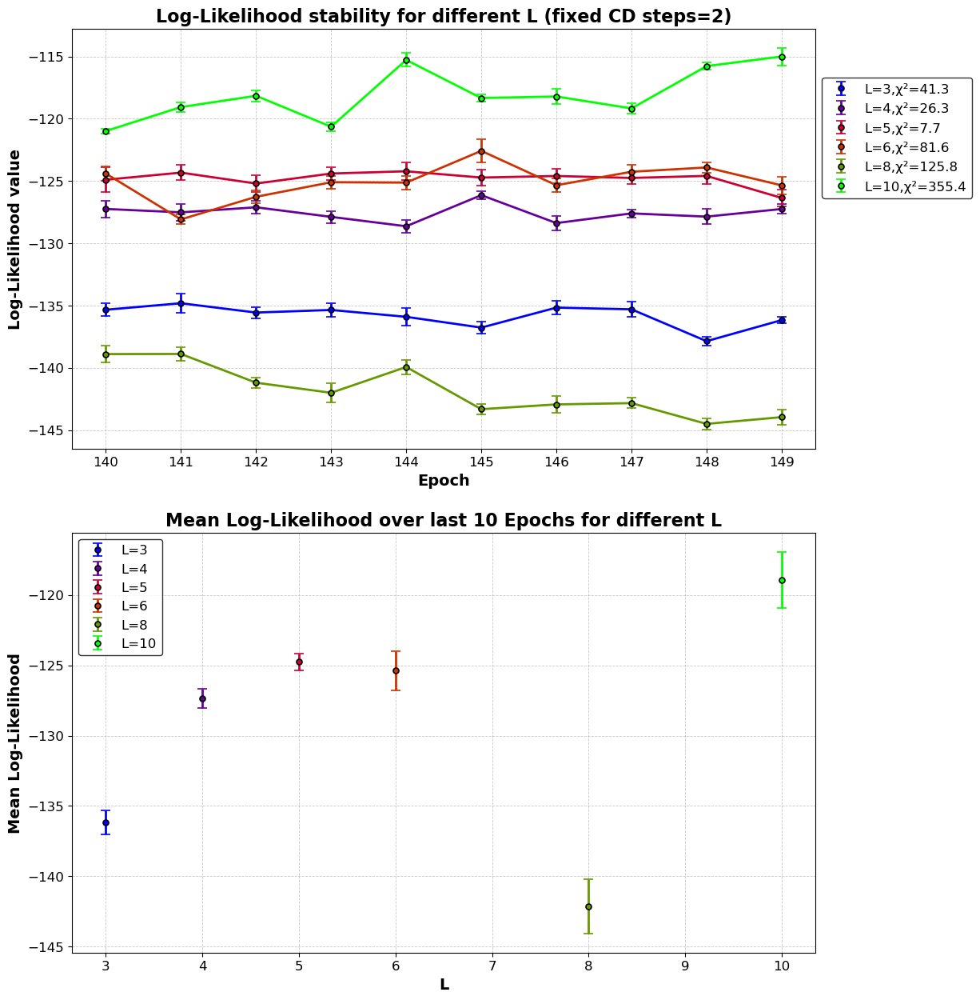

In [13]:
# plots of log-likelihood of last 10 epochs and their mean
log_like_L=[[-135.33417648, -134.8111328, -135.55996648, -135.35117632, -135.90257631,
  -136.76855144, -135.16244862, -135.29951071, -137.85663185, -136.16619959],
 [-127.23964661, -127.51342276, -127.10669978, -127.87576526, -128.63018613,
  -126.13121638, -128.37572819, -127.59672424, -127.85731339, -127.24332584],
 [-124.89476239, -124.32258789, -125.20089107, -124.39628786, -124.21529084,
  -124.71925131, -124.59398138, -124.75019284, -124.58670012, -126.35358169],
 [-124.39803732, -128.07955933, -126.26470576, -125.09584783, -125.12641021,
  -122.5748777, -125.33736516, -124.25358465, -123.90844004, -125.34595678],
 [-138.89403849, -138.88462336, -141.19081979, -142.00267863, -139.93224319,
  -143.31943113, -142.93490991, -142.83249761, -144.50049938, -143.9564741],
 [-120.9827295, -119.06022603, -118.15374165, -120.63752887, -115.27407394,
  -118.33354008, -118.20826834, -119.16769684, -115.77222553, -114.99729794]]
log_like_L_std=[[0.49484369, 0.75192642, 0.45097326, 0.54780174, 0.72823088, 0.47586231,
  0.55624457, 0.60541184, 0.3441585, 0.25801107],
 [0.67805437, 0.65098246, 0.50558974, 0.4787349, 0.51912437, 0.32314326,
  0.58154046, 0.33576704, 0.60759003, 0.38378339],
 [0.97581997, 0.60054897, 0.66501646, 0.52959986, 0.68467248, 0.61672797,
  0.57559823, 0.50196375, 0.63442279, 0.6850706],
 [0.57545795, 0.38888093, 0.51875348, 0.52541829, 0.53155863, 0.90406083,
  0.54398181, 0.54761366, 0.40560921, 0.70577556],
 [0.6695565, 0.57344298, 0.40445019, 0.79021592, 0.5682471, 0.39284762,
  0.65567313, 0.41443863, 0.44883316, 0.62276678],
 [0.18804022, 0.38867667, 0.44014343, 0.3711782, 0.54263109, 0.28936328,
  0.59585656, 0.42920296, 0.27733275, 0.70807373]]

Nepoch=150
# variable L, fixed CD steps
colors = plt.cm.brg(np.linspace(0, 1, len(log_like_L)))
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))
num_epo=np.arange(Nepoch-10,Nepoch,1)

for i, log_like in enumerate(log_like_L):
    weights = 1 / np.array(log_like_L_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(10))/log_like_L_std[i])** 2)

    ax1.errorbar(num_epo,log_like,yerr=log_like_L_std[i],fmt='o',color=colors[i],label=f'L={L_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(L_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'L={L_v[i]}',linewidth=2,markersize=5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    #ax1.plot(num_epo,np.ones(10)*weighted_avg,linestyle='--',color=colors[i])

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different L (fixed CD steps=2)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='best', frameon=True,bbox_to_anchor=(1, 0.9), edgecolor='black')

ax2.set_xlabel('L', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 10 Epochs for different L', fontsize=16, fontweight='bold')
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')

plt.show()

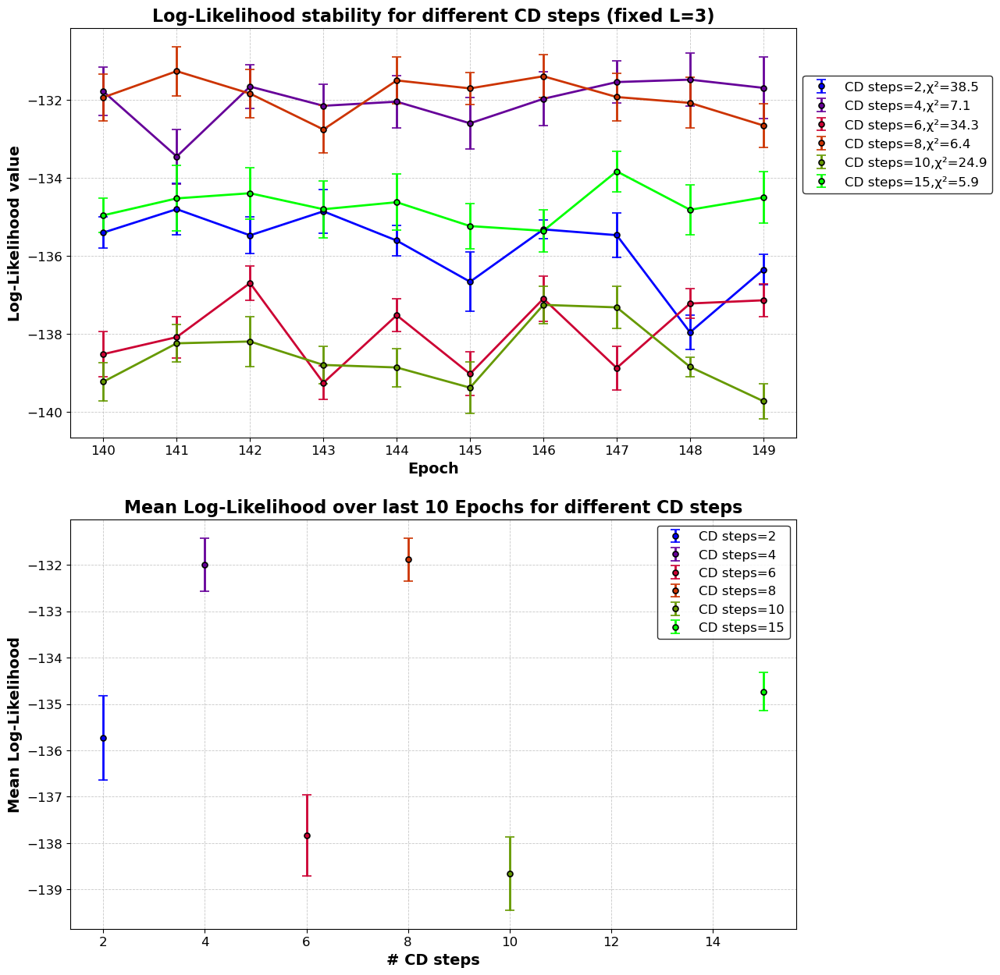

In [15]:
# variable CD steps, fixed L
colors = plt.cm.brg(np.linspace(0, 1, len(log_like_cd)))
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,15))
log_like_cd = [[-135.402442, -134.80174519, -135.47334477, -134.85709954, -135.60779506, -136.66377354, -135.3205815, -135.46887302, -137.95932993, -136.34938393],
        [-131.78400472, -133.45105704, -131.65811079, -132.15154309, -132.04595728, -132.60066211, -131.97316506, -131.54299203, -131.48110043, -131.69205252],
        [-138.51893795, -138.08306872, -136.69706982, -139.25442255, -137.52251843, -139.02665632, -137.09725929, -138.87441176, -137.22041152, -137.13866972],
        [-131.93444691, -131.26384222, -131.83929376, -132.75838543, -131.50124926, -131.70532188, -131.39400501, -131.92675088, -132.07714446, -132.65609932],
        [-139.22652464, -138.24160563, -138.19518722, -138.79636511, -138.86111333, -139.37913916, -137.25599268, -137.32012826, -138.84544134, -139.72545822],
        [-134.95994554, -134.52586688, -134.3931354, -134.80374007, -134.6240865, -135.23556138, -135.35704557, -133.83193974, -134.81752609, -134.50114583]]

log_like_cd_std = [[0.40645767, 0.65444953, 0.47275291, 0.55617329, 0.3821327, 0.75813151, 0.24238031, 0.56788995, 0.43705216, 0.39840223],
       [0.61560356, 0.70079488, 0.56357937, 0.56056574, 0.67556707, 0.66711625, 0.68780045, 0.53776888, 0.68644425, 0.78517267],
       [0.58827283, 0.53335764, 0.44691856, 0.43331996, 0.41561271, 0.56088862, 0.58718742, 0.5561222, 0.38700655, 0.41515645],
       [0.59928884, 0.63316567, 0.61723943, 0.61029401, 0.59497681, 0.41501163, 0.55068264, 0.6128364, 0.65003491, 0.55559882],
       [0.49571764, 0.47651558, 0.64473416, 0.47976882, 0.49100054, 0.65913936, 0.48488595, 0.53313337, 0.24931821, 0.45059377],
       [0.44464007, 0.84287628, 0.66017461, 0.7263023, 0.71548689, 0.57541821, 0.53454713, 0.51910956, 0.63438189, 0.66347386]]


for i, log_like in enumerate(log_like_cd):
    weights = 1 / np.array(log_like_cd_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods of last 10 epochs
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(10))/log_like_cd_std[i]) ** 2)
    
    ax1.errorbar(num_epo,log_like,yerr=log_like_cd_std[i],fmt='o',color=colors[i],label=f'CD steps={Nt_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(Nt_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'CD steps={Nt_v[i]}',linewidth=2,markersize=5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    #ax1.plot(num_epo,np.ones(10)*weighted_avg,linestyle='--',color=colors[i])

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different CD steps (fixed L=3)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')
ax1.legend(fontsize=12, loc='best', frameon=True,bbox_to_anchor=(1, 0.9), edgecolor='black')


ax2.set_xlabel('# CD steps', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 10 Epochs for different CD steps', fontsize=16, fontweight='bold')
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='best', frameon=True, edgecolor='black')

plt.show()

## Training for different regularization factors

Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

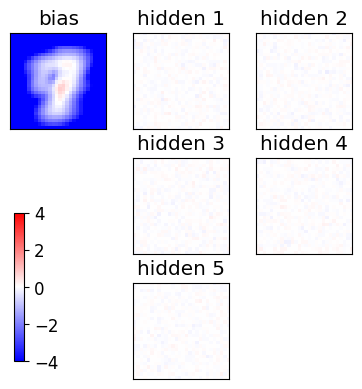

Starting the training
[13762  5407  5139 18824  3022 13556 13880  9621 19603  6252]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[ 4363 15877  8648  4167   493  6217  5094 15224 19288 20763]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[11572  1208 17461   539   701 16259 20623 17001  1746 17256]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
[ 6398   708 12122 13365 13334  3311  9083   301 13458  3831]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam

<Figure size 640x480 with 0 Axes>

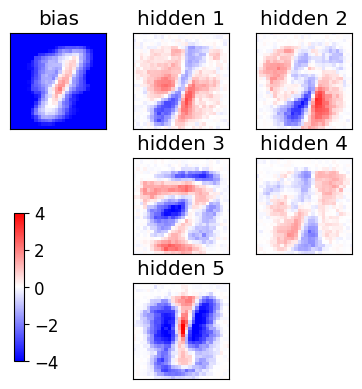

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

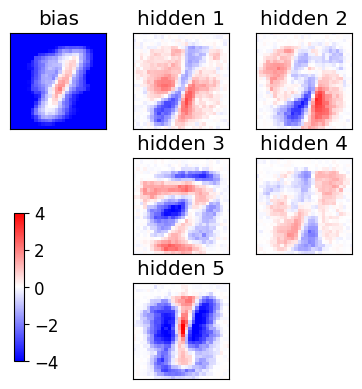

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

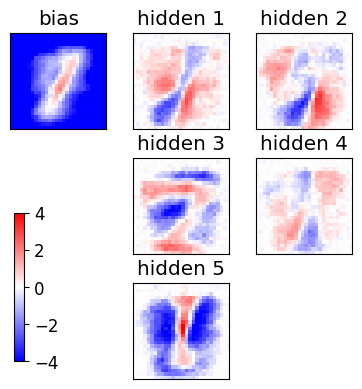

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

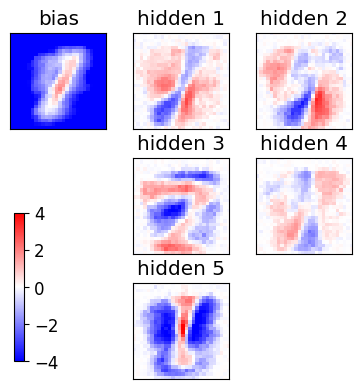

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

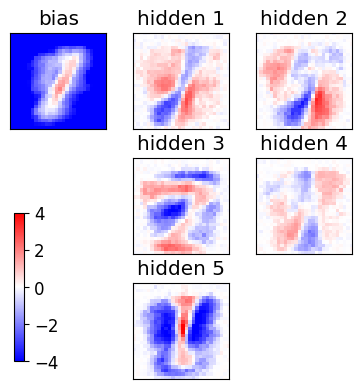

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

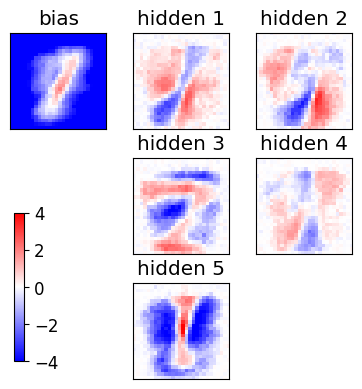

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

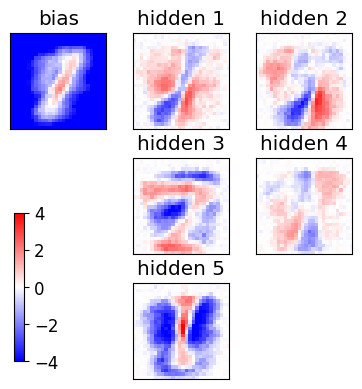

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

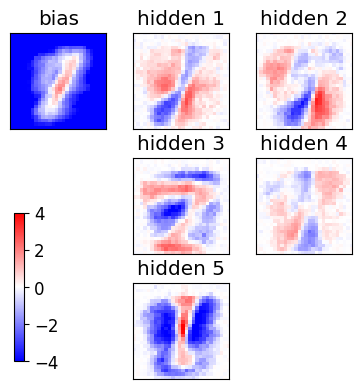

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

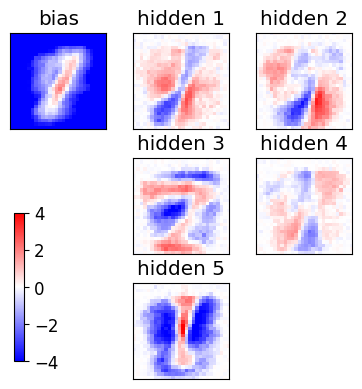

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

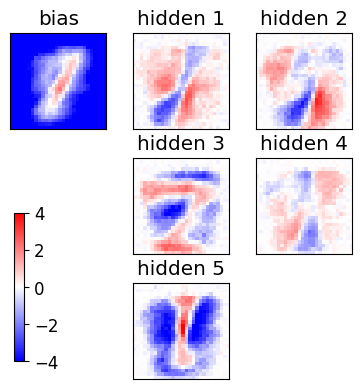

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

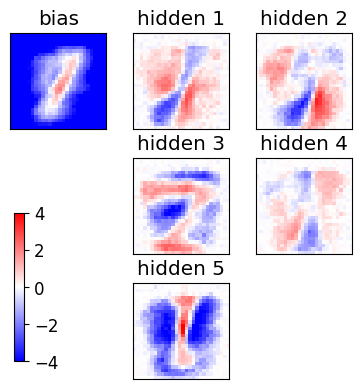

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

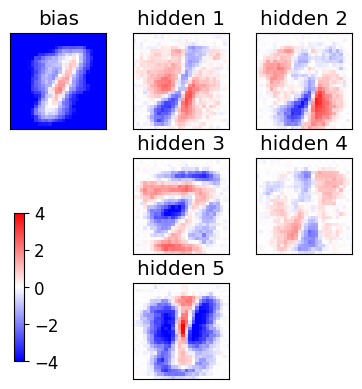

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

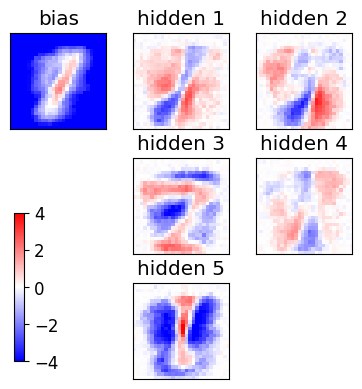

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

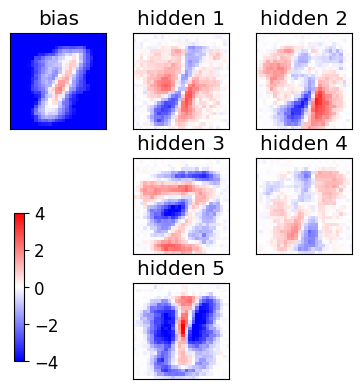

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

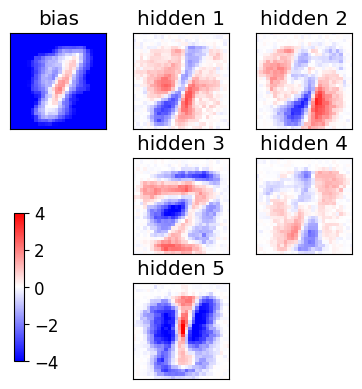

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

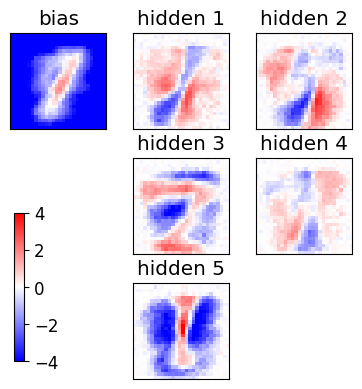

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

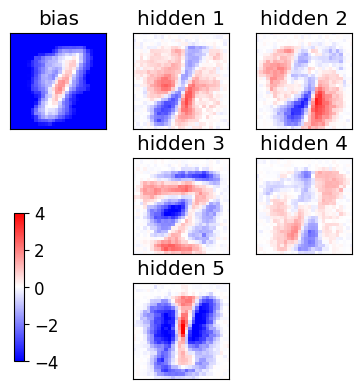

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

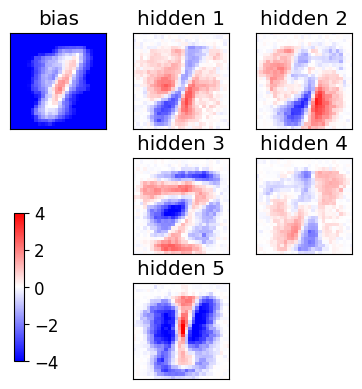

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

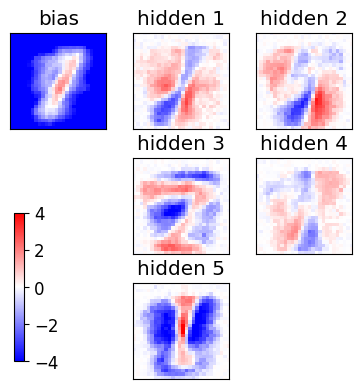

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

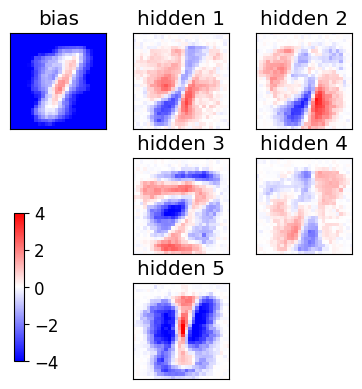

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

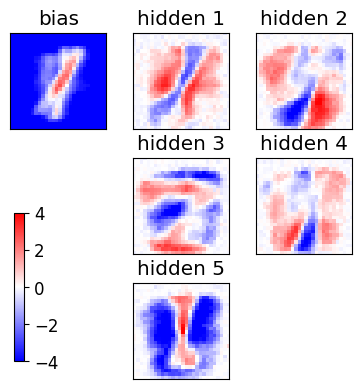

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

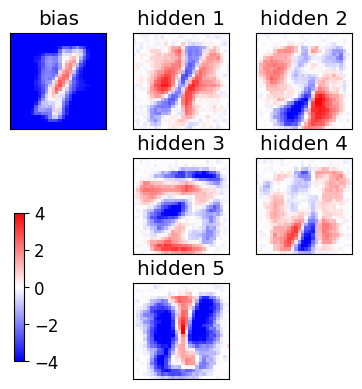

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

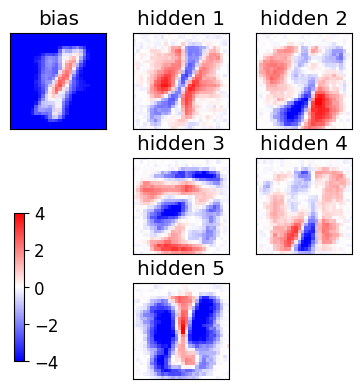

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

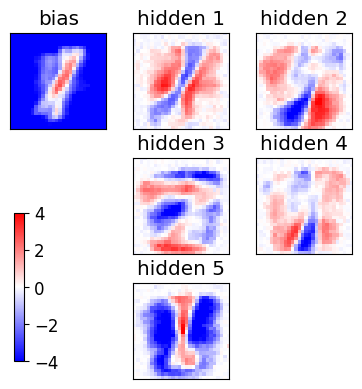

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

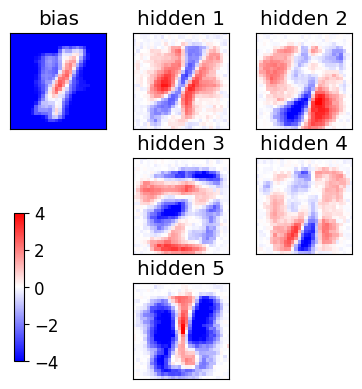

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

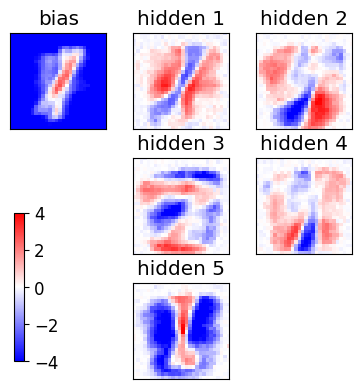

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

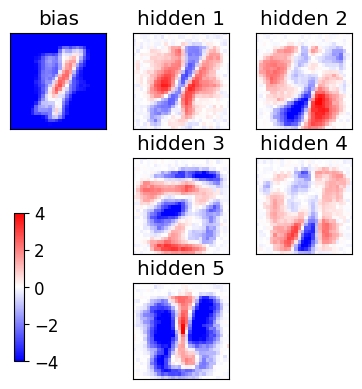

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

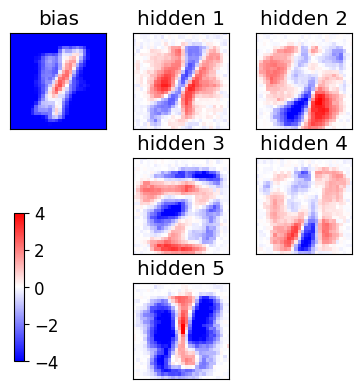

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

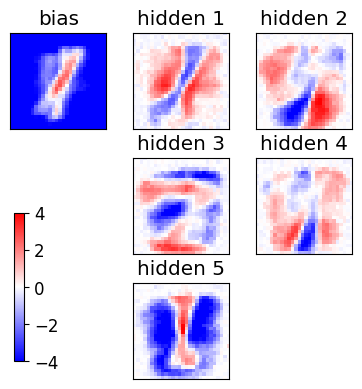

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

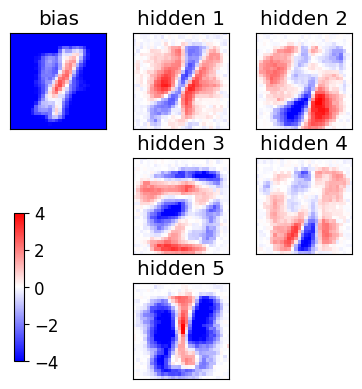

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

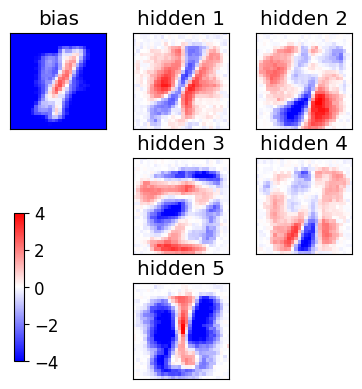

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

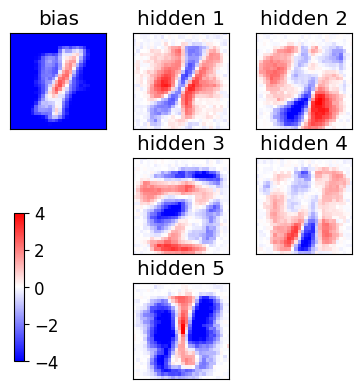

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

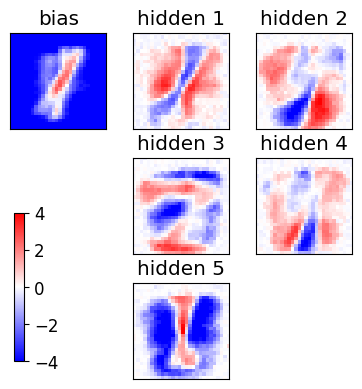

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

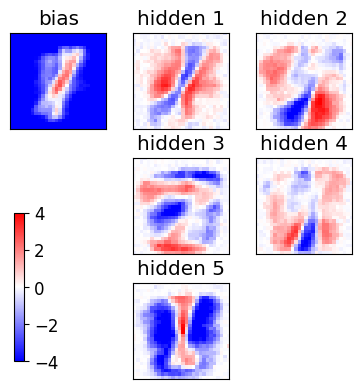

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

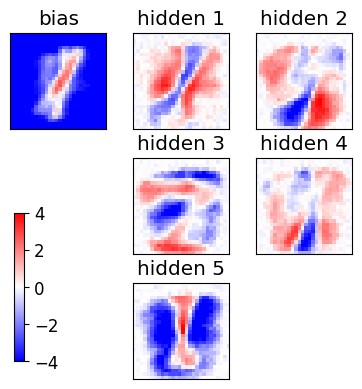

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

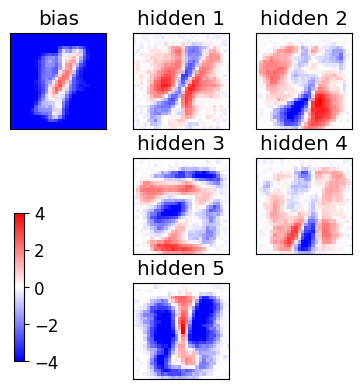

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

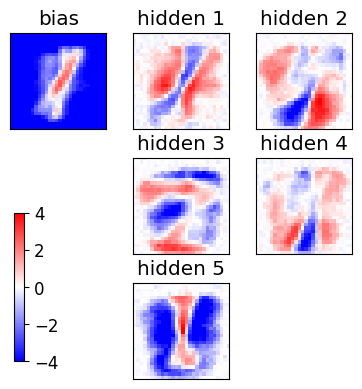

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

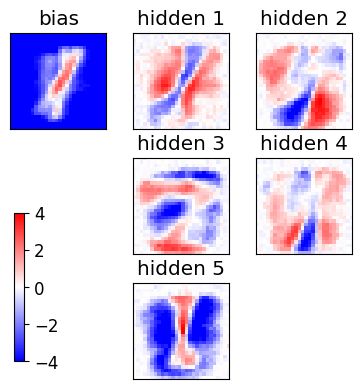

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

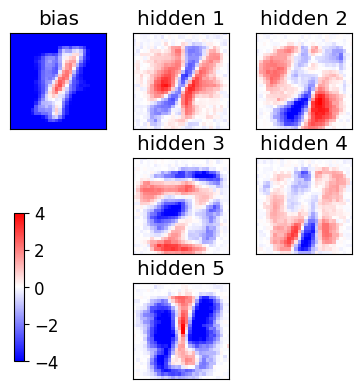

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

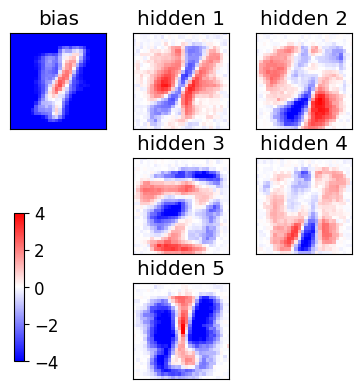

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

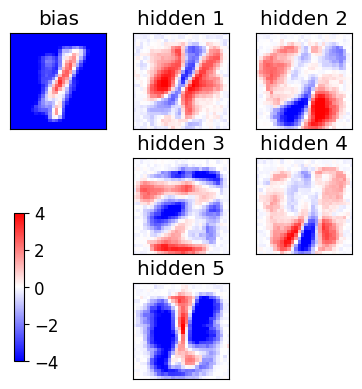

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

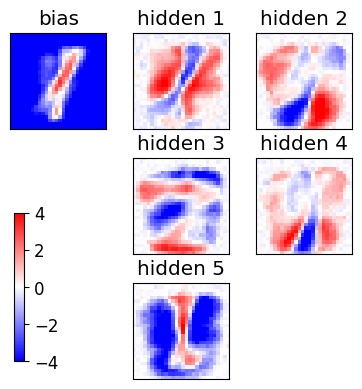

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

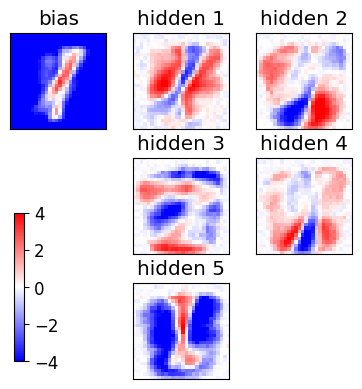

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

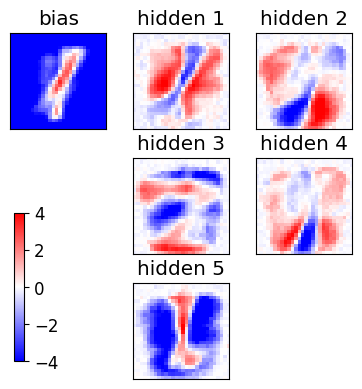

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

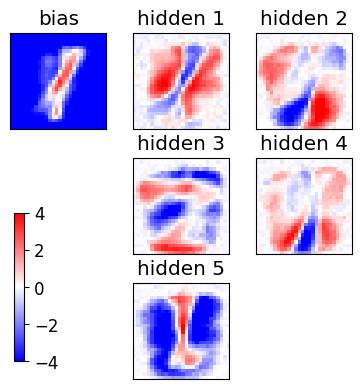

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

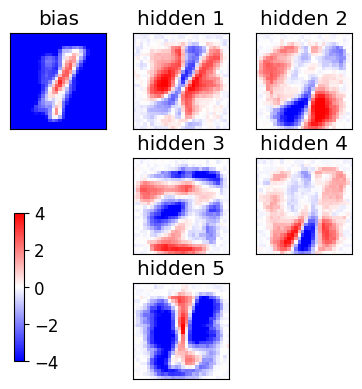

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

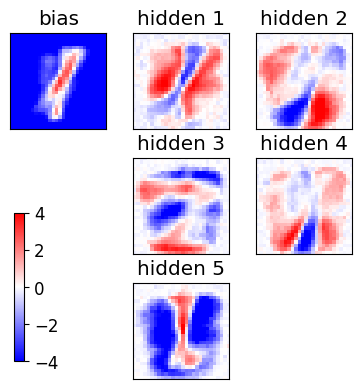

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

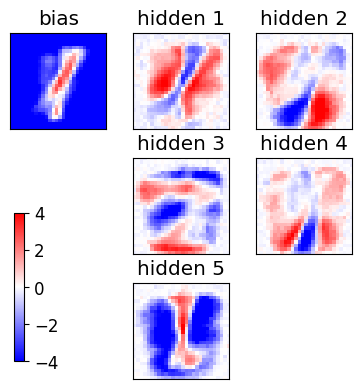

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

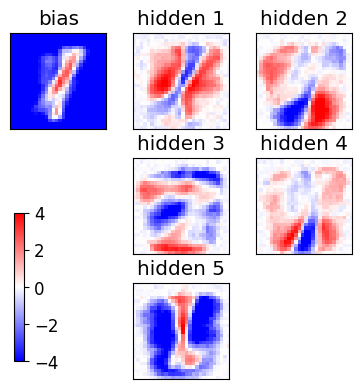

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

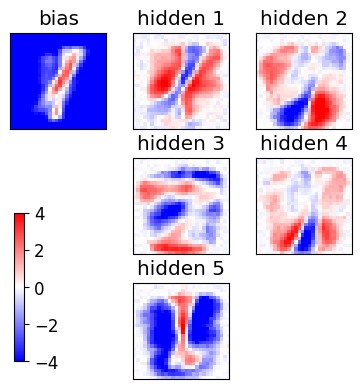

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

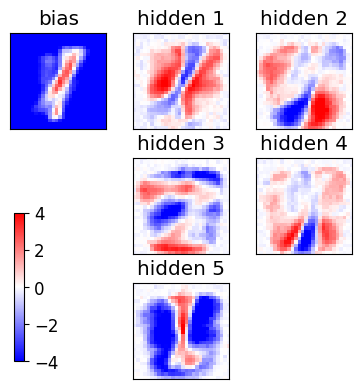

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

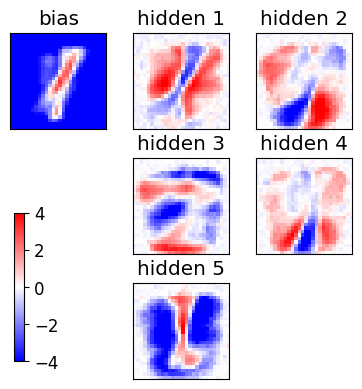

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

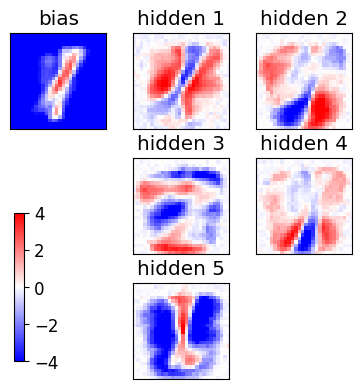

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

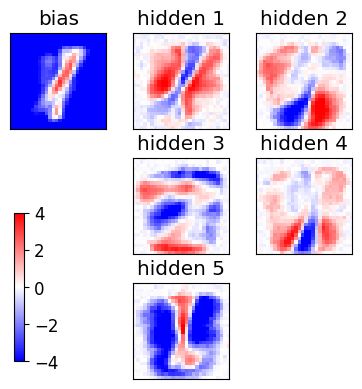

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

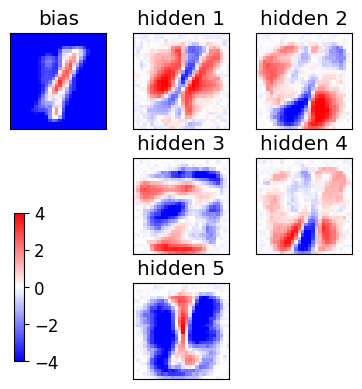

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

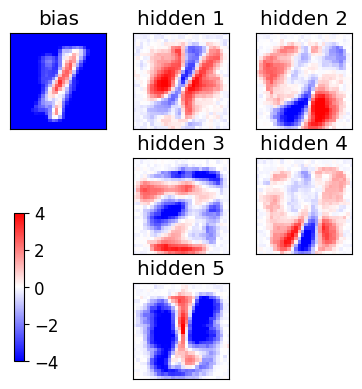

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

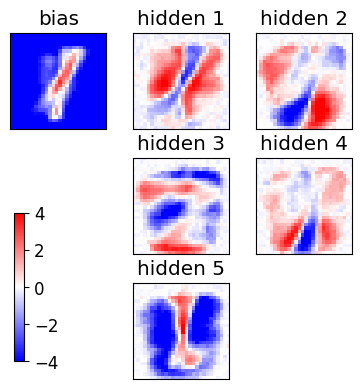

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

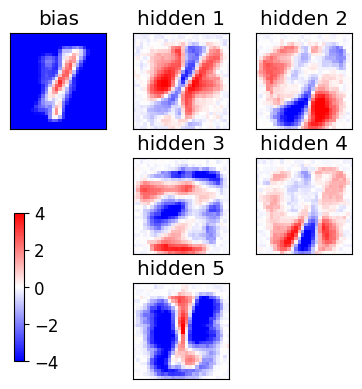

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

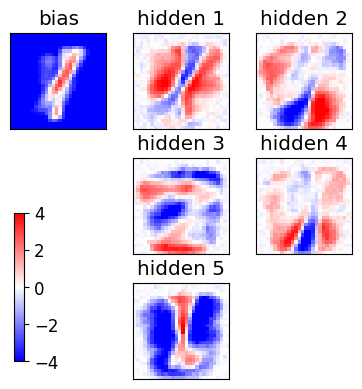

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

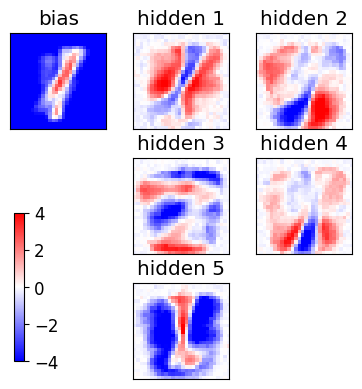

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0

<Figure size 640x480 with 0 Axes>

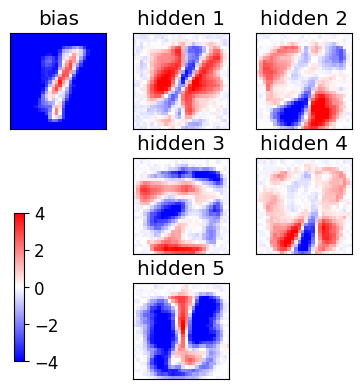

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

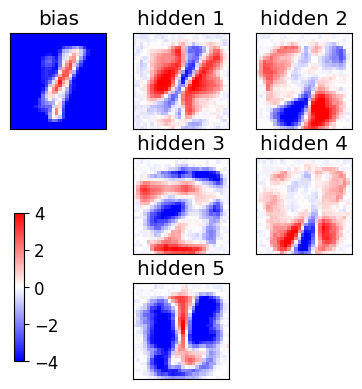

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

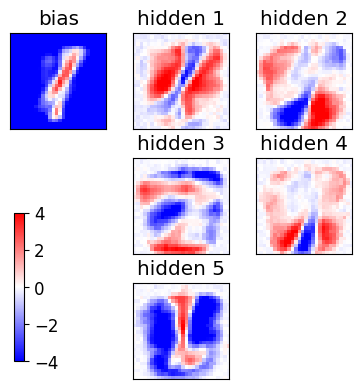

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

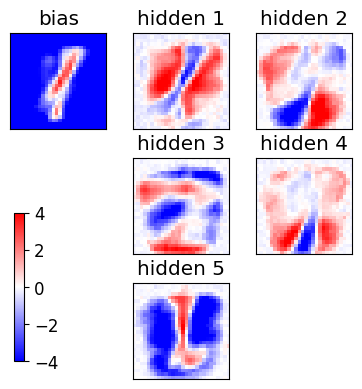

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

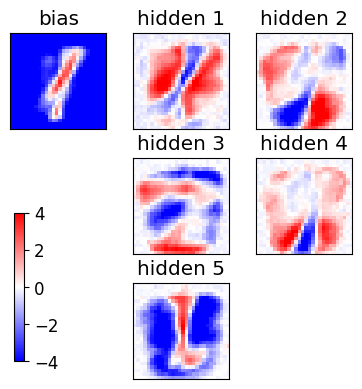

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

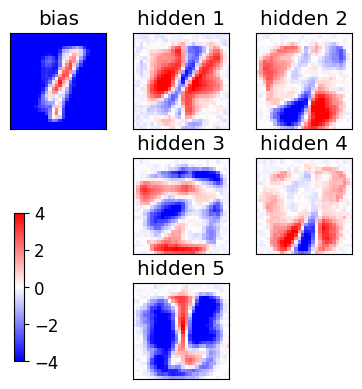

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

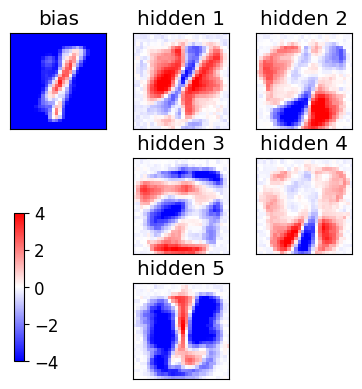

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

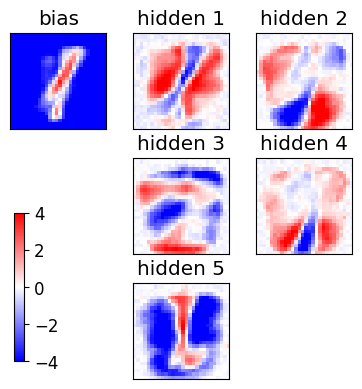

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

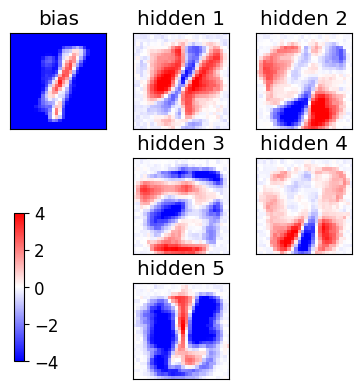

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

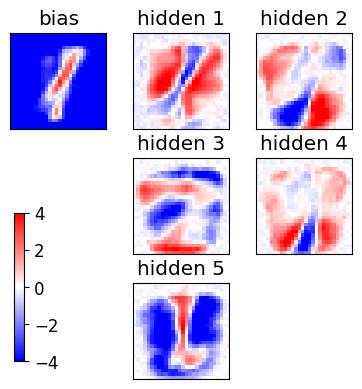

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

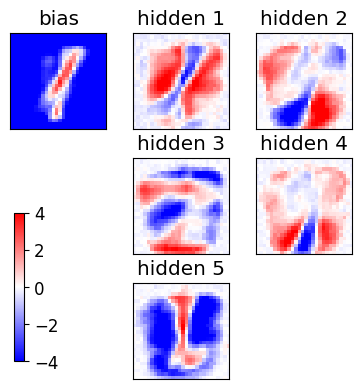

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

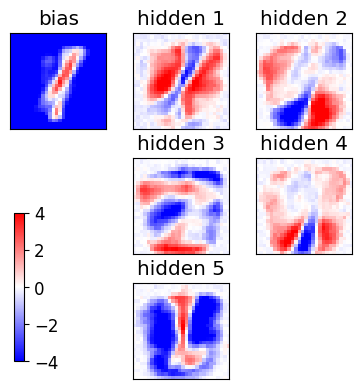

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

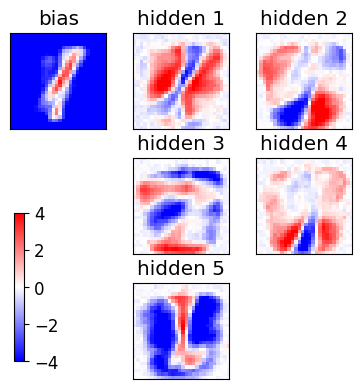

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

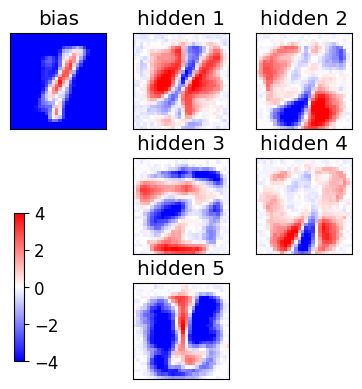

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

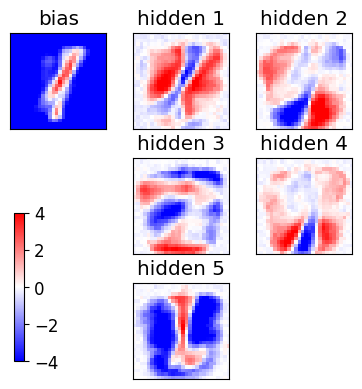

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

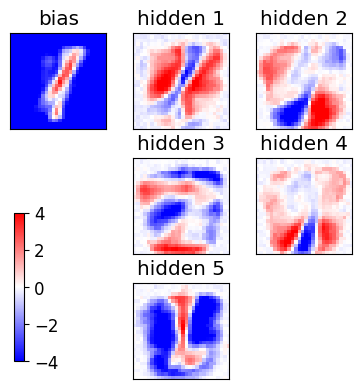

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

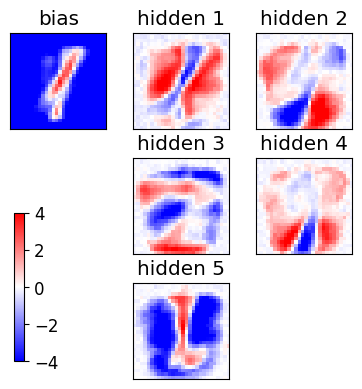

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

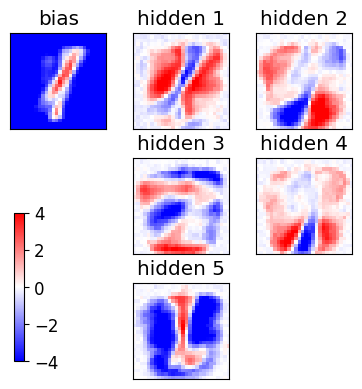

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

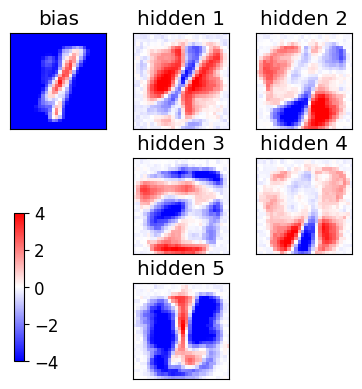

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

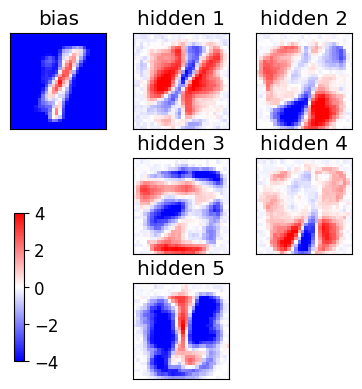

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 

<Figure size 640x480 with 0 Axes>

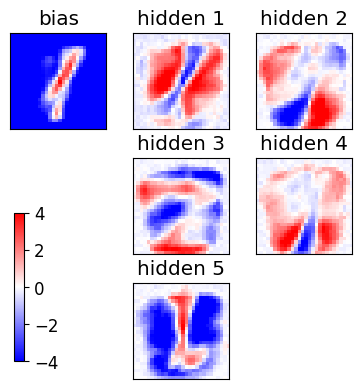

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

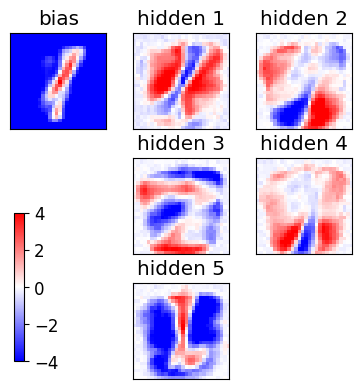

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

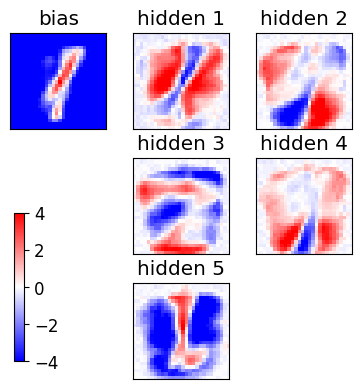

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

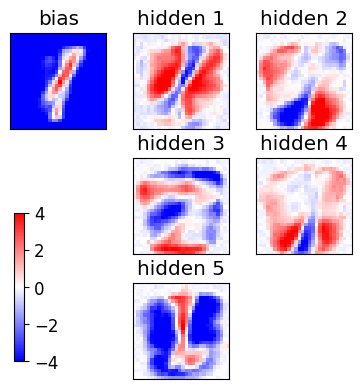

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

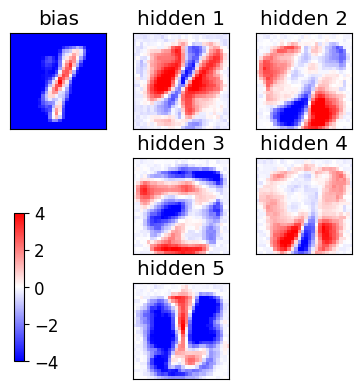

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

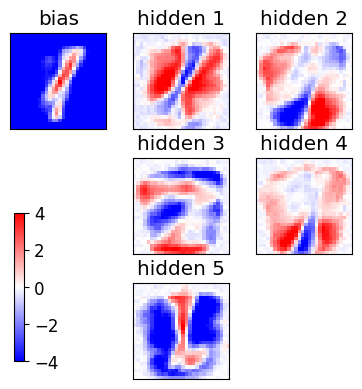

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

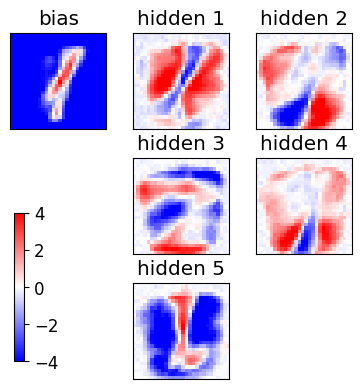

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

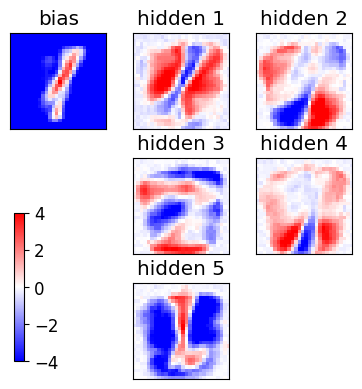

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

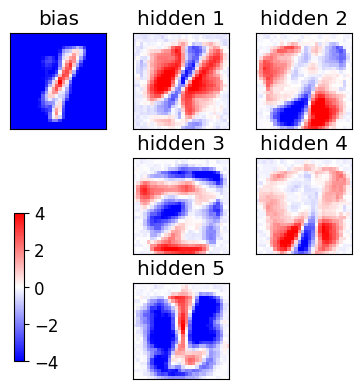

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

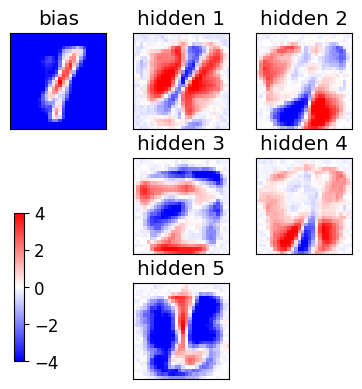

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

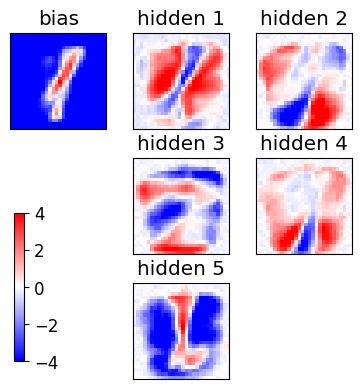

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

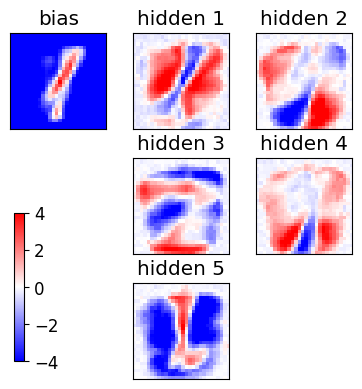

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

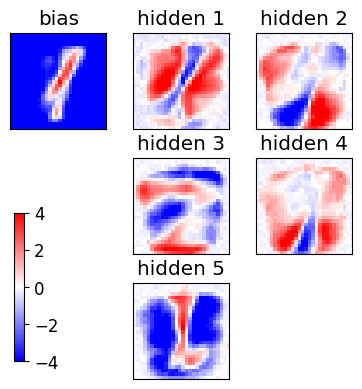

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

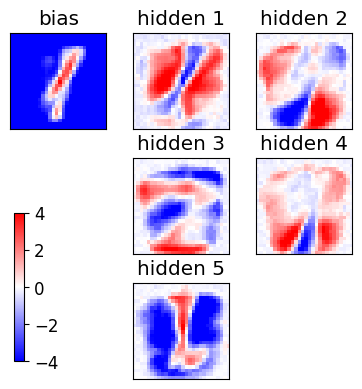

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

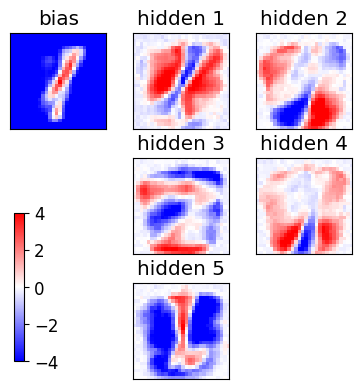

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

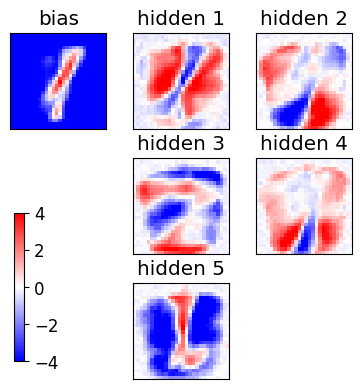

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

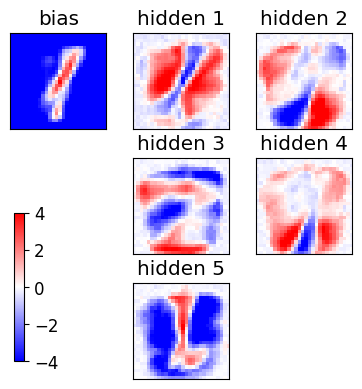

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

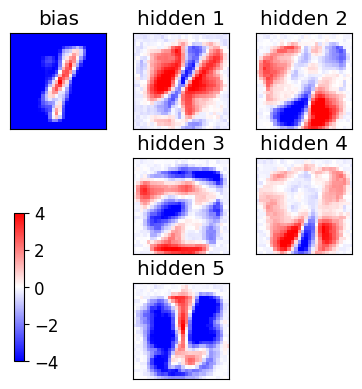

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

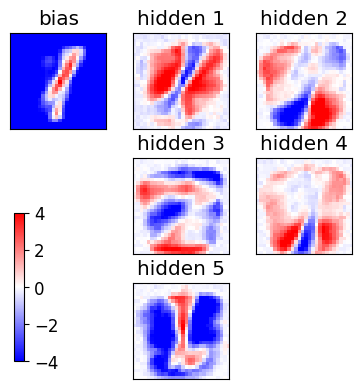

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

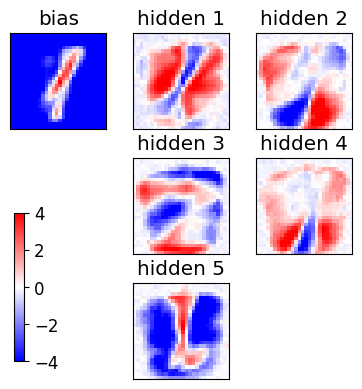

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  

<Figure size 640x480 with 0 Axes>

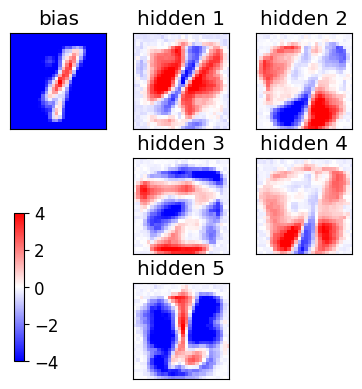

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

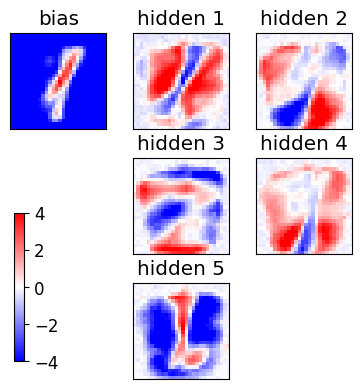

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

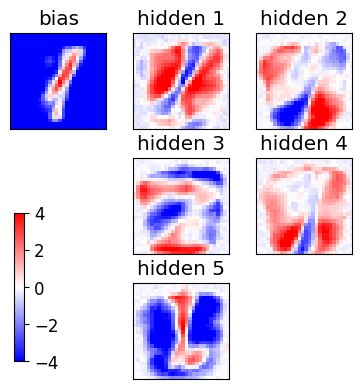

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

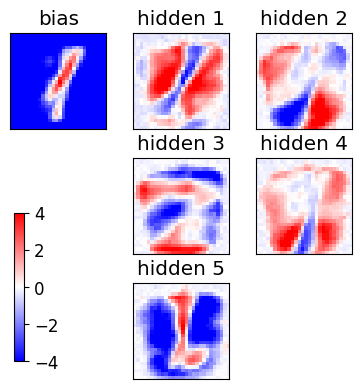

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

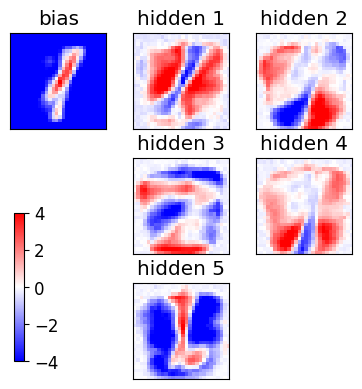

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

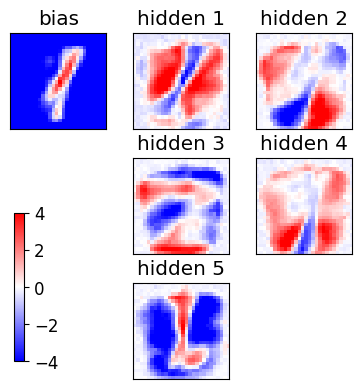

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

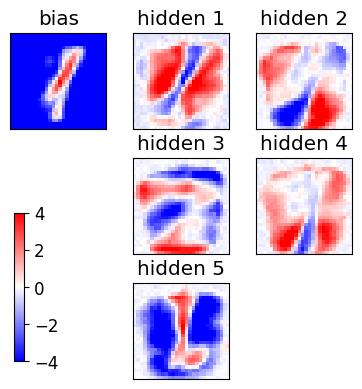

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

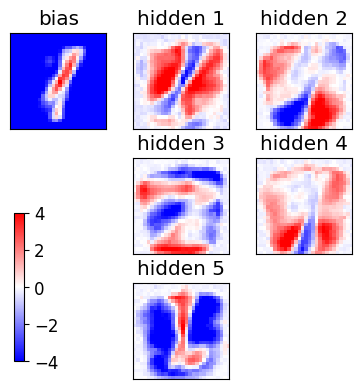

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

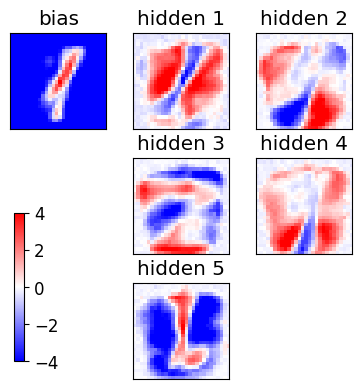

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

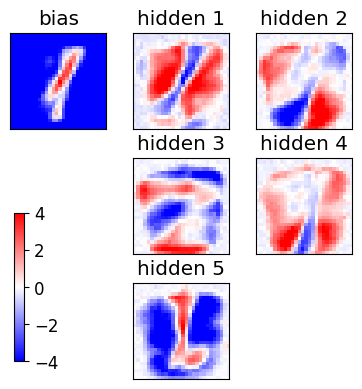

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

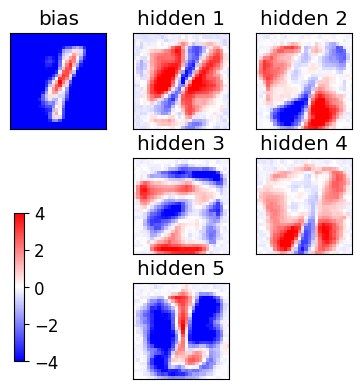

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

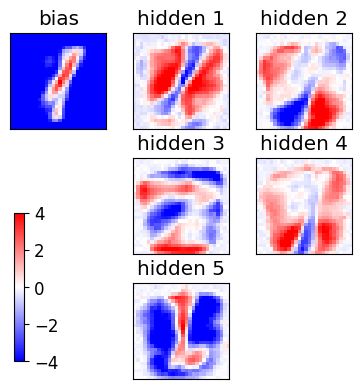

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

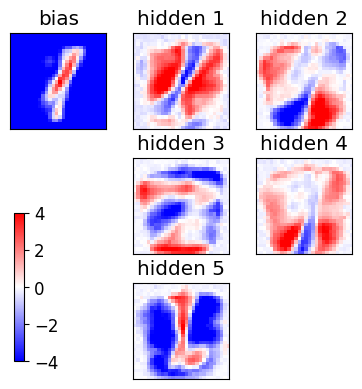

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

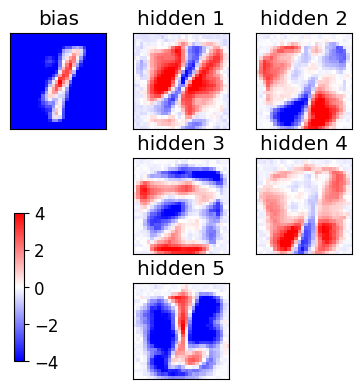

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

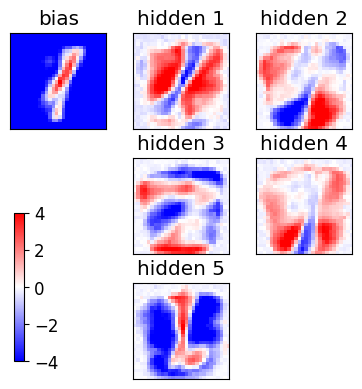

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

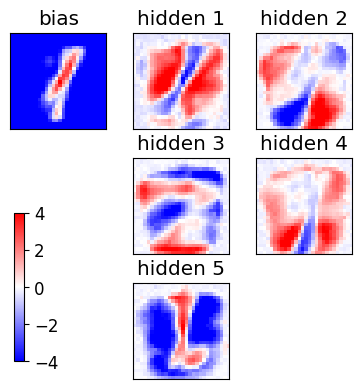

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

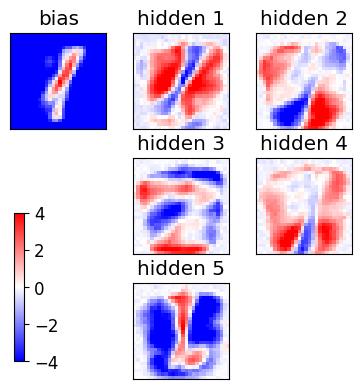

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

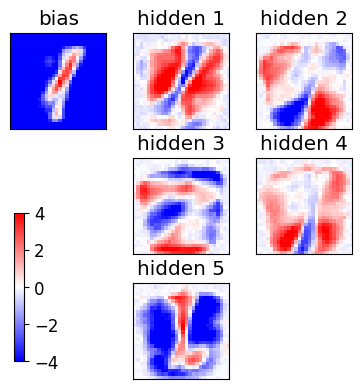

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

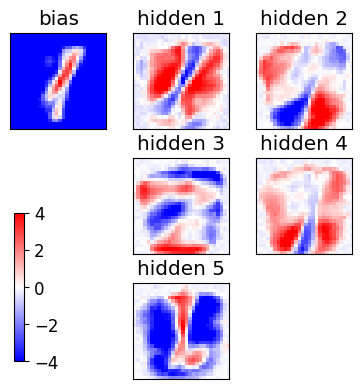

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

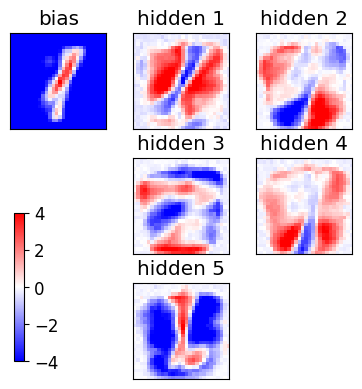

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  

<Figure size 640x480 with 0 Axes>

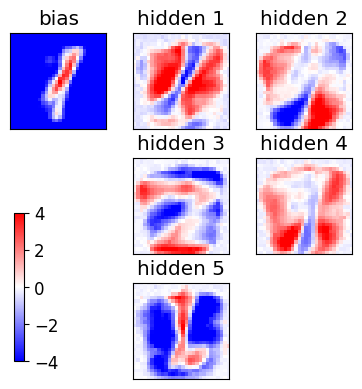

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

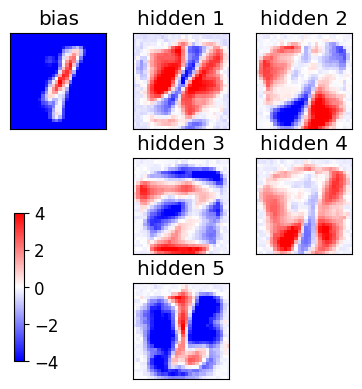

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

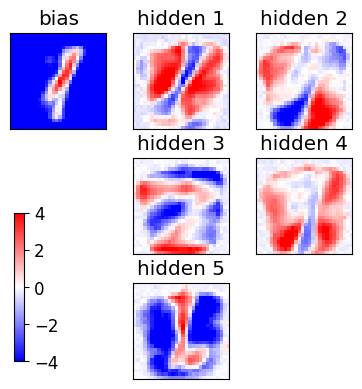

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

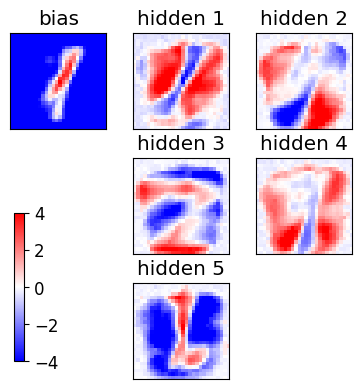

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

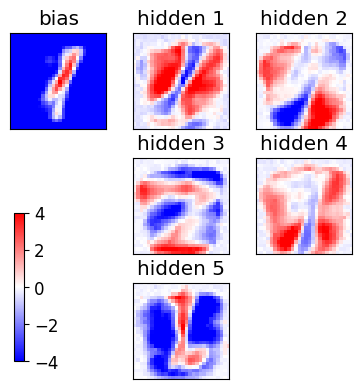

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

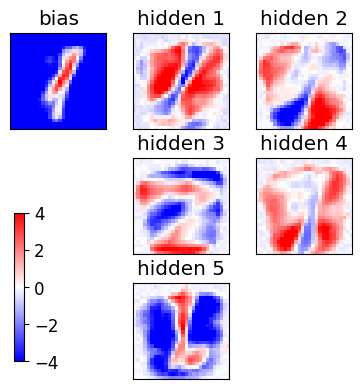

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

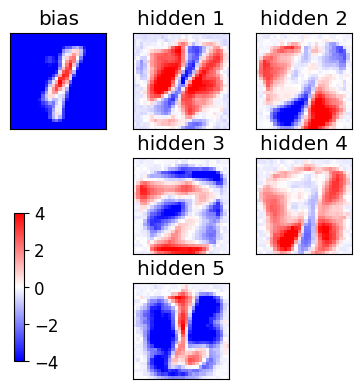

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

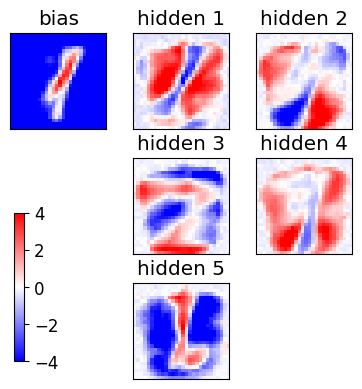

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

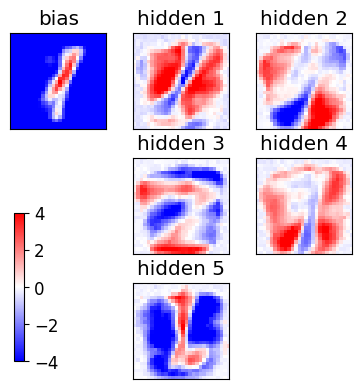

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

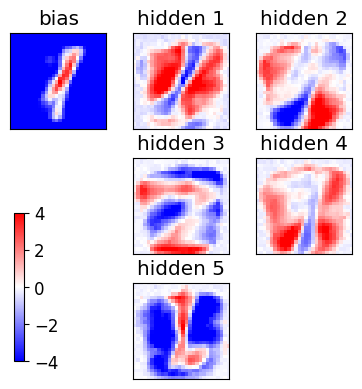

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

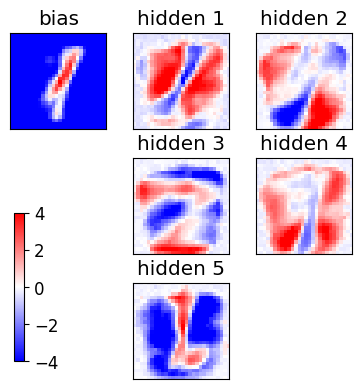

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

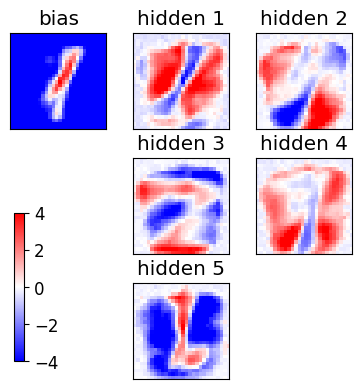

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

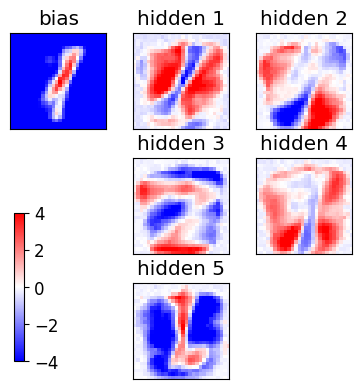

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

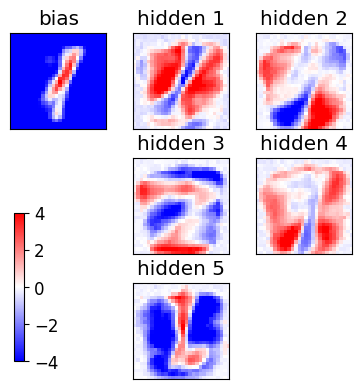

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

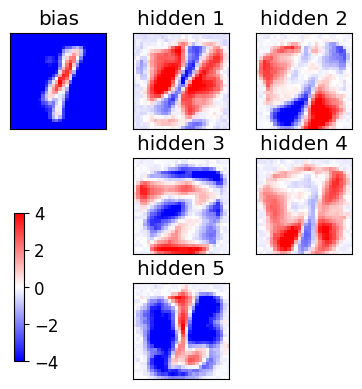

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

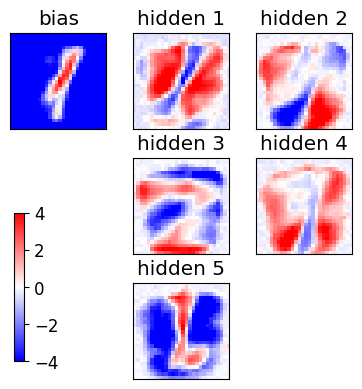

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

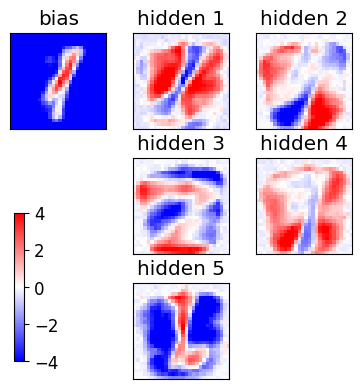

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

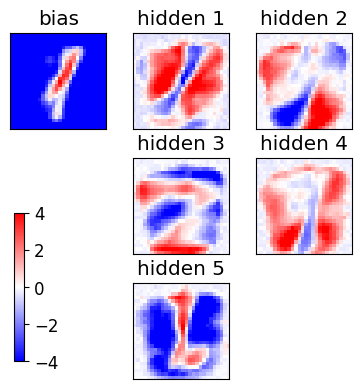

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

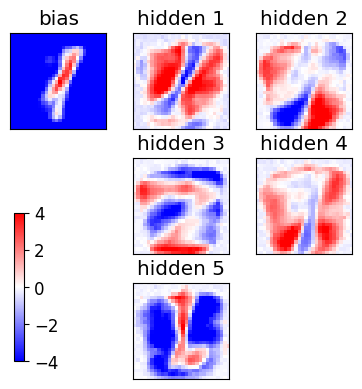

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

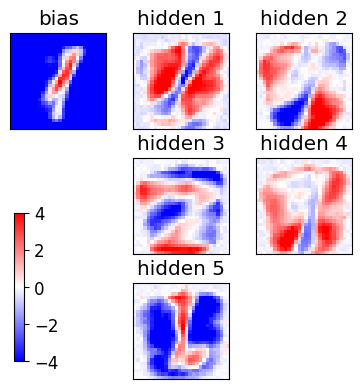

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  

<Figure size 640x480 with 0 Axes>

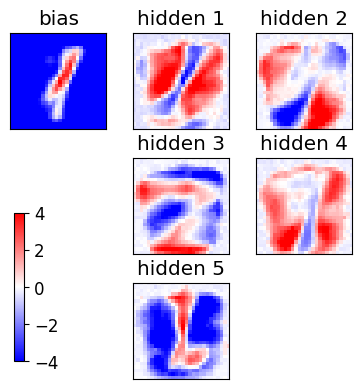

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

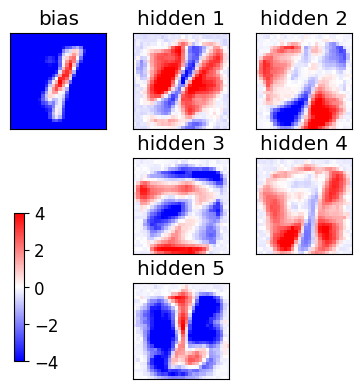

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

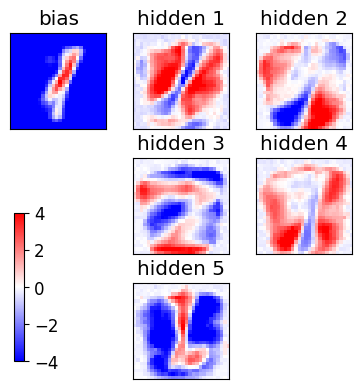

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

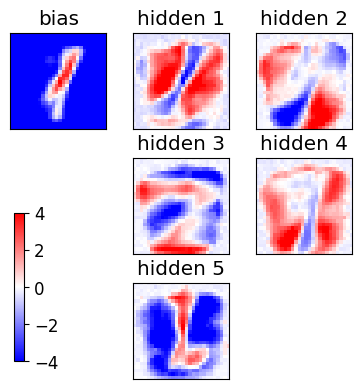

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

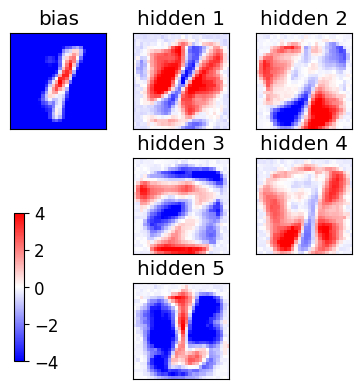

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

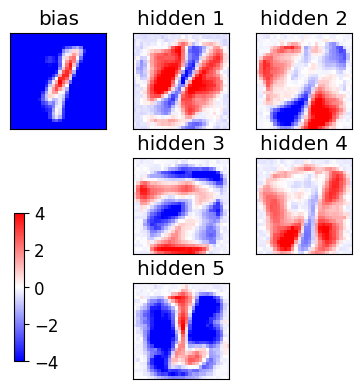

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

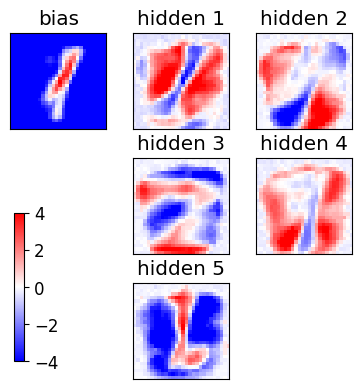

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

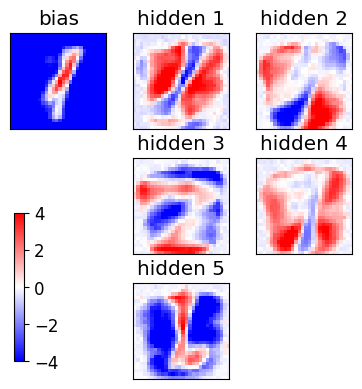

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

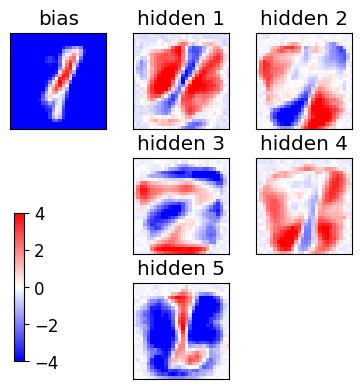

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

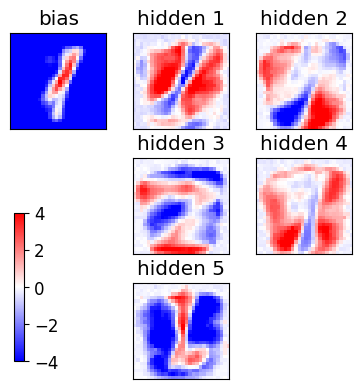

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

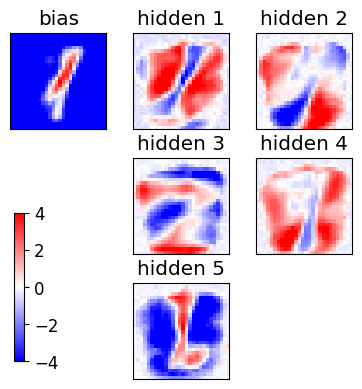

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

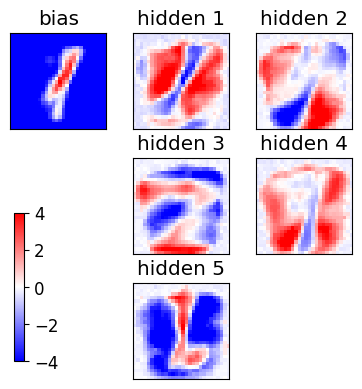

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

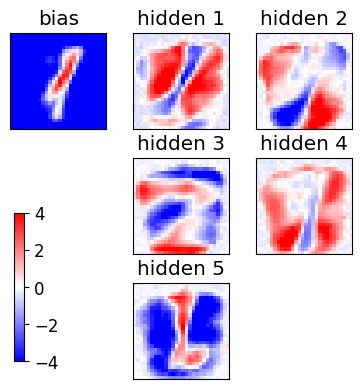

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

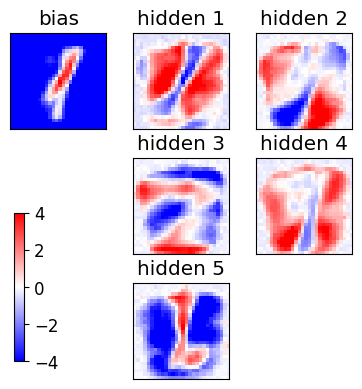

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

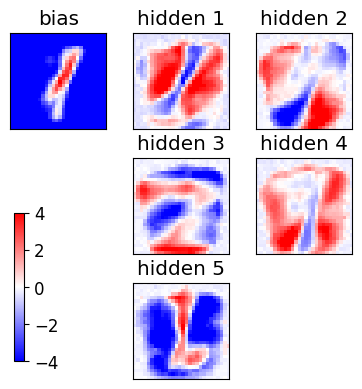

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

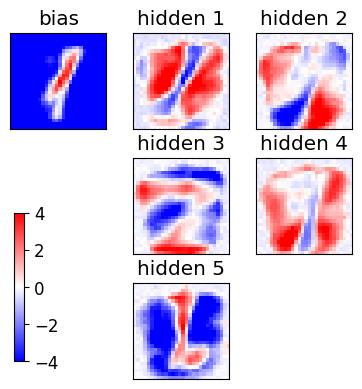

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

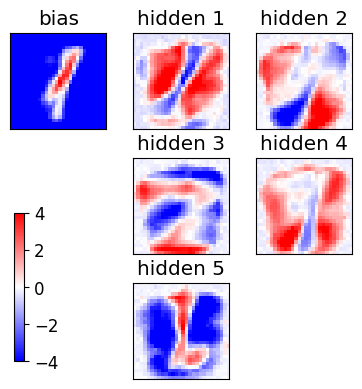

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

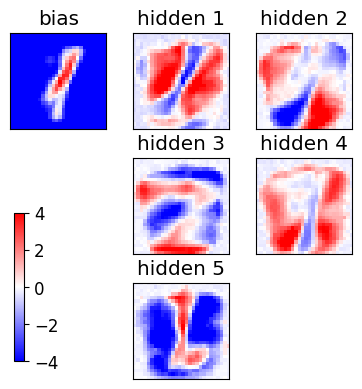

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

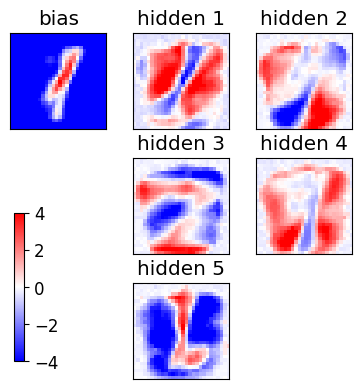

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.0001 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

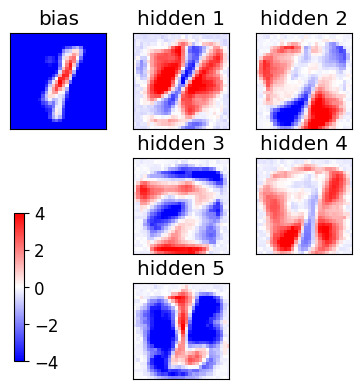

END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

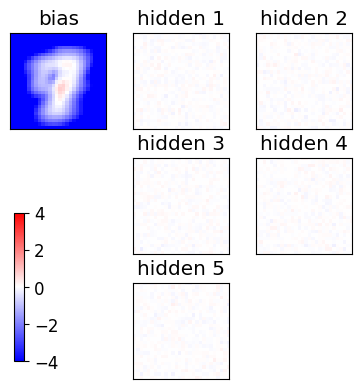

Starting the training
[20914 21166 12757  7459  1948  3950 15501 10401  3826 19217]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[19248  1389 12409 21545  7653   734  2184 17421  7675 16079]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[ 3633  4982 17509  3615  6681 21048 21865  7204  8197 18383]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
[18149  1111  1326   641   611  7318  9996 17939 15816 16573]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= Fa

<Figure size 640x480 with 0 Axes>

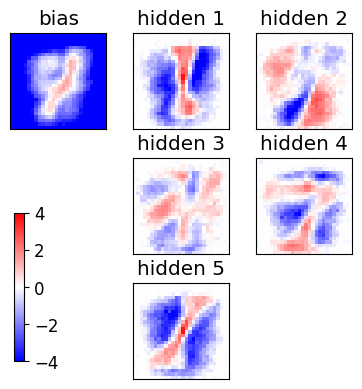

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

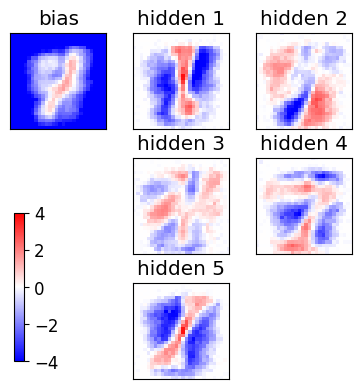

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

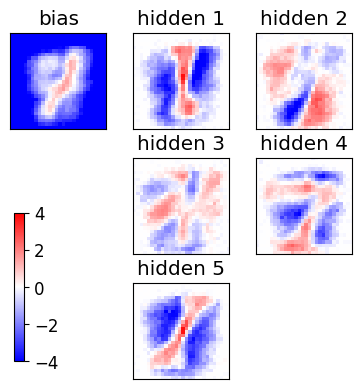

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

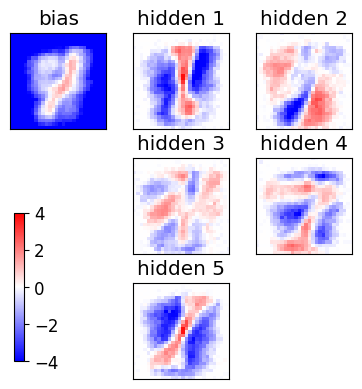

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

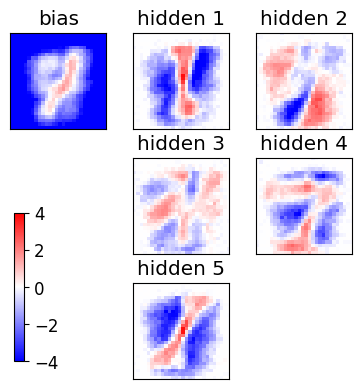

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

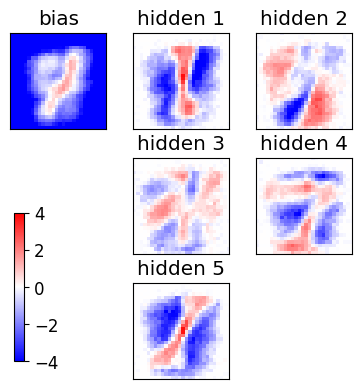

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

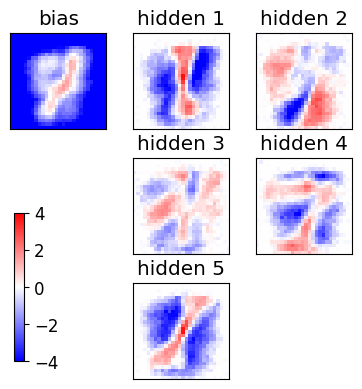

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

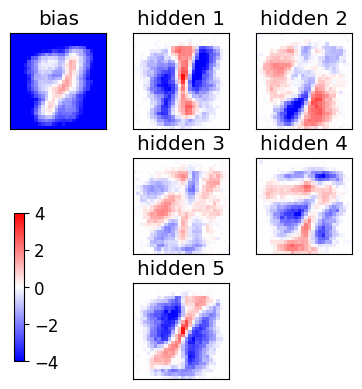

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

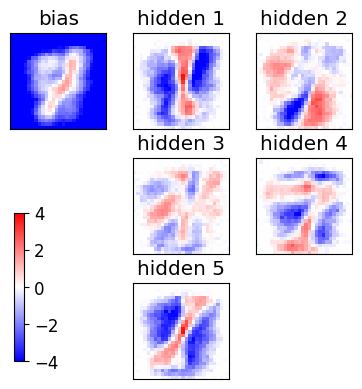

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

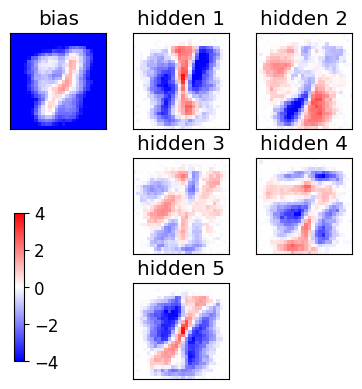

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

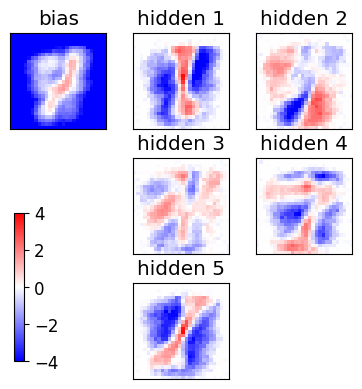

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

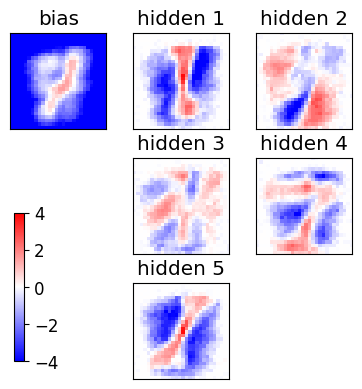

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

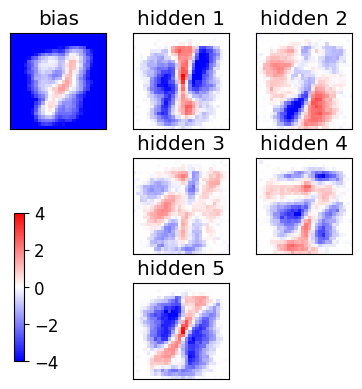

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

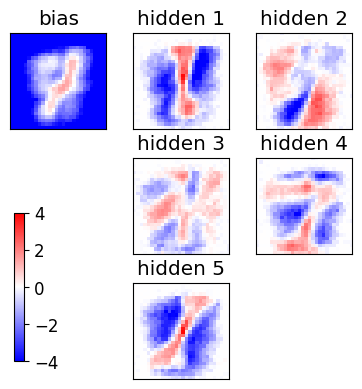

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

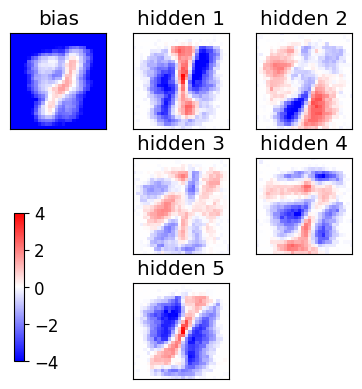

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

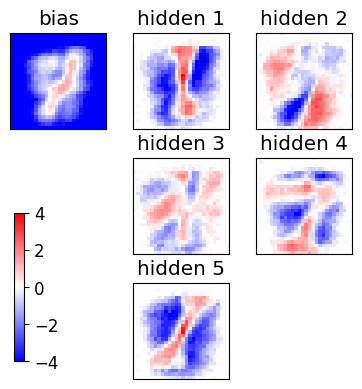

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

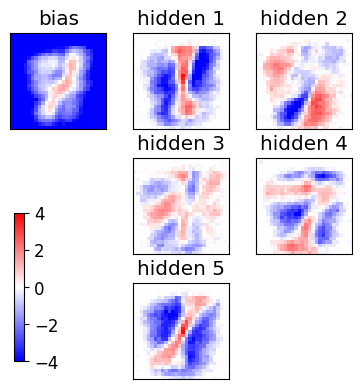

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

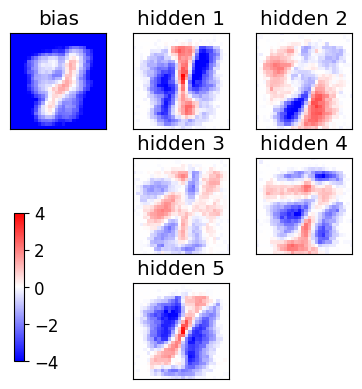

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

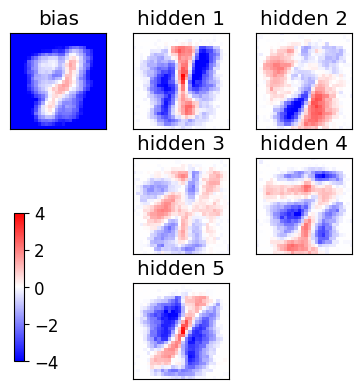

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

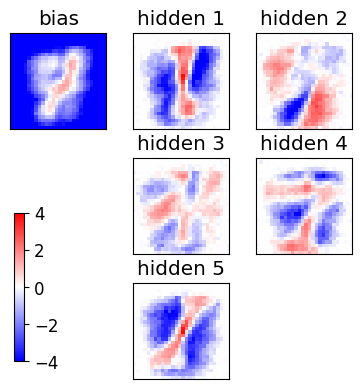

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

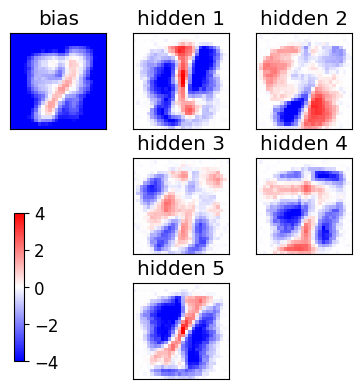

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

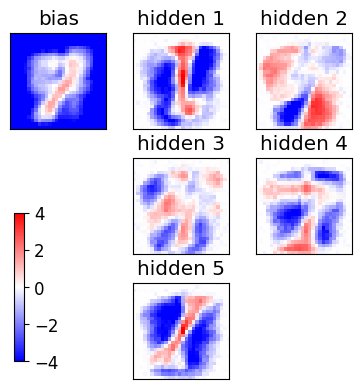

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

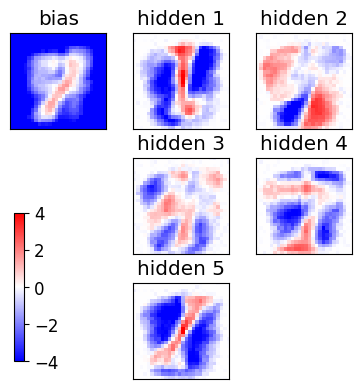

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

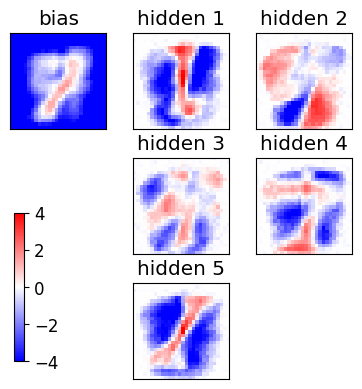

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

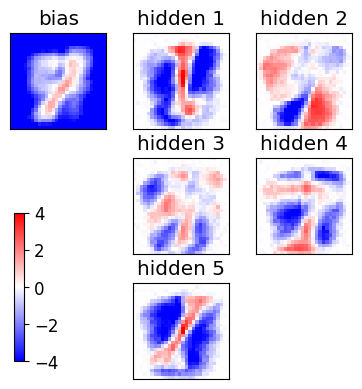

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

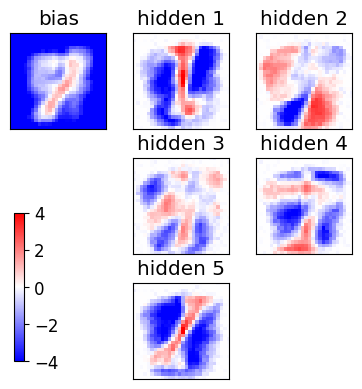

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

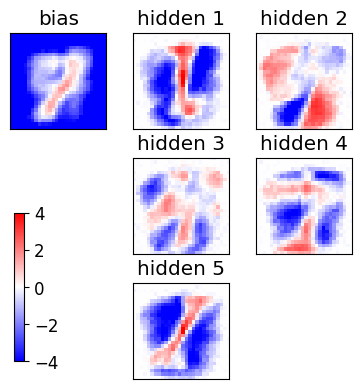

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

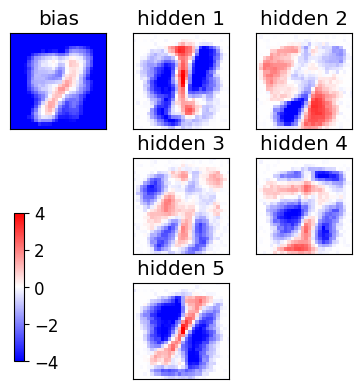

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

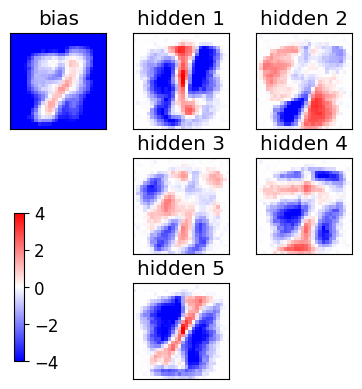

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

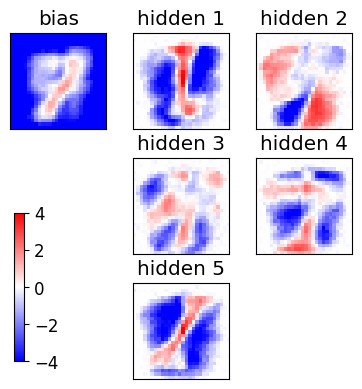

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

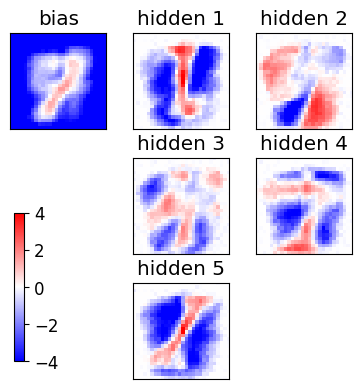

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

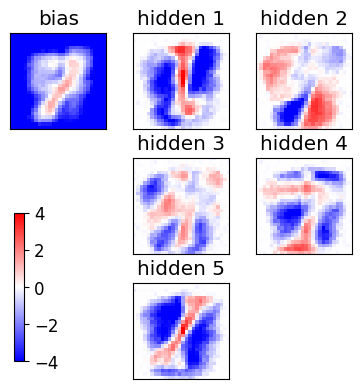

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

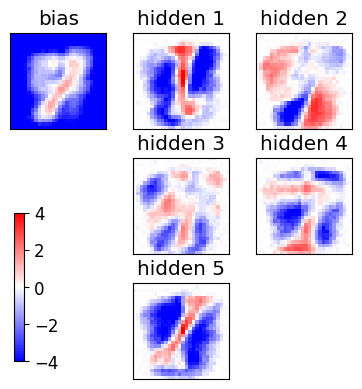

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

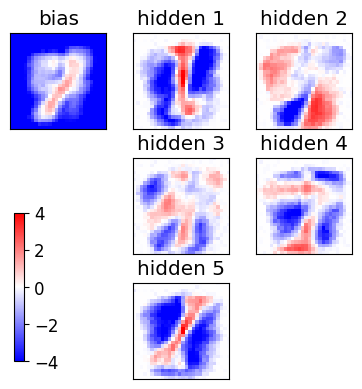

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

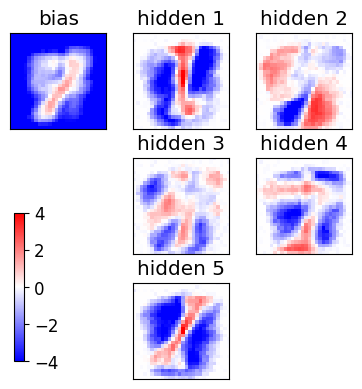

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

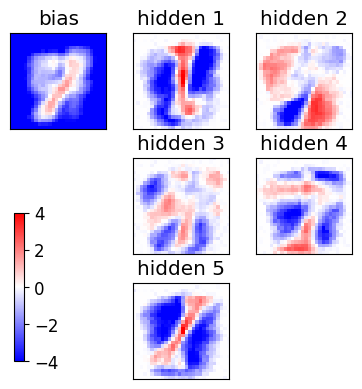

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

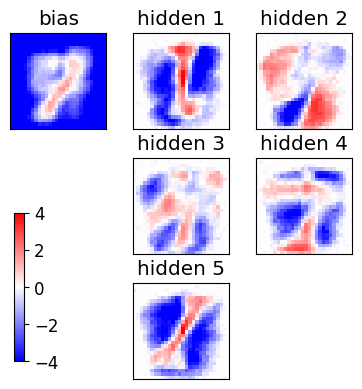

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

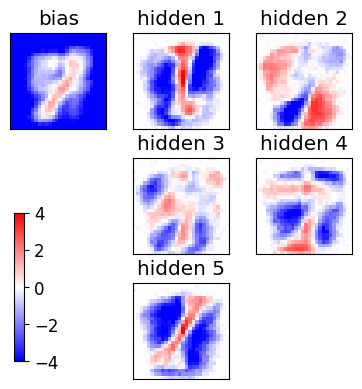

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

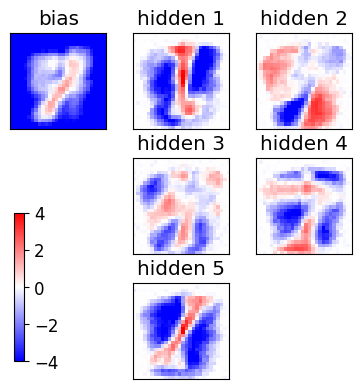

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

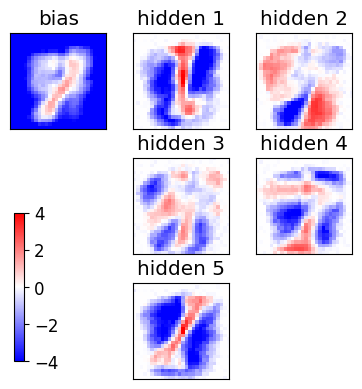

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

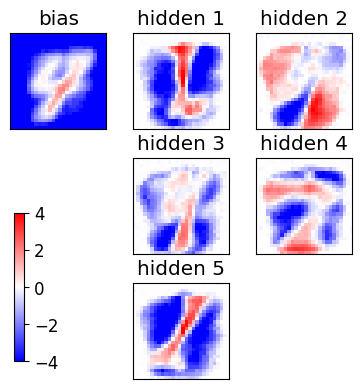

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

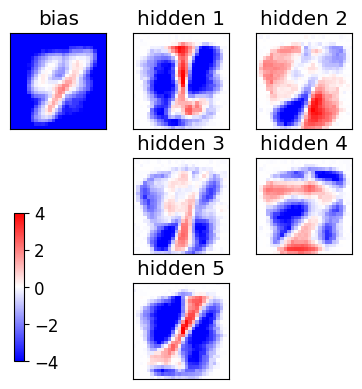

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

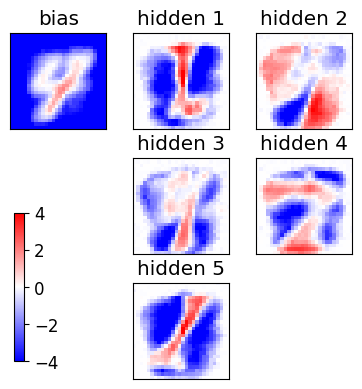

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

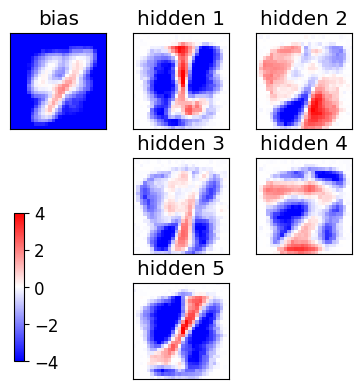

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

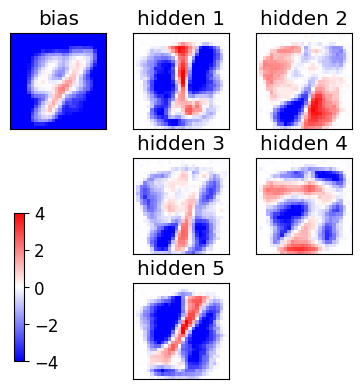

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

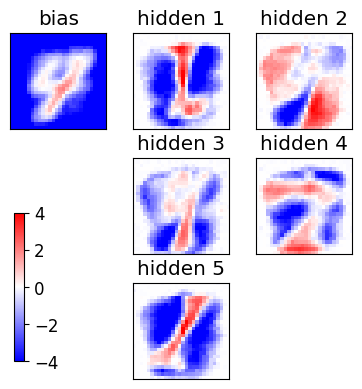

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

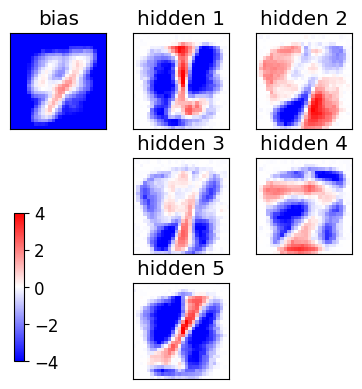

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

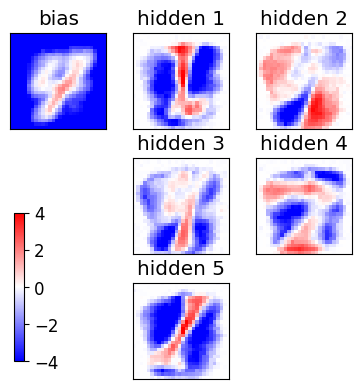

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

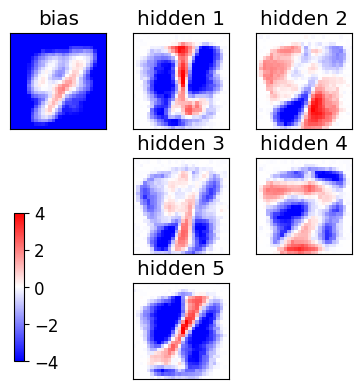

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

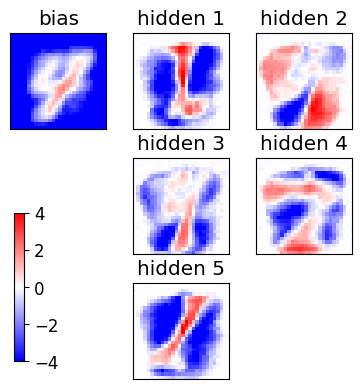

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

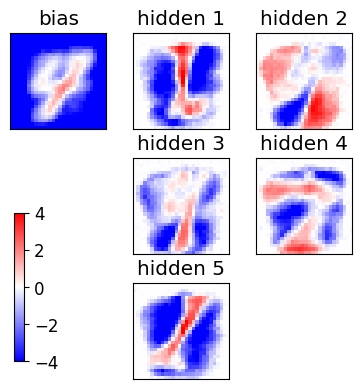

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

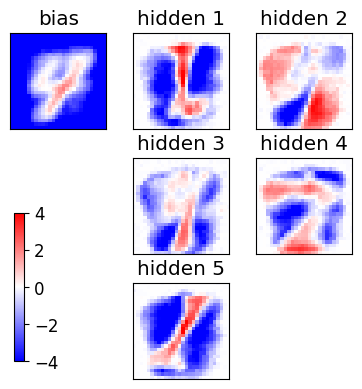

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

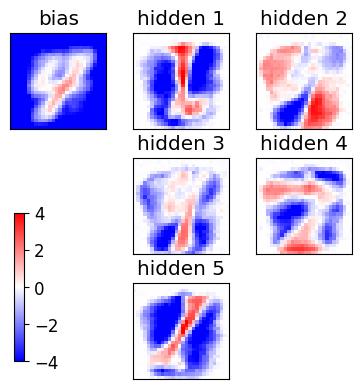

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

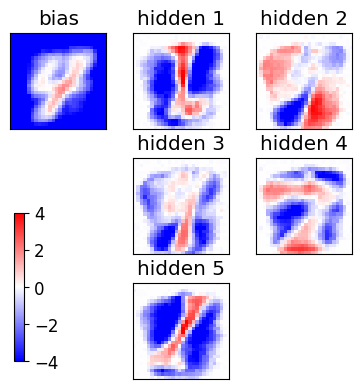

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

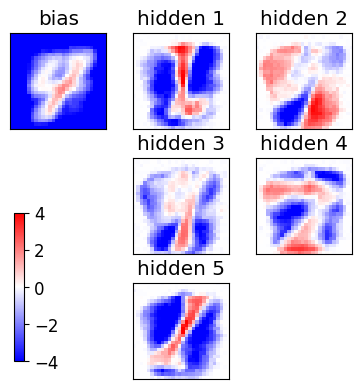

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

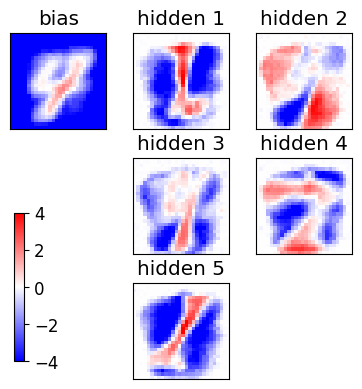

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

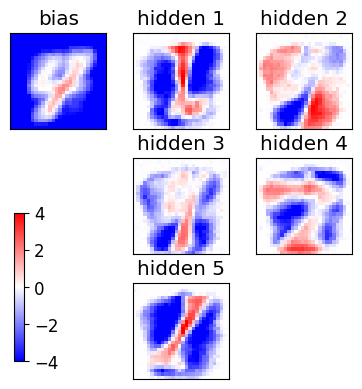

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

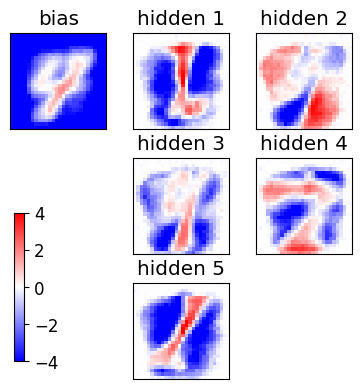

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

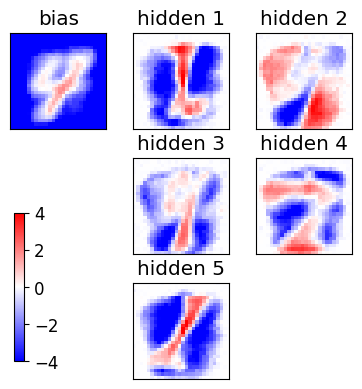

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

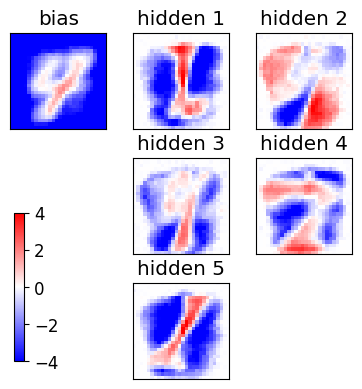

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

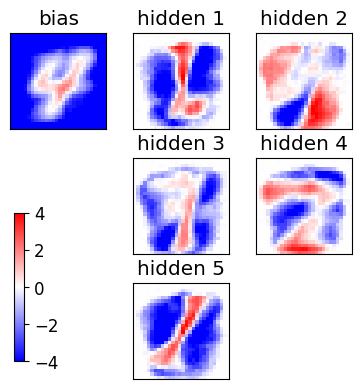

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

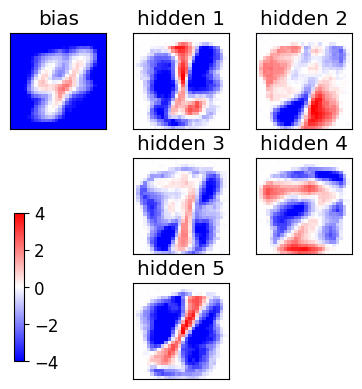

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

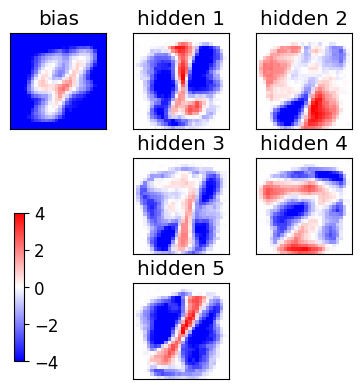

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

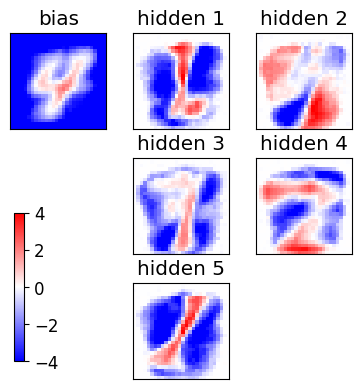

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

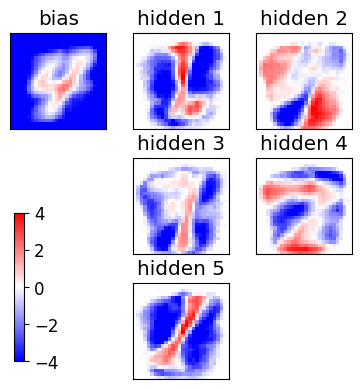

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

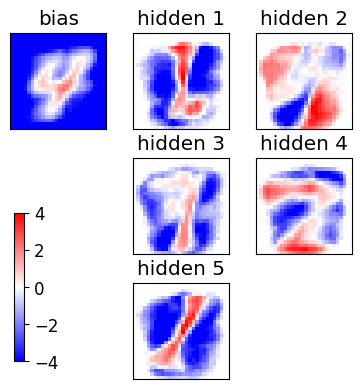

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

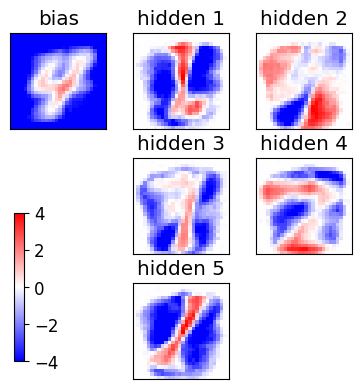

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

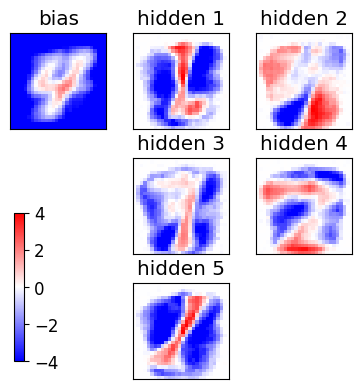

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

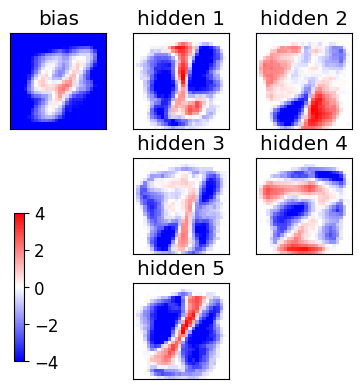

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

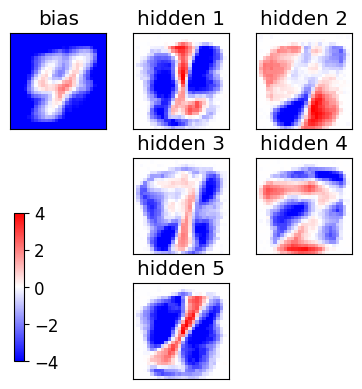

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

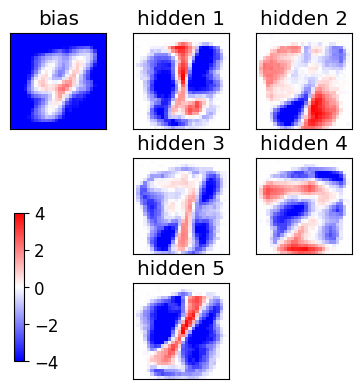

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

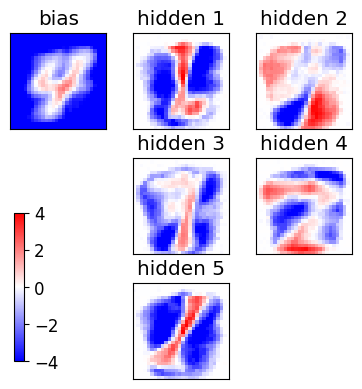

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

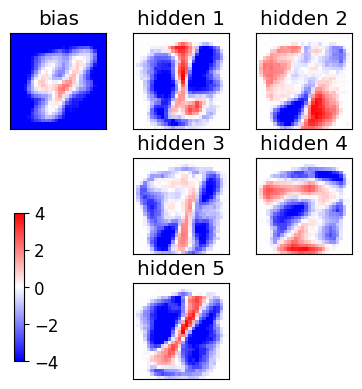

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

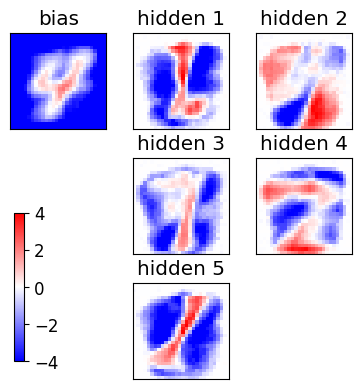

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

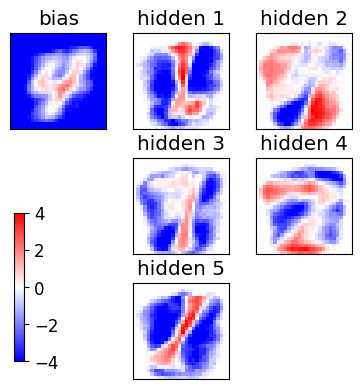

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

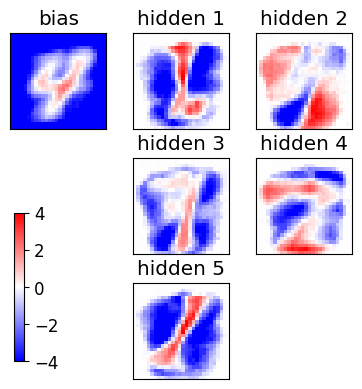

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

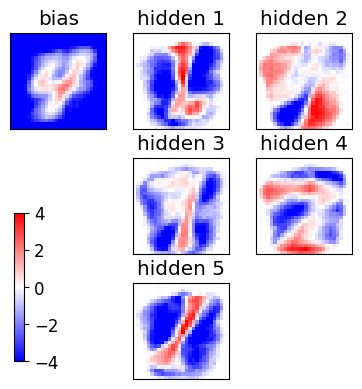

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

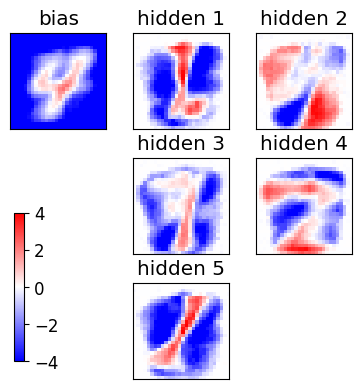

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

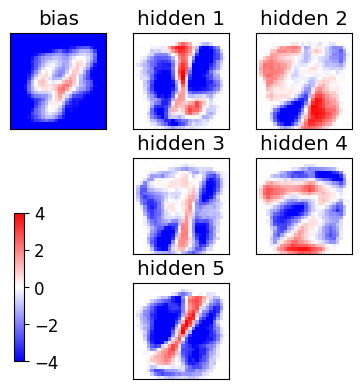

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

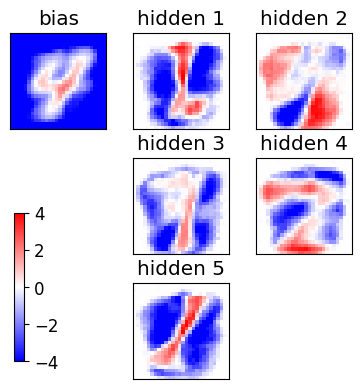

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS=

<Figure size 640x480 with 0 Axes>

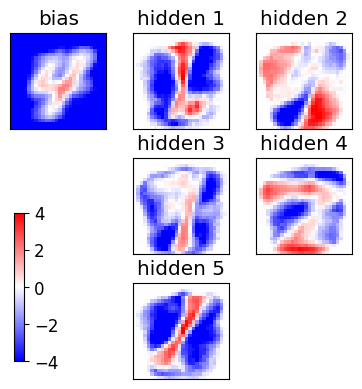

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

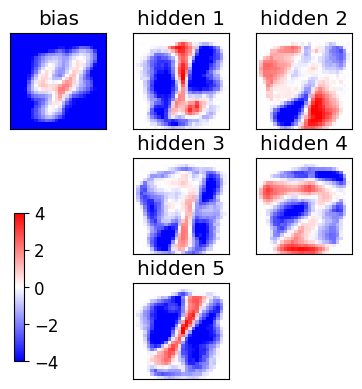

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

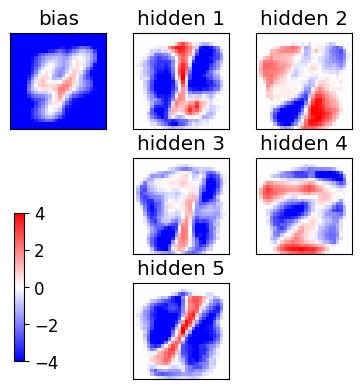

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

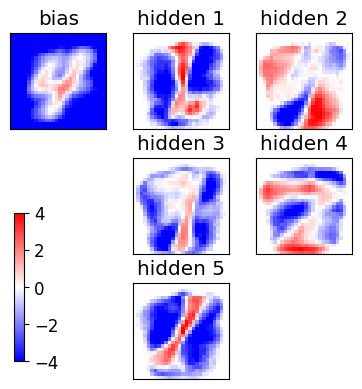

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

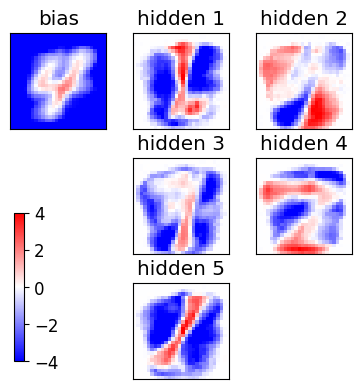

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

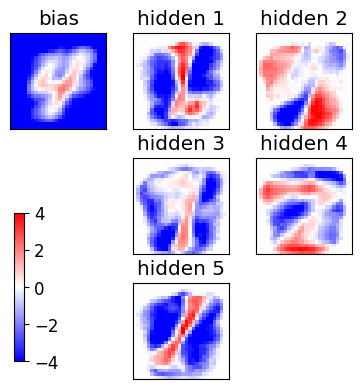

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

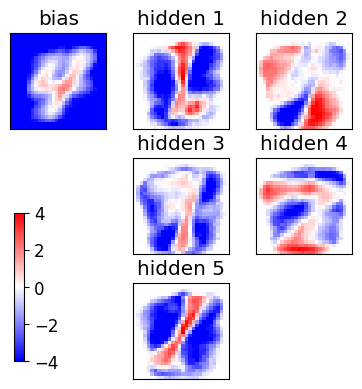

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

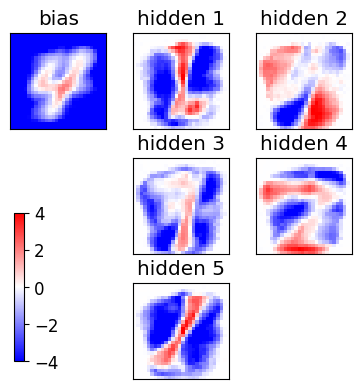

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

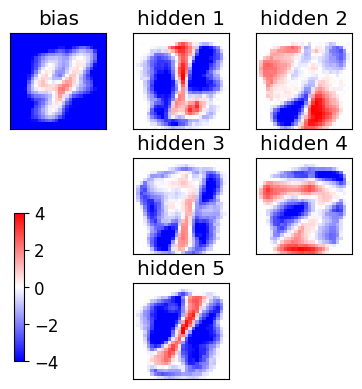

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

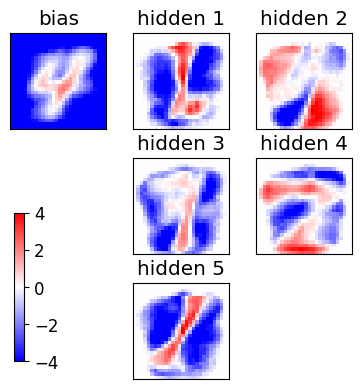

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

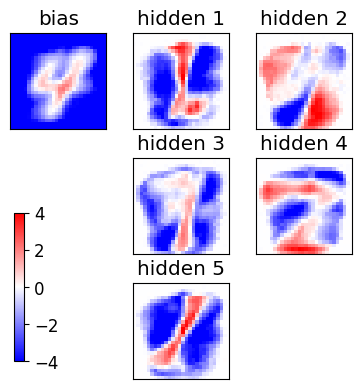

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

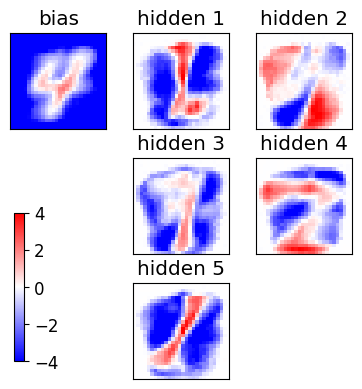

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

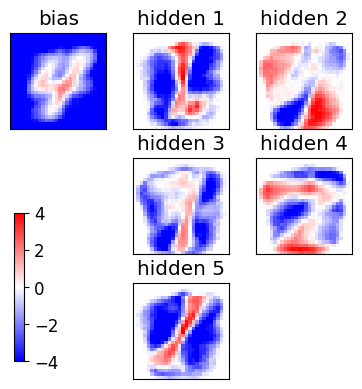

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

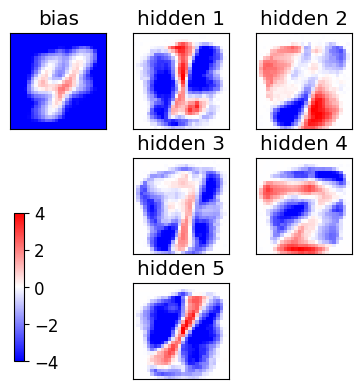

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

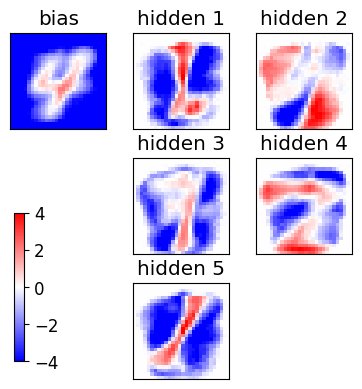

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

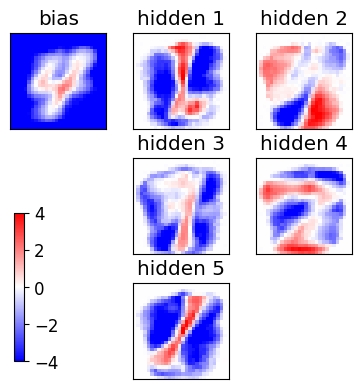

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

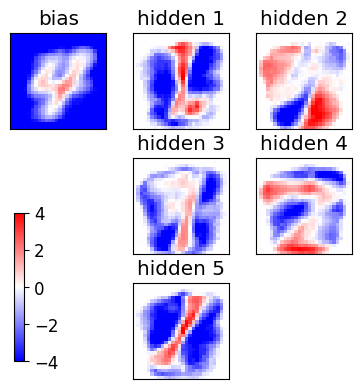

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

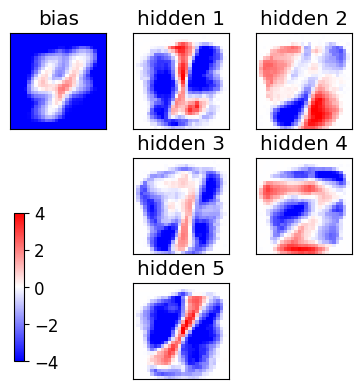

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

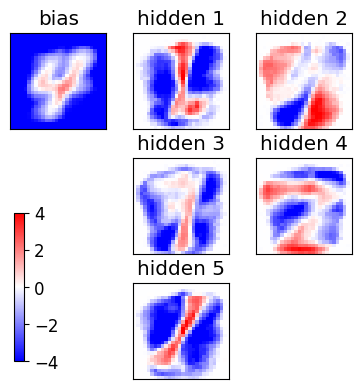

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

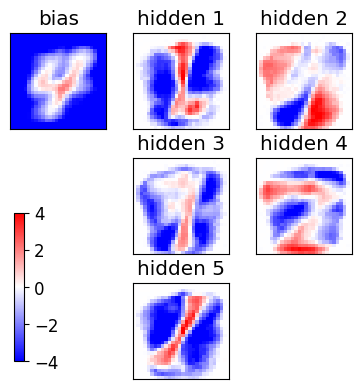

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

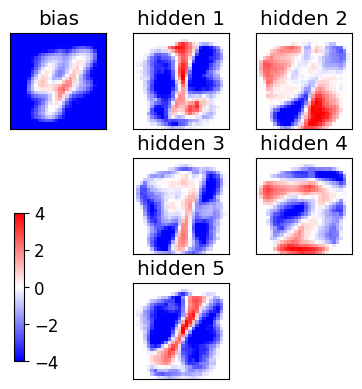

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

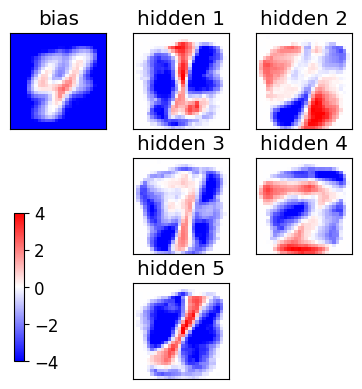

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

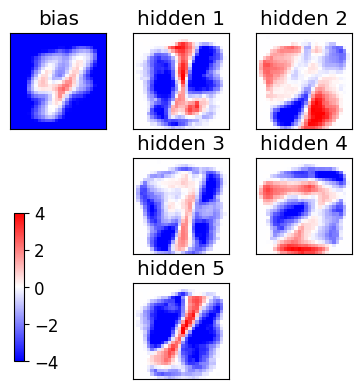

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

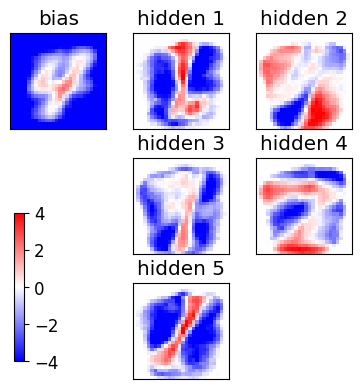

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

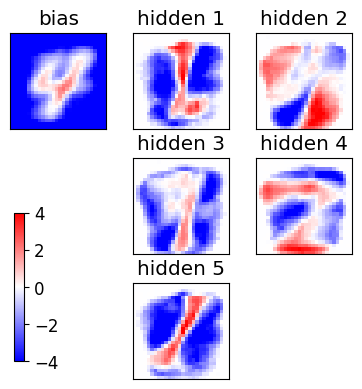

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

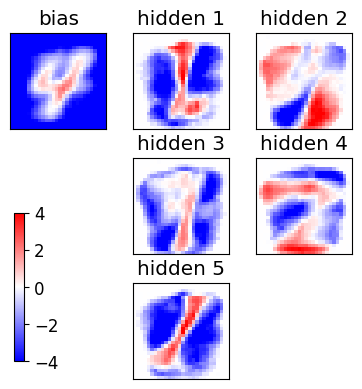

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

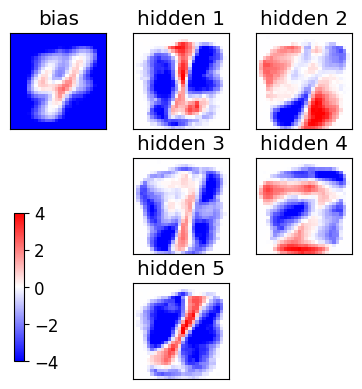

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

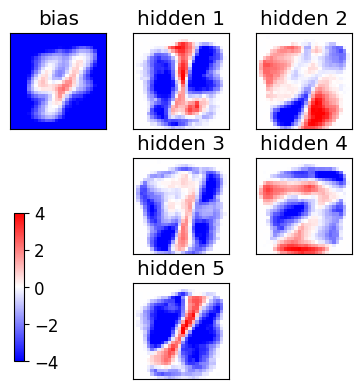

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

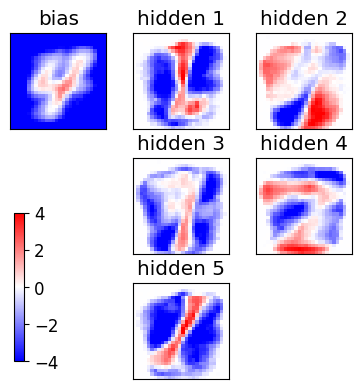

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

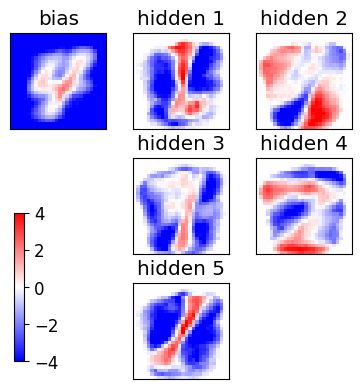

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

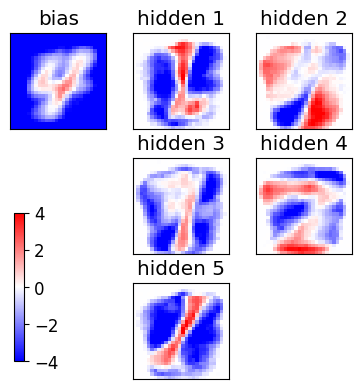

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

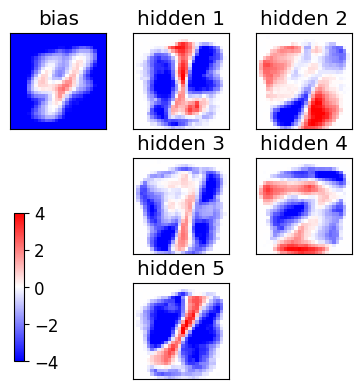

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

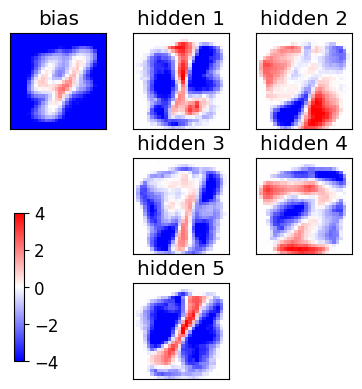

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

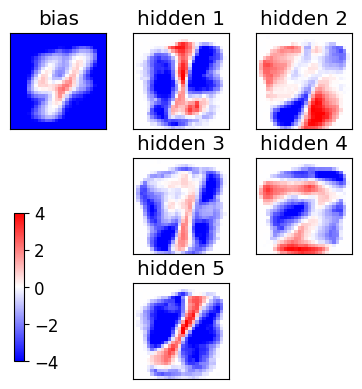

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

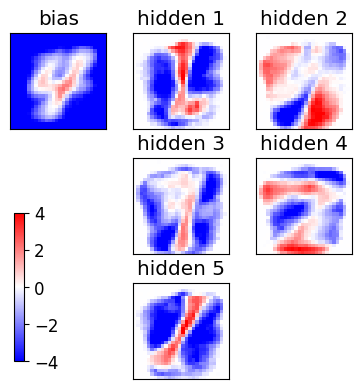

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

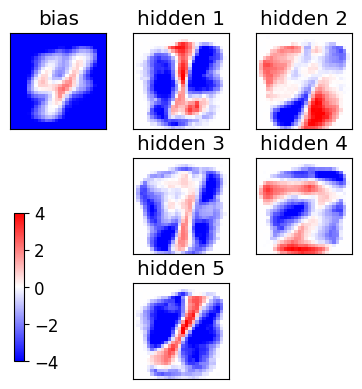

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

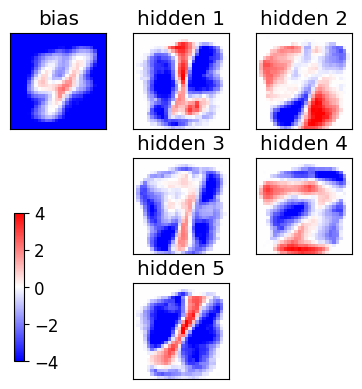

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

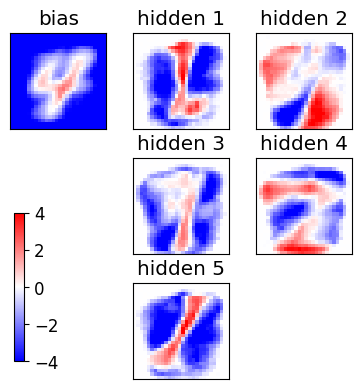

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

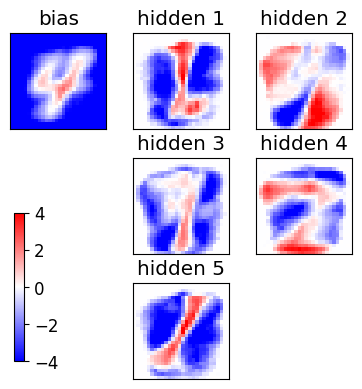

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

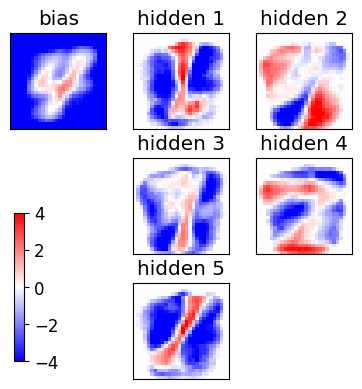

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

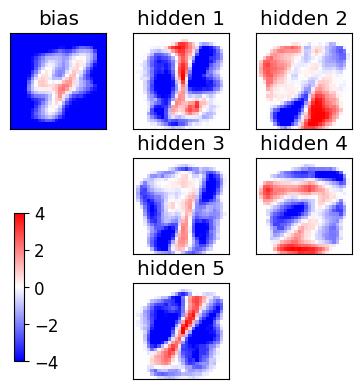

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

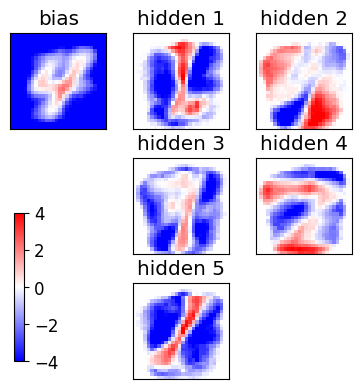

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

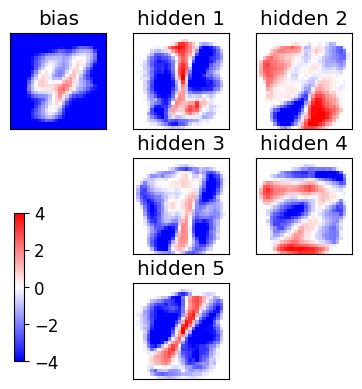

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

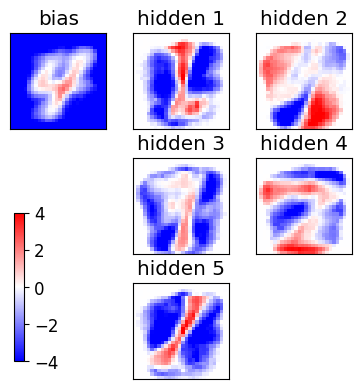

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

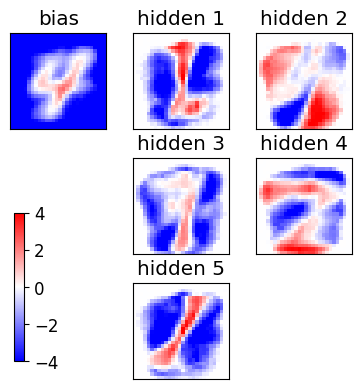

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

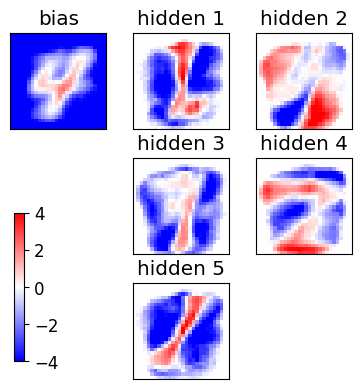

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

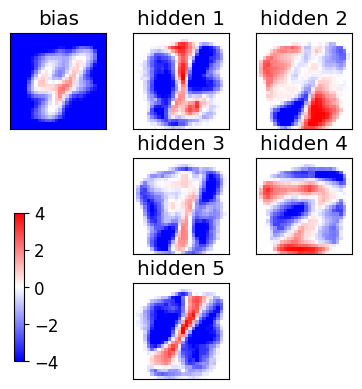

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

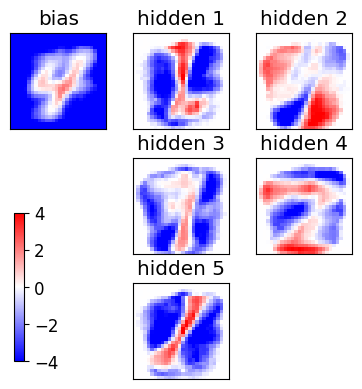

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

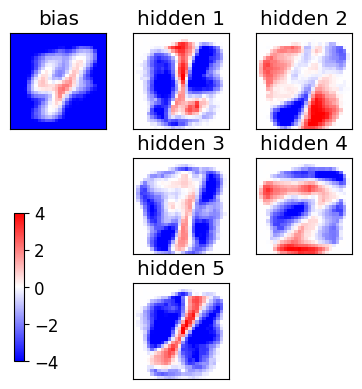

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

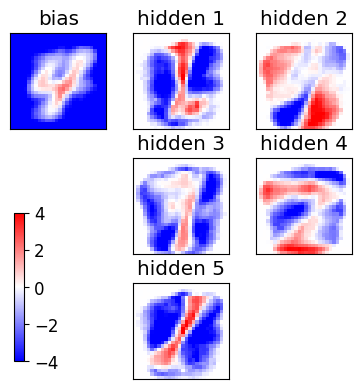

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

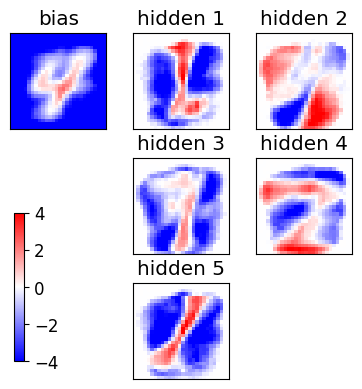

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

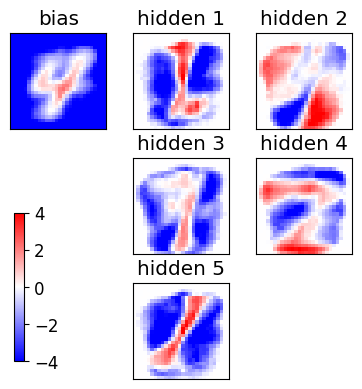

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

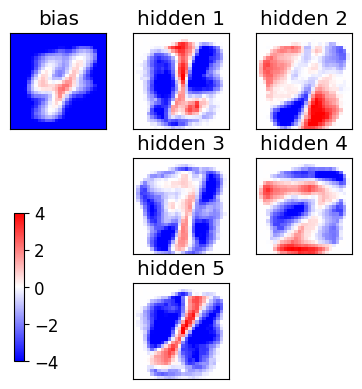

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

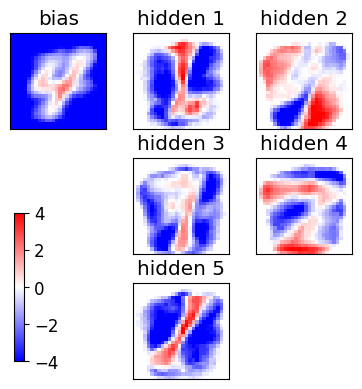

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

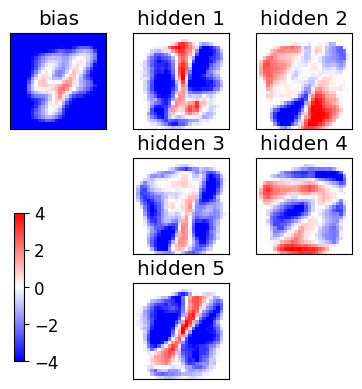

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

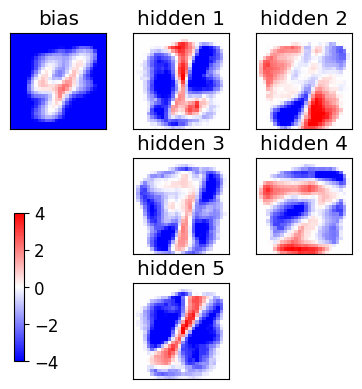

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

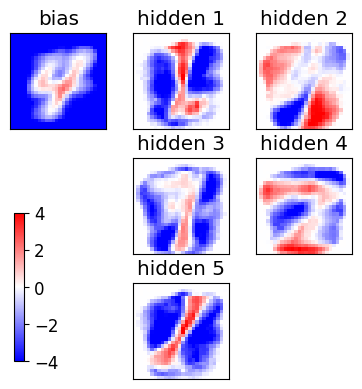

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

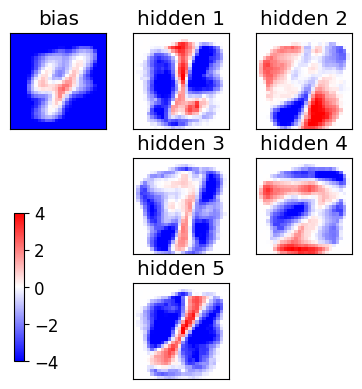

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

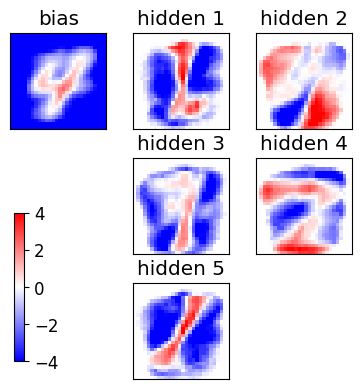

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

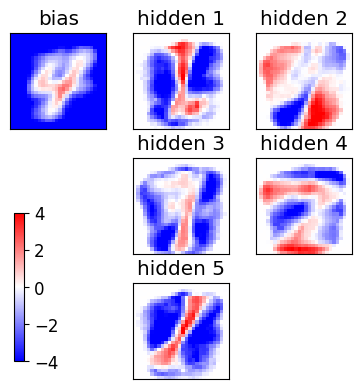

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam:

<Figure size 640x480 with 0 Axes>

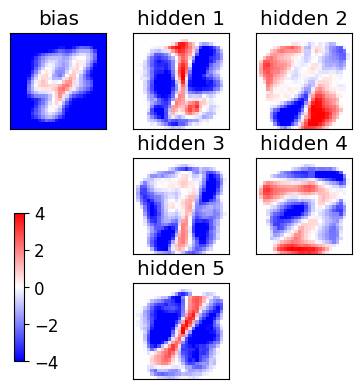

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

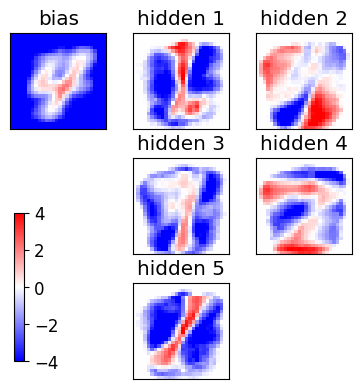

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

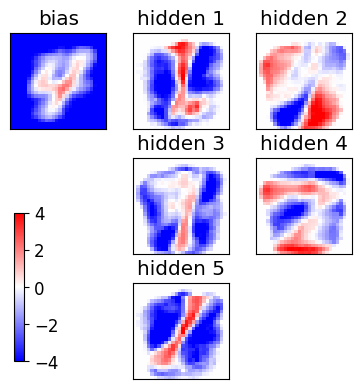

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

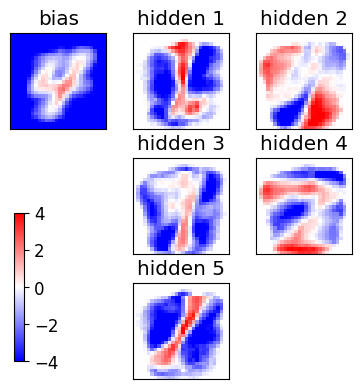

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

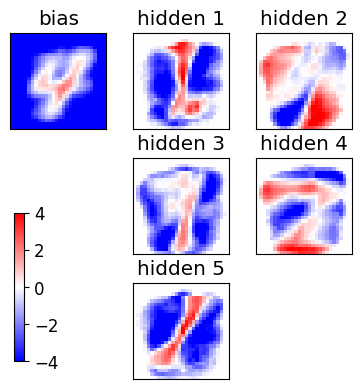

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

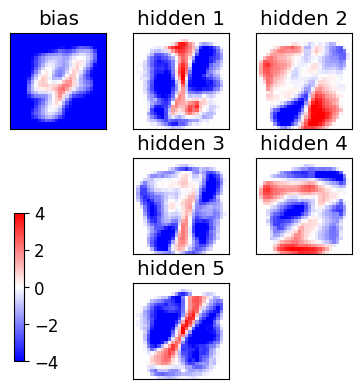

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

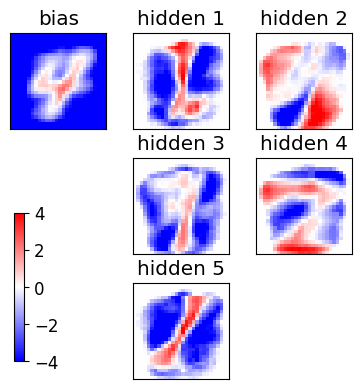

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

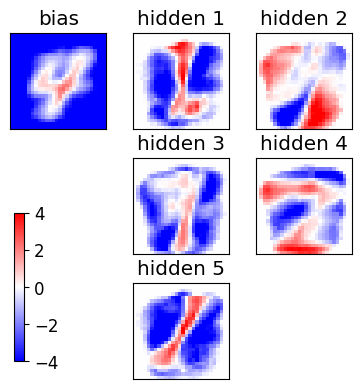

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

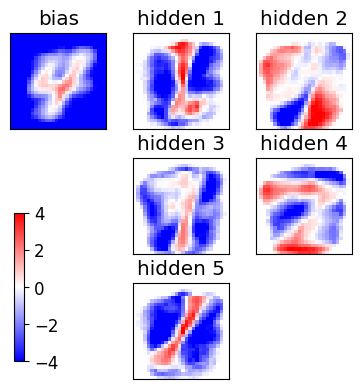

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

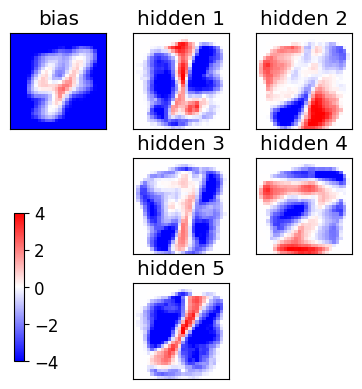

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

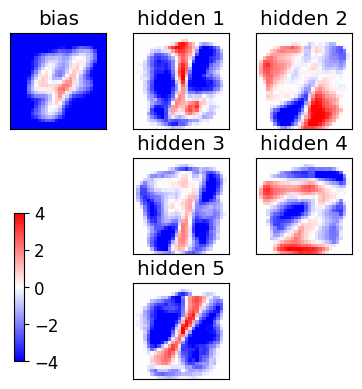

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

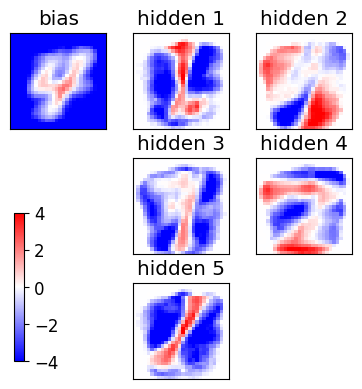

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

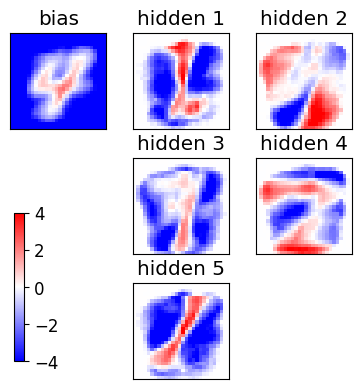

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

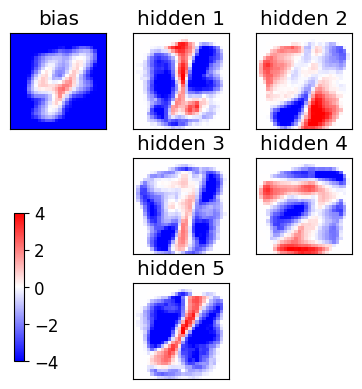

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

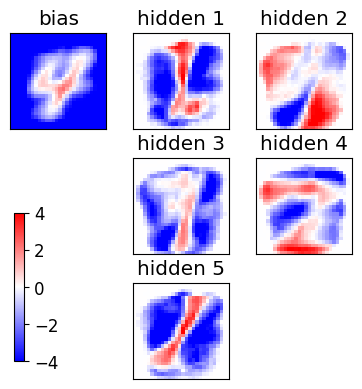

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

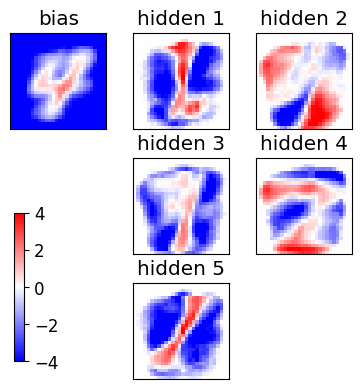

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

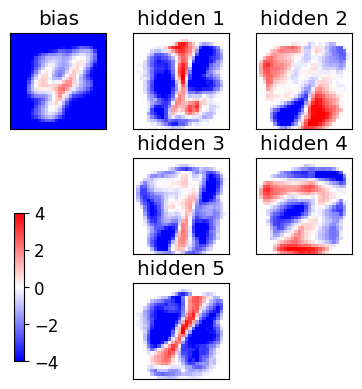

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

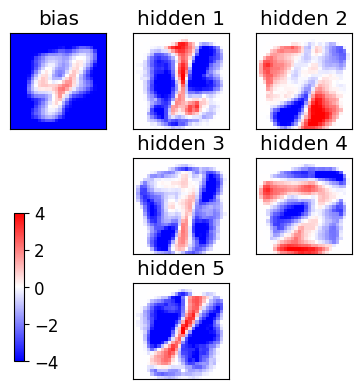

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

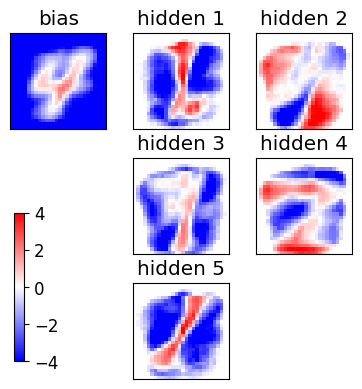

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

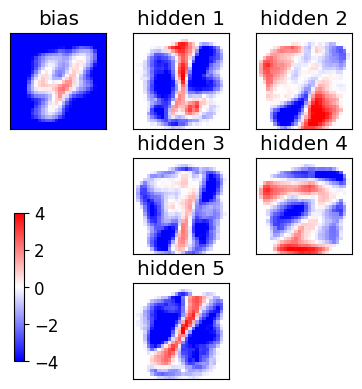

END of learning phase
Nepoch=150
Nmini=20


<Figure size 640x480 with 0 Axes>

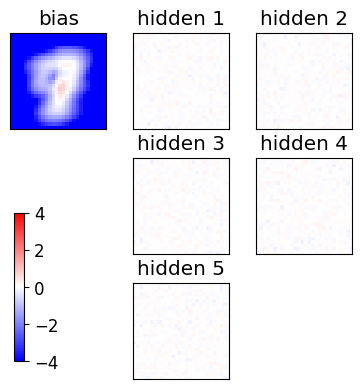

Starting the training
[10161  7791 15918 19634 21735 20477  9798  4611 20222 14461]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[19882  3864 20832  9534 10944 13062  1167  5272  4228  2228]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[ 7415  1109  6379 12680  1364  8453 15188  5952 12623 14858]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
[19237  4203 11276  9762 14483 17045   310 15518 15471  6644]
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 1 / 150  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

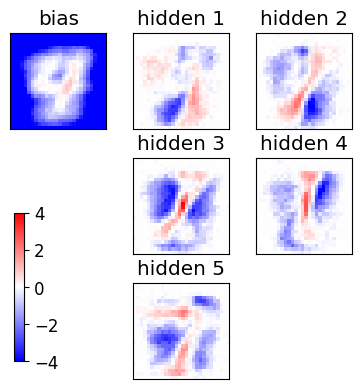

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

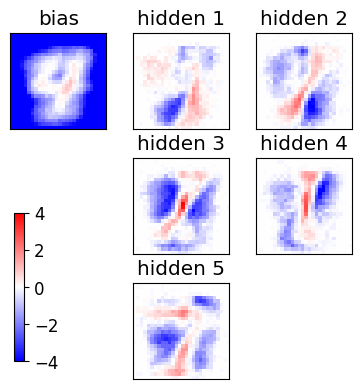

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

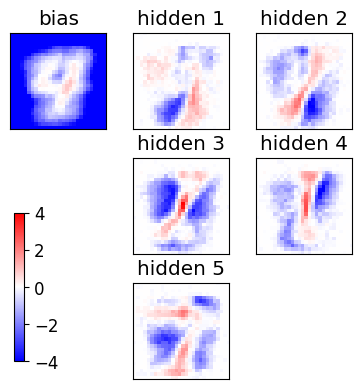

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

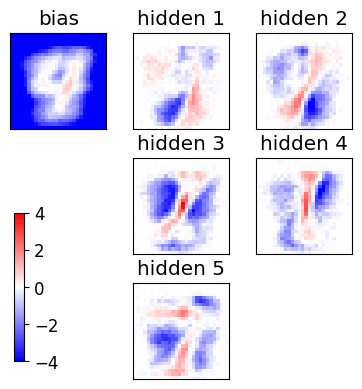

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

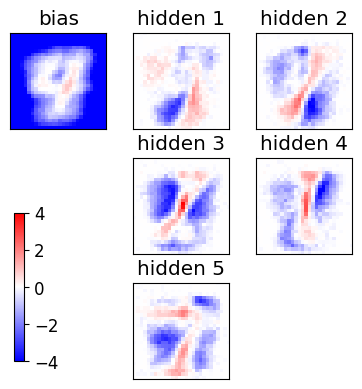

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

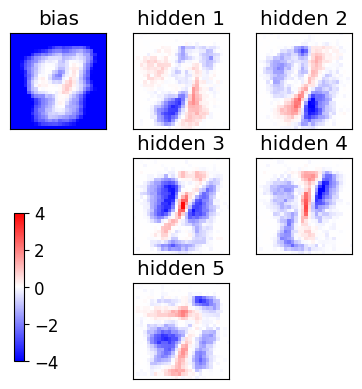

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

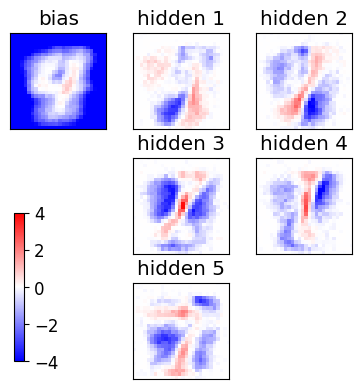

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

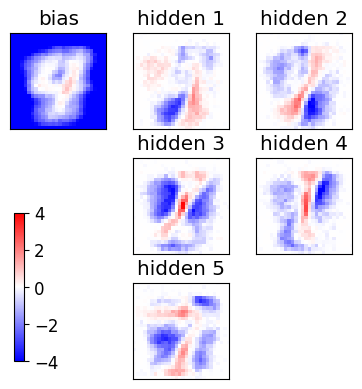

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

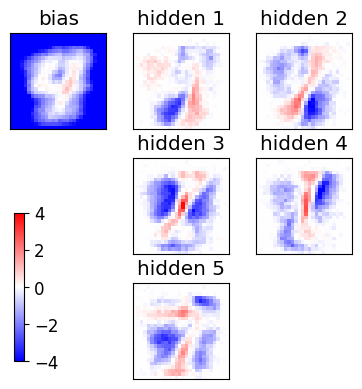

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

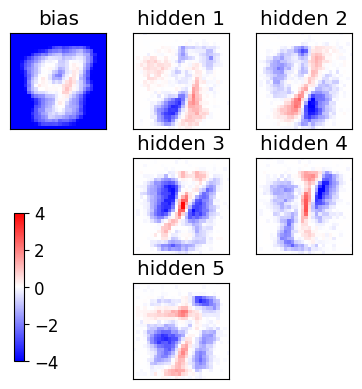

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

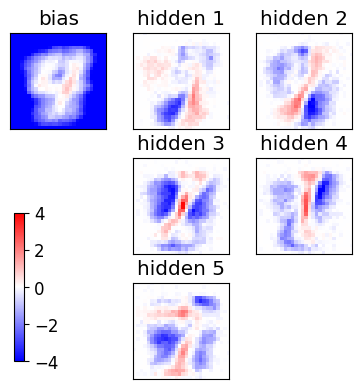

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

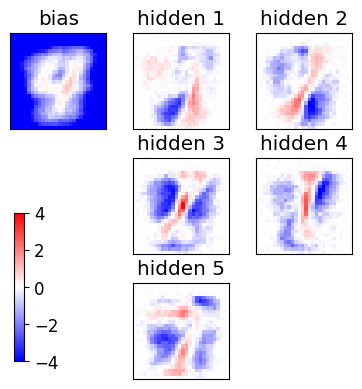

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

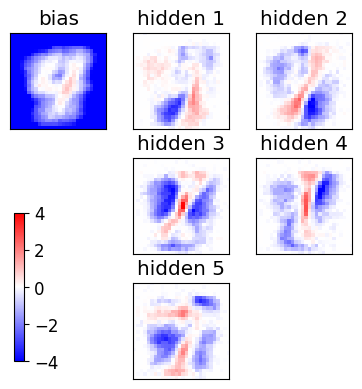

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

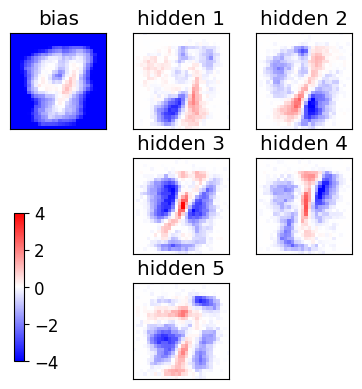

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

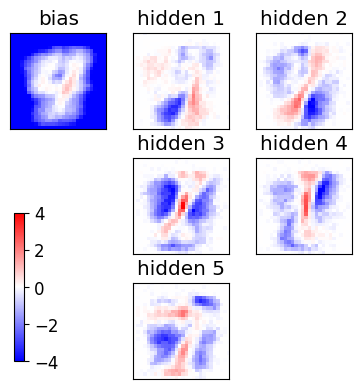

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

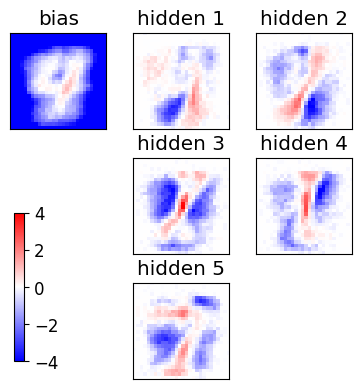

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

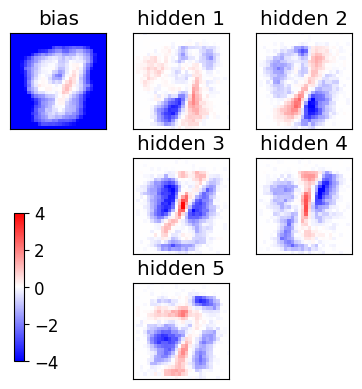

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

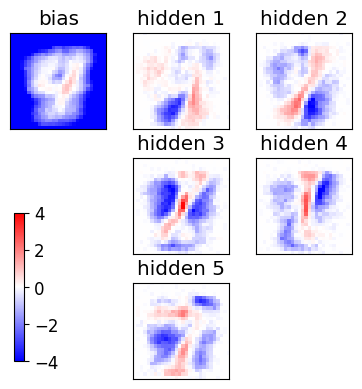

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

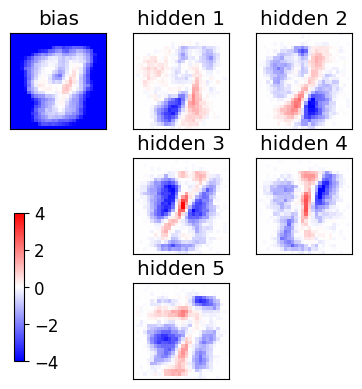

epoch 20 / 150  Nt: 4  N: 17  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

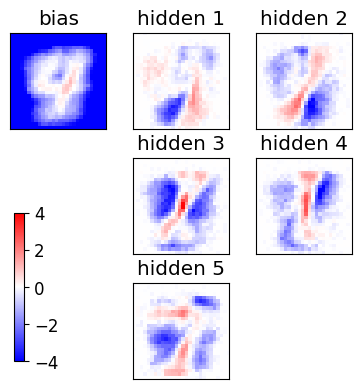

epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 21 / 150  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

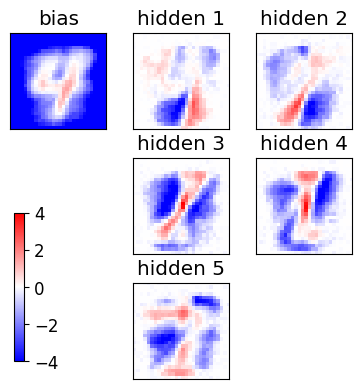

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

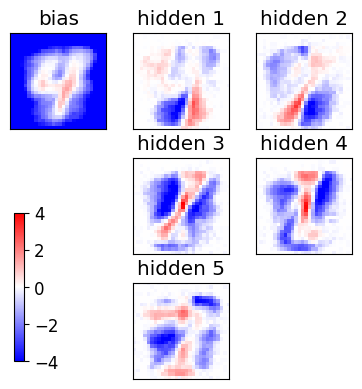

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

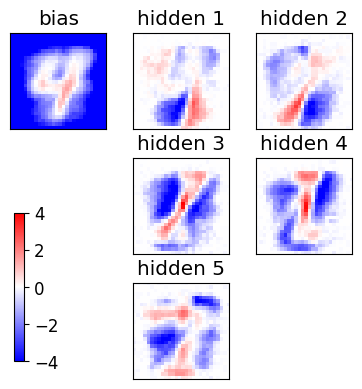

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

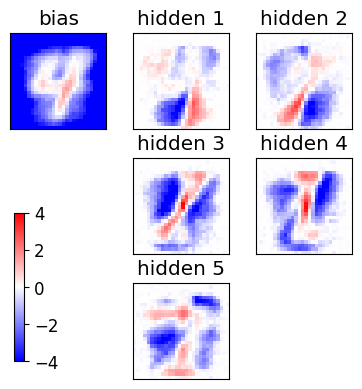

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

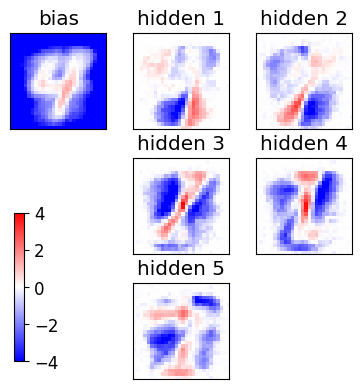

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

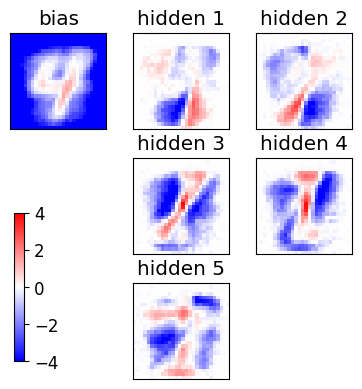

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

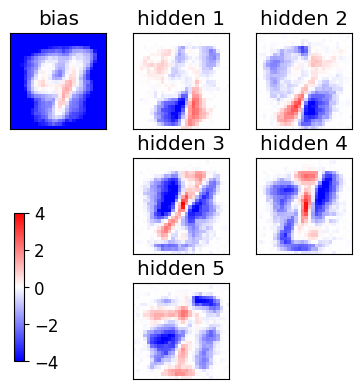

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

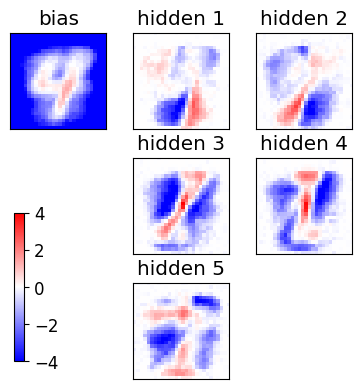

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

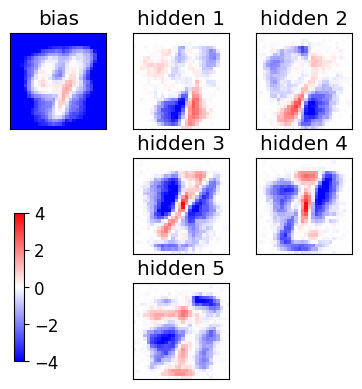

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

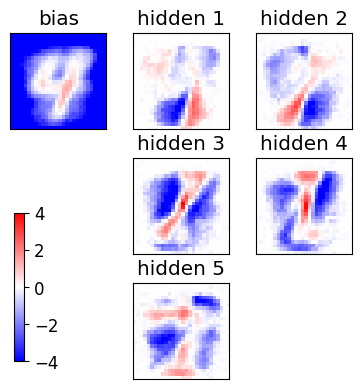

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

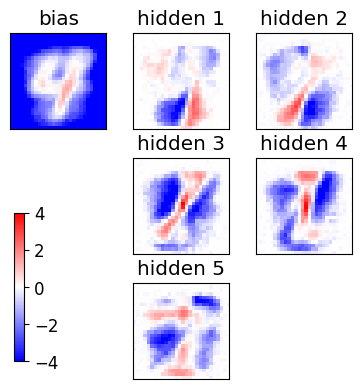

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

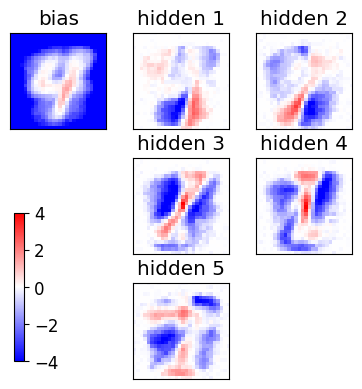

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

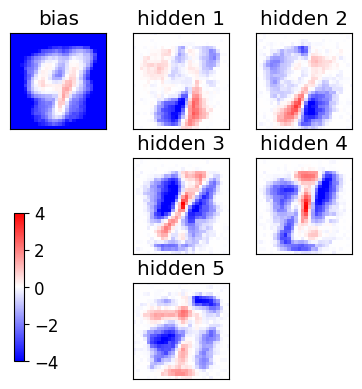

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

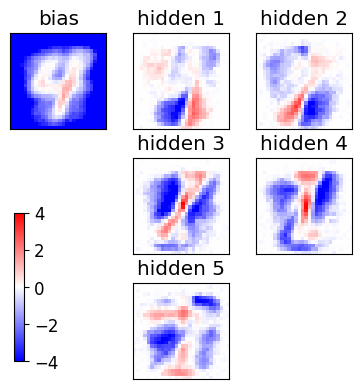

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

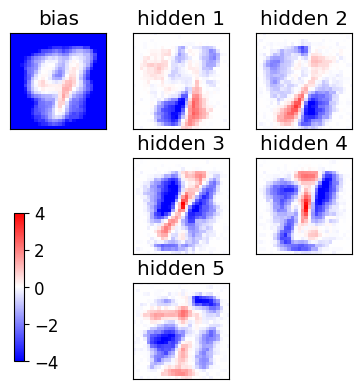

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

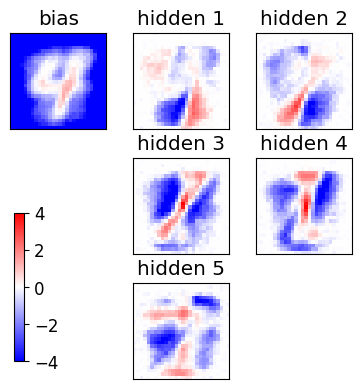

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

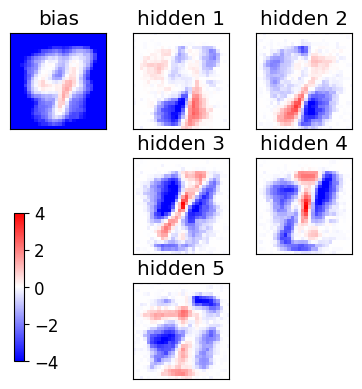

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

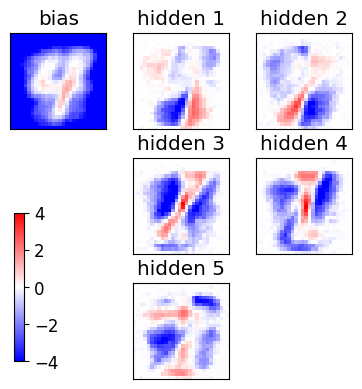

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

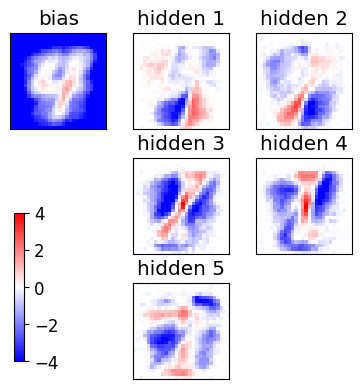

epoch 40 / 150  Nt: 4  N: 43  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

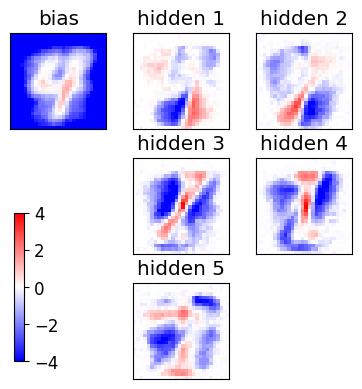

epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 41 / 150  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

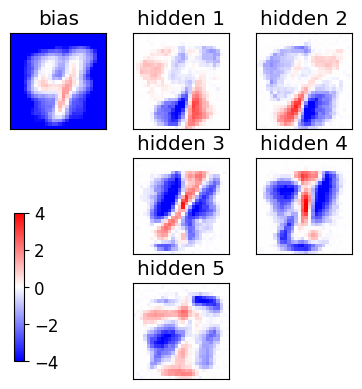

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

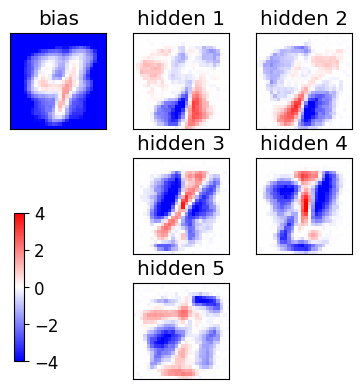

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

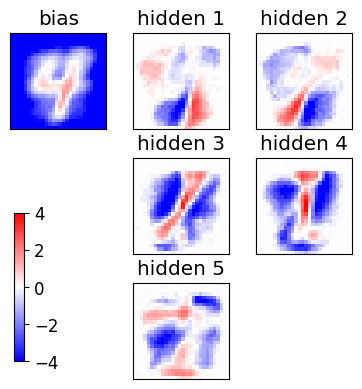

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

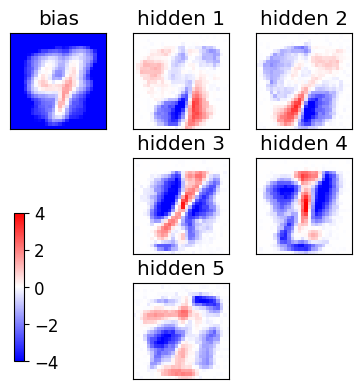

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

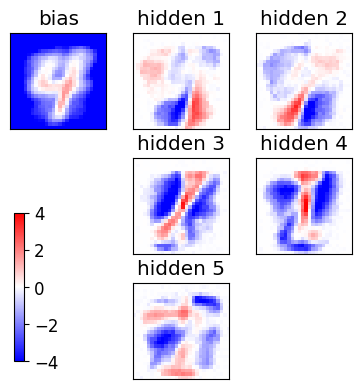

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

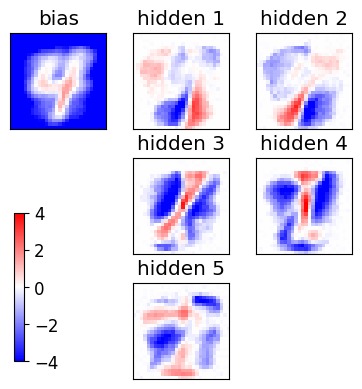

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

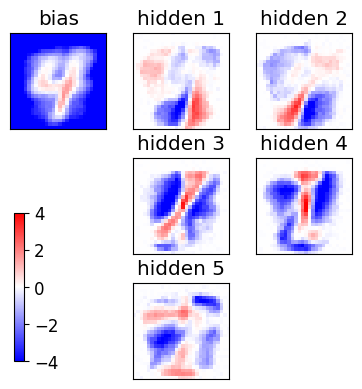

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

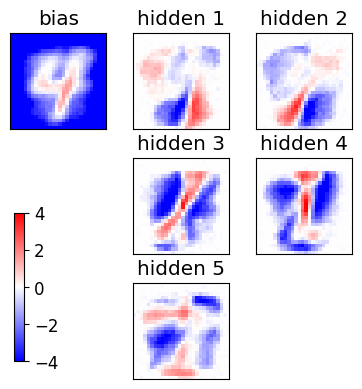

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

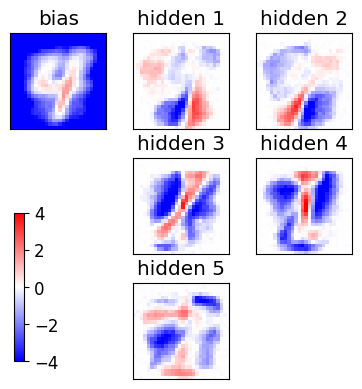

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

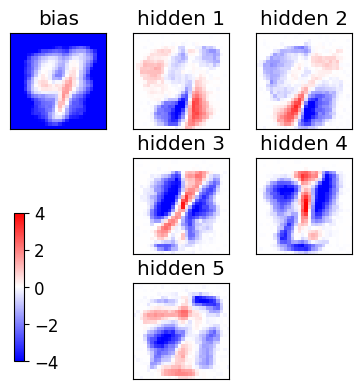

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

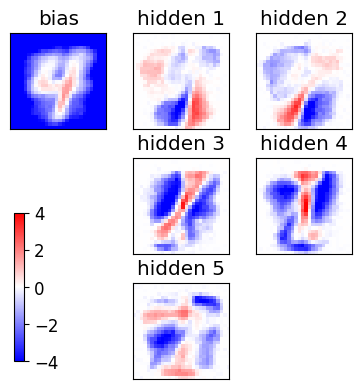

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

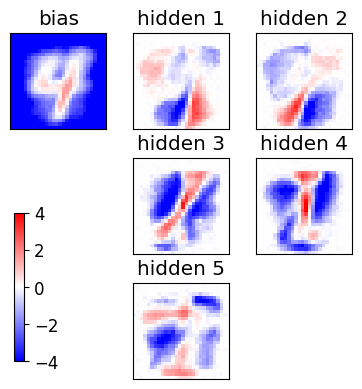

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

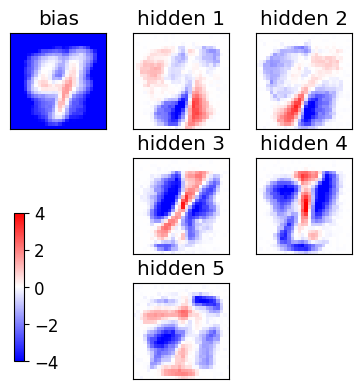

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

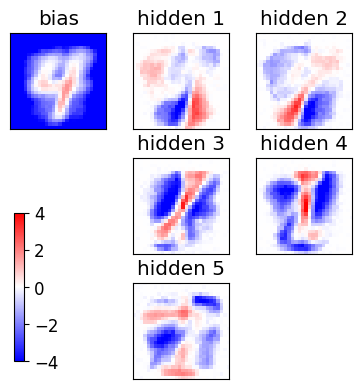

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

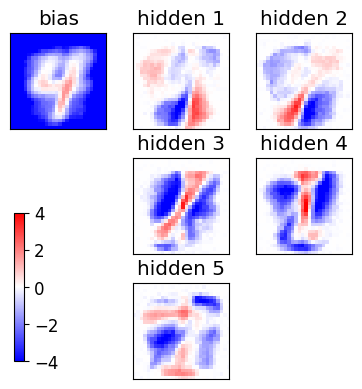

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

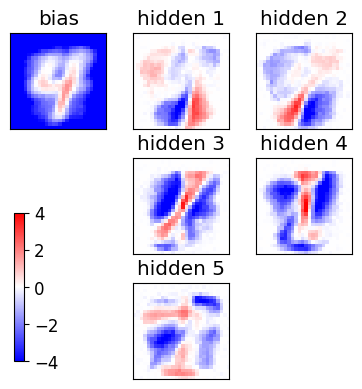

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

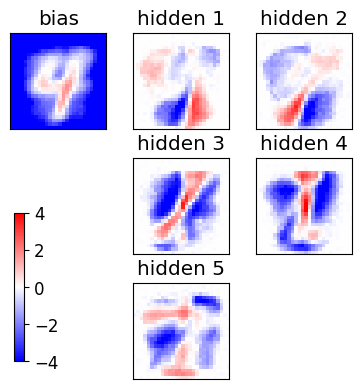

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

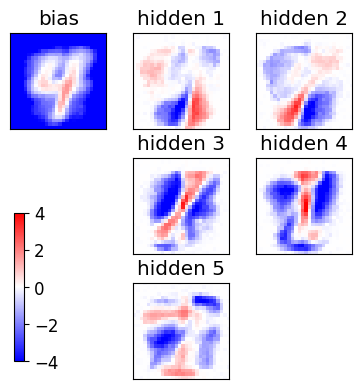

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

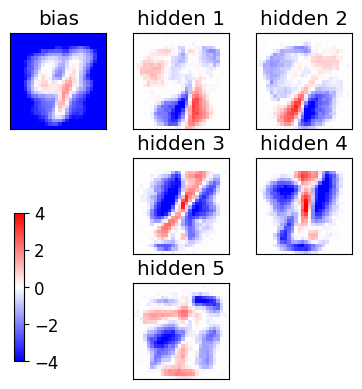

epoch 60 / 150  Nt: 4  N: 86  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

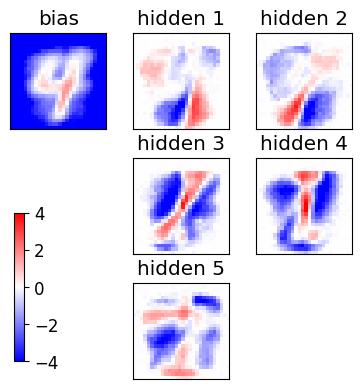

epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 61 / 150  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoc

<Figure size 640x480 with 0 Axes>

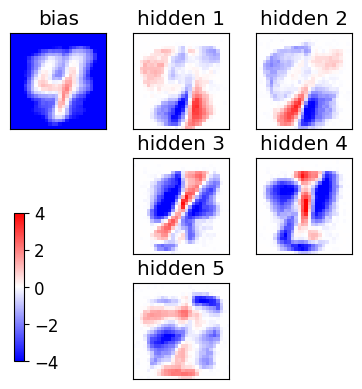

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

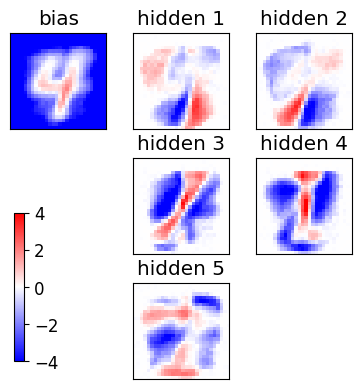

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

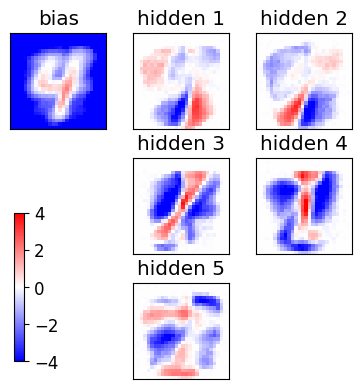

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

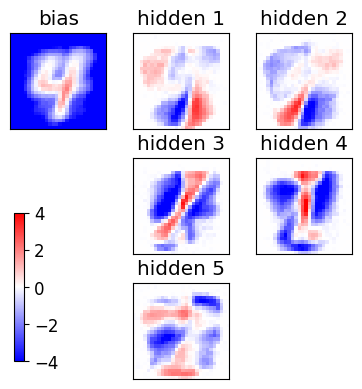

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

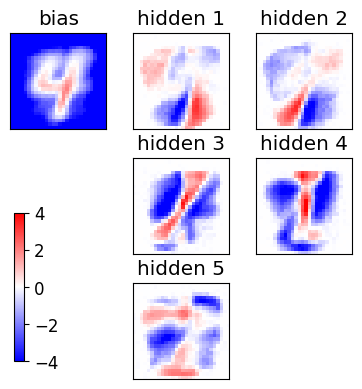

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

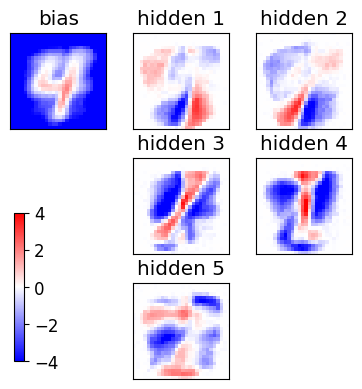

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

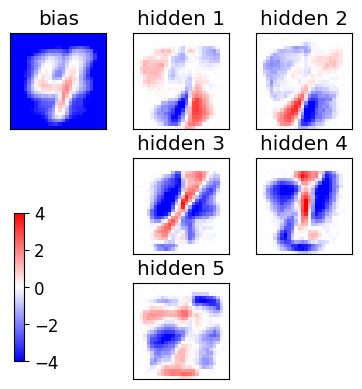

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

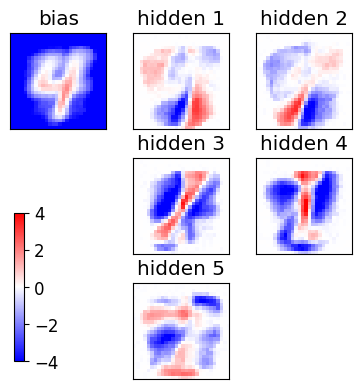

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

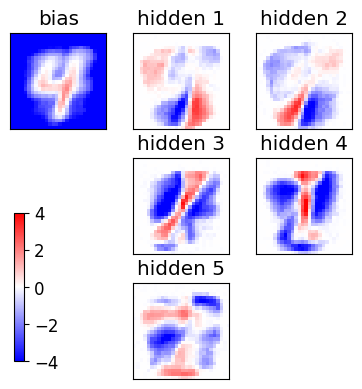

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

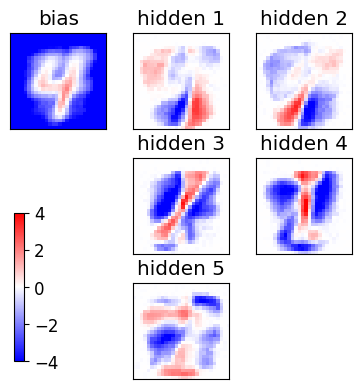

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

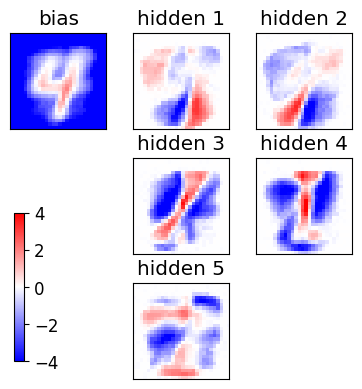

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

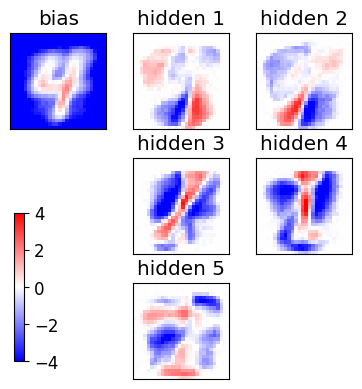

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

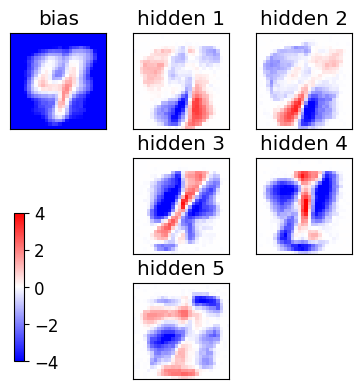

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

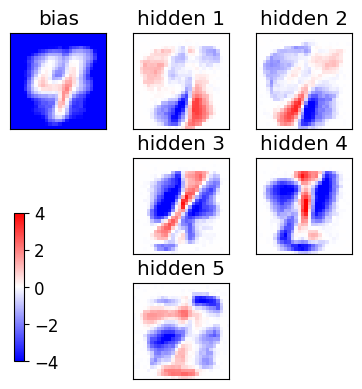

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

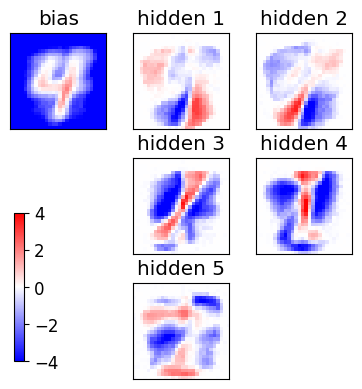

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

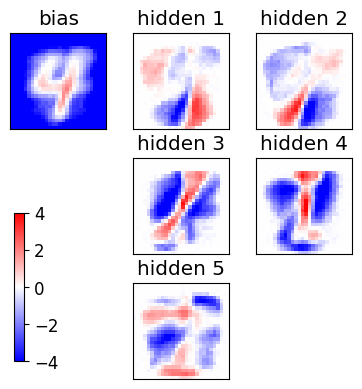

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

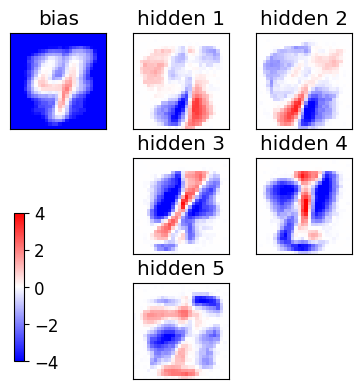

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

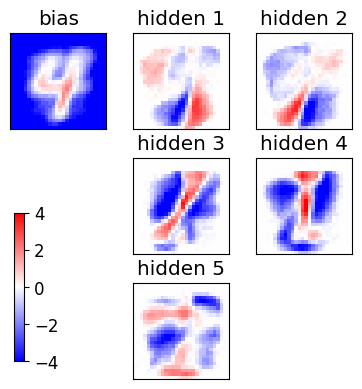

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

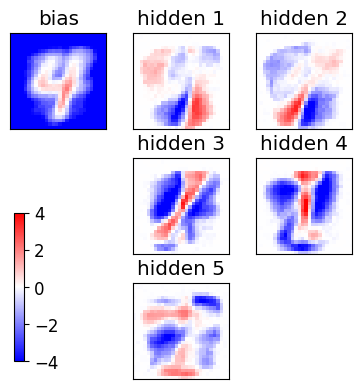

epoch 80 / 150  Nt: 4  N: 147  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

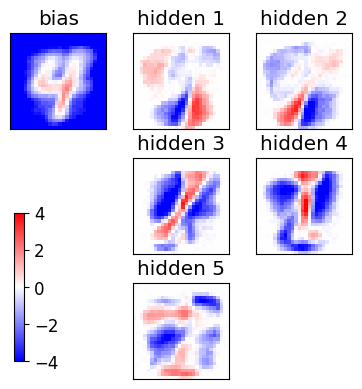

epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 81 / 150  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS

<Figure size 640x480 with 0 Axes>

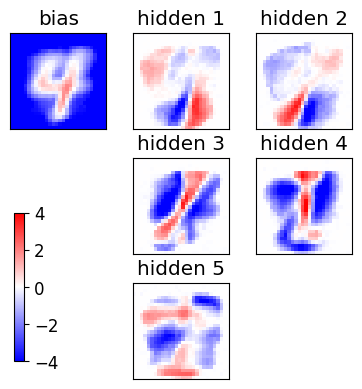

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

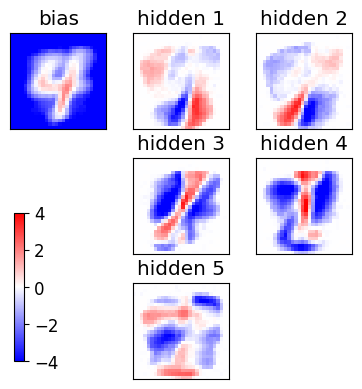

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

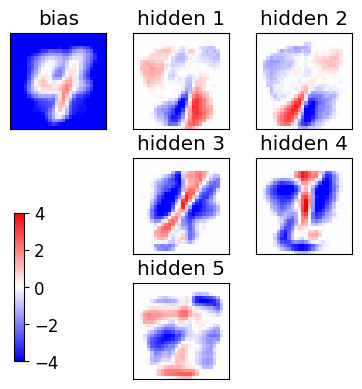

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

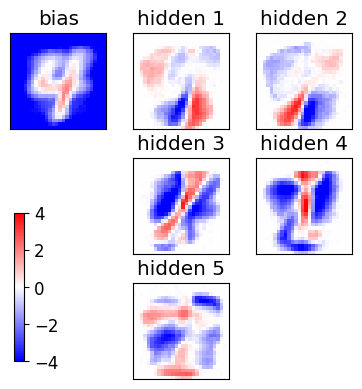

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

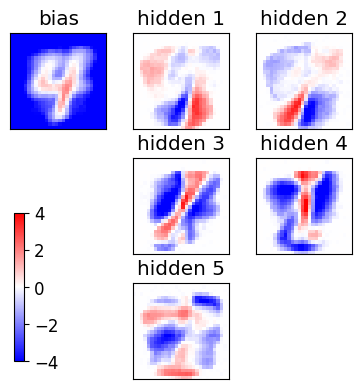

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

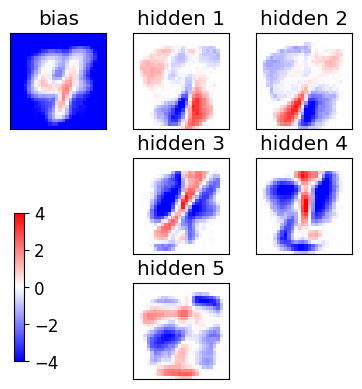

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

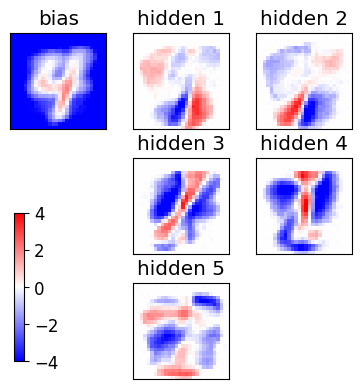

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

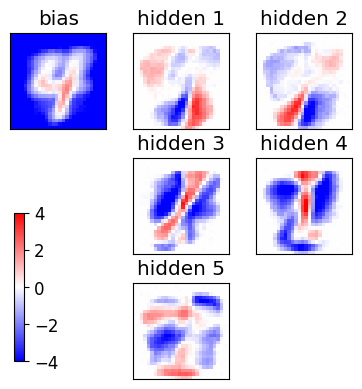

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

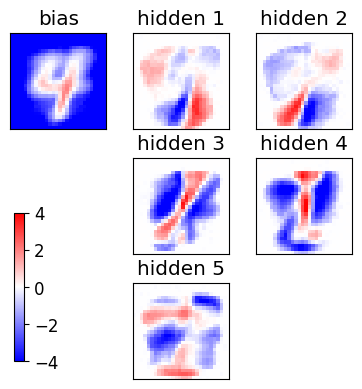

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

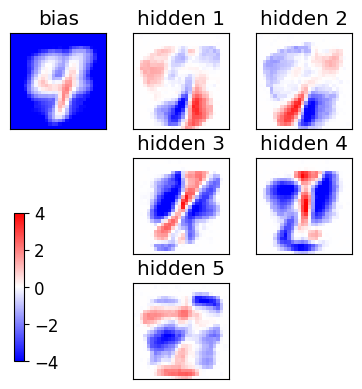

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

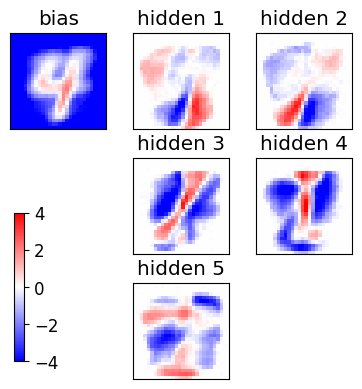

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

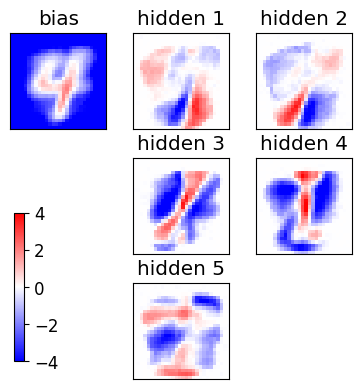

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

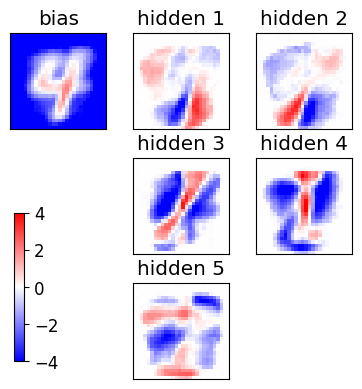

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

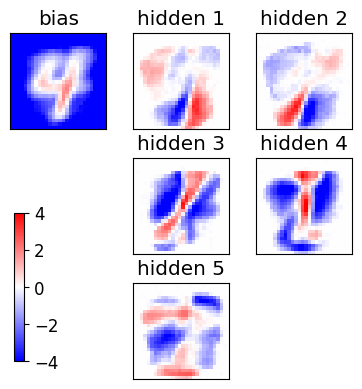

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

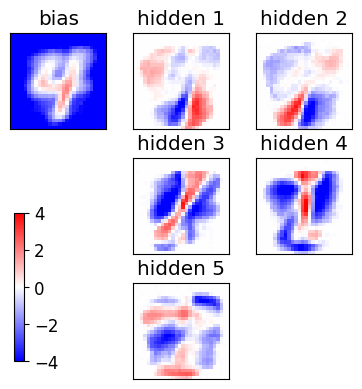

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

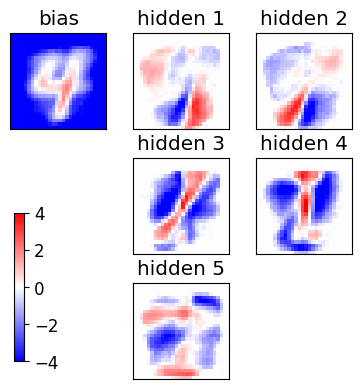

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

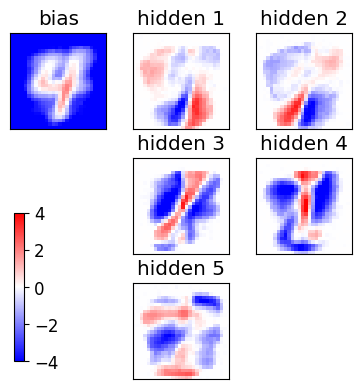

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

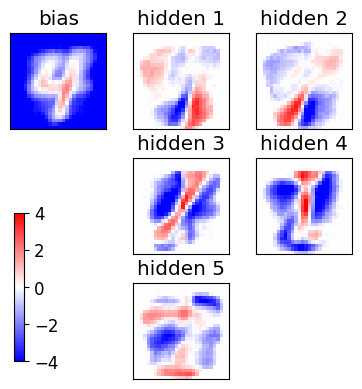

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

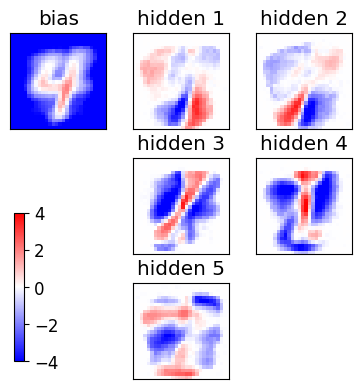

epoch 100 / 150  Nt: 4  N: 226  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

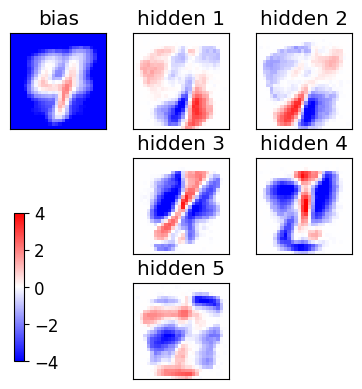

epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 101 / 150  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

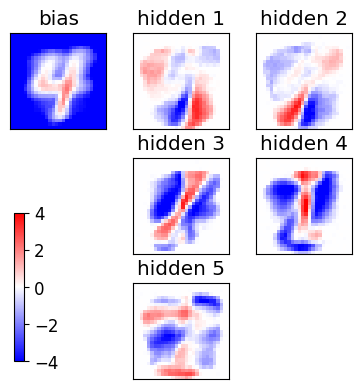

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

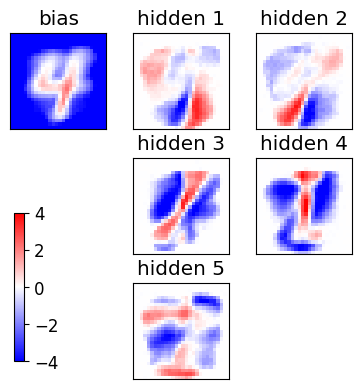

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

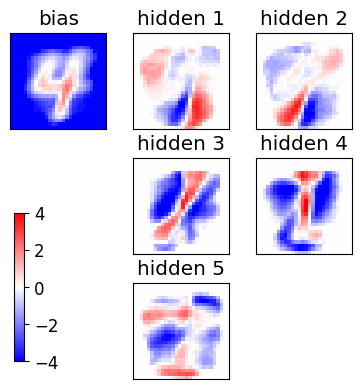

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

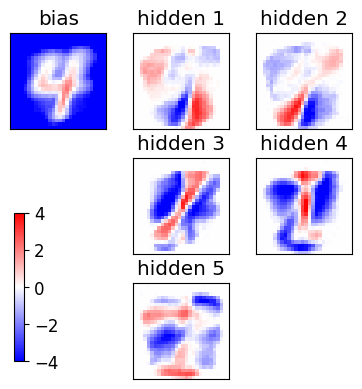

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

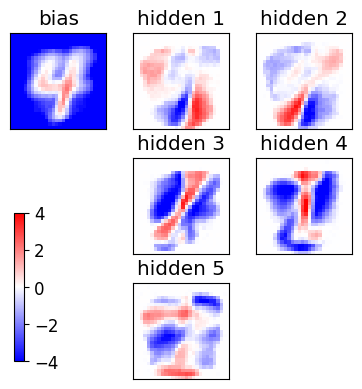

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

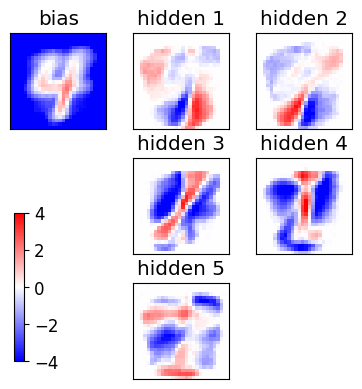

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

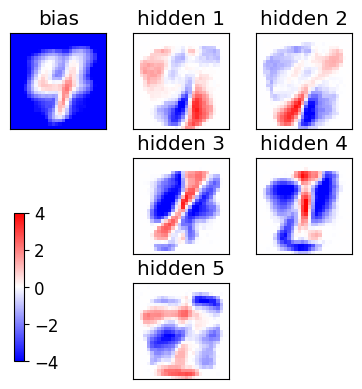

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

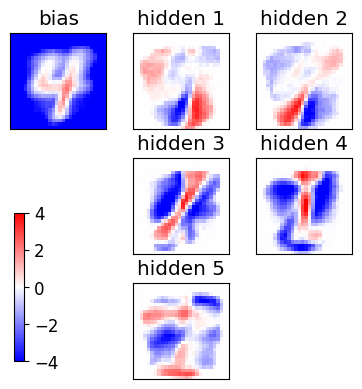

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

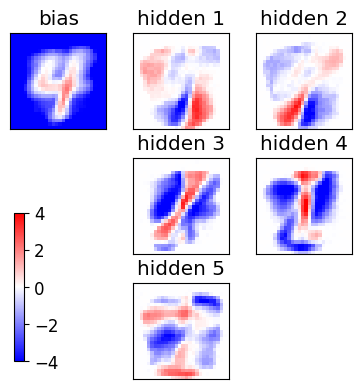

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

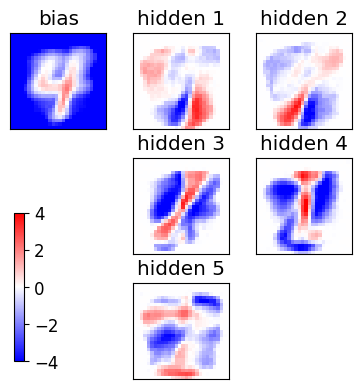

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

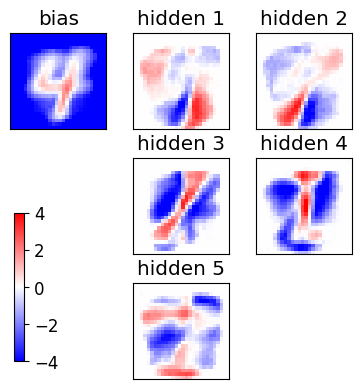

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

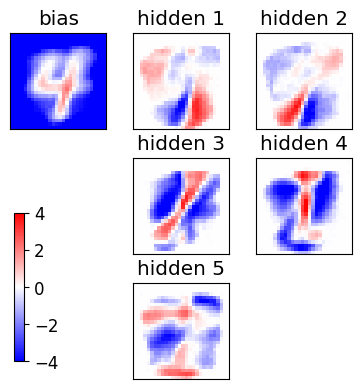

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

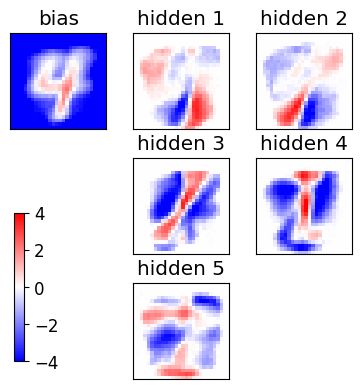

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

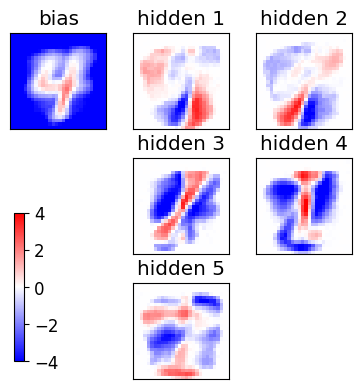

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

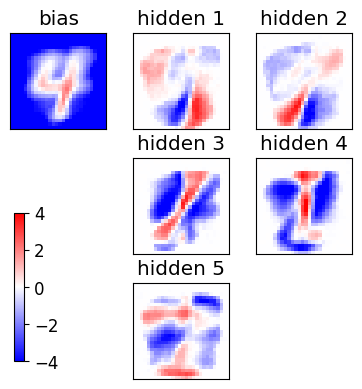

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

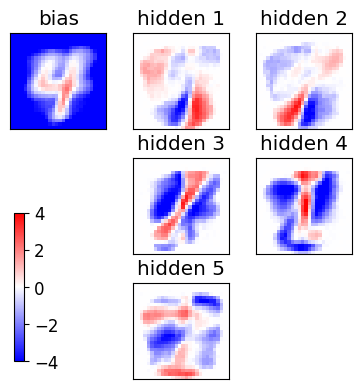

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

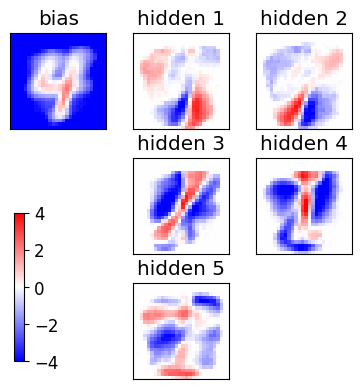

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

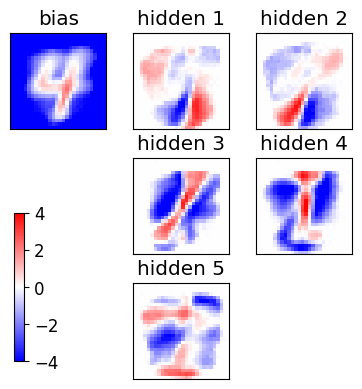

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

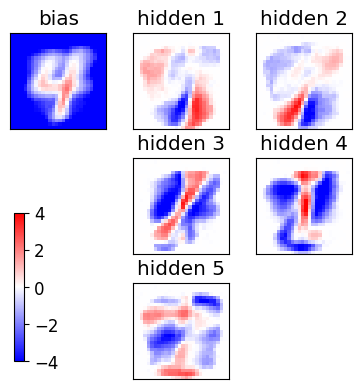

epoch 120 / 150  Nt: 4  N: 322  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

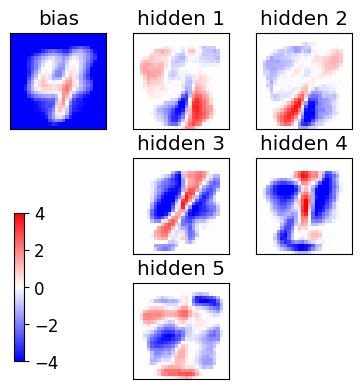

epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 121 / 150  Nt: 4  N: 327  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

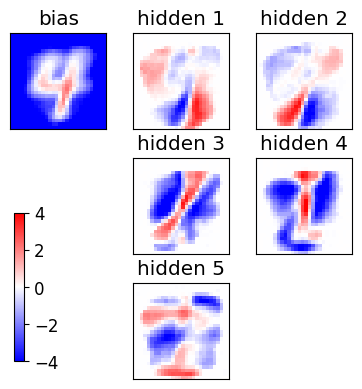

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

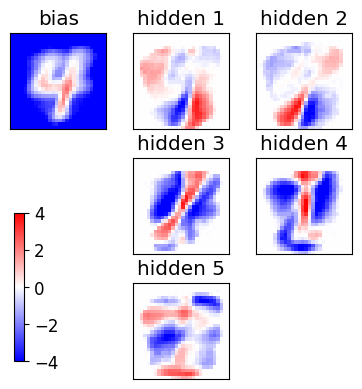

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

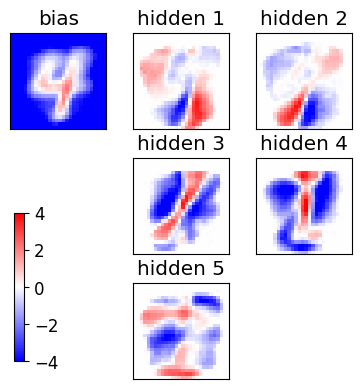

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

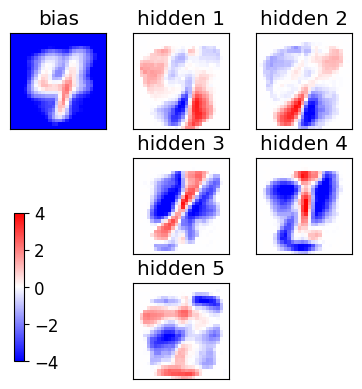

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

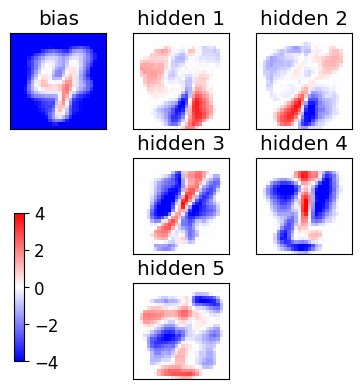

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

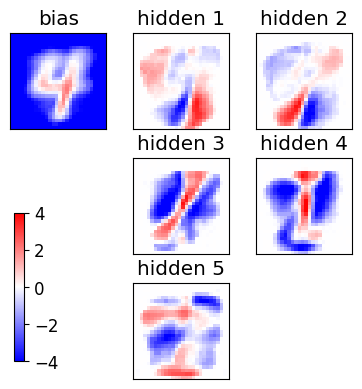

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

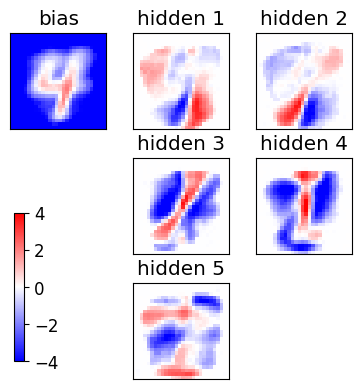

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

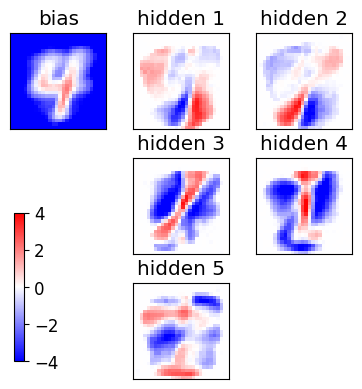

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

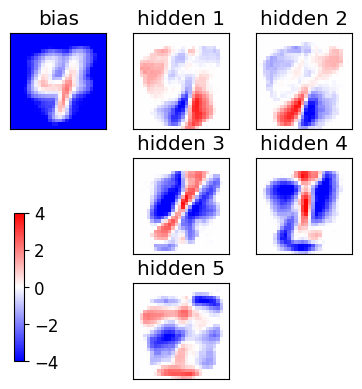

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

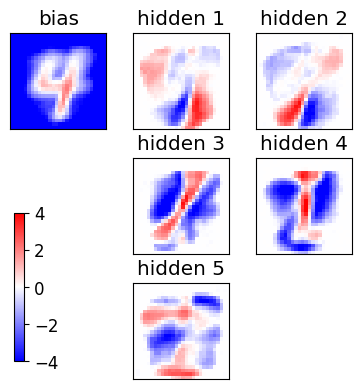

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

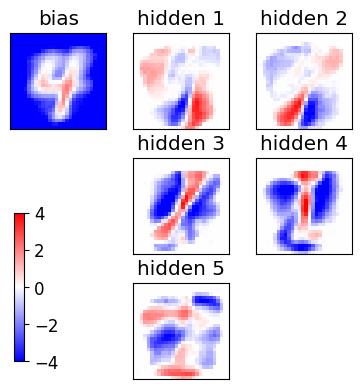

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

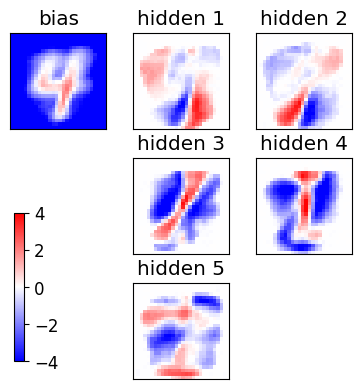

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

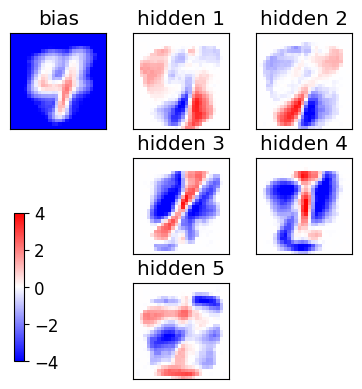

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

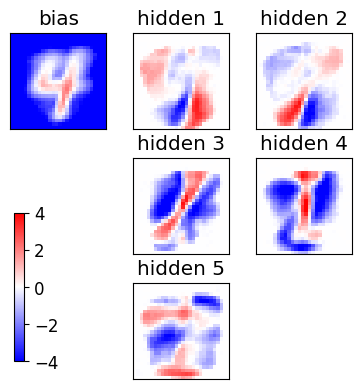

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

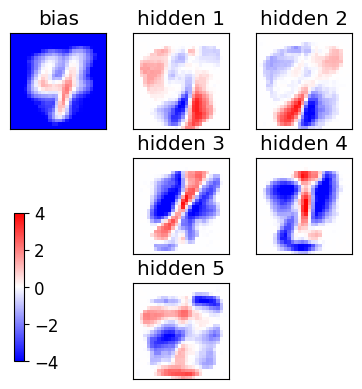

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

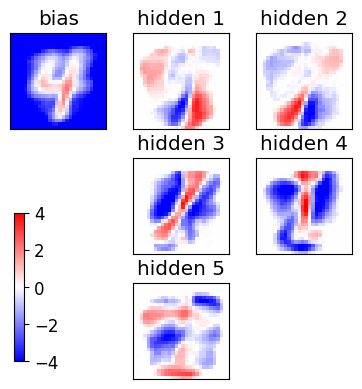

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

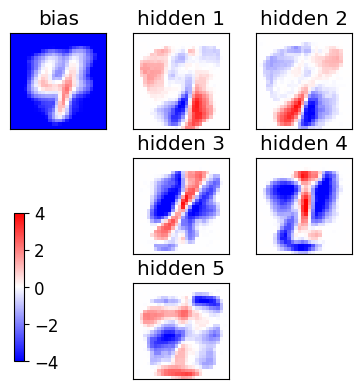

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

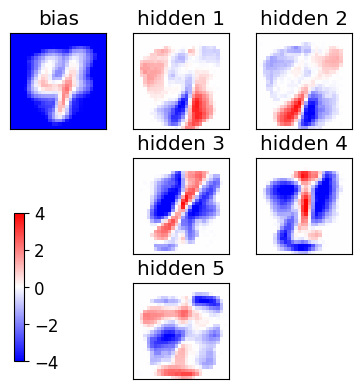

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

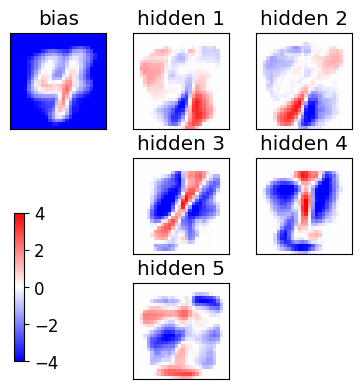

epoch 140 / 150  Nt: 4  N: 436  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

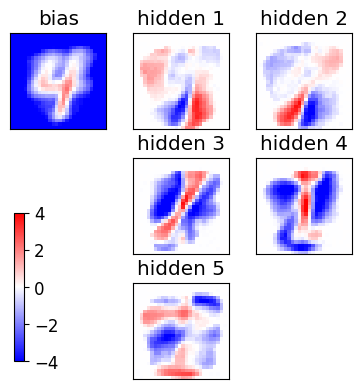

epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False
epoch 141 / 150  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.1 SPINS=

<Figure size 640x480 with 0 Axes>

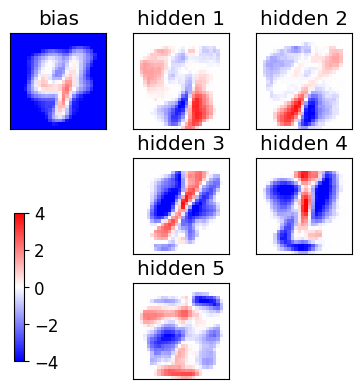

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

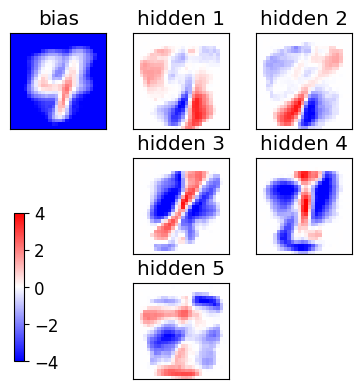

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

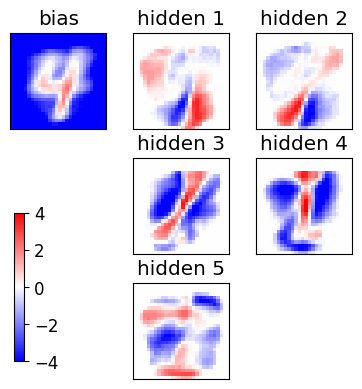

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

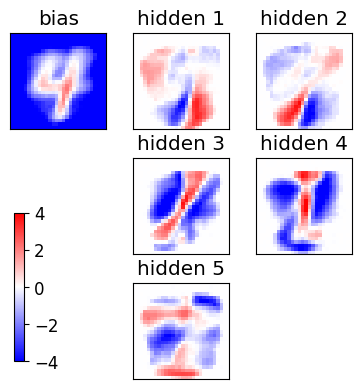

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

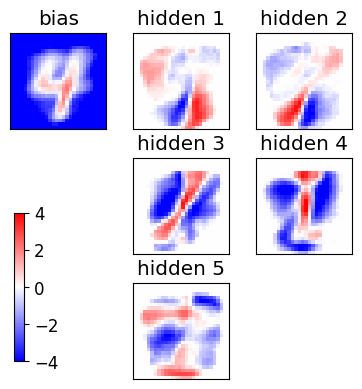

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

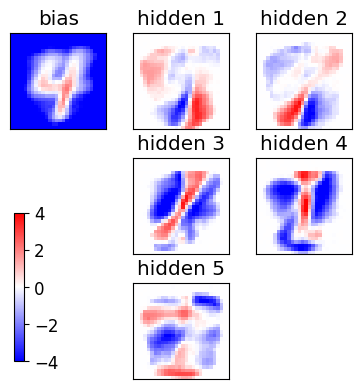

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

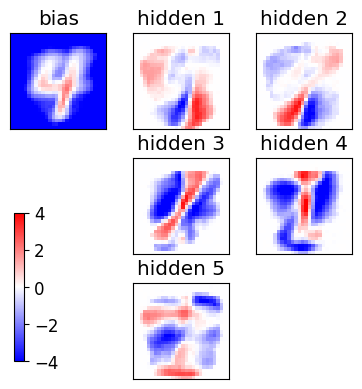

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

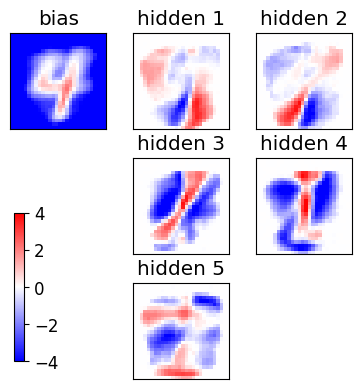

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

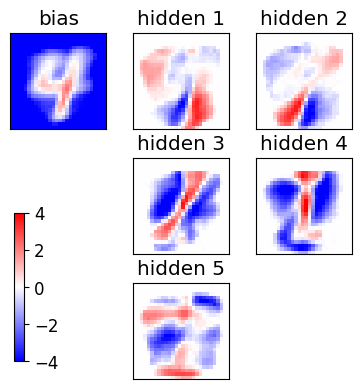

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

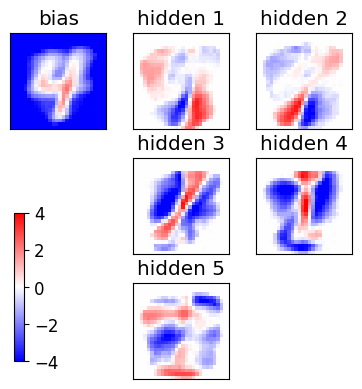

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

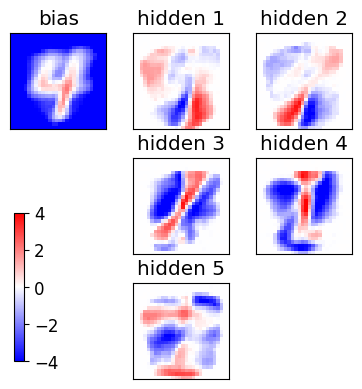

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

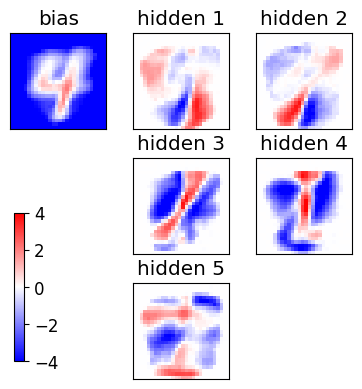

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

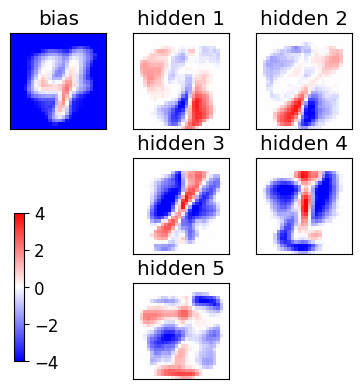

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

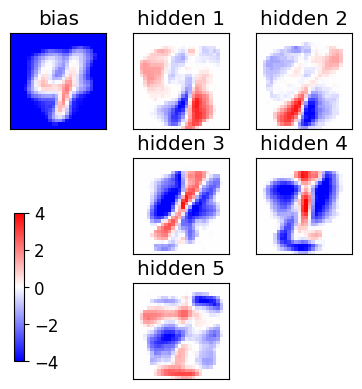

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

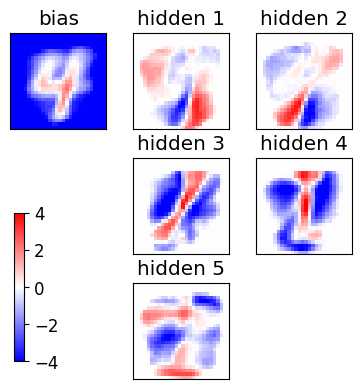

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

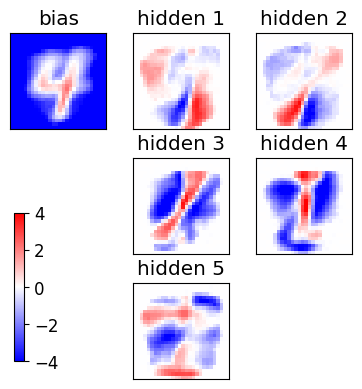

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

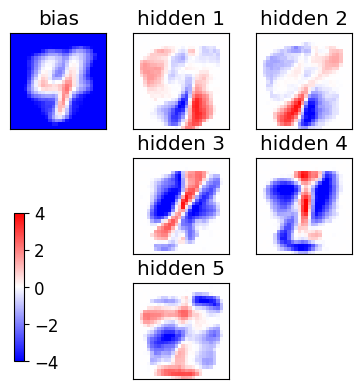

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

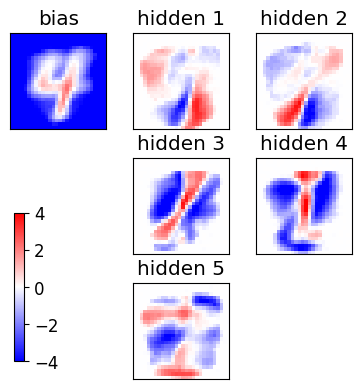

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

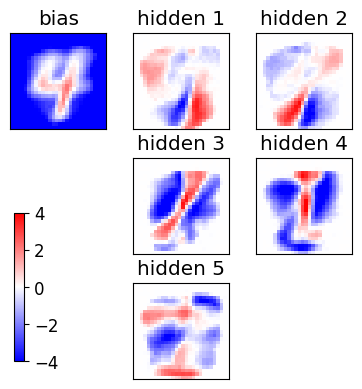

epoch 150 / 150  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.1 SPINS= False POTTS= False


<Figure size 640x480 with 0 Axes>

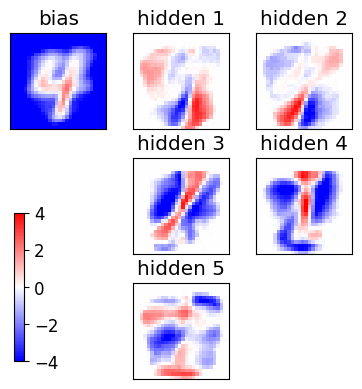

END of learning phase


In [38]:
#training for different regularization gamma, Nt

for gamma in gamma_v:
    if gamma>0:
        L = 5
        Nt = 4
        # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
        w = sigma * np.random.randn(D, L)
        #a = sigma * np.random.randn(D)
        # using Hinton initialization of visible biases
        a = Hinton_bias_init(data)
        # hidden biases initialized to zero
        b = np.zeros(L)
        #print("w=",w);print("a=",a);print("b=",b)

        # nr of epochs
        Nepoch = 150
        # minibatches per epoch
        Nmini = 20
        # minibatch size at initial epoch and final one
        N_ini, N_fin = 10, 500
        print(f"Nepoch={Nepoch}\nNmini={Nmini}")

        # recording history of weights ("E" means epoch)
        wE, aE, bE = np.zeros((Nepoch + 1, D, L)), np.zeros((Nepoch + 1, D)), np.zeros((Nepoch + 1, L))
        wE[0], aE[0], bE[0] = np.copy(w), np.copy(a), np.copy(b)
        gwE, gw2E, gwE_d, gwE_m = np.zeros_like(wE), np.zeros_like(wE), np.zeros_like(wE), np.zeros_like(wE)
        gaE, ga2E, gaE_d, gaE_m = np.zeros_like(aE), np.zeros_like(aE), np.zeros_like(aE), np.zeros_like(aE)
        gbE, gb2E, gbE_d, gbE_m = np.zeros_like(bE), np.zeros_like(bE), np.zeros_like(bE), np.zeros_like(bE)
        miniE = np.zeros(Nepoch + 1)
        pzE = np.zeros((Nepoch + 1, Nz))
        if GRAD == "RMSprop":
            gw2, ga2, gb2 = np.zeros_like(w), np.zeros_like(a), np.zeros_like(b)

        indices = np.arange(Nd).astype("int")
        plot_weights_bias(wE, aE, 0, L, cols=L // 2, save=False)

        # for the plot with panels
        Ncols = min(8, max(2, L // 2))

        if POTTS:
            print("Starting the training, POTTS=True")
        else:
            print("Starting the training")

        # Note: here an epoch does not analyze the whole dataset
        for epoch in range(1, 1 + Nepoch):
            # q maps epochs to interval [0,1]
            q = (epoch - 1.) / (Nepoch - 1.)
            # N, size of the mini batch
            # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
            N = int(N_ini + (N_fin - N_ini) * (q ** 2))
            # l_rate interpolates between initial and final value
            l_rate = l_rate_ini + (l_rate_fin - l_rate_ini) * q

            for mini in range(Nmini):
                # initializitation for averages in minibatch
                # visible variables "v" --> "x"
                # hidden variables "h" --> "z"
                x_data, x_model = np.zeros(D), np.zeros(D)
                z_data, z_model = np.zeros(L), np.zeros(L)
                xz_data, xz_model = np.zeros((D, L)), np.zeros((D, L))
                pz = np.zeros(L)

                # Minibatch of size N: points randomly picked (without repetition) from data
                selected = np.random.choice(indices, N, replace=False)
                if epoch == 1 and mini <= 3:
                    print(selected)

                for k in range(N):
                    ###################################
                    x0 = data[selected[k]]
                    # positive CD phase: generating z from x[k]
                    z = CD_step(x0, w, b, POTTS=POTTS)
                    x_data += x0
                    z_data += z
                    xz_data += np.outer(x0, z)
                    # fantasy
                    zf = np.copy(z)
                    # Contrastive divergence with Nt steps
                    for t in range(Nt):
                        # negative CD phase: generating fantasy xf from fantasy zf
                        xf = CD_step(zf, w.T, a)
                        # positive CD phase: generating fantasy zf from fantasy xf
                        zf = CD_step(xf, w, b, POTTS=POTTS)
                    x_model += xf
                    z_model += zf
                    xz_model += np.outer(xf, zf)
                    # recording probability of encoding in z-space, if POTTS
                    if POTTS:
                        pz[zf] += 1
                    ###################################

                # gradient of the likelihood: follow it along its positive direction
                gw_d, gw_m = xz_data / N, xz_model / N
                ga_d, ga_m = x_data / N, x_model / N
                gb_d, gb_m = z_data / N, z_model / N
                gw = np.copy(gw_d - gw_m)
                ga = np.copy(ga_d - ga_m)
                gb = np.copy(gb_d - gb_m)

                # gradient ascent step
                if GRAD == "RMSprop":
                    # RMSprop gradient ascent
                    gw2 = beta * gw2 + (1 - beta) * np.square(gw)
                    ga2 = beta * ga2 + (1 - beta) * np.square(ga)
                    gb2 = beta * gb2 + (1 - beta) * np.square(gb)
                    w += l_rate * gw / sqrt(epsilon + gw2)
                    a += l_rate * ga / sqrt(epsilon + ga2)
                    b += l_rate * gb / sqrt(epsilon + gb2)
                else:
                    # defaulting to the vanilla stochastic gradient ascent (SGD)
                    w += l_rate * gw
                    a += l_rate * ga
                    b += l_rate * gb
                # regularization (LASSO)
                if gamma > 0.:
                    w -= (gamma * l_rate) * sign(w)
                    a -= (gamma * l_rate) * sign(a)
                    b -= (gamma * l_rate) * sign(b)

                wE[epoch], gwE[epoch], gwE_d[epoch], gwE_m[epoch] = np.copy(w), np.copy(gw), np.copy(gw_d), np.copy(gw_m)
                aE[epoch], gaE[epoch], gaE_d[epoch], gaE_m[epoch] = np.copy(a), np.copy(ga), np.copy(ga_d), np.copy(ga_m)
                bE[epoch], gbE[epoch], gbE_d[epoch], gbE_m[epoch] = np.copy(b), np.copy(gb), np.copy(gb_d), np.copy(gb_m)
                miniE[epoch] = N
                if POTTS:
                    pzE[epoch] = pz / np.sum(pz)
                print("epoch", epoch, "/", Nepoch, " Nt:", Nt, " N:", N, " L:", L,
                    " rate:", l_rate, " gam:", gamma, "SPINS=", SPINS, "POTTS=", POTTS)

                if Nepoch <= 100 or epoch % 20 == 0 or epoch == Nepoch:
                    plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)

                str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
                save_epochs(wE, "w")
                save_epochs(bE, "b")
                save_epochs(aE, "a")

        print("END of learning phase")

In [45]:
log_like_gamma=[]
log_like_gamma_std=[]
Nepoch=150
num_epo=np.arange(Nepoch-5,Nepoch,1) # consider trend over the last 5 iterations

for gamma in gamma_v:
  if gamma>0.:
    L=5
    Nt=4
    a_all = np.load(f"WEIGHTS/a_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'a_all gamma={gamma}, L={L}, Nt={Nt}')
    b_all= np.load(f"WEIGHTS/b_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'b_all gamma={gamma}, L={L}, Nt={Nt}')
    w_all=np.load(f"WEIGHTS/w_RBM_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep150_reg{gamma}.npy", allow_pickle=True)
    print(f'w_all gamma={gamma}, L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like_g=[]
    log_like_g_std=[]
    Nepoch=150
    for i in range(Nepoch-5,Nepoch,1):
        print(f'Epoch n.{i}')
        ll_iter=[]
        mean=[]
        for iter in range(5): # to determine the loglike at each epoch we run the calculation 5 times and compute the average, to reduce randomness
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            ll_iter.append(ll)
        ll_mean= np.array(ll_iter).mean()
        ll_std= np.array(ll_iter).std()
        log_like_g.append(ll_mean)
        log_like_g_std.append(ll_std)
        print('Log-likelihood=',ll_mean,"+-",ll_std)
    log_like_gamma.append(log_like_g)
    log_like_gamma_std.append(log_like_g_std)


a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:20<00:00, 274.30it/s]


Log-likelihood= -127.24936264327123 +- 0.09868374070078725
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 289.84it/s]


Log-likelihood= -125.48560986222321 +- 0.39617839366682694
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 285.79it/s]


Log-likelihood= -125.56843316209658 +- 0.6485767332868067
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 274.95it/s]


Log-likelihood= -126.39556656076766 +- 0.33898509978117325
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 275.02it/s]


Log-likelihood= -123.94252645370557 +- 0.2938311468828203
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.13it/s]


Log-likelihood= -126.72476994924375 +- 0.3505401132270048
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 286.81it/s]


Log-likelihood= -124.40563102266633 +- 0.5328862241434911
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 279.15it/s]


Log-likelihood= -123.72866452859 +- 0.2972349430252236
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.05it/s]


Log-likelihood= -125.87915395843947 +- 0.653735542159499
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.78it/s]


Log-likelihood= -125.22376629258126 +- 0.44020738848745683
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.66it/s]


Log-likelihood= -124.01324762304156 +- 0.6988188686443131
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.09it/s]


Log-likelihood= -122.89829156322526 +- 0.39900742915502585
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 290.81it/s]


Log-likelihood= -123.82261531115947 +- 0.5694427577354926
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 278.20it/s]


Log-likelihood= -124.02969839974651 +- 0.7031704100238827
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 277.88it/s]


Log-likelihood= -123.67887959517209 +- 0.3788611044094232
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.145


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 279.04it/s]


Log-likelihood= -127.33794499632832 +- 0.43345310910550594
Epoch n.146


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 280.92it/s]


Log-likelihood= -127.02620649819498 +- 0.44587762480186455
Epoch n.147


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.57it/s]


Log-likelihood= -126.82888105086695 +- 0.11149532781481647
Epoch n.148


Computing log-likelihood: 100%|██████████| 5498/5498 [00:18<00:00, 291.78it/s]


Log-likelihood= -129.48453970010192 +- 0.4457653442159149
Epoch n.149


Computing log-likelihood: 100%|██████████| 5498/5498 [00:19<00:00, 281.74it/s]

Log-likelihood= -127.12897024309113 +- 0.4447652683135306


In [19]:

log_like_gamma = [
    [-127.24936264327123, -125.48560986222321, -125.56843316209658, -126.39556656076766, -123.94252645370557],  # Case 1
    [-126.72476994924375, -124.40563102266633, -123.72866452859, -125.87915395843947, -125.22376629258126],  # Case 2
    [-124.01324762304156, -122.89829156322526, -123.82261531115947, -124.02969839974651, -123.67887959517209],  # Case 3
    [-127.33794499632832, -127.02620649819498, -126.82888105086695, -129.48453970010192, -127.12897024309113],  # Case 4
    [-138.47331831474386, -138.1203701712743, -137.71334920388665, -138.20494530508435, -138.7838087707658]  # Case 5 (aggiunto)
]

log_like_gamma_std = [
    [0.09868374070078725, 0.39617839366682694, 0.6485767332868067, 0.33898509978117325, 0.2938311468828203],  # Case 1
    [0.3505401132270048, 0.5328862241434911, 0.2972349430252236, 0.653735542159499, 0.44020738848745683],  # Case 2
    [0.6988188686443131, 0.39900742915502585, 0.5694427577354926, 0.7031704100238827, 0.3788611044094232],  # Case 3
    [0.43345310910550594, 0.44587762480186455, 0.11149532781481647, 0.4457653442159149, 0.4447652683135306],  # Case 4
    [0.4011070862112876, 0.561959628581091, 0.5458788509620577, 0.676651791500994, 0.549637774447985]  # Case 5 (aggiunto)
]

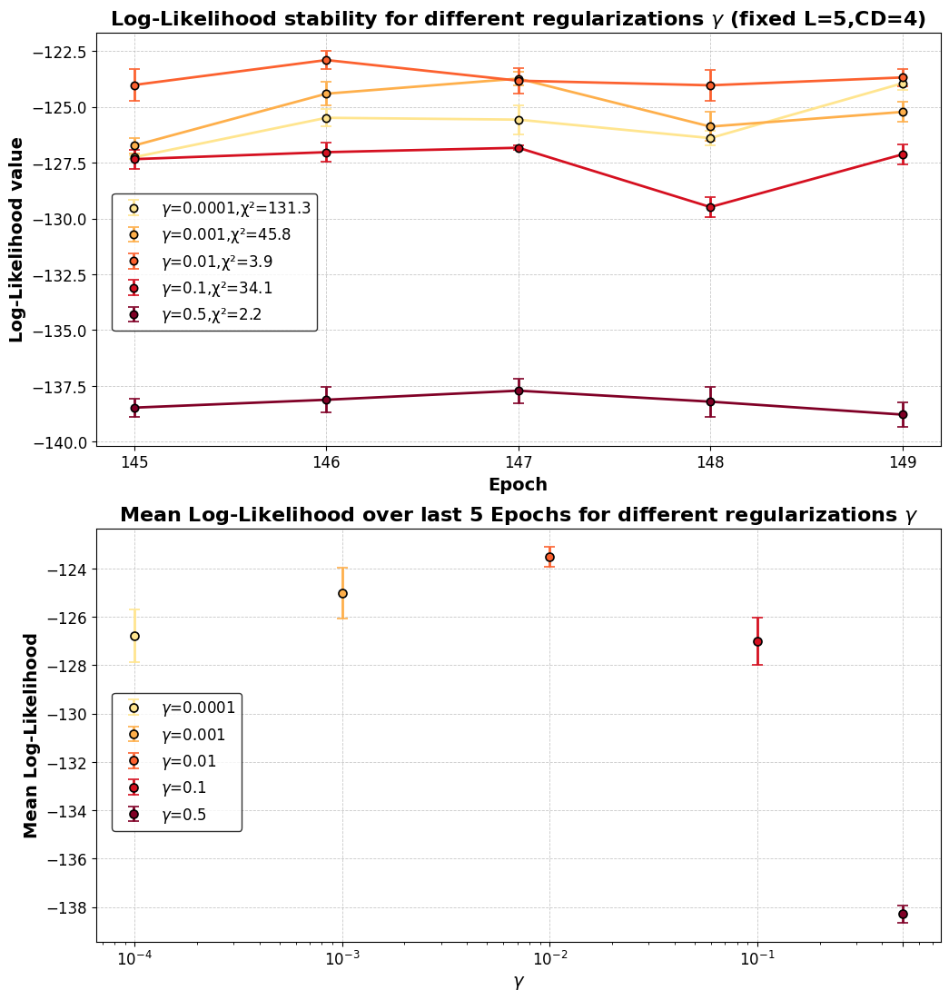

In [74]:
# variable gamma steps, fixed L=5 and CD steps=4
colors = plt.cm.YlOrRd(np.linspace(0.178, 1, len(log_like_gamma)))
Nepoch=150
num_epo=np.arange(Nepoch-5,Nepoch,1)

fig, (ax1,ax2) = plt.subplots(2,1,figsize=(12,13))

for i, log_like in enumerate(log_like_gamma):
    weights = 1 / np.array(log_like_gamma_std[i])**2
    weighted_avg = np.average(log_like, weights=weights)  # weighted average of log-likelihoods of last 10 epochs
    weighted_error = np.sqrt(1 / np.sum(weights)) # error of weighted average
    chi = np.sum(((log_like - weighted_avg*np.ones(5))/log_like_gamma_std[i]) ** 2)
    
    ax1.errorbar(num_epo,log_like,yerr=log_like_gamma_std[i],fmt='o',color=colors[i],label=f'$\gamma$={gamma_v[i]},χ²={round(chi,1)}',linewidth=2, markersize=6,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black', markeredgewidth=1.2)
    ax1.plot(num_epo, log_like, color=colors[i], linewidth=2)

    ax2.errorbar(gamma_v[i],weighted_avg,yerr=np.array(log_like).std(),fmt='o',color=colors[i],label=f'$\gamma$={gamma_v[i]}',linewidth=2,markersize=6.5,capsize=4, capthick=1,markerfacecolor=colors[i], markeredgecolor='black',markeredgewidth=1.2 )
    ax2.set_xscale('log')
   

ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
ax1.set_title('Log-Likelihood stability for different regularizations $\gamma$ (fixed L=5,CD=4)', fontsize=16, fontweight='bold')
ax1.set_xticks(num_epo)
ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax1.legend(fontsize=12, loc='center left', frameon=True, bbox_to_anchor=(0.01, 0.444), edgecolor='black')

ax2.set_xlabel('$\gamma$', fontsize=14, fontweight='bold')
ax2.set_ylabel('Mean Log-Likelihood', fontsize=14, fontweight='bold')
ax2.set_title('Mean Log-Likelihood over last 5 Epochs for different regularizations $\gamma$', fontsize=16, fontweight='bold')
ax2.set_xticks(gamma_v)
#ax2.set_xticklabels([f'{tick:.1e}' for tick in gamma_v])
ax2.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
ax2.legend(fontsize=12, loc='lower left', frameon=True, bbox_to_anchor=(0.01, 0.25), edgecolor='black')

file_path = 'GRAPHS/log_like_gammas_plot.png'  # Path where you want to save the figure
fig.savefig(file_path, dpi=300, bbox_inches='tight')  # Save the figure as a .png file with high resolution


plt.show()

## training with POTTS

Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

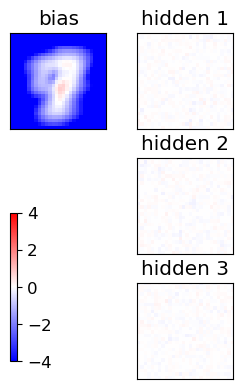

Starting the training, POTTS=True
[ 2219 11820    69 16718 20936 17893   898  9498 12478 10813]
[ 4587  7695  9425  2875 15778 15805  4134 10463  5914  4403]
[12555 17993  4464 10435 20812 14069 19120  5014  2546  4763]
[15970  6959  5588  4104  2087 20456  8566 19566 17496  9947]
epoch 1 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

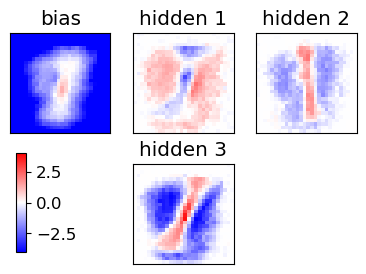

epoch 21 / 450  Nt: 4  N: 10  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

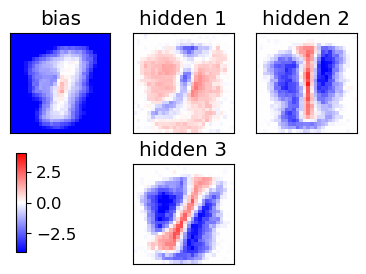

epoch 41 / 450  Nt: 4  N: 13  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

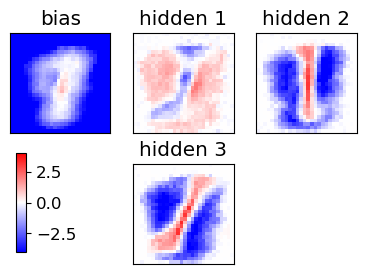

epoch 61 / 450  Nt: 4  N: 18  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

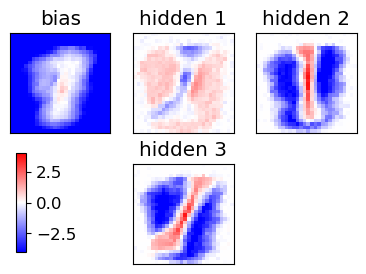

epoch 81 / 450  Nt: 4  N: 25  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

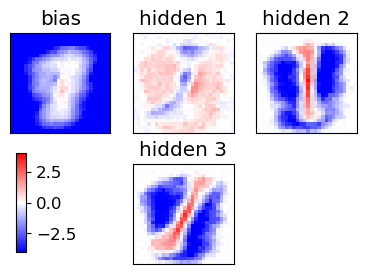

epoch 101 / 450  Nt: 4  N: 34  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

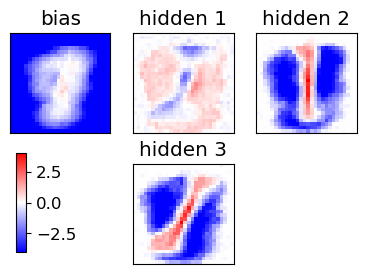

epoch 121 / 450  Nt: 4  N: 44  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

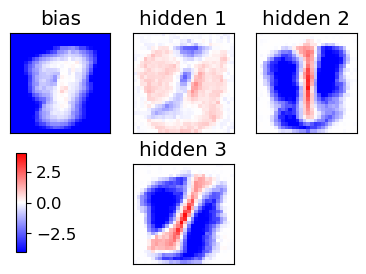

epoch 141 / 450  Nt: 4  N: 57  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

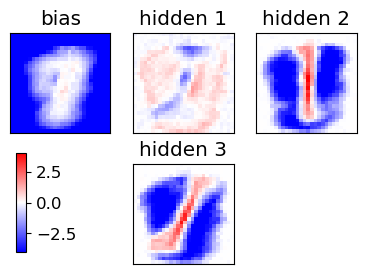

epoch 161 / 450  Nt: 4  N: 72  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

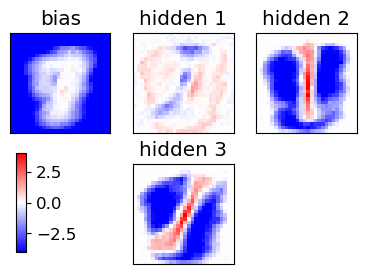

epoch 181 / 450  Nt: 4  N: 88  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

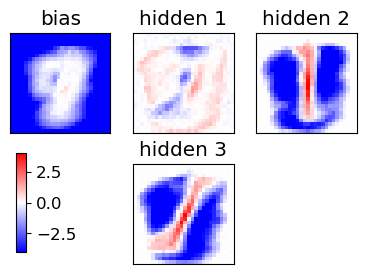

epoch 201 / 450  Nt: 4  N: 107  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

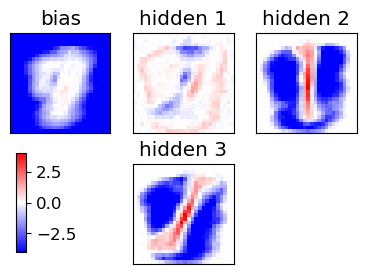

epoch 221 / 450  Nt: 4  N: 127  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

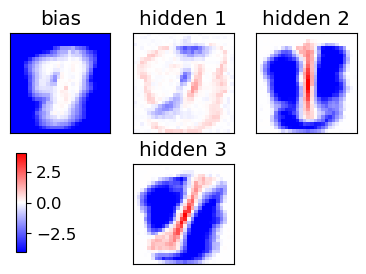

epoch 241 / 450  Nt: 4  N: 149  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

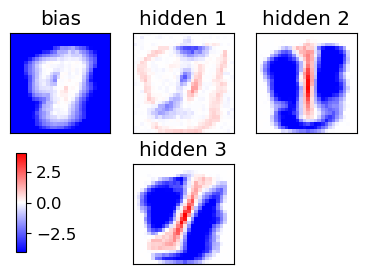

epoch 261 / 450  Nt: 4  N: 174  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

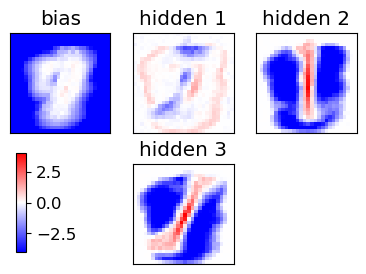

epoch 281 / 450  Nt: 4  N: 200  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

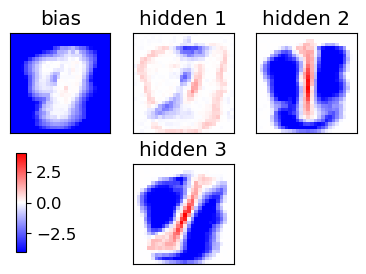

epoch 301 / 450  Nt: 4  N: 228  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

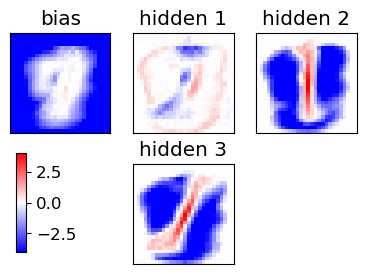

epoch 321 / 450  Nt: 4  N: 258  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

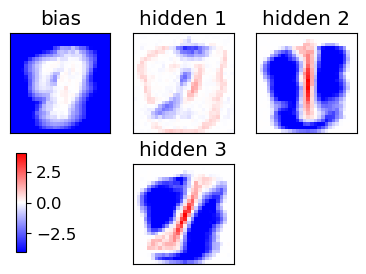

epoch 341 / 450  Nt: 4  N: 290  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

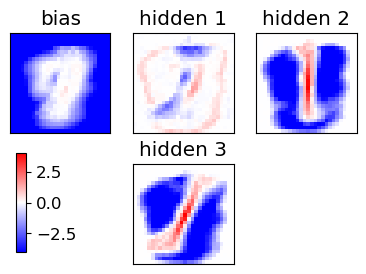

epoch 361 / 450  Nt: 4  N: 324  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

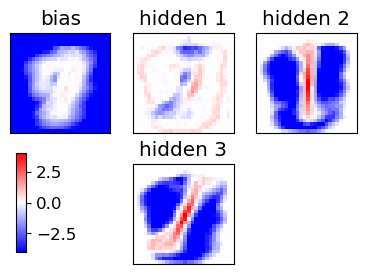

epoch 381 / 450  Nt: 4  N: 360  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

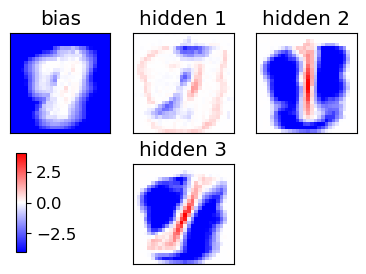

epoch 401 / 450  Nt: 4  N: 398  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

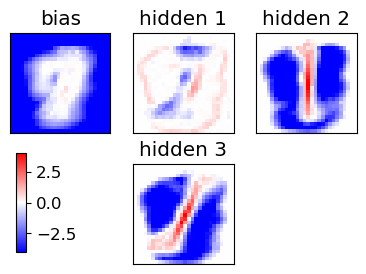

epoch 421 / 450  Nt: 4  N: 438  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 3  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

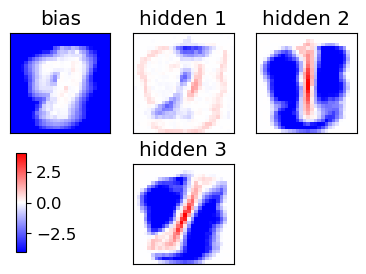

epoch 441 / 450  Nt: 4  N: 480  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 3  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

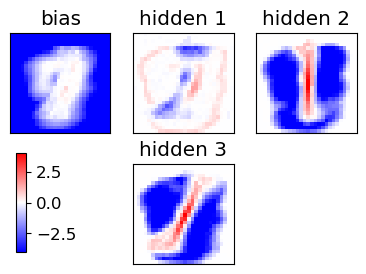

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

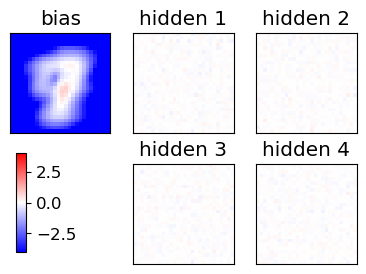

Starting the training, POTTS=True
[  524  9439  4246 15561  4837 18883  9665 17311 15871  8415]
[10825  1500  7909 17950  1348 21959 20033   622  6724  6322]
[ 2377  6218  1942 17090 10534  4751   622  6271  2800 16216]
[15456 21350 16298 13620 18297 12528  5320  2414  4219 14210]
epoch 1 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

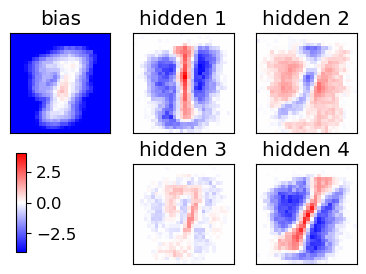

epoch 21 / 450  Nt: 4  N: 10  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

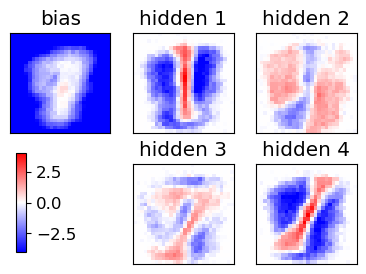

epoch 41 / 450  Nt: 4  N: 13  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

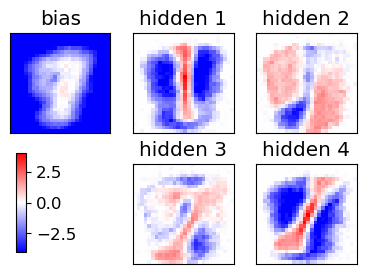

epoch 61 / 450  Nt: 4  N: 18  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

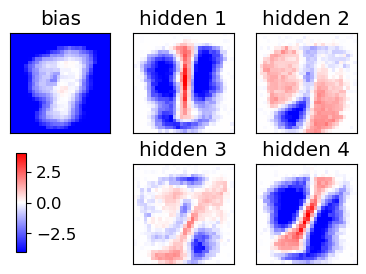

epoch 81 / 450  Nt: 4  N: 25  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

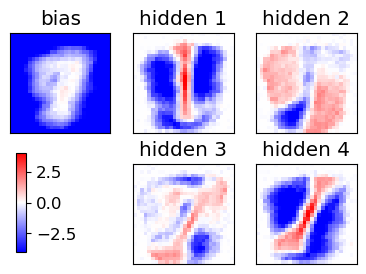

epoch 101 / 450  Nt: 4  N: 34  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

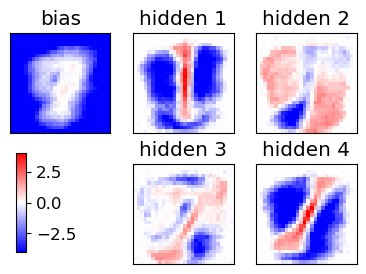

epoch 121 / 450  Nt: 4  N: 44  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

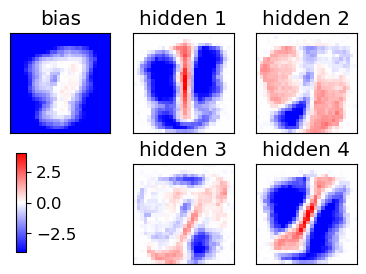

epoch 141 / 450  Nt: 4  N: 57  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

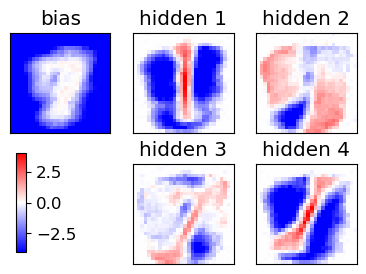

epoch 161 / 450  Nt: 4  N: 72  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

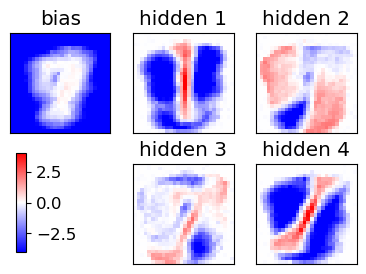

epoch 181 / 450  Nt: 4  N: 88  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

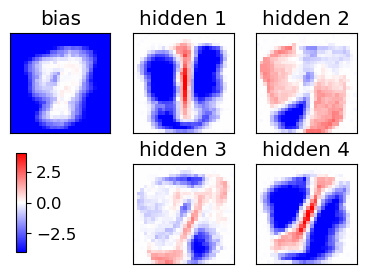

epoch 201 / 450  Nt: 4  N: 107  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

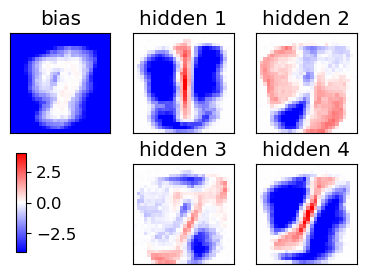

epoch 221 / 450  Nt: 4  N: 127  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

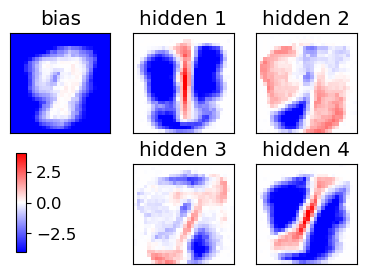

epoch 241 / 450  Nt: 4  N: 149  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

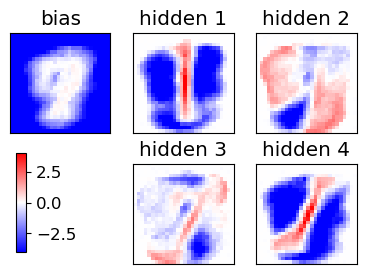

epoch 261 / 450  Nt: 4  N: 174  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

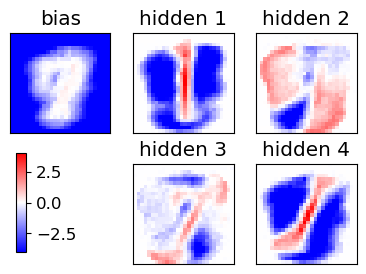

epoch 281 / 450  Nt: 4  N: 200  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

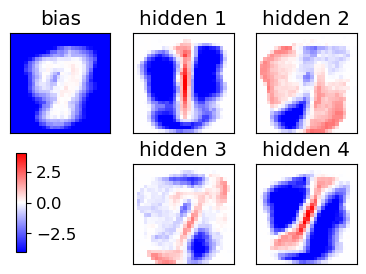

epoch 301 / 450  Nt: 4  N: 228  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

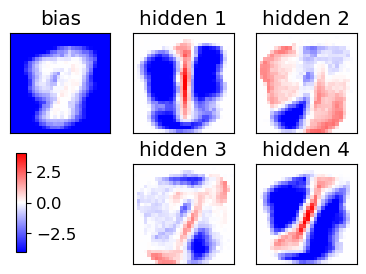

epoch 321 / 450  Nt: 4  N: 258  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

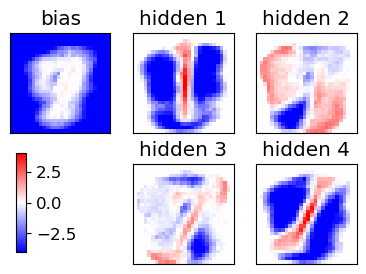

epoch 341 / 450  Nt: 4  N: 290  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

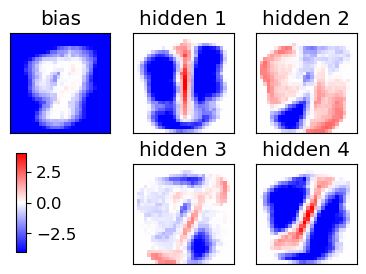

epoch 361 / 450  Nt: 4  N: 324  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

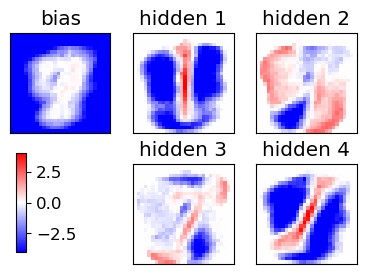

epoch 381 / 450  Nt: 4  N: 360  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

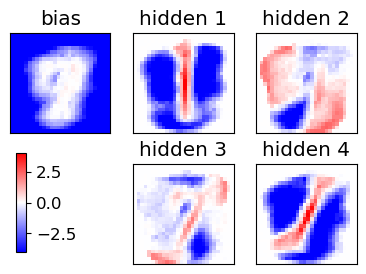

epoch 401 / 450  Nt: 4  N: 398  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

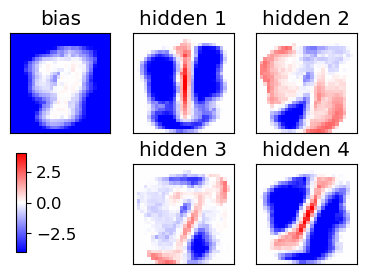

epoch 421 / 450  Nt: 4  N: 438  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 4  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

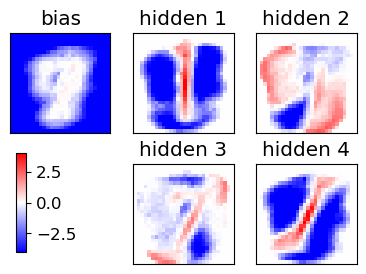

epoch 441 / 450  Nt: 4  N: 480  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 4  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

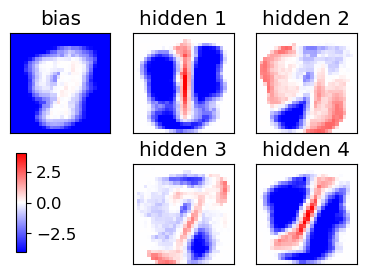

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

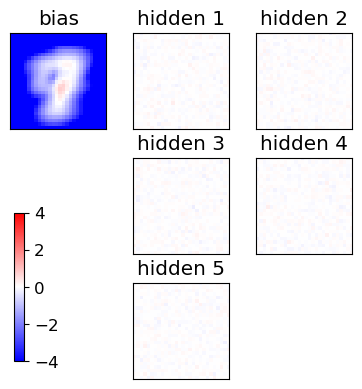

Starting the training, POTTS=True
[20884  7854  1211  7633 17979  1836  9586  9651  6187 10278]
[12213  6154 11517 14041 18831 13438 12950  7456  6968 16832]
[19856 15109 13088 14970   349  1702 16105 15398  9966 12002]
[ 9597  1254 21397 20768 10211  7094 20818  7463  4066 20725]
epoch 1 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

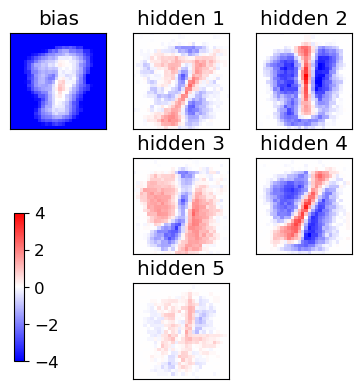

epoch 21 / 450  Nt: 4  N: 10  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

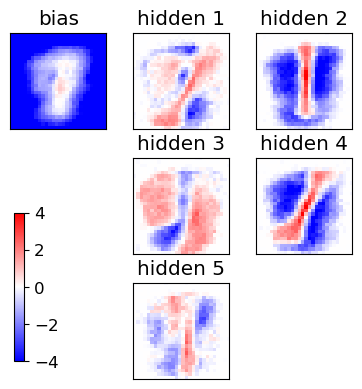

epoch 41 / 450  Nt: 4  N: 13  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

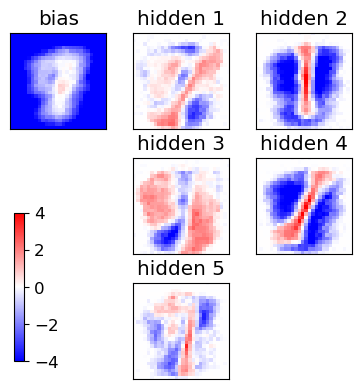

epoch 61 / 450  Nt: 4  N: 18  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

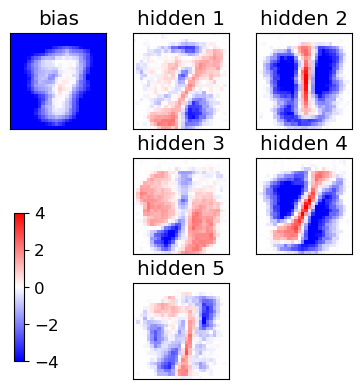

epoch 81 / 450  Nt: 4  N: 25  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

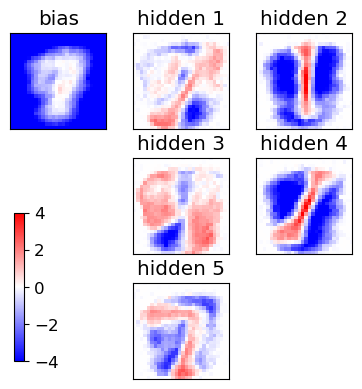

epoch 101 / 450  Nt: 4  N: 34  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

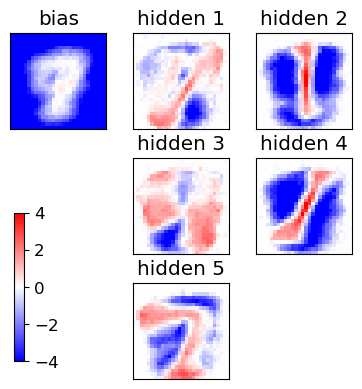

epoch 121 / 450  Nt: 4  N: 44  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

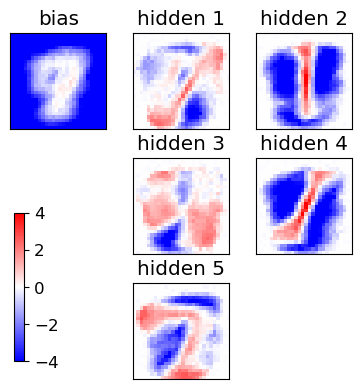

epoch 141 / 450  Nt: 4  N: 57  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

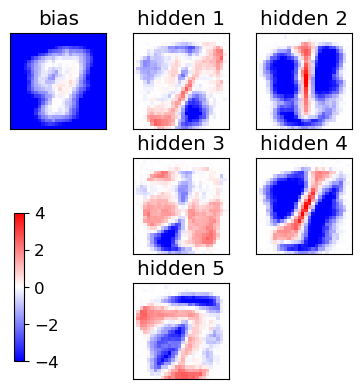

epoch 161 / 450  Nt: 4  N: 72  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

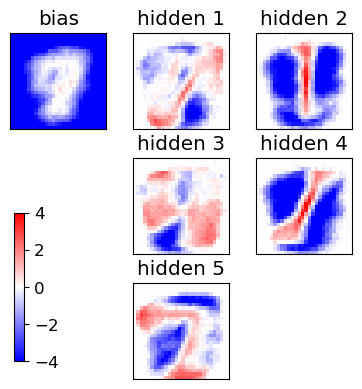

epoch 181 / 450  Nt: 4  N: 88  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

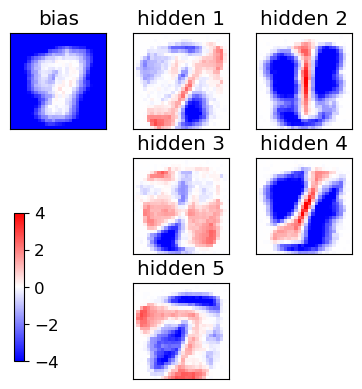

epoch 201 / 450  Nt: 4  N: 107  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

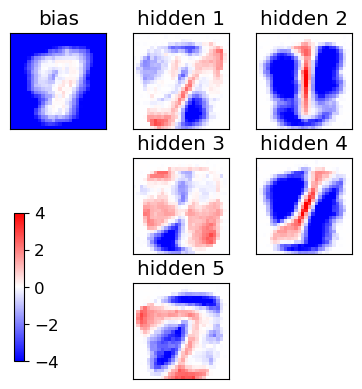

epoch 221 / 450  Nt: 4  N: 127  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

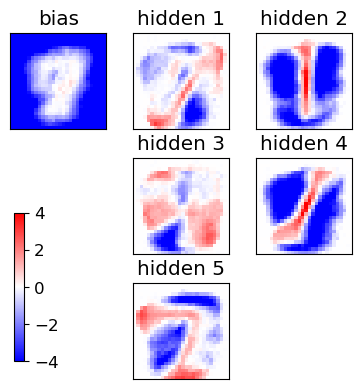

epoch 241 / 450  Nt: 4  N: 149  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

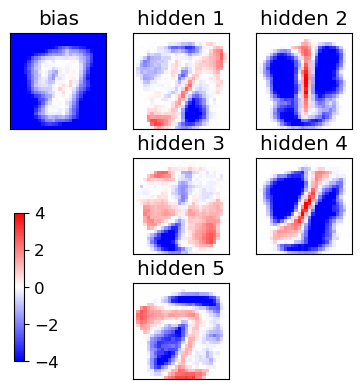

epoch 261 / 450  Nt: 4  N: 174  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

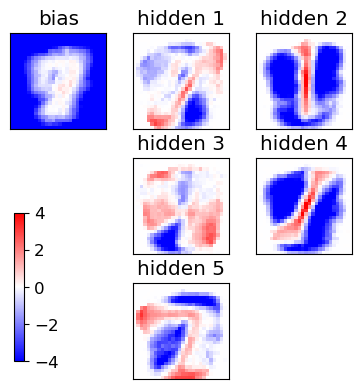

epoch 281 / 450  Nt: 4  N: 200  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

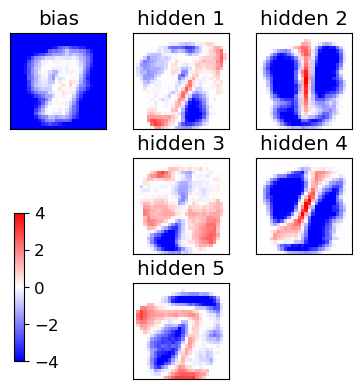

epoch 301 / 450  Nt: 4  N: 228  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

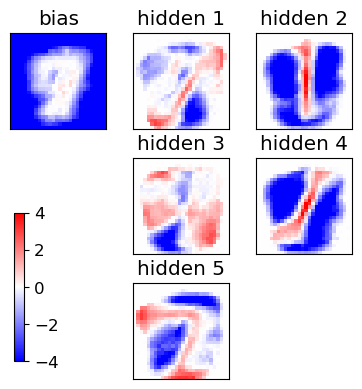

epoch 321 / 450  Nt: 4  N: 258  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

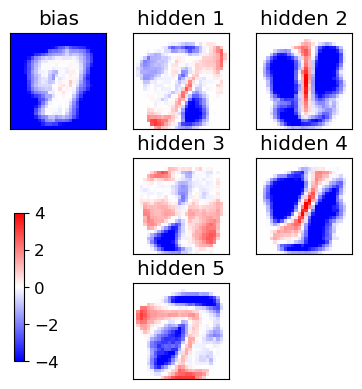

epoch 341 / 450  Nt: 4  N: 290  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

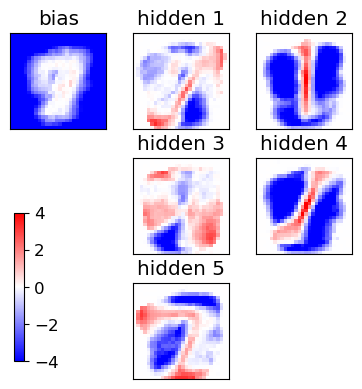

epoch 361 / 450  Nt: 4  N: 324  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

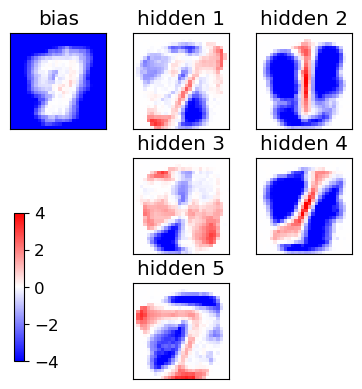

epoch 381 / 450  Nt: 4  N: 360  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

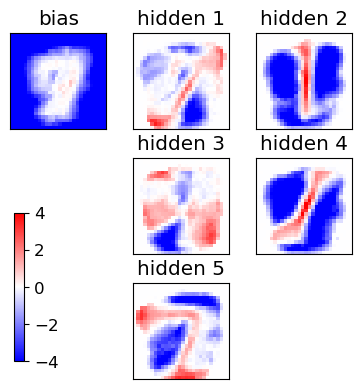

epoch 401 / 450  Nt: 4  N: 398  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

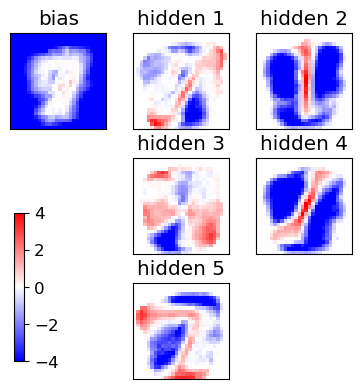

epoch 421 / 450  Nt: 4  N: 438  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 5  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

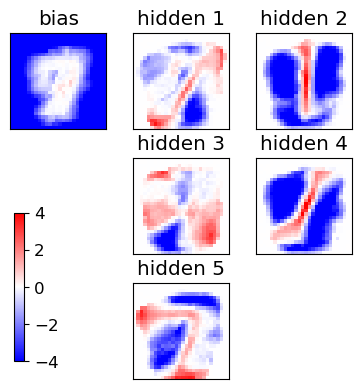

epoch 441 / 450  Nt: 4  N: 480  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 5  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

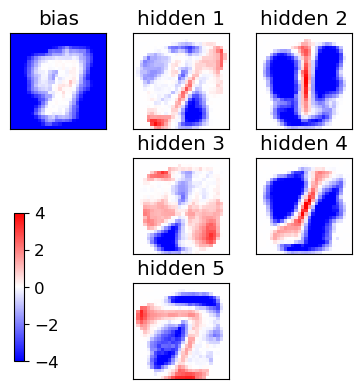

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

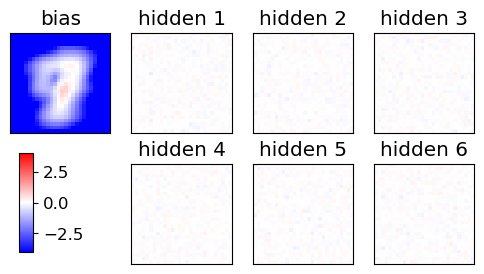

Starting the training, POTTS=True
[18161 12065 16951 21942 16821  2021 12114 11400 13467 16729]
[19678  4323    32   651  2177  3550  2681  8281 14716 11810]
[ 9468 20136  1544 17634 10032  4114  3053  9917 16496 21955]
[  260  7156 11149 20912  8734  1993  9074 10461  7421 10236]
epoch 1 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

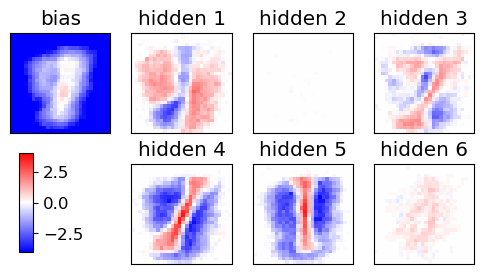

epoch 21 / 450  Nt: 4  N: 10  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

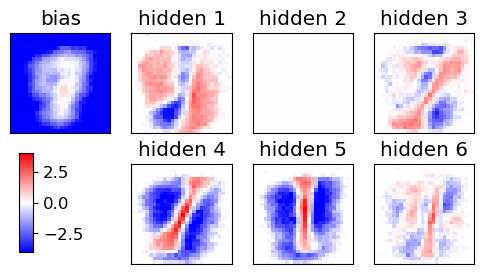

epoch 41 / 450  Nt: 4  N: 13  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

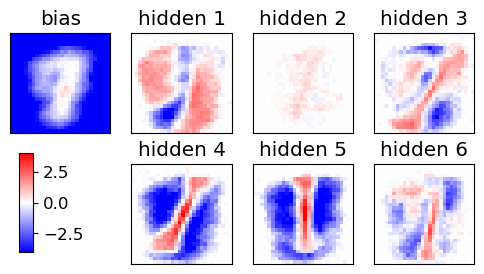

epoch 61 / 450  Nt: 4  N: 18  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

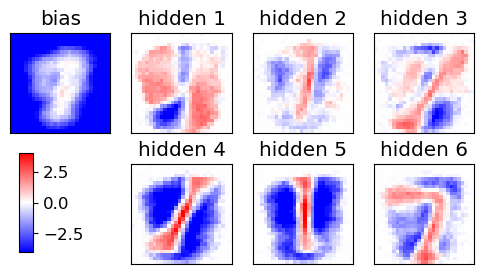

epoch 81 / 450  Nt: 4  N: 25  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

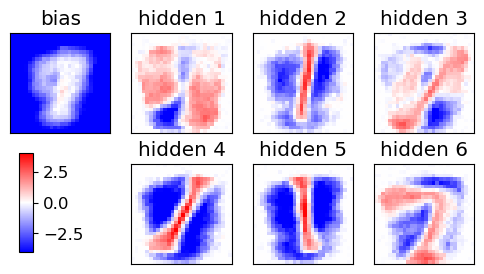

epoch 101 / 450  Nt: 4  N: 34  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

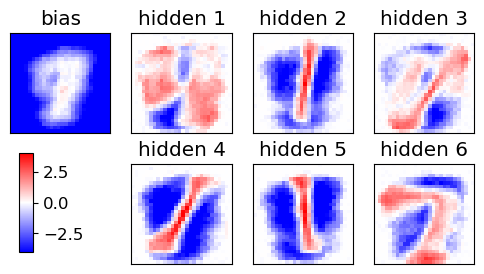

epoch 121 / 450  Nt: 4  N: 44  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

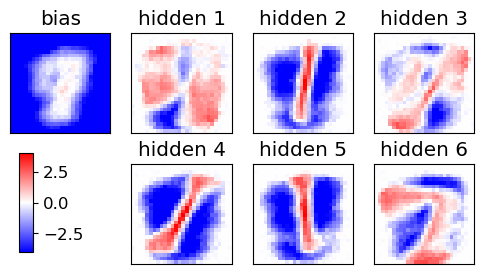

epoch 141 / 450  Nt: 4  N: 57  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

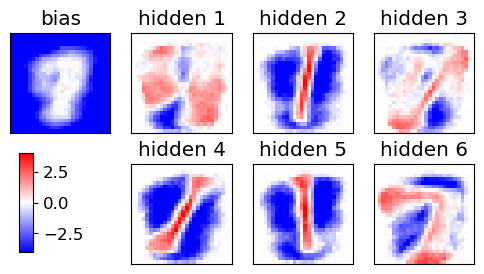

epoch 161 / 450  Nt: 4  N: 72  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

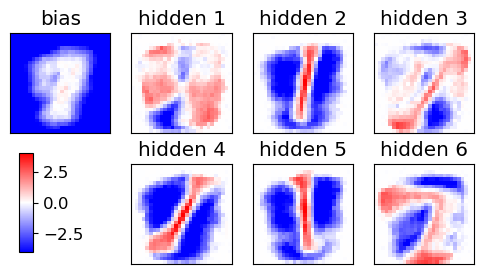

epoch 181 / 450  Nt: 4  N: 88  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

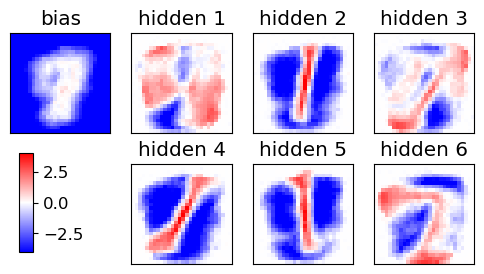

epoch 201 / 450  Nt: 4  N: 107  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

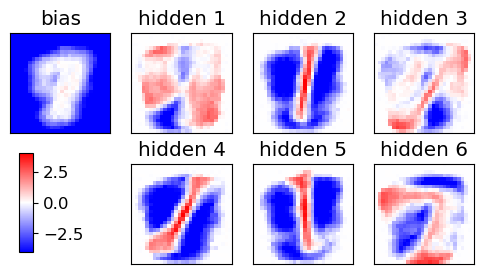

epoch 221 / 450  Nt: 4  N: 127  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

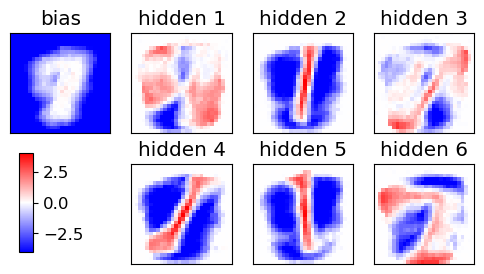

epoch 241 / 450  Nt: 4  N: 149  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

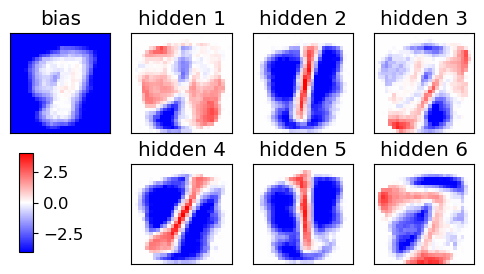

epoch 261 / 450  Nt: 4  N: 174  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

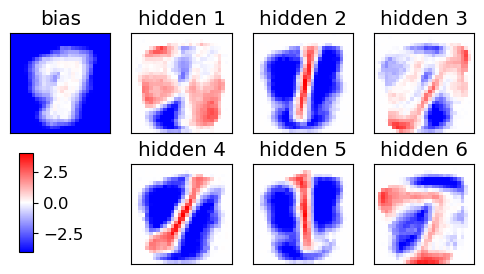

epoch 281 / 450  Nt: 4  N: 200  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

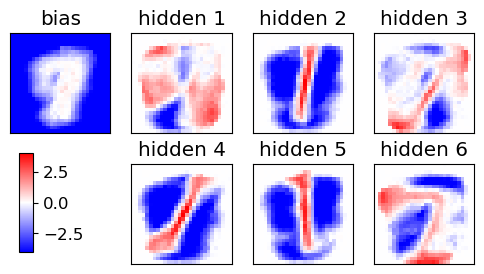

epoch 301 / 450  Nt: 4  N: 228  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

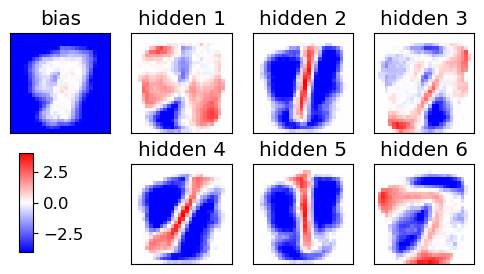

epoch 321 / 450  Nt: 4  N: 258  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

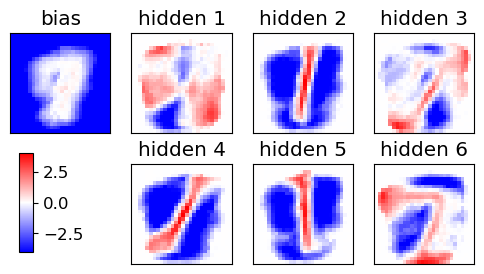

epoch 341 / 450  Nt: 4  N: 290  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

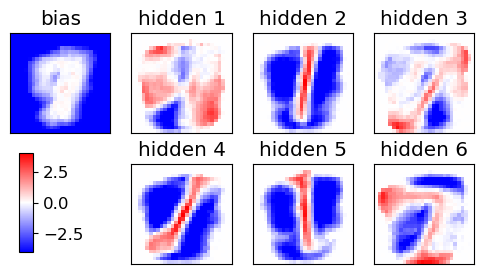

epoch 361 / 450  Nt: 4  N: 324  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

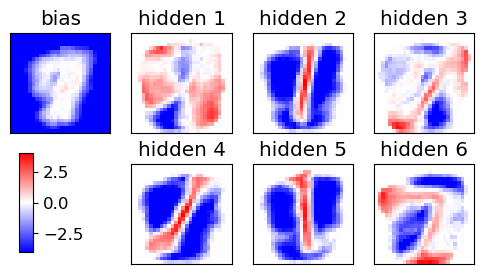

epoch 381 / 450  Nt: 4  N: 360  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

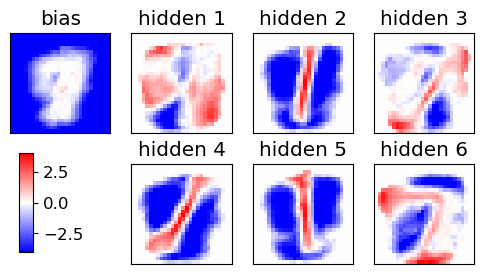

epoch 401 / 450  Nt: 4  N: 398  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

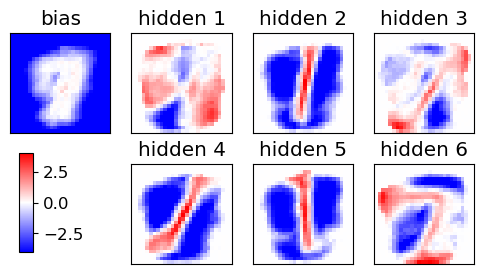

epoch 421 / 450  Nt: 4  N: 438  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 6  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

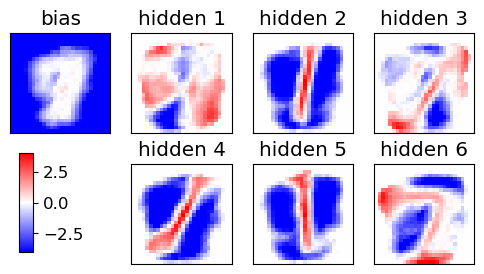

epoch 441 / 450  Nt: 4  N: 480  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 6  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

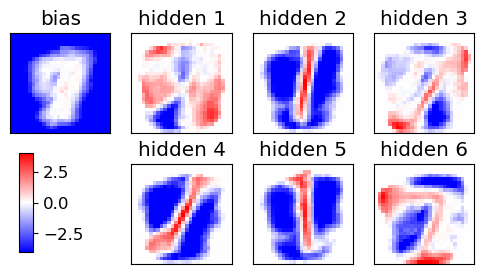

END of learning phase
Nepoch=450
Nmini=20


<Figure size 640x480 with 0 Axes>

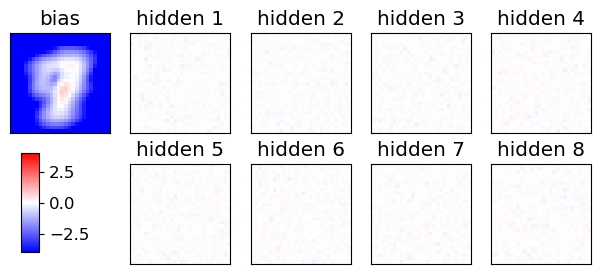

Starting the training, POTTS=True
[ 5113  9764  3520 18599 17086  3162 18562 19041  3180 13941]
[18412  6103 11375  5378 15244 11694 14528  8117  5902  7495]
[11797  5217 14399 10453 16915 10300  3857 14001 16939  5593]
[15505  1059  1316  3775  6594  2333 16381   242 14479  1608]
epoch 1 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 2 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 3 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 4 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 5 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 6 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 7 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 8 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 9 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

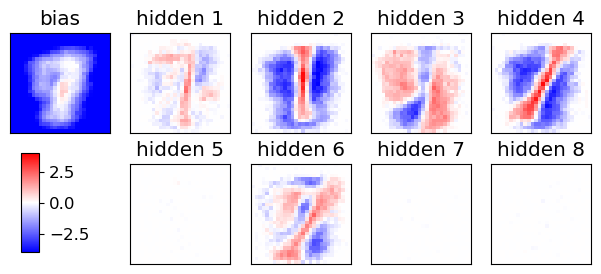

epoch 21 / 450  Nt: 4  N: 10  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 22 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 23 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 24 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 25 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 26 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 27 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 28 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 29 / 450  Nt: 4  N: 11  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 30 / 450  Nt: 4  N: 12  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 31 / 450  Nt: 4  N: 12  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 32 / 450  Nt: 4  N: 12  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

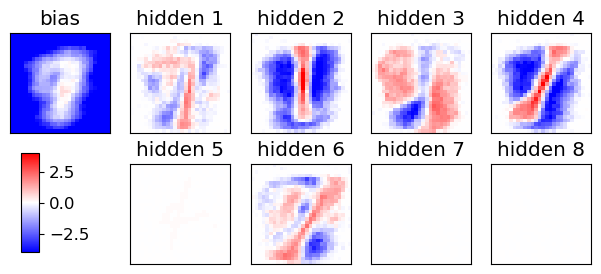

epoch 41 / 450  Nt: 4  N: 13  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 42 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 43 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 44 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 45 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 46 / 450  Nt: 4  N: 14  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 47 / 450  Nt: 4  N: 15  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 48 / 450  Nt: 4  N: 15  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 49 / 450  Nt: 4  N: 15  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 50 / 450  Nt: 4  N: 15  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 51 / 450  Nt: 4  N: 16  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 52 / 450  Nt: 4  N: 16  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

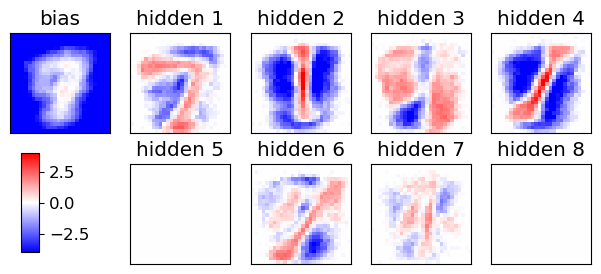

epoch 61 / 450  Nt: 4  N: 18  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 62 / 450  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 63 / 450  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 64 / 450  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 65 / 450  Nt: 4  N: 19  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 66 / 450  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 67 / 450  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 68 / 450  Nt: 4  N: 20  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 69 / 450  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 70 / 450  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 71 / 450  Nt: 4  N: 21  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 72 / 450  Nt: 4  N: 22  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

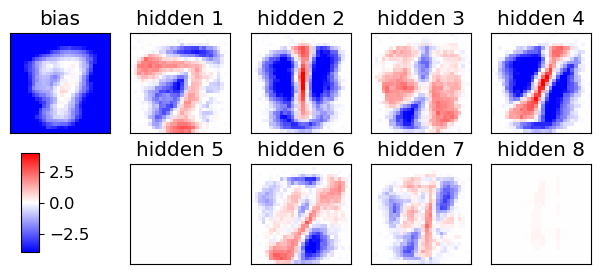

epoch 81 / 450  Nt: 4  N: 25  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 82 / 450  Nt: 4  N: 25  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 83 / 450  Nt: 4  N: 26  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 84 / 450  Nt: 4  N: 26  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 85 / 450  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 86 / 450  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 87 / 450  Nt: 4  N: 27  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 88 / 450  Nt: 4  N: 28  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 89 / 450  Nt: 4  N: 28  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 90 / 450  Nt: 4  N: 29  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 91 / 450  Nt: 4  N: 29  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 92 / 450  Nt: 4  N: 30  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoc

<Figure size 640x480 with 0 Axes>

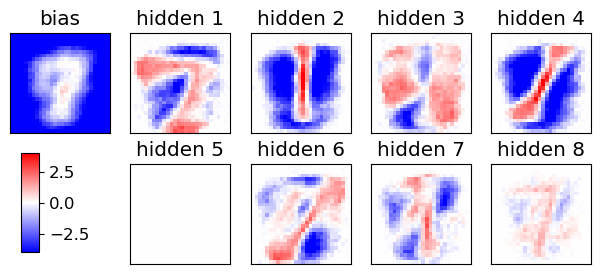

epoch 101 / 450  Nt: 4  N: 34  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 102 / 450  Nt: 4  N: 34  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 103 / 450  Nt: 4  N: 35  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 104 / 450  Nt: 4  N: 35  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 105 / 450  Nt: 4  N: 36  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 106 / 450  Nt: 4  N: 36  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 107 / 450  Nt: 4  N: 37  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 108 / 450  Nt: 4  N: 37  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 109 / 450  Nt: 4  N: 38  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 110 / 450  Nt: 4  N: 38  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 111 / 450  Nt: 4  N: 39  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 112 / 450  Nt: 4  N: 39  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

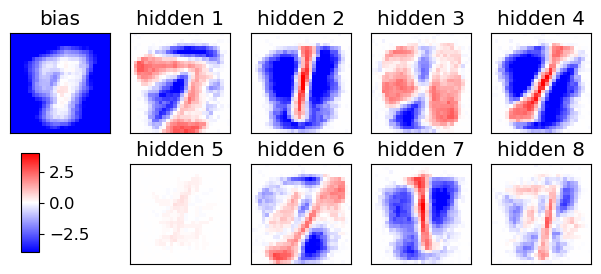

epoch 121 / 450  Nt: 4  N: 44  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 122 / 450  Nt: 4  N: 45  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 123 / 450  Nt: 4  N: 46  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 124 / 450  Nt: 4  N: 46  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 125 / 450  Nt: 4  N: 47  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 126 / 450  Nt: 4  N: 47  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 127 / 450  Nt: 4  N: 48  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 128 / 450  Nt: 4  N: 49  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 129 / 450  Nt: 4  N: 49  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 130 / 450  Nt: 4  N: 50  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 131 / 450  Nt: 4  N: 51  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 132 / 450  Nt: 4  N: 51  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

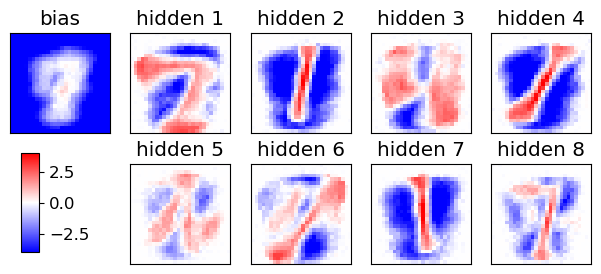

epoch 141 / 450  Nt: 4  N: 57  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 142 / 450  Nt: 4  N: 58  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 143 / 450  Nt: 4  N: 59  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 144 / 450  Nt: 4  N: 59  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 145 / 450  Nt: 4  N: 60  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 146 / 450  Nt: 4  N: 61  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 147 / 450  Nt: 4  N: 61  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 148 / 450  Nt: 4  N: 62  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 149 / 450  Nt: 4  N: 63  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 150 / 450  Nt: 4  N: 63  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 151 / 450  Nt: 4  N: 64  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 152 / 450  Nt: 4  N: 65  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

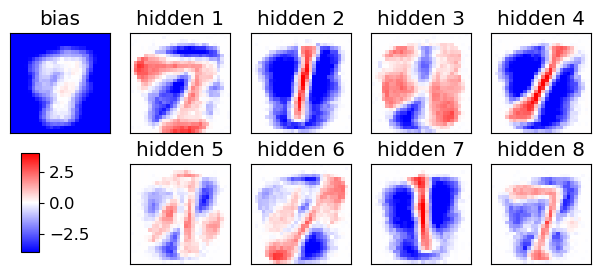

epoch 161 / 450  Nt: 4  N: 72  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 162 / 450  Nt: 4  N: 73  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 163 / 450  Nt: 4  N: 73  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 164 / 450  Nt: 4  N: 74  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 165 / 450  Nt: 4  N: 75  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 166 / 450  Nt: 4  N: 76  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 167 / 450  Nt: 4  N: 76  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 168 / 450  Nt: 4  N: 77  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 169 / 450  Nt: 4  N: 78  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 170 / 450  Nt: 4  N: 79  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 171 / 450  Nt: 4  N: 80  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 172 / 450  Nt: 4  N: 81  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

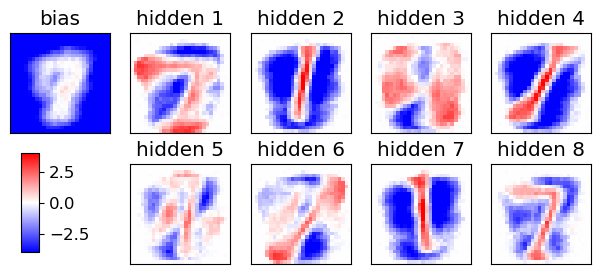

epoch 181 / 450  Nt: 4  N: 88  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 182 / 450  Nt: 4  N: 89  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 183 / 450  Nt: 4  N: 90  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 184 / 450  Nt: 4  N: 91  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 185 / 450  Nt: 4  N: 92  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 186 / 450  Nt: 4  N: 93  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 187 / 450  Nt: 4  N: 94  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 188 / 450  Nt: 4  N: 94  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 189 / 450  Nt: 4  N: 95  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 190 / 450  Nt: 4  N: 96  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 191 / 450  Nt: 4  N: 97  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 192 / 450  Nt: 4  N: 98  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTT

<Figure size 640x480 with 0 Axes>

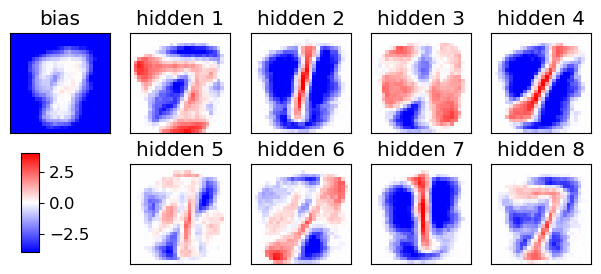

epoch 201 / 450  Nt: 4  N: 107  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 202 / 450  Nt: 4  N: 108  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 203 / 450  Nt: 4  N: 109  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 204 / 450  Nt: 4  N: 110  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 205 / 450  Nt: 4  N: 111  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 206 / 450  Nt: 4  N: 112  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 207 / 450  Nt: 4  N: 113  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 208 / 450  Nt: 4  N: 114  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 209 / 450  Nt: 4  N: 115  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 210 / 450  Nt: 4  N: 116  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 211 / 450  Nt: 4  N: 117  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 212 / 450  Nt: 4  N: 118  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

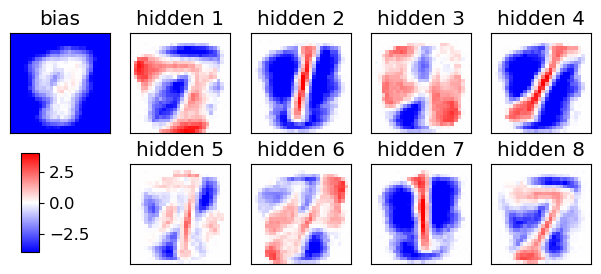

epoch 221 / 450  Nt: 4  N: 127  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 222 / 450  Nt: 4  N: 128  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 223 / 450  Nt: 4  N: 129  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 224 / 450  Nt: 4  N: 130  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 225 / 450  Nt: 4  N: 131  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 226 / 450  Nt: 4  N: 133  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 227 / 450  Nt: 4  N: 134  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 228 / 450  Nt: 4  N: 135  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 229 / 450  Nt: 4  N: 136  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 230 / 450  Nt: 4  N: 137  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 231 / 450  Nt: 4  N: 138  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 232 / 450  Nt: 4  N: 139  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

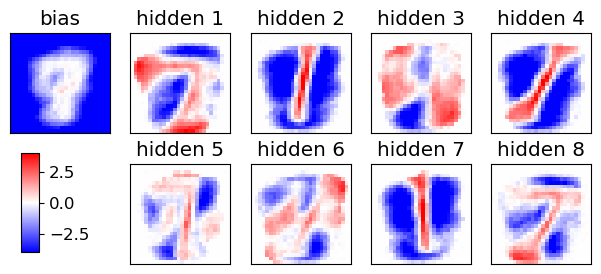

epoch 241 / 450  Nt: 4  N: 149  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 242 / 450  Nt: 4  N: 151  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 243 / 450  Nt: 4  N: 152  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 244 / 450  Nt: 4  N: 153  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 245 / 450  Nt: 4  N: 154  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 246 / 450  Nt: 4  N: 155  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 247 / 450  Nt: 4  N: 157  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 248 / 450  Nt: 4  N: 158  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 249 / 450  Nt: 4  N: 159  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 250 / 450  Nt: 4  N: 160  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 251 / 450  Nt: 4  N: 161  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 252 / 450  Nt: 4  N: 163  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

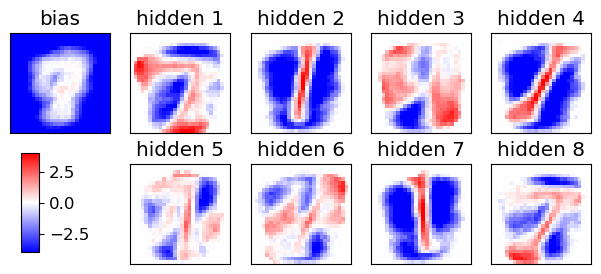

epoch 261 / 450  Nt: 4  N: 174  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 262 / 450  Nt: 4  N: 175  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 263 / 450  Nt: 4  N: 176  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 264 / 450  Nt: 4  N: 178  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 265 / 450  Nt: 4  N: 179  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 266 / 450  Nt: 4  N: 180  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 267 / 450  Nt: 4  N: 181  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 268 / 450  Nt: 4  N: 183  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 269 / 450  Nt: 4  N: 184  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 270 / 450  Nt: 4  N: 185  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 271 / 450  Nt: 4  N: 187  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 272 / 450  Nt: 4  N: 188  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

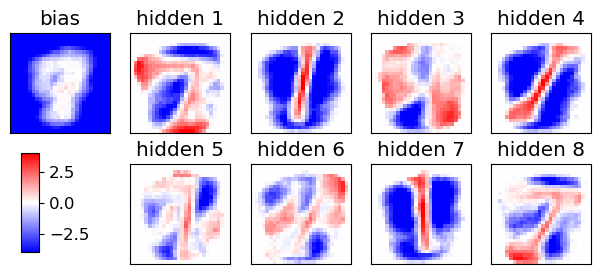

epoch 281 / 450  Nt: 4  N: 200  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 282 / 450  Nt: 4  N: 201  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 283 / 450  Nt: 4  N: 203  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 284 / 450  Nt: 4  N: 204  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 285 / 450  Nt: 4  N: 206  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 286 / 450  Nt: 4  N: 207  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 287 / 450  Nt: 4  N: 208  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 288 / 450  Nt: 4  N: 210  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 289 / 450  Nt: 4  N: 211  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 290 / 450  Nt: 4  N: 213  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 291 / 450  Nt: 4  N: 214  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 292 / 450  Nt: 4  N: 215  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

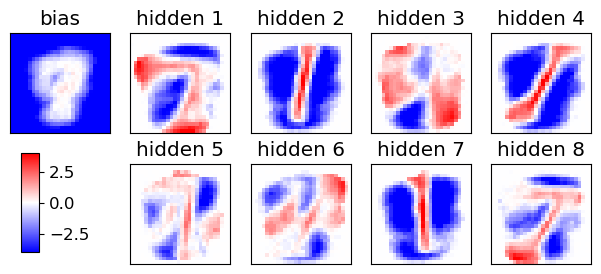

epoch 301 / 450  Nt: 4  N: 228  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 302 / 450  Nt: 4  N: 230  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 303 / 450  Nt: 4  N: 231  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 304 / 450  Nt: 4  N: 233  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 305 / 450  Nt: 4  N: 234  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 306 / 450  Nt: 4  N: 236  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 307 / 450  Nt: 4  N: 237  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 308 / 450  Nt: 4  N: 239  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 309 / 450  Nt: 4  N: 240  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 310 / 450  Nt: 4  N: 242  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 311 / 450  Nt: 4  N: 243  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 312 / 450  Nt: 4  N: 245  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

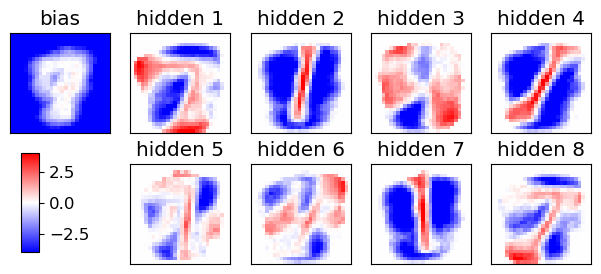

epoch 321 / 450  Nt: 4  N: 258  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 322 / 450  Nt: 4  N: 260  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 323 / 450  Nt: 4  N: 262  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 324 / 450  Nt: 4  N: 263  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 325 / 450  Nt: 4  N: 265  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 326 / 450  Nt: 4  N: 266  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 327 / 450  Nt: 4  N: 268  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 328 / 450  Nt: 4  N: 269  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 329 / 450  Nt: 4  N: 271  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 330 / 450  Nt: 4  N: 273  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 331 / 450  Nt: 4  N: 274  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 332 / 450  Nt: 4  N: 276  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

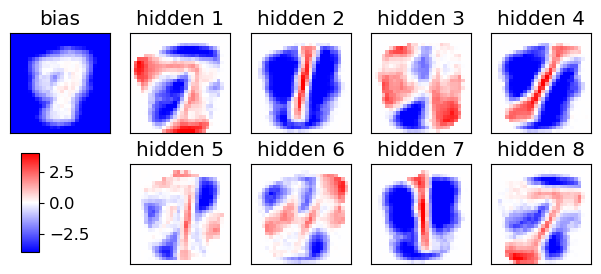

epoch 341 / 450  Nt: 4  N: 290  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 342 / 450  Nt: 4  N: 292  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 343 / 450  Nt: 4  N: 294  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 344 / 450  Nt: 4  N: 295  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 345 / 450  Nt: 4  N: 297  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 346 / 450  Nt: 4  N: 299  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 347 / 450  Nt: 4  N: 300  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 348 / 450  Nt: 4  N: 302  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 349 / 450  Nt: 4  N: 304  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 350 / 450  Nt: 4  N: 306  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 351 / 450  Nt: 4  N: 307  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 352 / 450  Nt: 4  N: 309  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

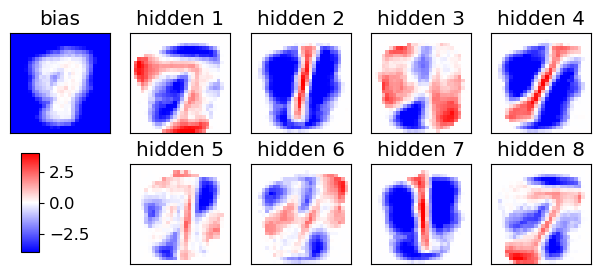

epoch 361 / 450  Nt: 4  N: 324  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 362 / 450  Nt: 4  N: 326  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 363 / 450  Nt: 4  N: 328  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 364 / 450  Nt: 4  N: 330  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 365 / 450  Nt: 4  N: 332  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 366 / 450  Nt: 4  N: 333  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 367 / 450  Nt: 4  N: 335  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 368 / 450  Nt: 4  N: 337  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 369 / 450  Nt: 4  N: 339  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 370 / 450  Nt: 4  N: 340  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 371 / 450  Nt: 4  N: 342  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 372 / 450  Nt: 4  N: 344  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

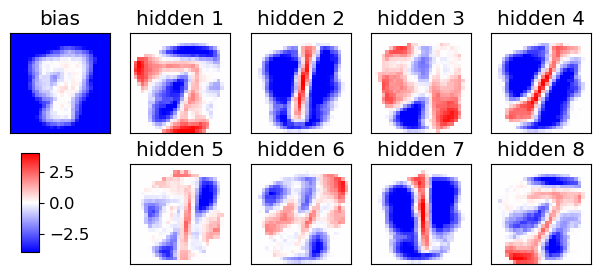

epoch 381 / 450  Nt: 4  N: 360  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 382 / 450  Nt: 4  N: 362  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 383 / 450  Nt: 4  N: 364  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 384 / 450  Nt: 4  N: 366  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 385 / 450  Nt: 4  N: 368  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 386 / 450  Nt: 4  N: 370  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 387 / 450  Nt: 4  N: 372  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 388 / 450  Nt: 4  N: 374  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 389 / 450  Nt: 4  N: 375  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 390 / 450  Nt: 4  N: 377  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 391 / 450  Nt: 4  N: 379  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 392 / 450  Nt: 4  N: 381  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

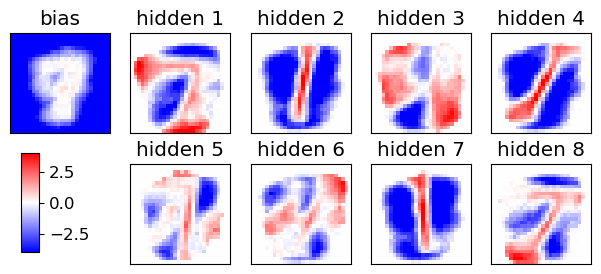

epoch 401 / 450  Nt: 4  N: 398  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 402 / 450  Nt: 4  N: 400  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 403 / 450  Nt: 4  N: 402  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 404 / 450  Nt: 4  N: 404  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 405 / 450  Nt: 4  N: 406  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 406 / 450  Nt: 4  N: 408  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 407 / 450  Nt: 4  N: 410  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 408 / 450  Nt: 4  N: 412  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 409 / 450  Nt: 4  N: 414  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 410 / 450  Nt: 4  N: 416  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 411 / 450  Nt: 4  N: 418  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 412 / 450  Nt: 4  N: 420  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

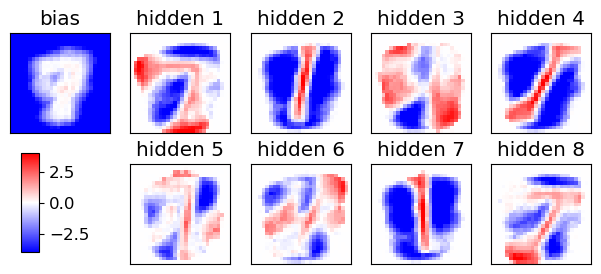

epoch 421 / 450  Nt: 4  N: 438  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 422 / 450  Nt: 4  N: 440  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 423 / 450  Nt: 4  N: 442  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 424 / 450  Nt: 4  N: 444  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 425 / 450  Nt: 4  N: 446  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 426 / 450  Nt: 4  N: 449  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 427 / 450  Nt: 4  N: 451  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 428 / 450  Nt: 4  N: 453  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 429 / 450  Nt: 4  N: 455  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 430 / 450  Nt: 4  N: 457  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 431 / 450  Nt: 4  N: 459  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 432 / 450  Nt: 4  N: 461  L: 8  rate: 0.05  gam: 0.01 SPINS

<Figure size 640x480 with 0 Axes>

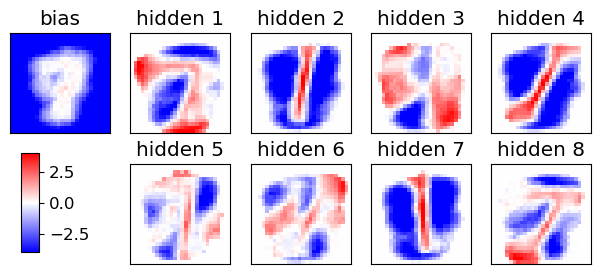

epoch 441 / 450  Nt: 4  N: 480  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 442 / 450  Nt: 4  N: 482  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 443 / 450  Nt: 4  N: 484  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 444 / 450  Nt: 4  N: 486  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 445 / 450  Nt: 4  N: 489  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 446 / 450  Nt: 4  N: 491  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 447 / 450  Nt: 4  N: 493  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 448 / 450  Nt: 4  N: 495  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 449 / 450  Nt: 4  N: 497  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True
epoch 450 / 450  Nt: 4  N: 500  L: 8  rate: 0.05  gam: 0.01 SPINS= False POTTS= True


<Figure size 640x480 with 0 Axes>

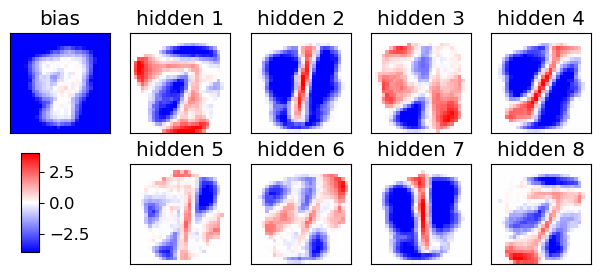

END of learning phase


In [46]:
L_v=[3,4, 5,6,8] ##Nt=4,
gamma=0.01
POTTS=True

for L in L_v:
    if POTTS:
        str_simul="RBM_Potts"
        # in one-hot encoding, number of possible hidden states matches L
        Nz=L
    else:
        str_simul="RBM"
        # number of possible hidden states: 2**L
        Nz=2**L
    
    # initial weights from a Normal distr. (see literature, e.g. page 98 of Mehta's review)
    w = sigma * np.random.randn(D,L)
    #a = sigma * np.random.randn(D)
    # using Hinton initialization of visible biases
    a = Hinton_bias_init(data)
    # hidden biases initialized to zero
    b = np.zeros(L)
    #print("w=",w);print("a=",a);print("b=",b)
    # nr of epochs
    Nepoch=450
    # minibatches per epoch
    Nmini=20
    # minibatch size at initial epoch and final one
    N_ini,N_fin=10,500
    print(f"Nepoch={Nepoch}\nNmini={Nmini}")
    # number of CD steps
    Nt=4
    # recording history of weights ("E" means epoch)
    wE,aE,bE=np.zeros((Nepoch+1,D,L)),np.zeros((Nepoch+1,D)),np.zeros((Nepoch+1,L))
    wE[0],aE[0],bE[0]=np.copy(w),np.copy(a),np.copy(b)
    gwE,gw2E,gwE_d,gwE_m = np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE),np.zeros_like(wE)
    gaE,ga2E,gaE_d,gaE_m = np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE),np.zeros_like(aE)
    gbE,gb2E,gbE_d,gbE_m = np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE),np.zeros_like(bE)
    miniE = np.zeros(Nepoch+1)
    pzE=np.zeros((Nepoch+1,Nz))
    if GRAD=="RMSprop":
        gw2,ga2,gb2 = np.zeros_like(w),np.zeros_like(a),np.zeros_like(b)
    indices=np.arange(Nd).astype("int")
    plot_weights_bias(wE, aE, 0, L, cols=L//2, save=False)
    # for the plot with panels
    Ncols=min(8,max(2,L//2))
    if POTTS: print("Starting the training, POTTS=True")
    else: print("Starting the training")
    # Note: here an epoch does not analyze the whole dataset
    for epoch in range(1,1+Nepoch):
        # q maps epochs to interval [0,1]
        q = (epoch-1.)/(Nepoch-1.)
        # N, size of the mini batch
        # stays closer to N_ini for some time, then it progressively accelerates toward N_fin
        N = int(N_ini + (N_fin-N_ini)*(q**2))
        #  l_rate interpolates between initial and final value
        l_rate = l_rate_ini + (l_rate_fin-l_rate_ini)*q
        for mini in range(Nmini):
            # initializitation for averages in minibatch
            # visible variables "v" --> "x"
            #  hidden variables "h" --> "z"
            x_data, x_model = np.zeros(D),np.zeros(D)
            z_data, z_model = np.zeros(L),np.zeros(L)
            xz_data,xz_model= np.zeros((D,L)),np.zeros((D,L))
            pz = np.zeros(L)
            # Minibatch of size N: points randomply picked (without repetition) from data
            selected = np.random.choice(indices,N,replace=False)
            if epoch==1 and mini<=3: print(selected)
            for k in range(N):
                ###################################
                x0 = data[selected[k]]
                # positive CD phase: generating z from x[k]
                z = CD_step(x0,w,b,POTTS=POTTS)
                x_data  += x0
                z_data  += z
                xz_data += np.outer(x0,z)
                # fantasy
                zf=np.copy(z)
                # Contrastive divergence with Nt steps
                for t in range(Nt):
                    # negative CD pzase: generating fantasy xf from fantasy zf
                    xf = CD_step(zf,w.T,a)
                    # positive CD phase: generating fantasy zf from fantasy xf
                    zf = CD_step(xf,w,b,POTTS=POTTS)
                x_model += xf
                z_model += zf
                xz_model+= np.outer(xf,zf)
                # recording probability of encoding in z-space, if POTTS
                if POTTS: pz[zf]+=1
                ###################################
            # gradient of the likelihood: follow it along its positive direction
            gw_d,gw_m = xz_data/N, xz_model/N
            ga_d,ga_m = x_data/N, x_model/N
            gb_d,gb_m = z_data/N, z_model/N
            gw=np.copy(gw_d - gw_m)
            ga=np.copy(ga_d - ga_m)
            gb=np.copy(gb_d - gb_m)
            # gradient ascent step
            if GRAD=="RMSprop":
                # RMSprop gradient ascent
                gw2 = beta*gw2+(1-beta)*np.square(gw)
                ga2 = beta*ga2+(1-beta)*np.square(ga)
                gb2 = beta*gb2+(1-beta)*np.square(gb)
                w += l_rate*gw/sqrt(epsilon+gw2)
                a += l_rate*ga/sqrt(epsilon+ga2)
                b += l_rate*gb/sqrt(epsilon+gb2)
            else:
                # defaulting to the vanilla stochastic gradient ascent (SGD)
                w += l_rate*gw
                a += l_rate*ga
                b += l_rate*gb
            # regularization (LASSO)
            if gamma>0.:
                w -= (gamma*l_rate)*sign(w)
                a -= (gamma*l_rate)*sign(a)
                b -= (gamma*l_rate)*sign(b)
        wE[epoch],gwE[epoch],gwE_d[epoch],gwE_m[epoch]=np.copy(w),np.copy(gw),np.copy(gw_d),np.copy(gw_m)
        aE[epoch],gaE[epoch],gaE_d[epoch],gaE_m[epoch]=np.copy(a),np.copy(ga),np.copy(ga_d),np.copy(ga_m)
        bE[epoch],gbE[epoch],gbE_d[epoch],gbE_m[epoch]=np.copy(b),np.copy(gb),np.copy(gb_d),np.copy(gb_m)
        miniE[epoch]=N
        if POTTS: pzE[epoch] = pz/np.sum(pz)
        print("epoch",epoch,"/",Nepoch," Nt:",Nt," N:",N," L:",L,
              " rate:",l_rate," gam:",gamma,"SPINS=",SPINS,"POTTS=",POTTS)
        if Nepoch<=100 or epoch%20==0 or epoch==Nepoch:
            plot_weights_bias(wE, aE, epoch, L, cols=Ncols, save=False)
        str_time_completion = datetime.datetime.now().strftime("_%Y%m%d_%H%M")
    save_epochs(wE,"w")
    save_epochs(bE,"b")
    save_epochs(aE,"a")
    print("END of learning phase")


In [54]:
L_v=[3,4, 5,6,8] ##Nt=4,
gamma=0.01
POTTS=True

log_like_potts=[]
for L in L_v:
    Nt=4
    a_all = np.load(f"WEIGHTS/a_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'a_all L={L}, Nt={Nt}')  ## 1 peso per visible per epoch
    b_all= np.load(f"WEIGHTS/b_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'b_all L={L}, Nt={Nt}')  ## 1 peso per hidden per epoch
    w_all=np.load(f"WEIGHTS/w_RBM_Potts_MNIST3_L{L}_Nt{Nt}_RMSprop-0.05-0.05_Ep450_reg0.01_POTTS.npy", allow_pickle=True)
    print(f'w_all L={L}, Nt={Nt}') ## matrice visible*hidden per epoch

    log_like=[]
    num_epo=[]
    Nepoch=450
    n=5  ### take 1/5 of the epoch
    for i in range(Nepoch):
        if i%n==0:
            print(f'Epoch n.{i}')
            ll=compute_log_likelihood(w_all[i], a_all[i], b_all[i], data)
            log_like.append(ll)
            num_epo.append(i)
            print('Log-likelihood=',ll)
    log_like_potts.append(log_like)


a_all L=3, Nt=4
b_all L=3, Nt=4
w_all L=3, Nt=4
Epoch n.0


Computing log-likelihood:   0%|                                                                | 0/5498 [00:00<?, ?it/s]/tmp/ipykernel_1772/1685563349.py:41: NumbaPerformanceWarning: np.dot() is faster on contiguous arrays, called on (Array(float64, 1, 'C', False, aligned=True), Array(float64, 1, 'A', False, aligned=True))
  second_term = -compute_partition_function(w, a, b, all_z, q, D)
Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:03<00:00, 1482.55it/s]


Log-likelihood= -167.68411409918832
Epoch n.5


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2347.70it/s]


Log-likelihood= -155.25664426670102
Epoch n.10


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2380.41it/s]


Log-likelihood= -156.5152982917157
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2347.76it/s]


Log-likelihood= -151.85628219838733
Epoch n.20


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2368.37it/s]


Log-likelihood= -143.92690617833915
Epoch n.25


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2351.18it/s]


Log-likelihood= -142.65359056150018
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2338.81it/s]


Log-likelihood= -146.1722988878586
Epoch n.35


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2337.34it/s]


Log-likelihood= -143.89756278606825
Epoch n.40


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2336.81it/s]


Log-likelihood= -141.577812762708
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2374.12it/s]


Log-likelihood= -142.1318256932208
Epoch n.50


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2334.89it/s]


Log-likelihood= -141.5282519475906
Epoch n.55


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2355.71it/s]


Log-likelihood= -143.2149492591818
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2351.37it/s]


Log-likelihood= -141.81000813294142
Epoch n.65


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2332.29it/s]


Log-likelihood= -143.1469779222156
Epoch n.70


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2349.34it/s]


Log-likelihood= -145.21091221177903
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2364.04it/s]


Log-likelihood= -142.70620293068723
Epoch n.80


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2376.30it/s]


Log-likelihood= -146.27807420234285
Epoch n.85


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2374.60it/s]


Log-likelihood= -143.32726072846046
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2395.60it/s]


Log-likelihood= -147.4800301196037
Epoch n.95


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2380.36it/s]


Log-likelihood= -143.19662370683034
Epoch n.100


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2352.75it/s]


Log-likelihood= -141.69159037405518
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2353.59it/s]


Log-likelihood= -141.14848234825786
Epoch n.110


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2368.17it/s]


Log-likelihood= -142.01688188590214
Epoch n.115


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2374.30it/s]


Log-likelihood= -142.4359469250639
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2349.76it/s]


Log-likelihood= -142.31951327509697
Epoch n.125


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2355.22it/s]


Log-likelihood= -140.83185165549776
Epoch n.130


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2373.38it/s]


Log-likelihood= -144.84458183086463
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2355.46it/s]


Log-likelihood= -148.8213388179832
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2359.10it/s]


Log-likelihood= -141.32499099087943
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2366.54it/s]


Log-likelihood= -142.18629944398583
Epoch n.150


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2346.64it/s]


Log-likelihood= -145.9724395911513
Epoch n.155


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2344.61it/s]


Log-likelihood= -142.0970733188725
Epoch n.160


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2343.53it/s]


Log-likelihood= -146.88657123648937
Epoch n.165


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2365.32it/s]


Log-likelihood= -143.82938782585995
Epoch n.170


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2373.02it/s]


Log-likelihood= -141.11293914939324
Epoch n.175


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2355.51it/s]


Log-likelihood= -141.55180472841613
Epoch n.180


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2352.69it/s]


Log-likelihood= -143.4545023515608
Epoch n.185


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2355.81it/s]


Log-likelihood= -145.19797886199632
Epoch n.190


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2365.19it/s]


Log-likelihood= -141.54657072169098
Epoch n.195


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2370.94it/s]


Log-likelihood= -144.4790373151861
Epoch n.200


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2378.96it/s]


Log-likelihood= -143.38982145873234
Epoch n.205


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2351.91it/s]


Log-likelihood= -144.28323583569258
Epoch n.210


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2311.05it/s]


Log-likelihood= -142.07546448277915
Epoch n.215


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2369.74it/s]


Log-likelihood= -142.65518894208253
Epoch n.220


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2378.69it/s]


Log-likelihood= -143.9511187877926
Epoch n.225


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2387.20it/s]


Log-likelihood= -144.23050820575835
Epoch n.230


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2360.52it/s]


Log-likelihood= -144.4727233532188
Epoch n.235


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2377.23it/s]


Log-likelihood= -145.6297227286427
Epoch n.240


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2373.90it/s]


Log-likelihood= -144.5517827644099
Epoch n.245


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2388.78it/s]


Log-likelihood= -145.75559851389787
Epoch n.250


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2358.64it/s]


Log-likelihood= -146.1840006953258
Epoch n.255


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2373.71it/s]


Log-likelihood= -144.34296585572696
Epoch n.260


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2371.67it/s]


Log-likelihood= -146.03647444376776
Epoch n.265


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2363.08it/s]


Log-likelihood= -147.4035429663501
Epoch n.270


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2364.33it/s]


Log-likelihood= -146.4601575727315
Epoch n.275


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2363.36it/s]


Log-likelihood= -145.7807455048083
Epoch n.280


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2361.71it/s]


Log-likelihood= -148.04516913074215
Epoch n.285


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2388.31it/s]


Log-likelihood= -145.72007208983402
Epoch n.290


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2355.41it/s]


Log-likelihood= -147.71651809681836
Epoch n.295


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2288.66it/s]


Log-likelihood= -148.14438877804793
Epoch n.300


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2365.83it/s]


Log-likelihood= -147.97892348873884
Epoch n.305


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2355.10it/s]


Log-likelihood= -146.5087749654585
Epoch n.310


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2357.87it/s]


Log-likelihood= -146.65945215921116
Epoch n.315


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2337.60it/s]


Log-likelihood= -146.2007338526642
Epoch n.320


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2360.40it/s]


Log-likelihood= -147.9234431247544
Epoch n.325


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2364.44it/s]


Log-likelihood= -146.7218405443136
Epoch n.330


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2374.73it/s]


Log-likelihood= -148.21512697999242
Epoch n.335


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2354.31it/s]


Log-likelihood= -148.0186952210202
Epoch n.340


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2324.23it/s]


Log-likelihood= -148.15149477591117
Epoch n.345


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2358.78it/s]


Log-likelihood= -148.31551110210134
Epoch n.350


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2368.40it/s]


Log-likelihood= -149.50311794701759
Epoch n.355


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2378.40it/s]


Log-likelihood= -149.04778163007342
Epoch n.360


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2353.16it/s]


Log-likelihood= -148.94089883587455
Epoch n.365


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2375.36it/s]


Log-likelihood= -149.7229607654339
Epoch n.370


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2366.61it/s]


Log-likelihood= -149.31086468205652
Epoch n.375


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2391.87it/s]


Log-likelihood= -147.77829546347078
Epoch n.380


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2361.79it/s]


Log-likelihood= -148.81984962568833
Epoch n.385


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2376.79it/s]


Log-likelihood= -149.36538063540954
Epoch n.390


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2371.71it/s]


Log-likelihood= -150.94436730931744
Epoch n.395


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2343.46it/s]


Log-likelihood= -150.62869236845228
Epoch n.400


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2369.63it/s]


Log-likelihood= -150.2244836044823
Epoch n.405


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2360.70it/s]


Log-likelihood= -149.81943046527377
Epoch n.410


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2373.11it/s]


Log-likelihood= -149.7246027175972
Epoch n.415


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2383.15it/s]


Log-likelihood= -149.9257321665704
Epoch n.420


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2375.03it/s]


Log-likelihood= -151.15614977613106
Epoch n.425


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2358.74it/s]


Log-likelihood= -150.62675056428216
Epoch n.430


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2355.79it/s]


Log-likelihood= -149.119562181335
Epoch n.435


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2373.99it/s]


Log-likelihood= -151.37102447685803
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2375.79it/s]


Log-likelihood= -149.98932467945926
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:02<00:00, 2375.39it/s]


Log-likelihood= -149.18626047135808
a_all L=4, Nt=4
b_all L=4, Nt=4
w_all L=4, Nt=4
Epoch n.0


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.54it/s]


Log-likelihood= -167.13864583307134
Epoch n.5


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1190.52it/s]


Log-likelihood= -147.1933506215506
Epoch n.10


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1215.79it/s]


Log-likelihood= -146.36833534485507
Epoch n.15


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.88it/s]


Log-likelihood= -147.74088803647834
Epoch n.20


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.61it/s]


Log-likelihood= -150.86161999420543
Epoch n.25


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1233.94it/s]


Log-likelihood= -160.51830091190365
Epoch n.30


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.50it/s]


Log-likelihood= -157.28324057958298
Epoch n.35


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.88it/s]


Log-likelihood= -155.46694784622412
Epoch n.40


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.77it/s]


Log-likelihood= -155.7145778055718
Epoch n.45


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.93it/s]


Log-likelihood= -154.85120260220793
Epoch n.50


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1194.89it/s]


Log-likelihood= -153.98307941788255
Epoch n.55


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1213.99it/s]


Log-likelihood= -155.22558569647467
Epoch n.60


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1188.77it/s]


Log-likelihood= -154.9074618218977
Epoch n.65


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.57it/s]


Log-likelihood= -152.09464691326255
Epoch n.70


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.48it/s]


Log-likelihood= -151.84337643820695
Epoch n.75


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1221.82it/s]


Log-likelihood= -149.46382381346456
Epoch n.80


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.35it/s]


Log-likelihood= -146.82037296650648
Epoch n.85


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.00it/s]


Log-likelihood= -148.55642084634962
Epoch n.90


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.41it/s]


Log-likelihood= -150.42671611684287
Epoch n.95


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1240.75it/s]


Log-likelihood= -144.63072935906183
Epoch n.100


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1231.65it/s]


Log-likelihood= -142.674484850975
Epoch n.105


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.15it/s]


Log-likelihood= -142.8764807969006
Epoch n.110


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1219.73it/s]


Log-likelihood= -139.67466680385263
Epoch n.115


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.43it/s]


Log-likelihood= -140.32345844922816
Epoch n.120


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.23it/s]


Log-likelihood= -138.37066937961865
Epoch n.125


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1203.85it/s]


Log-likelihood= -138.61095368064082
Epoch n.130


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1215.99it/s]


Log-likelihood= -136.11928069350768
Epoch n.135


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1227.51it/s]


Log-likelihood= -138.8883539746258
Epoch n.140


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1202.16it/s]


Log-likelihood= -139.36409935099377
Epoch n.145


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.17it/s]


Log-likelihood= -138.44193488022864
Epoch n.150


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1213.15it/s]


Log-likelihood= -136.66439017418313
Epoch n.155


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.71it/s]


Log-likelihood= -139.94108087736916
Epoch n.160


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.64it/s]


Log-likelihood= -137.18537452967846
Epoch n.165


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1213.79it/s]


Log-likelihood= -139.43103588990155
Epoch n.170


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.02it/s]


Log-likelihood= -135.31589403408924
Epoch n.175


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1229.22it/s]


Log-likelihood= -138.68900935195035
Epoch n.180


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1221.16it/s]


Log-likelihood= -139.91523056356715
Epoch n.185


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1215.47it/s]


Log-likelihood= -140.03909338763512
Epoch n.190


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.70it/s]


Log-likelihood= -139.8657290001616
Epoch n.195


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1219.91it/s]


Log-likelihood= -136.74764882564102
Epoch n.200


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.05it/s]


Log-likelihood= -141.2174691430994
Epoch n.205


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.34it/s]


Log-likelihood= -141.46379799033454
Epoch n.210


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.59it/s]


Log-likelihood= -134.8919551034183
Epoch n.215


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.10it/s]


Log-likelihood= -140.10363287619134
Epoch n.220


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1218.88it/s]


Log-likelihood= -140.39663072648295
Epoch n.225


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.88it/s]


Log-likelihood= -140.1470185741255
Epoch n.230


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.65it/s]


Log-likelihood= -135.99513074219726
Epoch n.235


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1234.15it/s]


Log-likelihood= -136.26586910334498
Epoch n.240


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1240.97it/s]


Log-likelihood= -137.3636145584375
Epoch n.245


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.62it/s]


Log-likelihood= -135.89751023369152
Epoch n.250


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1218.29it/s]


Log-likelihood= -138.00165886383337
Epoch n.255


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1207.94it/s]


Log-likelihood= -139.5684975887638
Epoch n.260


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.47it/s]


Log-likelihood= -137.12686035894177
Epoch n.265


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1207.67it/s]


Log-likelihood= -135.77404836856553
Epoch n.270


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.99it/s]


Log-likelihood= -136.99195693784256
Epoch n.275


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1197.40it/s]


Log-likelihood= -136.5717520782581
Epoch n.280


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.75it/s]


Log-likelihood= -135.31961207066408
Epoch n.285


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1221.98it/s]


Log-likelihood= -134.4997569877906
Epoch n.290


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.11it/s]


Log-likelihood= -134.8861864482191
Epoch n.295


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.13it/s]


Log-likelihood= -134.09197876796685
Epoch n.300


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1202.89it/s]


Log-likelihood= -135.89715823139716
Epoch n.305


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.23it/s]


Log-likelihood= -136.245507080475
Epoch n.310


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.51it/s]


Log-likelihood= -136.0091792721102
Epoch n.315


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1221.38it/s]


Log-likelihood= -137.8162768839488
Epoch n.320


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1208.34it/s]


Log-likelihood= -136.61428254353197
Epoch n.325


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1170.80it/s]


Log-likelihood= -134.58805197858203
Epoch n.330


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1220.94it/s]


Log-likelihood= -135.698020912092
Epoch n.335


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1211.18it/s]


Log-likelihood= -137.37009343091972
Epoch n.340


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1228.62it/s]


Log-likelihood= -137.93958922310864
Epoch n.345


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1225.76it/s]


Log-likelihood= -133.93042788250492
Epoch n.350


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1229.12it/s]


Log-likelihood= -135.8186282883101
Epoch n.355


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1212.09it/s]


Log-likelihood= -134.45256565020154
Epoch n.360


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1216.15it/s]


Log-likelihood= -137.6368817490602
Epoch n.365


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1212.84it/s]


Log-likelihood= -136.05510742393713
Epoch n.370


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1205.68it/s]


Log-likelihood= -135.07585984270867
Epoch n.375


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1224.38it/s]


Log-likelihood= -137.23160897893203
Epoch n.380


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1238.62it/s]


Log-likelihood= -133.8274472501958
Epoch n.385


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1226.69it/s]


Log-likelihood= -135.31864741107626
Epoch n.390


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.94it/s]


Log-likelihood= -137.19076859193024
Epoch n.395


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1212.91it/s]


Log-likelihood= -136.62606587060245
Epoch n.400


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1217.84it/s]


Log-likelihood= -135.1455194786225
Epoch n.405


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1200.29it/s]


Log-likelihood= -136.46761270958146
Epoch n.410


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1223.13it/s]


Log-likelihood= -137.9618186289568
Epoch n.415


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1239.44it/s]


Log-likelihood= -136.25840676822554
Epoch n.420


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1236.02it/s]


Log-likelihood= -135.97191353046145
Epoch n.425


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1222.76it/s]


Log-likelihood= -135.09471640558348
Epoch n.430


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1210.90it/s]


Log-likelihood= -139.29872035225887
Epoch n.435


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1214.09it/s]


Log-likelihood= -136.48472352059224
Epoch n.440


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1203.44it/s]


Log-likelihood= -136.04645544781002
Epoch n.445


Computing log-likelihood: 100%|███████████████████████████████████████████████████| 5498/5498 [00:04<00:00, 1209.06it/s]


Log-likelihood= -135.8553490683378
a_all L=5, Nt=4
b_all L=5, Nt=4
w_all L=5, Nt=4
Epoch n.0


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 625.48it/s]


Log-likelihood= -167.31901994350298
Epoch n.5


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 620.30it/s]


Log-likelihood= -149.2682975717092
Epoch n.10


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.64it/s]


Log-likelihood= -155.59711360927412
Epoch n.15


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 624.34it/s]


Log-likelihood= -161.84345965725262
Epoch n.20


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 626.31it/s]


Log-likelihood= -168.01855879259486
Epoch n.25


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 618.11it/s]


Log-likelihood= -171.8313499360846
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 620.56it/s]


Log-likelihood= -177.66386543349947
Epoch n.35


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 628.51it/s]


Log-likelihood= -163.6746896445869
Epoch n.40


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 624.13it/s]


Log-likelihood= -157.9916825390034
Epoch n.45


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 615.18it/s]


Log-likelihood= -155.7525184900915
Epoch n.50


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 621.48it/s]


Log-likelihood= -160.78523703593166
Epoch n.55


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 626.89it/s]


Log-likelihood= -161.85030413751065
Epoch n.60


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 621.49it/s]


Log-likelihood= -160.97089885827532
Epoch n.65


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 615.89it/s]


Log-likelihood= -157.91840187992537
Epoch n.70


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 623.94it/s]


Log-likelihood= -156.21549253488092
Epoch n.75


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 626.05it/s]


Log-likelihood= -152.5612167258415
Epoch n.80


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.83it/s]


Log-likelihood= -152.43589629355714
Epoch n.85


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 618.75it/s]


Log-likelihood= -160.71815194869458
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 628.69it/s]


Log-likelihood= -158.77373290080453
Epoch n.95


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 625.30it/s]


Log-likelihood= -159.06471146665822
Epoch n.100


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 618.85it/s]


Log-likelihood= -151.35711664293075
Epoch n.105


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 618.87it/s]


Log-likelihood= -149.60152699183047
Epoch n.110


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 623.28it/s]


Log-likelihood= -151.4448955580869
Epoch n.115


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 618.31it/s]


Log-likelihood= -146.71011687471142
Epoch n.120


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 606.96it/s]


Log-likelihood= -144.02027701259556
Epoch n.125


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 617.82it/s]


Log-likelihood= -140.77015634648293
Epoch n.130


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 617.33it/s]


Log-likelihood= -136.1306586128061
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 607.82it/s]


Log-likelihood= -142.73594747939643
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 615.20it/s]


Log-likelihood= -142.2213274980376
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 621.92it/s]


Log-likelihood= -140.32192671321644
Epoch n.150


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 615.54it/s]


Log-likelihood= -145.595176934297
Epoch n.155


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 615.54it/s]


Log-likelihood= -140.4224991415095
Epoch n.160


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.95it/s]


Log-likelihood= -138.435434465563
Epoch n.165


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 628.08it/s]


Log-likelihood= -141.1902022993358
Epoch n.170


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 612.09it/s]


Log-likelihood= -139.46719516128962
Epoch n.175


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 610.83it/s]


Log-likelihood= -133.31830118810032
Epoch n.180


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 625.25it/s]


Log-likelihood= -134.74200890949356
Epoch n.185


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 624.74it/s]


Log-likelihood= -133.93275260897067
Epoch n.190


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 617.31it/s]


Log-likelihood= -137.0908853516298
Epoch n.195


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 616.25it/s]


Log-likelihood= -138.1108050780934
Epoch n.200


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 627.16it/s]


Log-likelihood= -136.3755167412347
Epoch n.205


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 604.50it/s]


Log-likelihood= -132.70090094701567
Epoch n.210


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 596.16it/s]


Log-likelihood= -135.40590859481168
Epoch n.215


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 606.43it/s]


Log-likelihood= -134.94649475878262
Epoch n.220


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 607.63it/s]


Log-likelihood= -137.1236088881009
Epoch n.225


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:09<00:00, 607.79it/s]


Log-likelihood= -131.48606765663476
Epoch n.230


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 615.18it/s]


Log-likelihood= -131.53473072899385
Epoch n.235


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 628.69it/s]


Log-likelihood= -133.77424157738497
Epoch n.240


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 621.21it/s]


Log-likelihood= -129.19882479031114
Epoch n.245


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 611.91it/s]


Log-likelihood= -131.6698811624064
Epoch n.250


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 621.33it/s]


Log-likelihood= -134.0116791985514
Epoch n.255


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 626.77it/s]


Log-likelihood= -133.3470287384922
Epoch n.260


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 620.78it/s]


Log-likelihood= -133.34529354720536
Epoch n.265


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.87it/s]


Log-likelihood= -131.47404852581963
Epoch n.270


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 627.84it/s]


Log-likelihood= -130.4409418043638
Epoch n.275


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 625.14it/s]


Log-likelihood= -131.9447587345267
Epoch n.280


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.03it/s]


Log-likelihood= -130.78335906348218
Epoch n.285


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 616.99it/s]


Log-likelihood= -129.55317766158933
Epoch n.290


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 629.30it/s]


Log-likelihood= -130.43014268211041
Epoch n.295


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 621.27it/s]


Log-likelihood= -130.5993461889926
Epoch n.300


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 618.14it/s]


Log-likelihood= -132.95469692103137
Epoch n.305


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 620.23it/s]


Log-likelihood= -129.5849999376993
Epoch n.310


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 626.17it/s]


Log-likelihood= -132.0297447077258
Epoch n.315


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 615.86it/s]


Log-likelihood= -130.23757218617777
Epoch n.320


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 617.95it/s]


Log-likelihood= -129.64632148741103
Epoch n.325


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 626.41it/s]


Log-likelihood= -128.76975081677668
Epoch n.330


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.85it/s]


Log-likelihood= -129.32961281401714
Epoch n.335


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 616.10it/s]


Log-likelihood= -129.3809040290395
Epoch n.340


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 616.91it/s]


Log-likelihood= -129.47773571936472
Epoch n.345


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 631.76it/s]


Log-likelihood= -130.36225646321208
Epoch n.350


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 621.93it/s]


Log-likelihood= -129.52173132684493
Epoch n.355


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.44it/s]


Log-likelihood= -128.39173400845755
Epoch n.360


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.05it/s]


Log-likelihood= -129.21703471434583
Epoch n.365


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 621.33it/s]


Log-likelihood= -129.42527079775257
Epoch n.370


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 618.32it/s]


Log-likelihood= -129.40149033254943
Epoch n.375


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.35it/s]


Log-likelihood= -128.58204834446747
Epoch n.380


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 624.55it/s]


Log-likelihood= -128.36874412934063
Epoch n.385


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.07it/s]


Log-likelihood= -130.61364168373265
Epoch n.390


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.76it/s]


Log-likelihood= -129.480959835891
Epoch n.395


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 616.75it/s]


Log-likelihood= -127.73643332099842
Epoch n.400


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 626.87it/s]


Log-likelihood= -130.29691069990972
Epoch n.405


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 617.44it/s]


Log-likelihood= -128.7319726300494
Epoch n.410


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 616.43it/s]


Log-likelihood= -129.53675562730703
Epoch n.415


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 622.64it/s]


Log-likelihood= -129.33671084237736
Epoch n.420


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 626.01it/s]


Log-likelihood= -129.09152344791863
Epoch n.425


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 620.45it/s]


Log-likelihood= -128.44576813301939
Epoch n.430


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 616.95it/s]


Log-likelihood= -128.6300037596974
Epoch n.435


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 629.86it/s]


Log-likelihood= -127.92704385705568
Epoch n.440


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 620.11it/s]


Log-likelihood= -128.35296566548553
Epoch n.445


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:08<00:00, 619.40it/s]


Log-likelihood= -127.78228717771874
a_all L=6, Nt=4
b_all L=6, Nt=4
w_all L=6, Nt=4
Epoch n.0


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.06it/s]


Log-likelihood= -167.95056861834829
Epoch n.5


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.97it/s]


Log-likelihood= -147.21761285868433
Epoch n.10


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.44it/s]


Log-likelihood= -164.35016266871938
Epoch n.15


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.75it/s]


Log-likelihood= -157.0562330068127
Epoch n.20


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.28it/s]


Log-likelihood= -162.8806268242716
Epoch n.25


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.82it/s]


Log-likelihood= -172.96156994740826
Epoch n.30


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.04it/s]


Log-likelihood= -180.00357381232004
Epoch n.35


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.25it/s]


Log-likelihood= -174.50744256759722
Epoch n.40


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.87it/s]


Log-likelihood= -182.27120475806078
Epoch n.45


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.62it/s]


Log-likelihood= -169.2529624966807
Epoch n.50


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 319.67it/s]


Log-likelihood= -183.16242233184857
Epoch n.55


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 311.79it/s]


Log-likelihood= -168.19195798411886
Epoch n.60


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.04it/s]


Log-likelihood= -164.88105768935213
Epoch n.65


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.67it/s]


Log-likelihood= -169.07150159388655
Epoch n.70


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.36it/s]


Log-likelihood= -162.25457031903244
Epoch n.75


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.03it/s]


Log-likelihood= -168.342971030433
Epoch n.80


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.91it/s]


Log-likelihood= -173.98337871343568
Epoch n.85


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.99it/s]


Log-likelihood= -173.30574540993416
Epoch n.90


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.41it/s]


Log-likelihood= -159.98969599888895
Epoch n.95


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.29it/s]


Log-likelihood= -170.17642837779962
Epoch n.100


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.10it/s]


Log-likelihood= -164.66542550440508
Epoch n.105


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.96it/s]


Log-likelihood= -164.5723690350708
Epoch n.110


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.11it/s]


Log-likelihood= -158.03292156185427
Epoch n.115


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.62it/s]


Log-likelihood= -155.79865197537643
Epoch n.120


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.54it/s]


Log-likelihood= -166.87426313003945
Epoch n.125


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.17it/s]


Log-likelihood= -156.48303608679996
Epoch n.130


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.19it/s]


Log-likelihood= -155.07868435492725
Epoch n.135


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.18it/s]


Log-likelihood= -155.38420247244568
Epoch n.140


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.55it/s]


Log-likelihood= -162.7701085473262
Epoch n.145


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.48it/s]


Log-likelihood= -157.87854726081943
Epoch n.150


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.81it/s]


Log-likelihood= -161.4419022892591
Epoch n.155


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.94it/s]


Log-likelihood= -162.42294944403602
Epoch n.160


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.46it/s]


Log-likelihood= -157.79948860963788
Epoch n.165


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.96it/s]


Log-likelihood= -153.79658906462487
Epoch n.170


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.02it/s]


Log-likelihood= -156.04904819317386
Epoch n.175


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.80it/s]


Log-likelihood= -164.1861954808946
Epoch n.180


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.93it/s]


Log-likelihood= -160.62028800860645
Epoch n.185


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.16it/s]


Log-likelihood= -171.50391782398336
Epoch n.190


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.92it/s]


Log-likelihood= -155.805543288186
Epoch n.195


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.47it/s]


Log-likelihood= -161.98472861024956
Epoch n.200


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.20it/s]


Log-likelihood= -159.92740310415977
Epoch n.205


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.79it/s]


Log-likelihood= -152.20171621569122
Epoch n.210


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.42it/s]


Log-likelihood= -154.83365744623546
Epoch n.215


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.66it/s]


Log-likelihood= -155.5508390420254
Epoch n.220


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.34it/s]


Log-likelihood= -161.97284312819184
Epoch n.225


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.76it/s]


Log-likelihood= -159.78417716077473
Epoch n.230


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.97it/s]


Log-likelihood= -161.0583479538062
Epoch n.235


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.52it/s]


Log-likelihood= -161.92204606970094
Epoch n.240


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.22it/s]


Log-likelihood= -163.11700189420955
Epoch n.245


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.40it/s]


Log-likelihood= -161.72437848833164
Epoch n.250


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.06it/s]


Log-likelihood= -162.06347075937936
Epoch n.255


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.41it/s]


Log-likelihood= -157.68555942461725
Epoch n.260


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.49it/s]


Log-likelihood= -154.78050483209535
Epoch n.265


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.55it/s]


Log-likelihood= -162.16754348941166
Epoch n.270


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.14it/s]


Log-likelihood= -163.51371846975167
Epoch n.275


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.92it/s]


Log-likelihood= -160.00789921794245
Epoch n.280


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.00it/s]


Log-likelihood= -164.40048950980952
Epoch n.285


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.12it/s]


Log-likelihood= -160.79183860256123
Epoch n.290


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.51it/s]


Log-likelihood= -166.08329115220548
Epoch n.295


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.52it/s]


Log-likelihood= -159.47010155673578
Epoch n.300


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.20it/s]


Log-likelihood= -163.65835598855648
Epoch n.305


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.91it/s]


Log-likelihood= -158.8467833529244
Epoch n.310


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.17it/s]


Log-likelihood= -155.88810475129878
Epoch n.315


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.72it/s]


Log-likelihood= -157.3011801371097
Epoch n.320


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.20it/s]


Log-likelihood= -162.74974084029824
Epoch n.325


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.23it/s]


Log-likelihood= -161.81291571879004
Epoch n.330


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.72it/s]


Log-likelihood= -155.7859245684483
Epoch n.335


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.81it/s]


Log-likelihood= -160.64615510892165
Epoch n.340


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.37it/s]


Log-likelihood= -164.48396414833064
Epoch n.345


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.23it/s]


Log-likelihood= -162.9302303830489
Epoch n.350


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.95it/s]


Log-likelihood= -162.34496024297937
Epoch n.355


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.65it/s]


Log-likelihood= -159.1254668749828
Epoch n.360


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.29it/s]


Log-likelihood= -157.58091185169135
Epoch n.365


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.26it/s]


Log-likelihood= -158.76356659695128
Epoch n.370


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.08it/s]


Log-likelihood= -159.50632355987864
Epoch n.375


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.56it/s]


Log-likelihood= -160.45141915434218
Epoch n.380


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.50it/s]


Log-likelihood= -156.14430026891267
Epoch n.385


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.58it/s]


Log-likelihood= -163.200030266218
Epoch n.390


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.94it/s]


Log-likelihood= -159.02680580144235
Epoch n.395


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.52it/s]


Log-likelihood= -158.4207335668316
Epoch n.400


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 315.49it/s]


Log-likelihood= -161.91003654725762
Epoch n.405


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.99it/s]


Log-likelihood= -161.86859005271262
Epoch n.410


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.79it/s]


Log-likelihood= -162.15646299219577
Epoch n.415


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.33it/s]


Log-likelihood= -161.15845503762486
Epoch n.420


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 316.29it/s]


Log-likelihood= -160.38266713970725
Epoch n.425


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 313.73it/s]


Log-likelihood= -159.19145537866402
Epoch n.430


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 317.51it/s]


Log-likelihood= -159.77841395615621
Epoch n.435


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 314.32it/s]


Log-likelihood= -162.36722263590912
Epoch n.440


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 319.63it/s]


Log-likelihood= -159.54958263297377
Epoch n.445


Computing log-likelihood: 100%|████████████████████████████████████████████████████| 5498/5498 [00:17<00:00, 312.37it/s]


Log-likelihood= -156.14612499569554
a_all L=8, Nt=4
b_all L=8, Nt=4
w_all L=8, Nt=4
Epoch n.0


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.44it/s]


Log-likelihood= -166.72771126015886
Epoch n.5


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.35it/s]


Log-likelihood= -149.1842361613264
Epoch n.10


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.27it/s]


Log-likelihood= -159.9569855365095
Epoch n.15


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.27it/s]


Log-likelihood= -169.83997269588085
Epoch n.20


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.25it/s]


Log-likelihood= -166.10886053295746
Epoch n.25


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.17it/s]


Log-likelihood= -165.52871610262505
Epoch n.30


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.34it/s]


Log-likelihood= -171.44297976897235
Epoch n.35


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.23it/s]


Log-likelihood= -179.82964016913647
Epoch n.40


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.37it/s]


Log-likelihood= -178.4396390385628
Epoch n.45


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.61it/s]


Log-likelihood= -181.72592387181697
Epoch n.50


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.52it/s]


Log-likelihood= -166.80966366092758
Epoch n.55


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.54it/s]


Log-likelihood= -171.18613170468498
Epoch n.60


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.38it/s]


Log-likelihood= -164.7174658885924
Epoch n.65


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.39it/s]


Log-likelihood= -164.22670365420345
Epoch n.70


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.46it/s]


Log-likelihood= -157.294674427873
Epoch n.75


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.24it/s]


Log-likelihood= -156.96041146146396
Epoch n.80


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.08it/s]


Log-likelihood= -152.11433849841157
Epoch n.85


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.32it/s]


Log-likelihood= -156.83361667558907
Epoch n.90


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.46it/s]


Log-likelihood= -154.04182578272398
Epoch n.95


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.26it/s]


Log-likelihood= -153.33500286901852
Epoch n.100


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.30it/s]


Log-likelihood= -151.26500540469405
Epoch n.105


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.38it/s]


Log-likelihood= -155.38414544481742
Epoch n.110


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.48it/s]


Log-likelihood= -152.19494995499946
Epoch n.115


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.45it/s]


Log-likelihood= -159.60102743149412
Epoch n.120


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.39it/s]


Log-likelihood= -168.10758431471837
Epoch n.125


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.55it/s]


Log-likelihood= -163.0050967154685
Epoch n.130


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.51it/s]


Log-likelihood= -167.52137033423875
Epoch n.135


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.42it/s]


Log-likelihood= -164.94510212571603
Epoch n.140


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.49it/s]


Log-likelihood= -156.04071666445844
Epoch n.145


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.37it/s]


Log-likelihood= -156.17720920130876
Epoch n.150


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.10it/s]


Log-likelihood= -160.77783813086967
Epoch n.155


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.18it/s]


Log-likelihood= -159.6639196394558
Epoch n.160


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.21it/s]


Log-likelihood= -154.01997940970205
Epoch n.165


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.29it/s]


Log-likelihood= -151.26901831265945
Epoch n.170


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.20it/s]


Log-likelihood= -151.3013341910105
Epoch n.175


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.25it/s]


Log-likelihood= -154.3609812048053
Epoch n.180


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.28it/s]


Log-likelihood= -150.04949815468436
Epoch n.185


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.45it/s]


Log-likelihood= -154.57078313361717
Epoch n.190


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.42it/s]


Log-likelihood= -159.86968799959348
Epoch n.195


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.39it/s]


Log-likelihood= -150.83015001717797
Epoch n.200


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.34it/s]


Log-likelihood= -149.63060615725868
Epoch n.205


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.52it/s]


Log-likelihood= -159.88466273551063
Epoch n.210


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.51it/s]


Log-likelihood= -151.2369053376851
Epoch n.215


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.37it/s]


Log-likelihood= -154.97859874339835
Epoch n.220


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.46it/s]


Log-likelihood= -156.63265453025002
Epoch n.225


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.11it/s]


Log-likelihood= -160.7696766412355
Epoch n.230


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.25it/s]


Log-likelihood= -161.14878069698554
Epoch n.235


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.47it/s]


Log-likelihood= -170.9932796226253
Epoch n.240


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.30it/s]


Log-likelihood= -162.91018644347167
Epoch n.245


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.22it/s]


Log-likelihood= -161.12982640567893
Epoch n.250


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.33it/s]


Log-likelihood= -168.52105259096425
Epoch n.255


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.47it/s]


Log-likelihood= -162.79931659873273
Epoch n.260


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.39it/s]


Log-likelihood= -165.68164877329295
Epoch n.265


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.57it/s]


Log-likelihood= -159.02497334815925
Epoch n.270


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.47it/s]


Log-likelihood= -151.50509504093395
Epoch n.275


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.50it/s]


Log-likelihood= -157.36018187470077
Epoch n.280


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.48it/s]


Log-likelihood= -165.8436262396301
Epoch n.285


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.30it/s]


Log-likelihood= -164.98030296414456
Epoch n.290


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.30it/s]


Log-likelihood= -155.3736192611953
Epoch n.295


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.31it/s]


Log-likelihood= -163.75373158757102
Epoch n.300


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.04it/s]


Log-likelihood= -163.60177630058013
Epoch n.305


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.20it/s]


Log-likelihood= -159.03774814692173
Epoch n.310


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.36it/s]


Log-likelihood= -164.10455417482032
Epoch n.315


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.25it/s]


Log-likelihood= -159.67092189747564
Epoch n.320


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.29it/s]


Log-likelihood= -165.00612506450906
Epoch n.325


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.50it/s]


Log-likelihood= -162.2534986898536
Epoch n.330


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.42it/s]


Log-likelihood= -162.8690790162102
Epoch n.335


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.56it/s]


Log-likelihood= -156.9407818266152
Epoch n.340


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.33it/s]


Log-likelihood= -154.45596678348176
Epoch n.345


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.23it/s]


Log-likelihood= -160.4051323846814
Epoch n.350


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.53it/s]


Log-likelihood= -159.01924390278583
Epoch n.355


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.50it/s]


Log-likelihood= -160.11491371656874
Epoch n.360


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.34it/s]


Log-likelihood= -158.21296186109808
Epoch n.365


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.33it/s]


Log-likelihood= -161.7405236915319
Epoch n.370


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.26it/s]


Log-likelihood= -158.20177824930946
Epoch n.375


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.21it/s]


Log-likelihood= -154.55626082392155
Epoch n.380


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.24it/s]


Log-likelihood= -160.14267219097732
Epoch n.385


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.14it/s]


Log-likelihood= -156.16280629105347
Epoch n.390


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.35it/s]


Log-likelihood= -164.0908069726359
Epoch n.395


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.55it/s]


Log-likelihood= -159.2307333370388
Epoch n.400


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.48it/s]


Log-likelihood= -156.5343472513439
Epoch n.405


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.49it/s]


Log-likelihood= -162.48620435912832
Epoch n.410


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.44it/s]


Log-likelihood= -160.71635968737533
Epoch n.415


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.53it/s]


Log-likelihood= -161.07023844004104
Epoch n.420


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.45it/s]


Log-likelihood= -159.48772850548715
Epoch n.425


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.38it/s]


Log-likelihood= -155.2235239175168
Epoch n.430


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.34it/s]


Log-likelihood= -157.07302376262413
Epoch n.435


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.37it/s]


Log-likelihood= -161.23751117929345
Epoch n.440


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.20it/s]


Log-likelihood= -162.83627680372882
Epoch n.445


Computing log-likelihood: 100%|█████████████████████████████████████████████████████| 5498/5498 [01:08<00:00, 80.18it/s]

Log-likelihood= -163.12641008434738


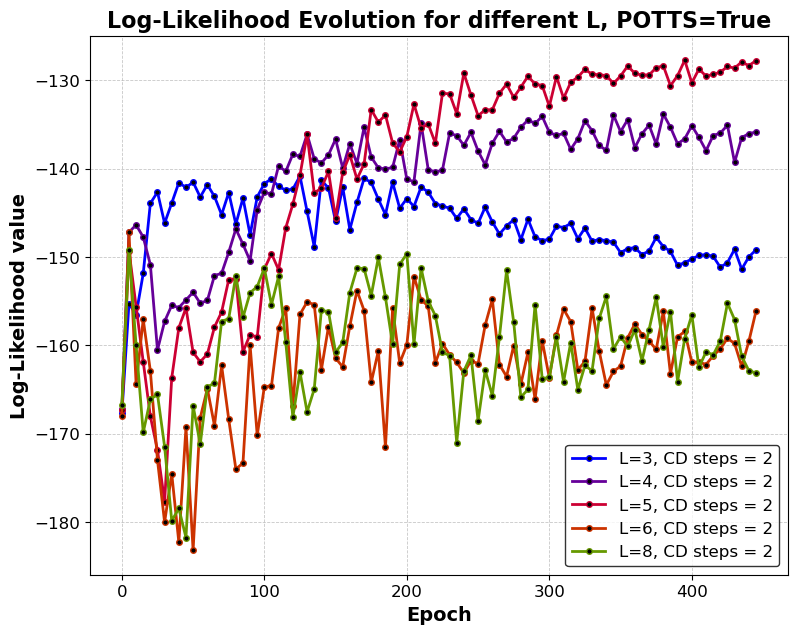

In [67]:
# drawing graphs
fig, ax1 = plt.subplots(1,1,figsize=(9,7))
num_epo=[0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100, 105, 110, 115, 120, 125, 130, 135, 140, 145, 150, 155, 160, 165, 170, 175, 180, 185, 190, 195, 200, 205, 210, 215, 220, 225, 230, 235, 240, 245, 250, 255, 260, 265, 270, 275, 280, 285, 290, 295, 300, 305, 310, 315, 320, 325, 330, 335, 340, 345, 350, 355, 360, 365, 370, 375, 380, 385, 390, 395, 400, 405, 410, 415, 420, 425, 430, 435, 440, 445]
L_v=[3,4,5,6,8]

colors = plt.cm.brg(np.linspace(0, 1, len(log_like_L)))
for i,log_like in enumerate(log_like_potts): # fixed CD steps=2
    ax1.plot(num_epo, log_like, label=f'L={L_v[i]}, CD steps = 2',linewidth=2, color=colors[i], marker='o',markersize=4, markerfacecolor='black', markeredgewidth=1)
    ax1.set_xlabel('Epoch', fontsize=14, fontweight='bold')
    ax1.set_ylabel('Log-Likelihood value', fontsize=14, fontweight='bold')
    ax1.set_title('Log-Likelihood Evolution for different L, POTTS=True', fontsize=16, fontweight='bold')
    ax1.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)
    #ax1.set_xticks(num_epo)
    ax1.legend(fontsize=12, loc='lower right', frameon=True, edgecolor='black')

plt.show()
